In [1]:
import gym
from gym import spaces
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import t
from tqdm import tqdm
from multiprocessing import Pool

import agents
import environments
from utility import print_gridworld_with_policy, print_heatmap, plot_graph

2023-09-28 01:55:46.901768: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-28 01:55:46.973464: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-28 01:55:46.974173: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-28 01:55:48.467473: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
# GLOBAL VARIABLES
confidence = 0.95

# Register all environments

In [ ]:
# Entropy MDP
gym.envs.register(
    id='GridworldEnvGoalless-v0',
    entry_point=environments.GridworldEnvGoalless
)
# Entropy POMDP
gym.envs.register(
    id='GridworldPOMDPEnvGoalless-v0',
    entry_point=environments.GridworldPOMDPEnvGoalless
)
# Entropy POMDP BiModal
gym.envs.register(
    id='GridworldPOMDPEnvBiModal-v0',
    entry_point=environments.GridworldPOMDPEnvBiModal
)
# Entropy POMDP Asymmetric
gym.envs.register(
    id='GridworldPOMDPEnvAsymm-v0',
    entry_point=environments.GridworldPOMDPEnvAsymm
)

# Gridworld MDP

In [26]:
# Create the Gridworld environment and the REINFORCE agent
env = environments.GridworldEnv(time_horizon=20)

## Reward Reinforce Agent MDP

**Test Reward MDP single sampling**

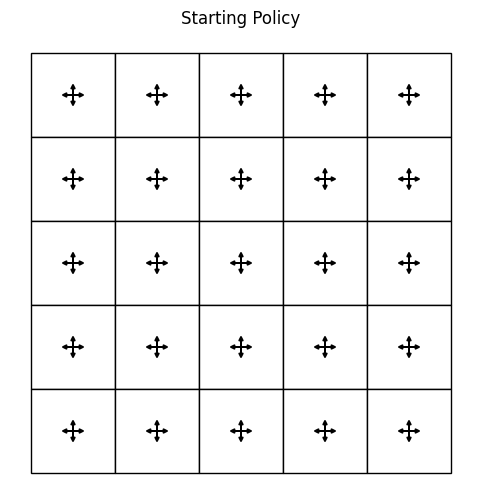

In [9]:
# Create the REINFORCE agent
agent = agents.REINFORCEAgent(env)

# Print the starting policy
print_gridworld_with_policy(agent, env, title="Starting Policy")


100%|██████████████████████████████████████| 6000/6000 [00:07<00:00, 837.50it/s]


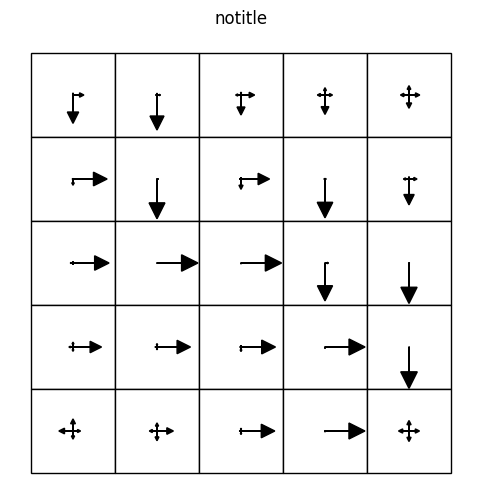

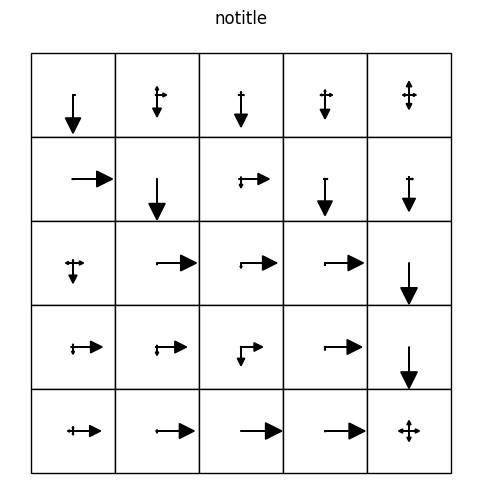

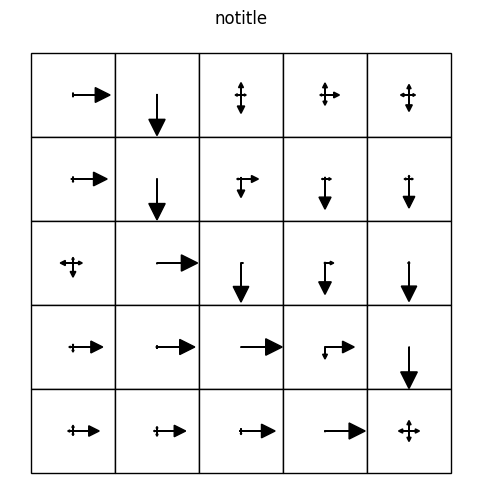

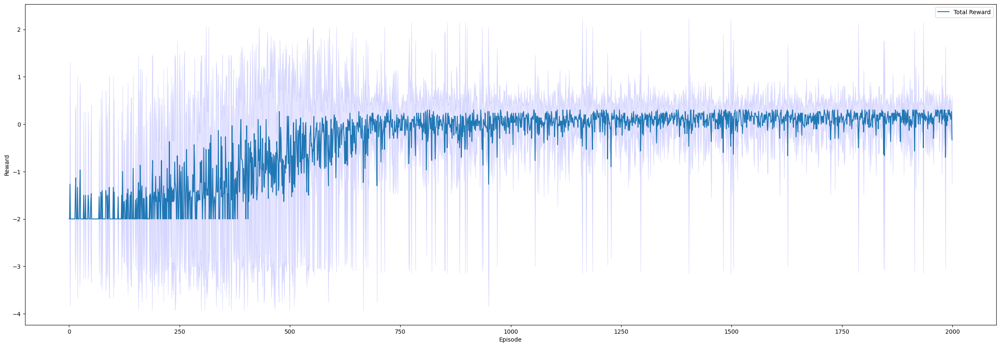

In [10]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 2000
#number of run per episode
n_run = 3

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgent(env, alpha=0.1)
        # Initialize the rewards array
        total_rewards = []
        for i in range(n_episodes):
            # Play the environment
            episode, total_reward = agent.play(env)
            # Save the reward
            total_rewards.append(total_reward)
            # Update the policy
            agent.update_single_sampling(episode)
            pbar.update(1)
        # Save the rewards over the run
        list_total_rewards.append(total_rewards)
        # Print the ending policy
        print_gridworld_with_policy(agent, env)
# Adjust the representation of the rewards
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Prepare values to print
plot_args = {}

total_rewards_means = np.mean(list_total_rewards, axis=1)
total_rewards_stds = np.std(list_total_rewards, axis=1)
plot_args["Total Reward"] = [total_rewards_means, total_rewards_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Reward', 'Reward MDP single sampling')

**Test Reward MDP multiple sampling**

100%|█████████████████████████████████████████| 500/500 [00:13<00:00, 37.33it/s]


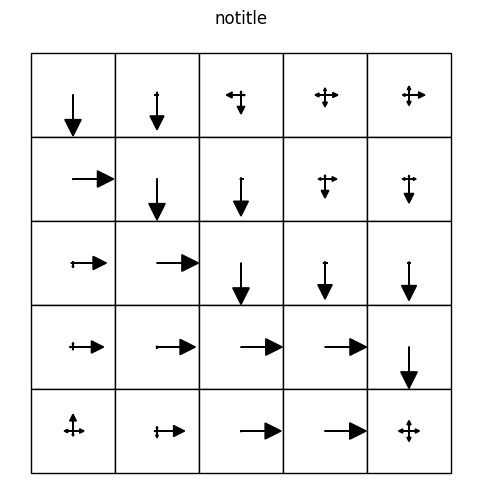

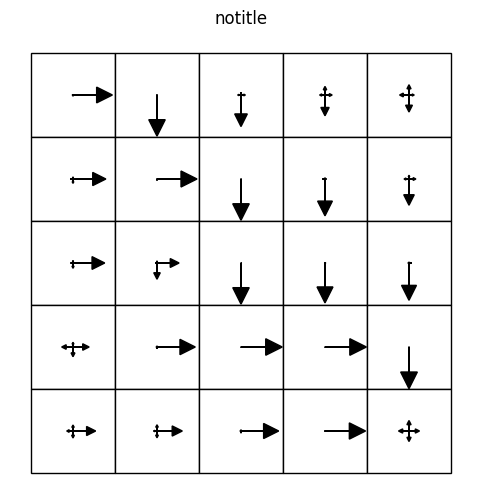

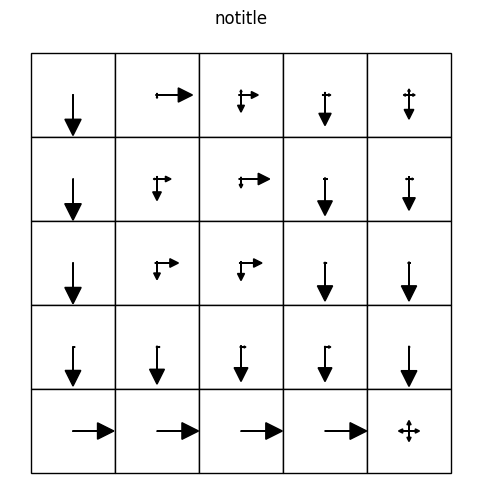

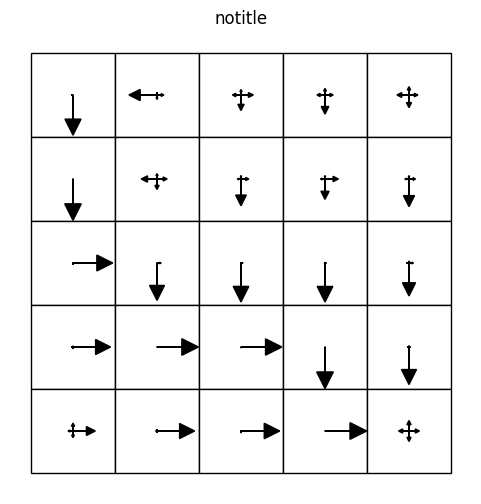

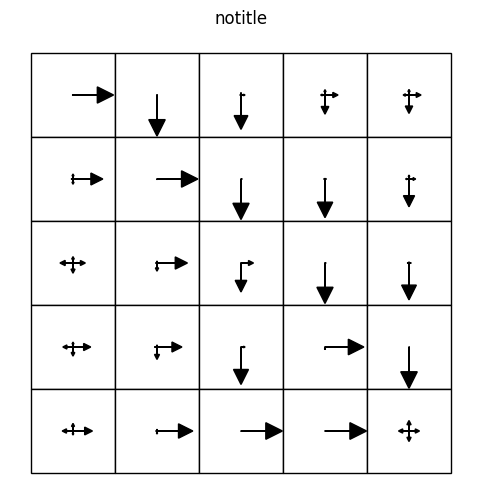

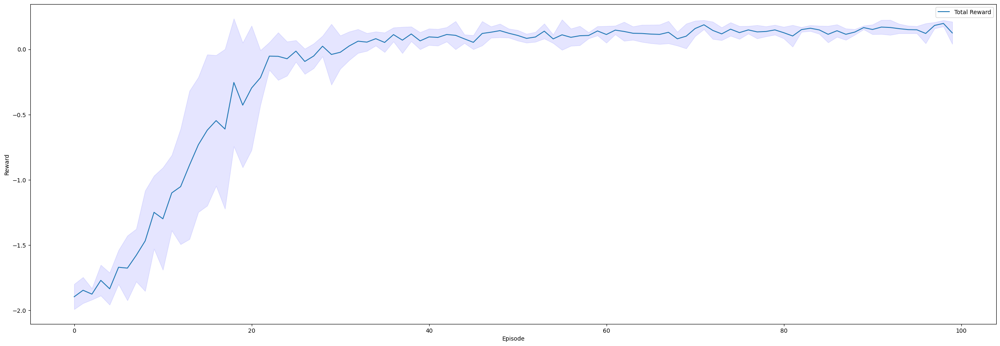

In [11]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 25
#number of run per episode
n_run = 5

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgent(env, alpha=3)
        # Initialize the average rewards array
        total_avg_rewards = []
        for i in range(n_episodes):
            # Play the environment
            episodes, total_rewards = agent.play(env, n_traj)
            # Update the policy
            agent.update_multiple_sampling(episodes)
            # Compute the average the reward in the episode and save it
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        # Save the average rewards over the run
        list_total_rewards.append(total_avg_rewards)
        # Print the ending policy
        print_gridworld_with_policy(agent, env)
# Adjust the representation of the rewards
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Prepare values to print
plot_args = {}

total_rewards_means = np.mean(list_total_rewards, axis=1)
total_rewards_stds = np.std(list_total_rewards, axis=1)
plot_args["Total Reward"] = [total_rewards_means, total_rewards_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Reward', 'Reward MDP multiple sampling')

## Entropy Reinforce Agent MDP

**Training method to allow parallel runs**

In [12]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, prob, randomize = args
    env = gym.make("GridworldEnvGoalless-v0", time_horizon=time_horizon, prob=prob, randomize=randomize)  # Create a new environment for each run
    agent = agents.REINFORCEAgentE(env, alpha=alpha)
    avg_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for ep in range(n_episodes):
                if ep == n_episodes/2:
                    agent.alpha *= 2
                episodes = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                pbar.update(1)
    else:
        for ep in range(n_episodes):
            if ep == n_episodes/2:
                agent.alpha *= 2
            episodes = agent.play(env=env, n_traj=n_traj)
            entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
            avg_entropies.append(np.mean(entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies

**Optimal Policy deterministic**

  0%|                                                 | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
100%|████████████████████████████████████| 10000/10000 [00:22<00:00, 435.31it/s]


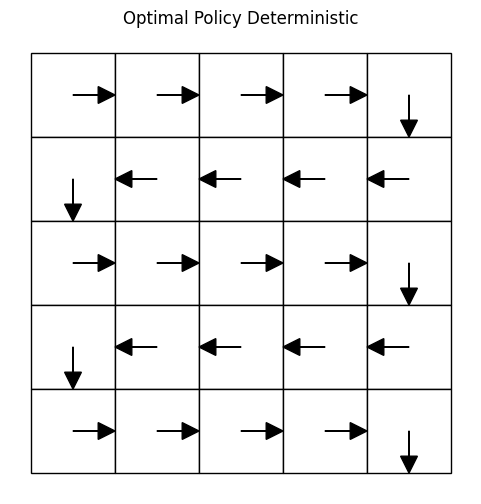

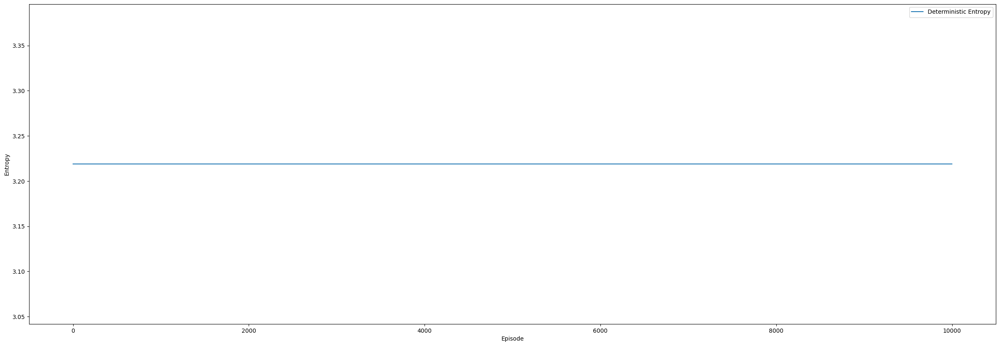

In [6]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
env = gym.make('GridworldEnvGoalless-v0', time_horizon=25, prob=0)
# Number of times the learning is executed
n_run = 1

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, policy=1)
        # Initialize the rewards array
        entropies = []
        for i in range(n_episodes):
            # Play the environment
            episode, d_t = agent.play(env)
            # Update the policy
            entropy = agent.update_single_sampling(episode, d_t)
            # Save the entropy
            entropies.append(entropy)
            pbar.update(1)
        # Save the rewards over the run
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Print the ending policy
print_gridworld_with_policy(agent, env, title="Optimal Policy Deterministic")

# Prepare values to print
plot_args = {}

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Deterministic Entropy'] = [true_entropies_means, true_entropies_stds]
optimal_deterministic_result = plot_args
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Optimal Policy Deterministic')

**Optimal Policy stochastic**
Increasing the number of runs doesn't make the variance of the curve smaller

  0%|                                       | 54/50000 [00:00<01:33, 533.28it/s]

100%|████████████████████████████████████| 50000/50000 [01:29<00:00, 559.30it/s]


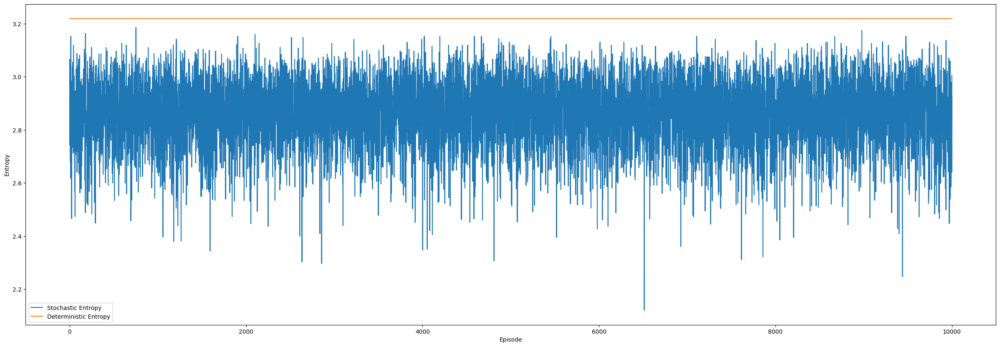

In [7]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
env = gym.make('GridworldEnvGoalless-v0', time_horizon=25, prob=0.1)
# Number of times the learning is executed
n_run = 5

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, policy=1)
        # Initialize the array of entropies over the episodes
        entropies = []
        for i in range(n_episodes):
            # Play the environment
            entropy, d_t = agent.play(env)
            # Compute the entropy
            entropy = agent.compute_entropy(d_t)
            # Save the entropy
            entropies.append(entropy)
            pbar.update(1)
        # Save the entropies during the runs
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Stochastic Entropy'] = [true_entropies_means, true_entropies_stds]
plot_args.update(optimal_deterministic_result)
optimal_stochastic_result = plot_args
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic')

**Test Entropy MDP single sampling deterministic**

  0%|                                                 | 0/50000 [00:00<?, ?it/s]

 20%|███████▎                             | 9966/50000 [00:22<01:22, 484.47it/s]

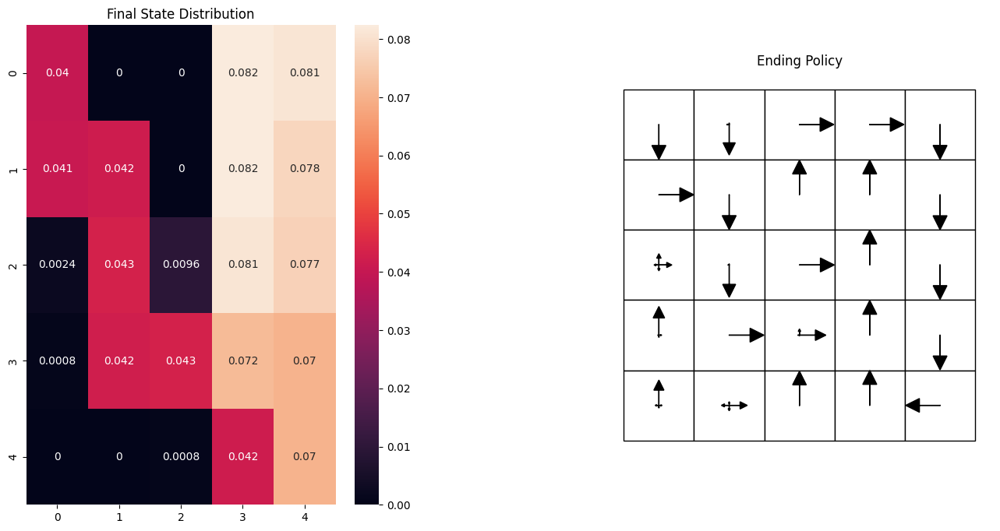

 40%|██████████████▍                     | 19993/50000 [00:46<01:09, 432.96it/s]

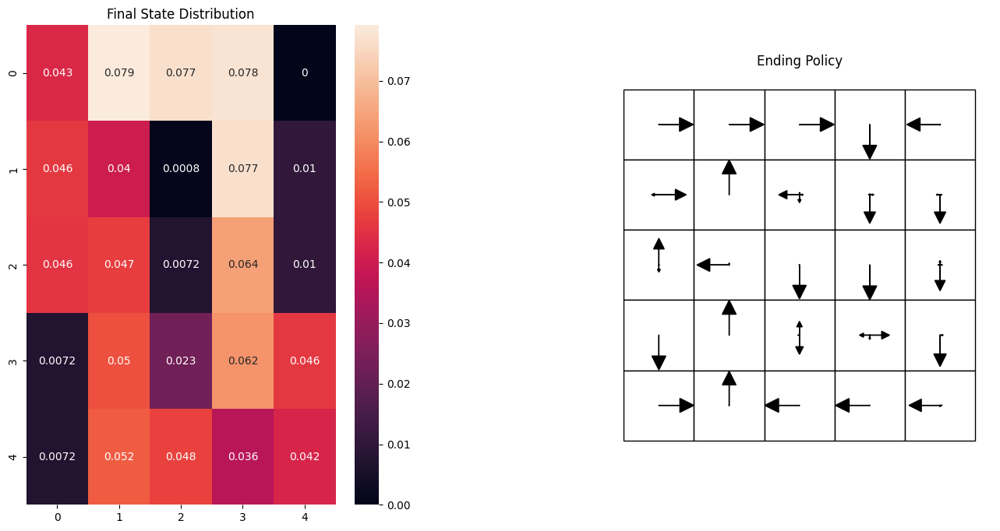

 60%|█████████████████████▌              | 29999/50000 [01:10<00:46, 431.25it/s]

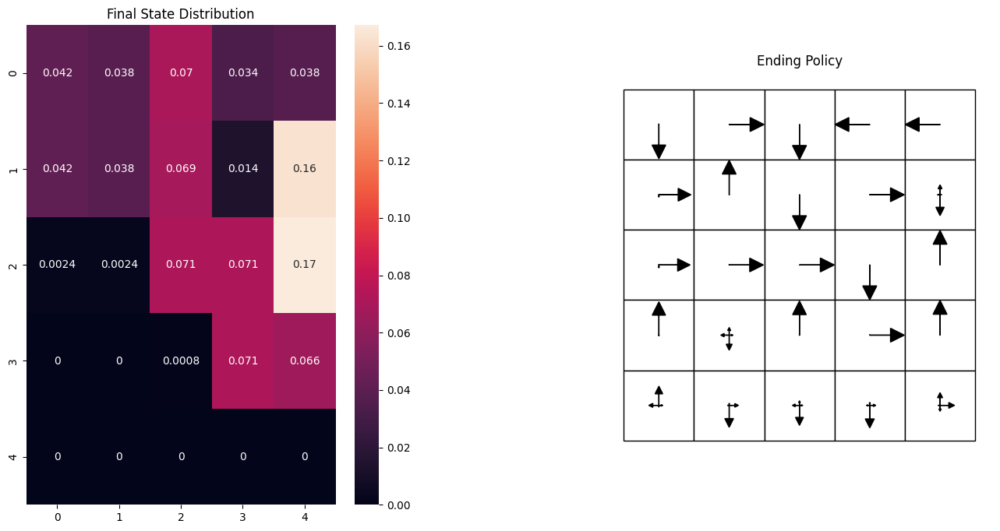

 80%|████████████████████████████▊       | 39961/50000 [01:34<00:22, 439.68it/s]

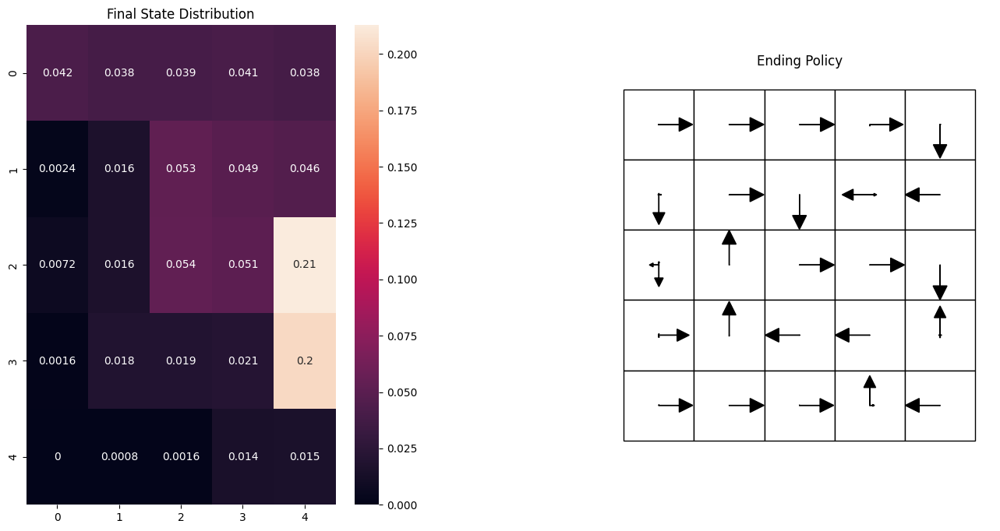

100%|███████████████████████████████████▉| 49996/50000 [01:57<00:00, 442.05it/s]

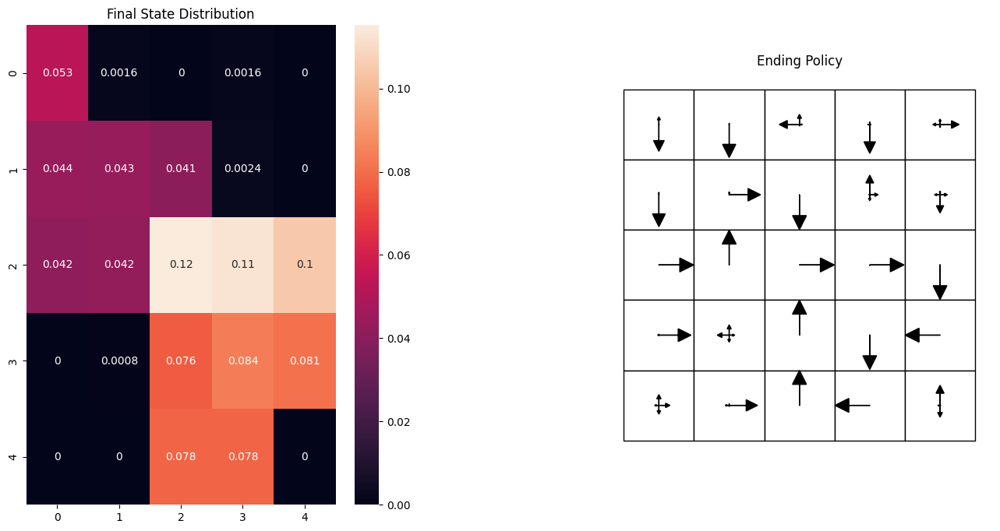

100%|████████████████████████████████████| 50000/50000 [01:58<00:00, 421.16it/s]


Stochastic Optimal mean: 2.8697518535726254
Deterministic Learned mean: 2.534650288607529


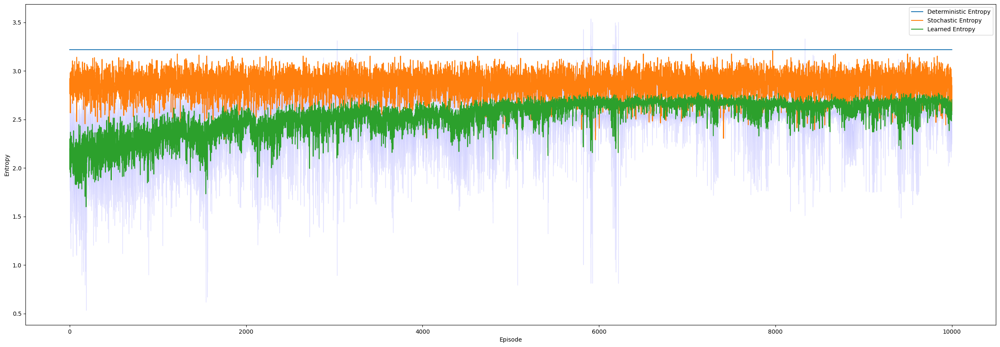

In [12]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 25
env = gym.make('GridworldEnvGoalless-v0', time_horizon=time_horizon, prob=0)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 50

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.04)
        # Initialize the entropies array
        entropies = []
        # Training part
        for i in range(n_episodes):
            # Play the environment
            episode, d_t = agent.play(env)
            # Update the policy
            entropy = agent.update_single_sampling(episode, d_t)
            # Save the entropies
            entropies.append(entropy)
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Deterministic Learned mean: " + str(np.mean(true_entropies_means)))

**Test Entropy MDP single sampling stochastic**

  0%|                                                 | 0/50000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
 20%|███████▎                             | 9965/50000 [00:22<01:31, 435.42it/s]

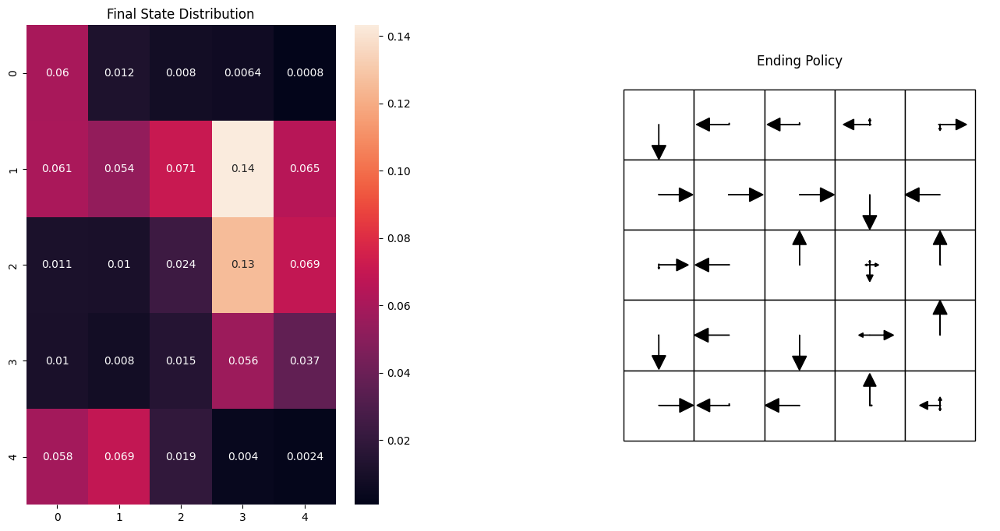

 40%|██████████████▍                     | 19970/50000 [00:46<01:09, 434.28it/s]

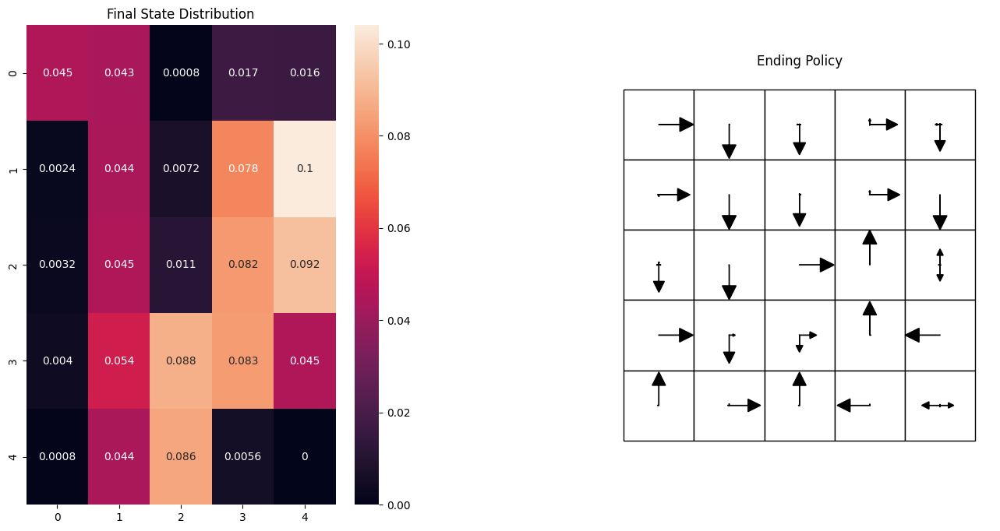

 60%|█████████████████████▌              | 29958/50000 [01:10<00:44, 450.85it/s]

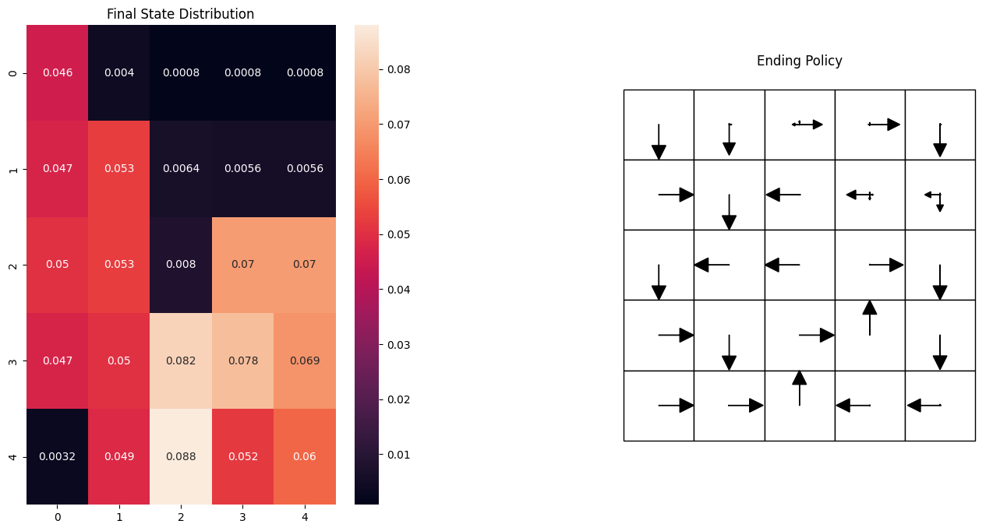

 80%|████████████████████████████▊       | 39999/50000 [01:33<00:22, 436.78it/s]

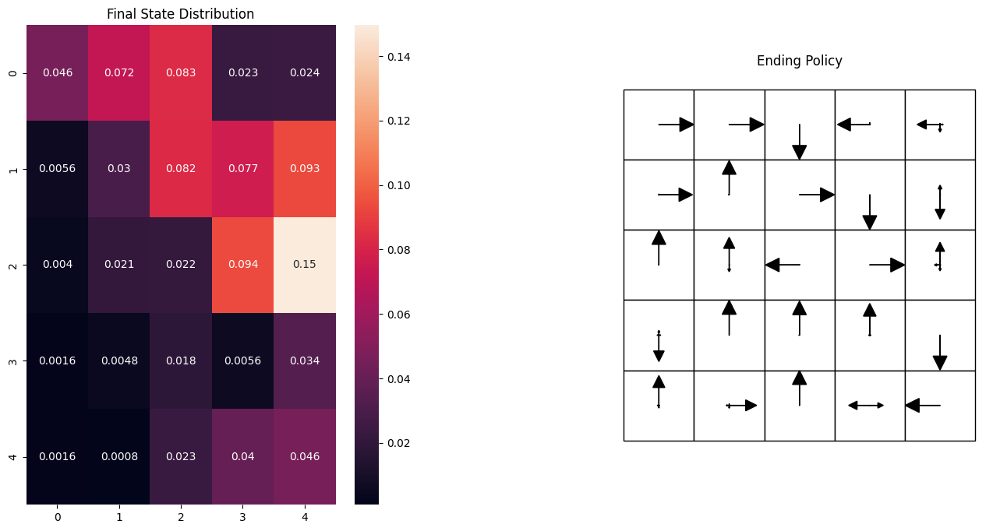

100%|███████████████████████████████████▉| 49975/50000 [01:57<00:00, 437.12it/s]

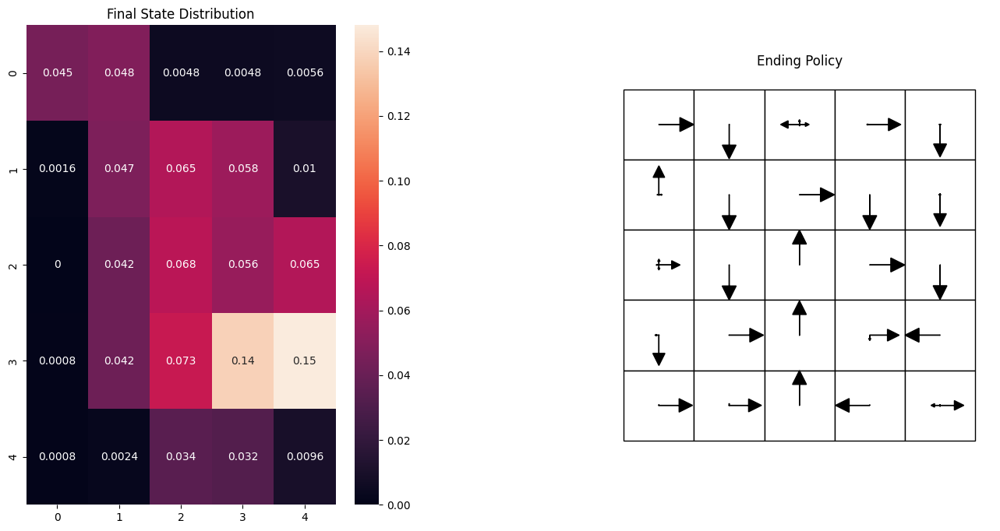

100%|████████████████████████████████████| 50000/50000 [01:58<00:00, 422.54it/s]


Stochastic Optimal mean: 2.8697518535726254
Stochastic Learned mean: 2.4951672653192656


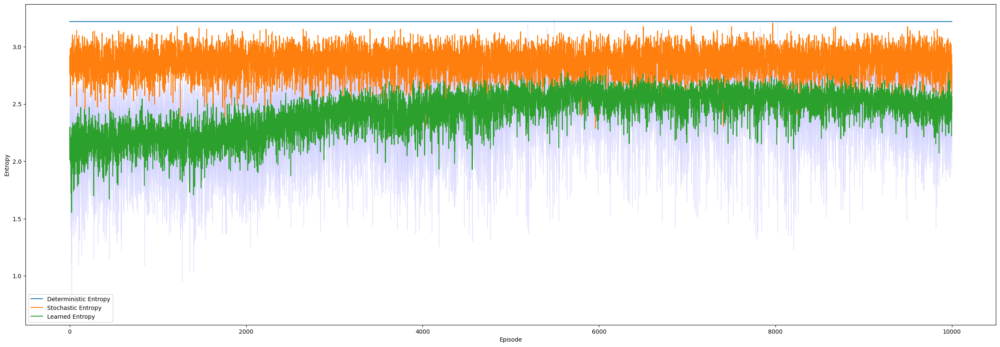

In [13]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 25
env = gym.make('GridworldEnvGoalless-v0', time_horizon=time_horizon, prob=0.1)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 50

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.04)
        # Initialize the entropies array
        entropies = []
        # Training part
        for i in range(n_episodes):
            # Play the environment
            episode, d_t = agent.play(env)
            # Update the policy
            entropy = agent.update_single_sampling(episode, d_t)
            # Save the entropies
            entropies.append(entropy)
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9000:])))

**Test Entropy MDP multiple sampling deterministic**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                           | 0/6000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

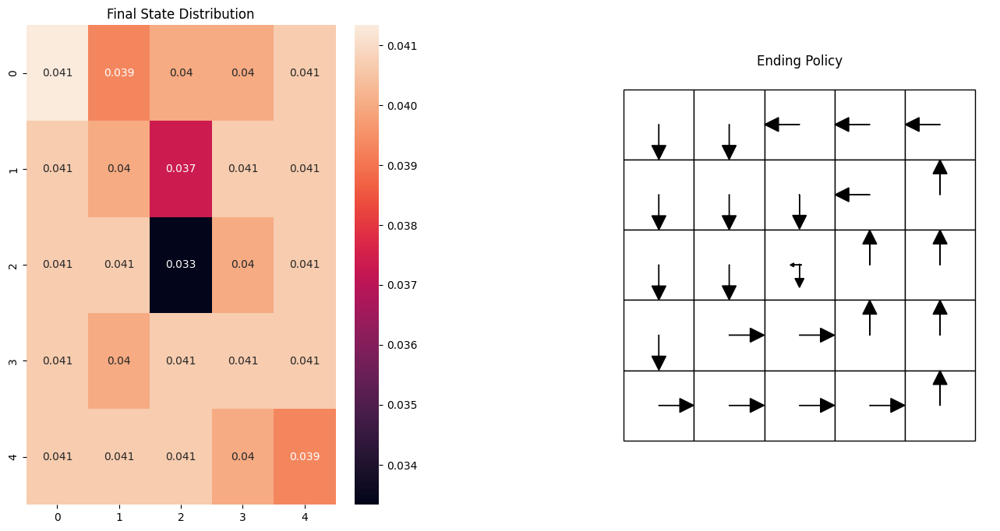

Run 0:  95%|██████████████████████████████▎ | 5692/6000 [14:46<00:46,  6.69it/s]

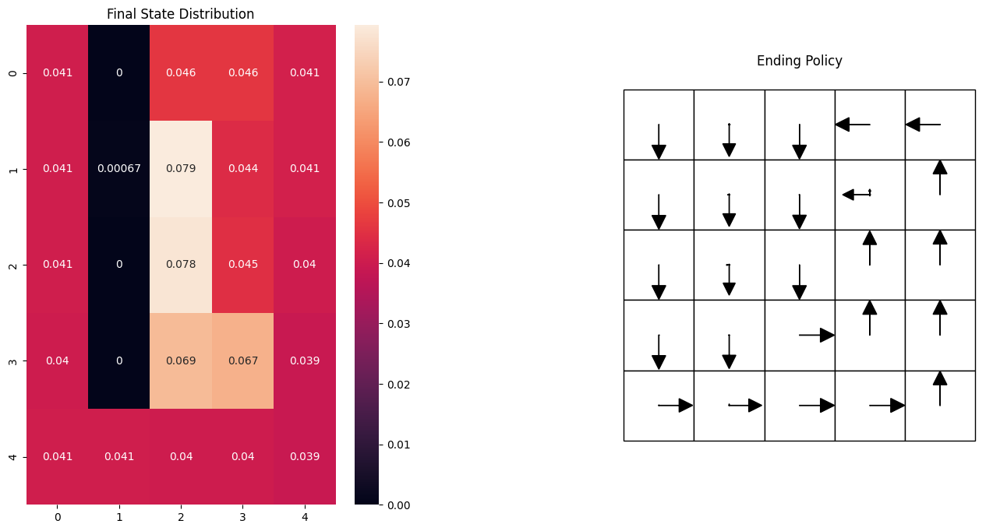

Run 0:  95%|██████████████████████████████▍ | 5712/6000 [14:49<00:43,  6.69it/s]

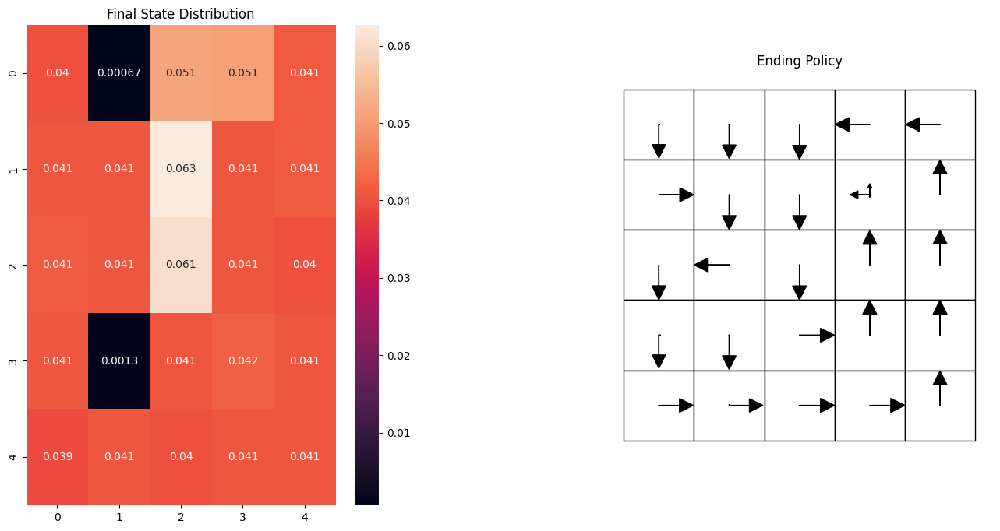

Run 0:  95%|██████████████████████████████▌ | 5728/6000 [14:51<00:40,  6.71it/s]

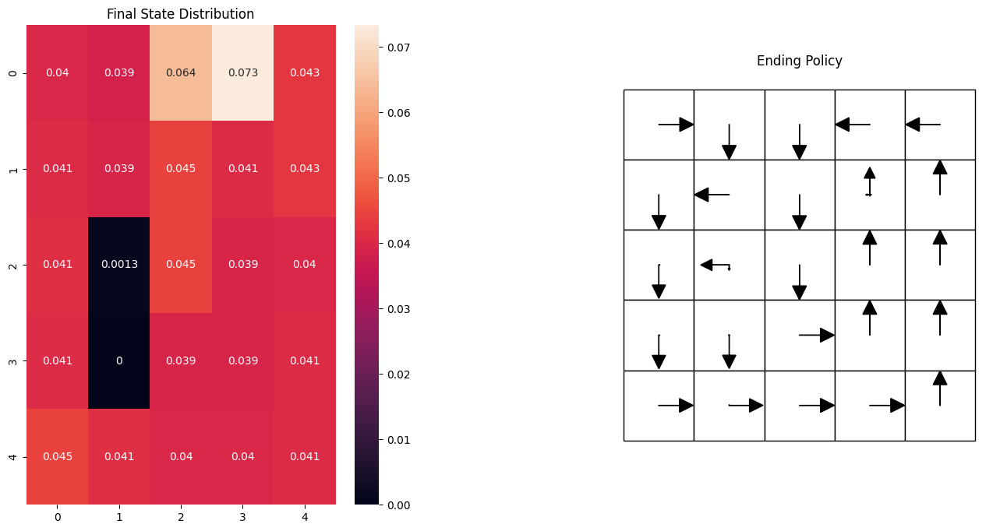

Run 0:  96%|██████████████████████████████▌ | 5738/6000 [14:53<00:37,  7.03it/s]

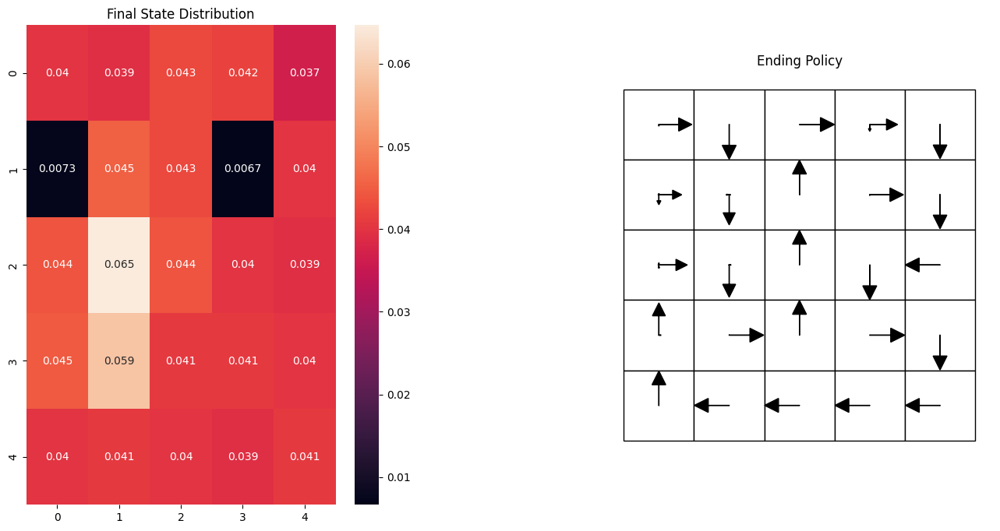

Run 0:  96%|██████████████████████████████▊ | 5771/6000 [14:58<00:33,  6.85it/s]

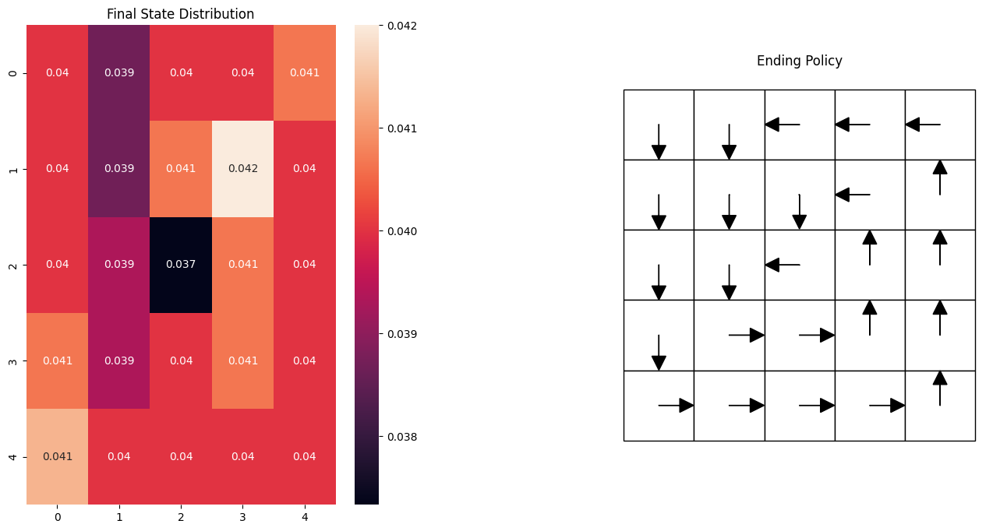

Run 0:  97%|███████████████████████████████ | 5831/6000 [15:06<00:25,  6.52it/s]

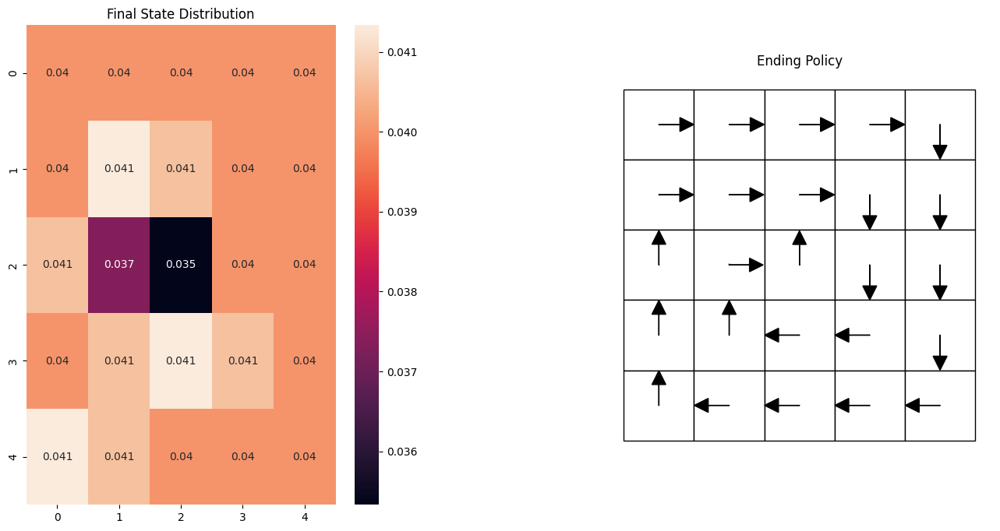

Run 0:  97%|███████████████████████████████ | 5835/6000 [15:07<00:23,  6.94it/s]

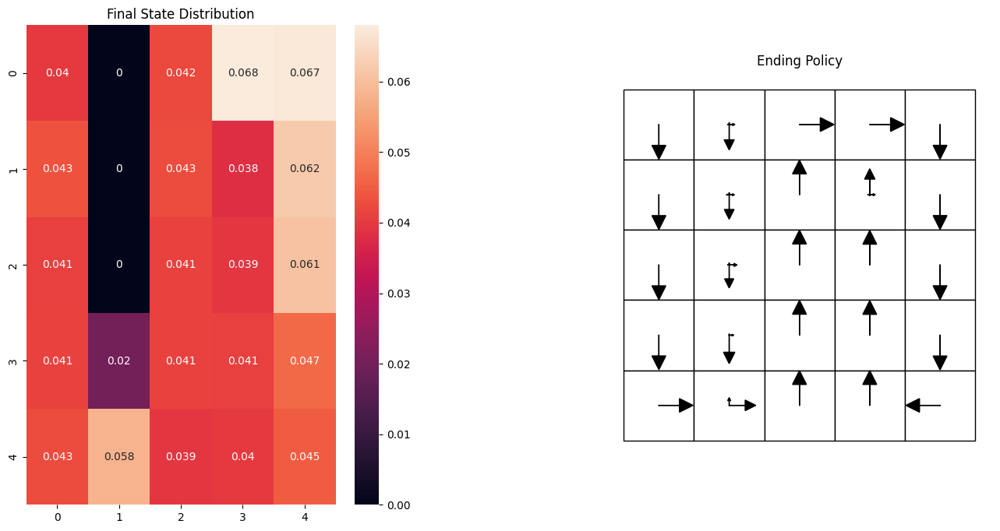

Run 0:  99%|███████████████████████████████▌| 5913/6000 [15:17<00:12,  7.15it/s]

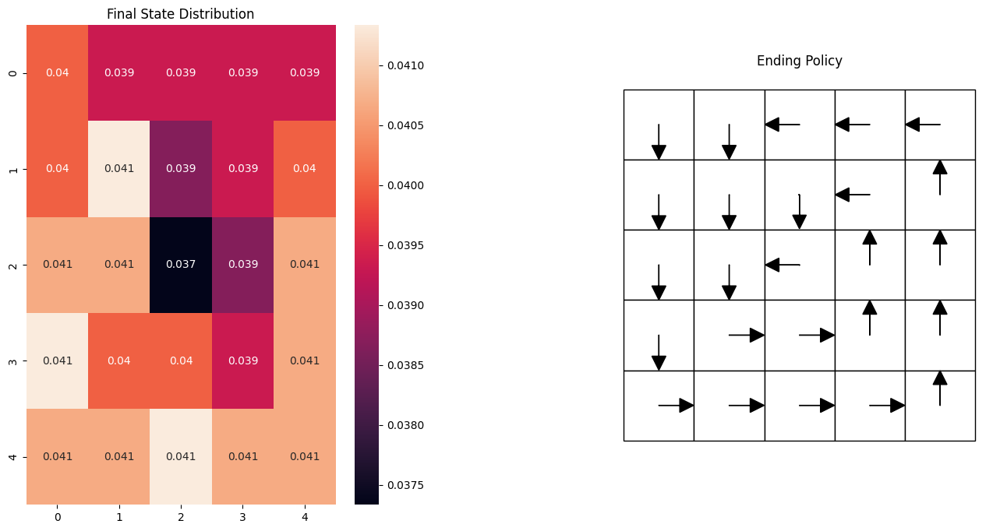

Run 0: 100%|████████████████████████████████| 6000/6000 [15:29<00:00,  6.46it/s]


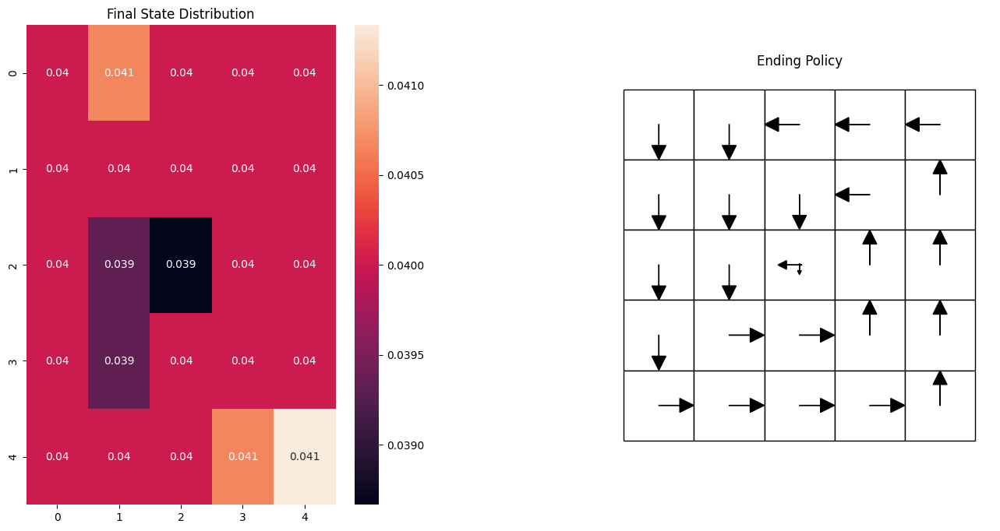

Stochastic Optimal mean: 2.8672475017907835
Deterministic Learned mean: 3.1257536019905436


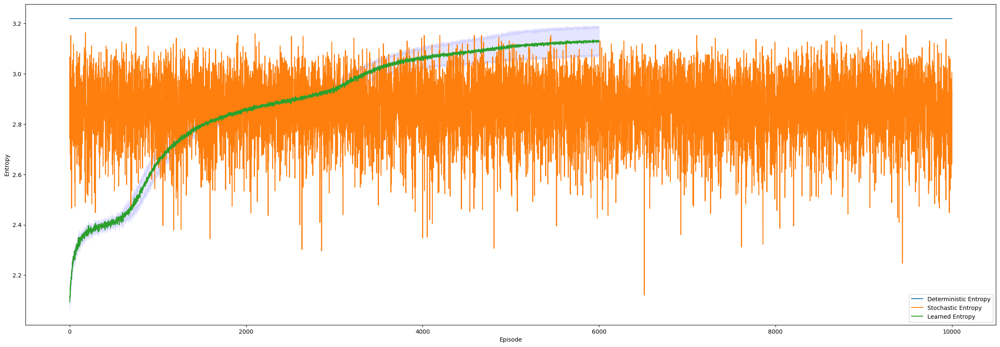

In [14]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
prob=0
randomize=0
# Agent variables
alpha = 0.25
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
for result in results:
    entropies = result
    list_entropies.append(entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic Multiple Sampling')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Deterministic Learned mean: " + str(np.mean(entropies_means[5500:])))

**Test Entropy MDP multiple sampling stochastic**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

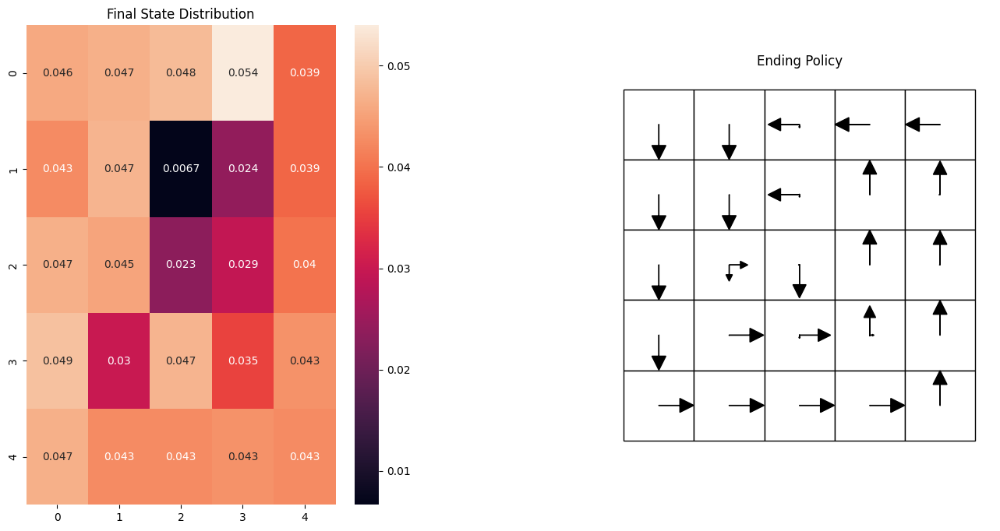

Run 0:  95%|██████████████████████████████▍ | 5706/6000 [14:44<00:44,  6.67it/s]

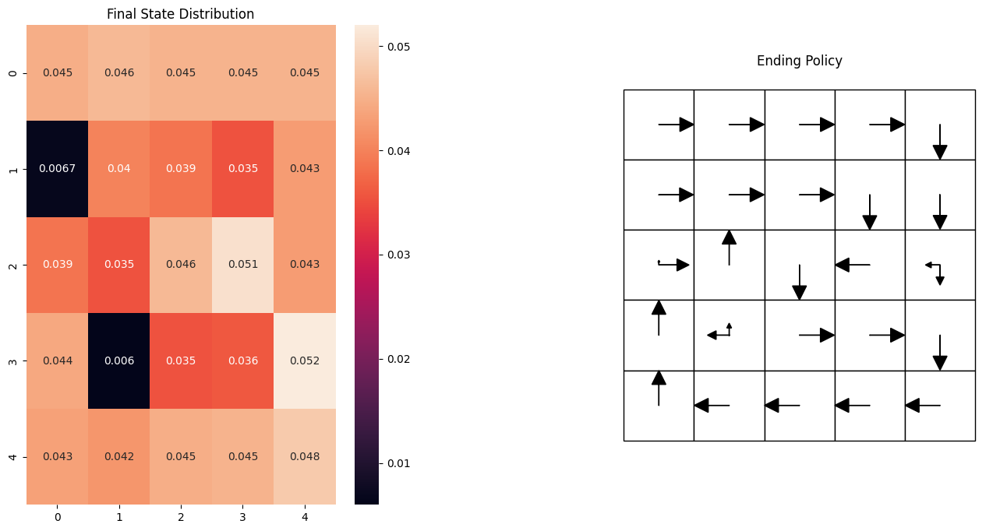

Run 0:  95%|██████████████████████████████▌ | 5729/6000 [14:48<00:44,  6.12it/s]

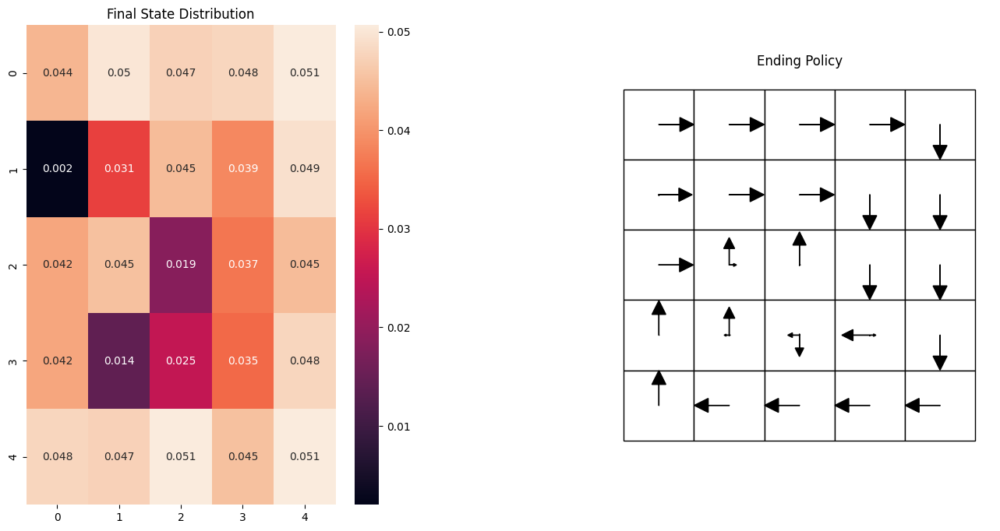

Run 0:  96%|██████████████████████████████▋ | 5743/6000 [14:50<00:36,  6.95it/s]

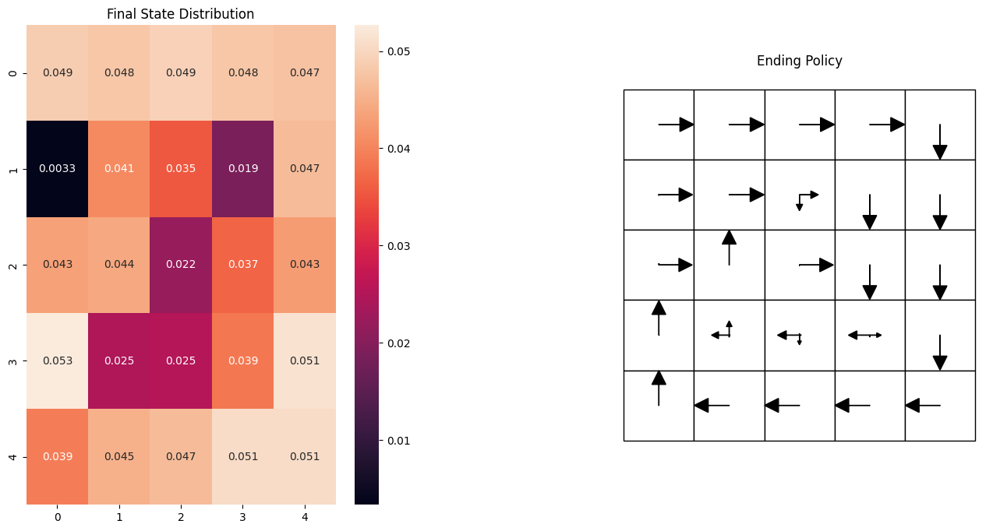

Run 0:  96%|██████████████████████████████▋ | 5761/6000 [14:53<00:37,  6.37it/s]

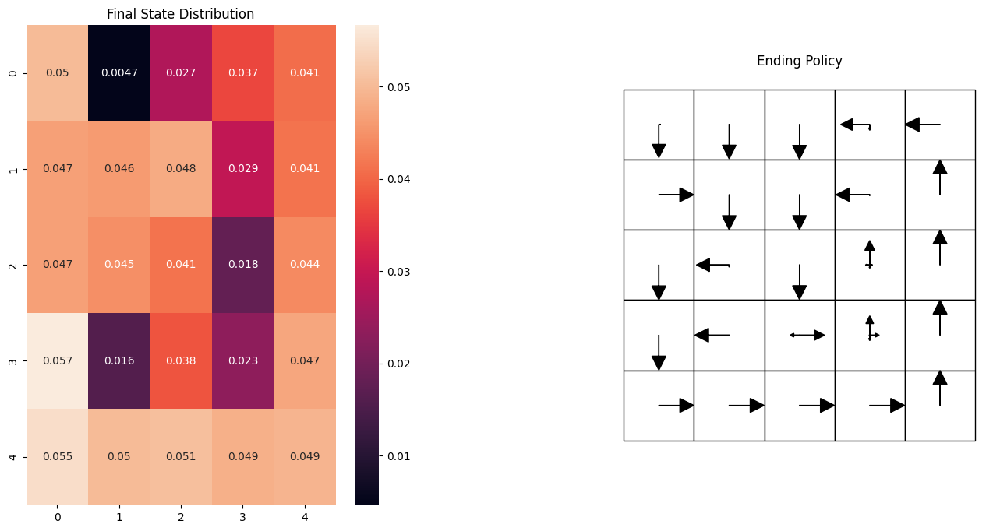

Run 0:  96%|██████████████████████████████▊ | 5786/6000 [14:56<00:33,  6.37it/s]

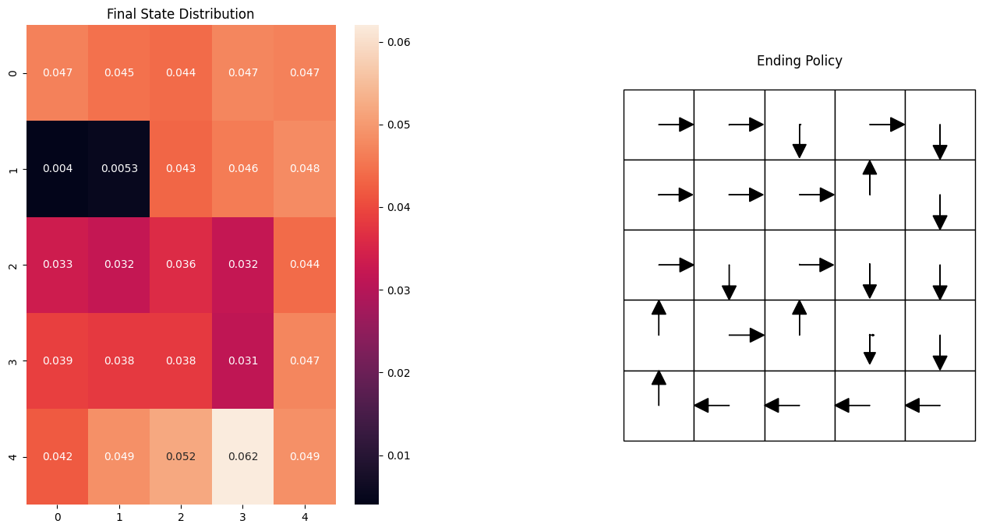

Run 0:  97%|██████████████████████████████▉ | 5796/6000 [14:58<00:30,  6.78it/s]

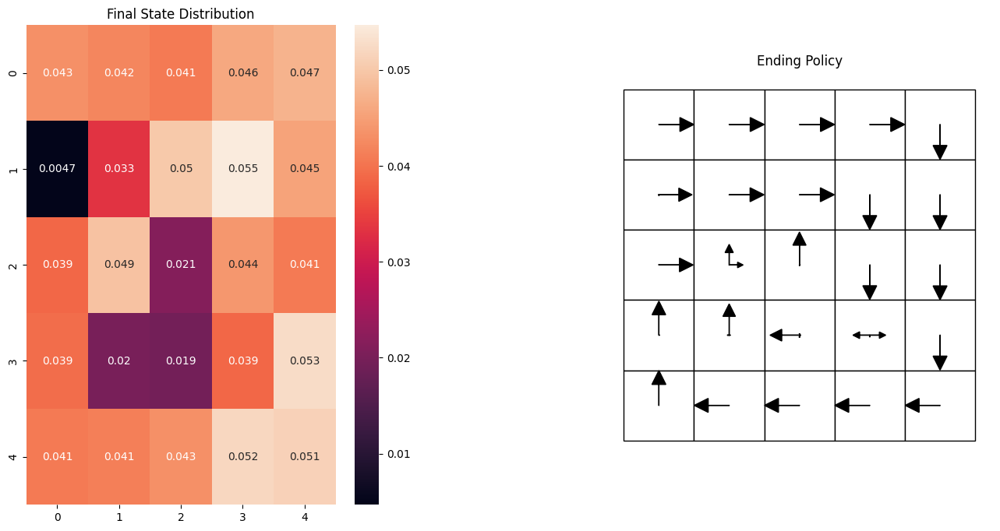

Run 0:  98%|███████████████████████████████▏| 5859/6000 [15:06<00:19,  7.16it/s]

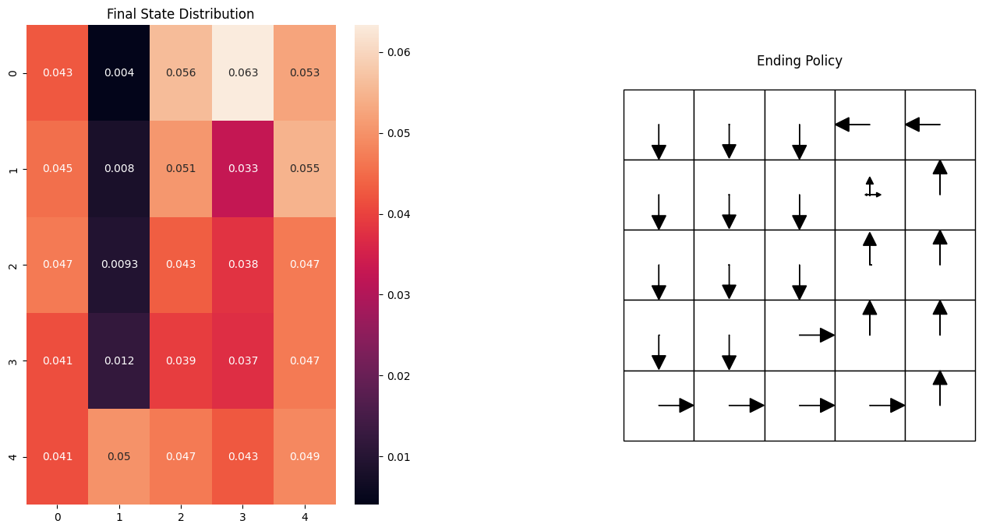

Run 0:  98%|███████████████████████████████▍| 5900/6000 [15:12<00:13,  7.38it/s]

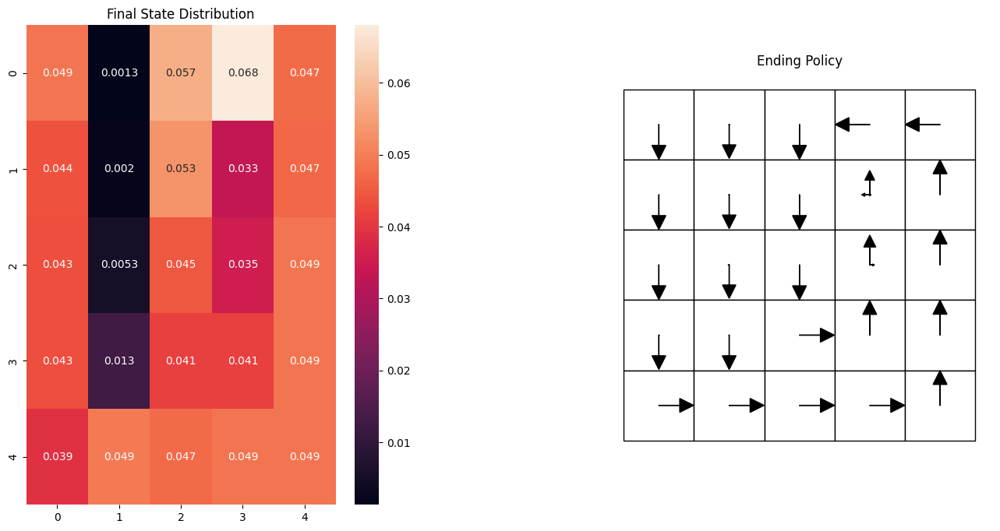

Run 0: 100%|████████████████████████████████| 6000/6000 [15:25<00:00,  6.48it/s]


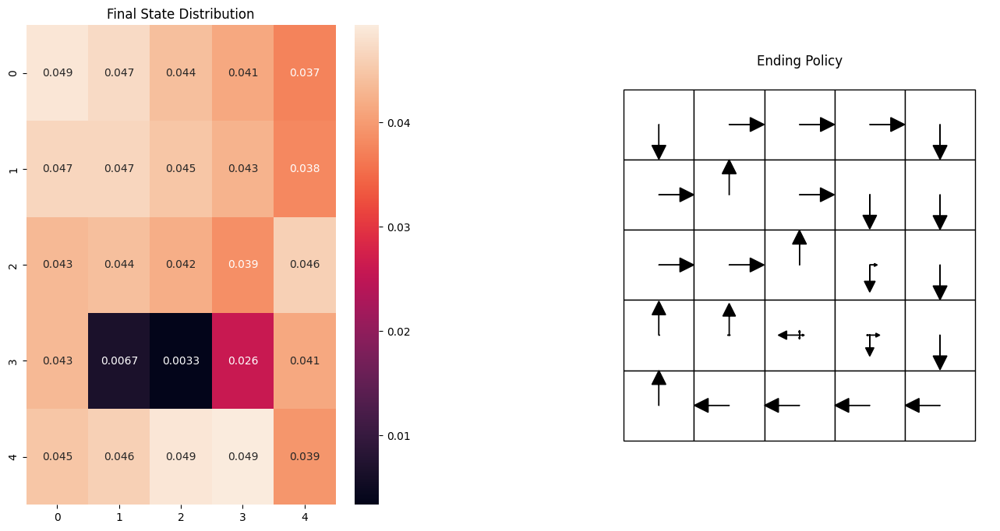

Stochastic Optimal mean: 2.8672475017907835
Stochastic Learned mean: 2.938941526339523


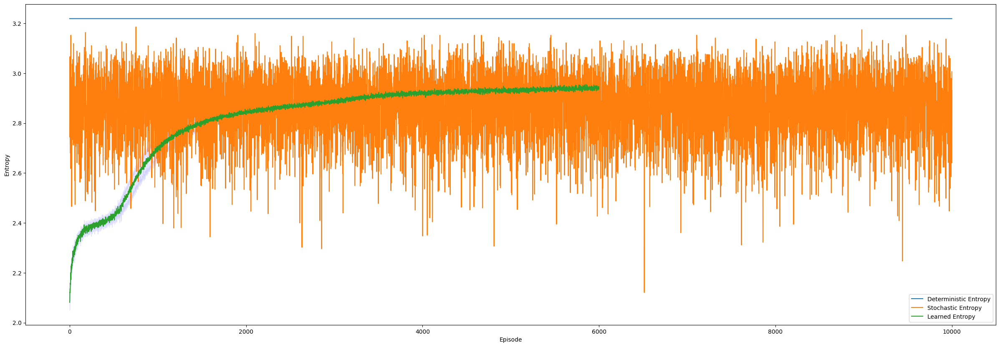

In [16]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
prob=0.1
randomize=0
# Agent variables
alpha=0.4
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
for result in results:
    entropies = result
    list_entropies.append(entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic Multiple Sampling')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(entropies_means[5500:])))

**Test Entropy MDP Multiple Sampling bigger time horizon**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                          | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

Run 0:  99%|██████████████████████████████▋| 9910/10000 [48:15<00:26,  3.43it/s]

visuals incoming


Run 0:  99%|██████████████████████████████▋| 9914/10000 [48:16<00:26,  3.19it/s]

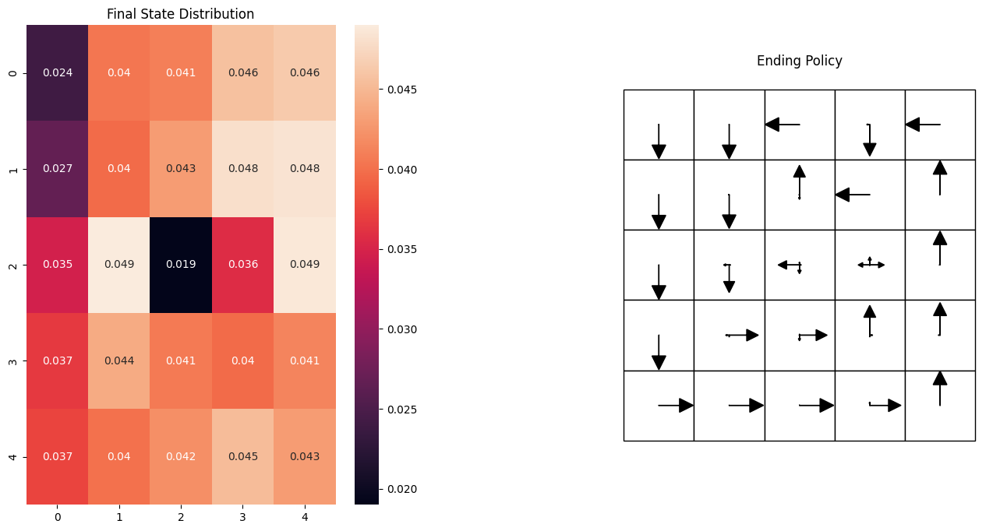

Run 0: 100%|██████████████████████████████| 10000/10000 [48:41<00:00,  3.42it/s]


visuals incoming


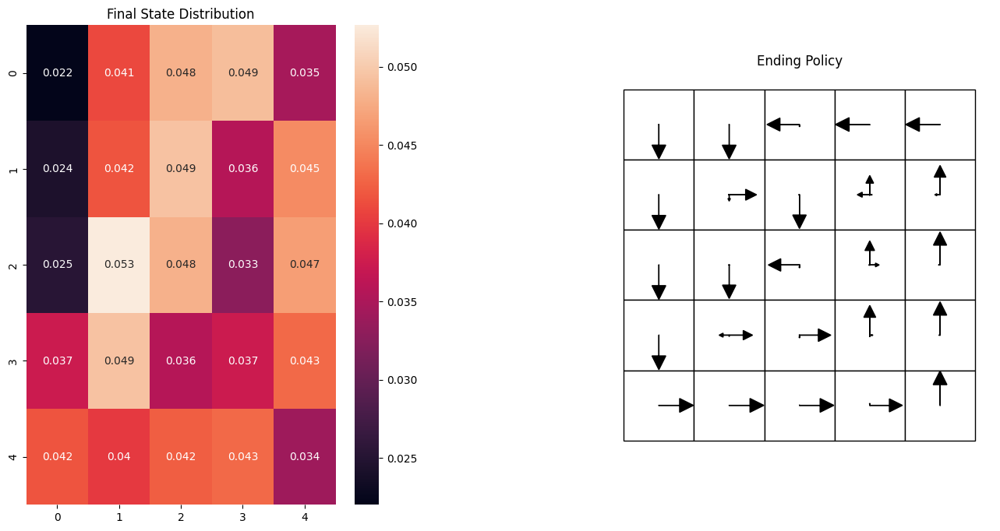

visuals incoming


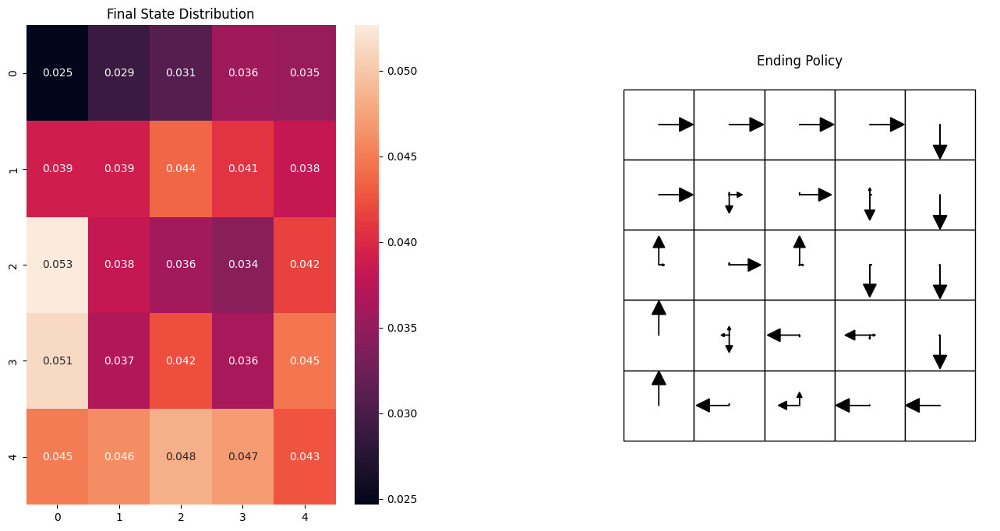

visuals incoming


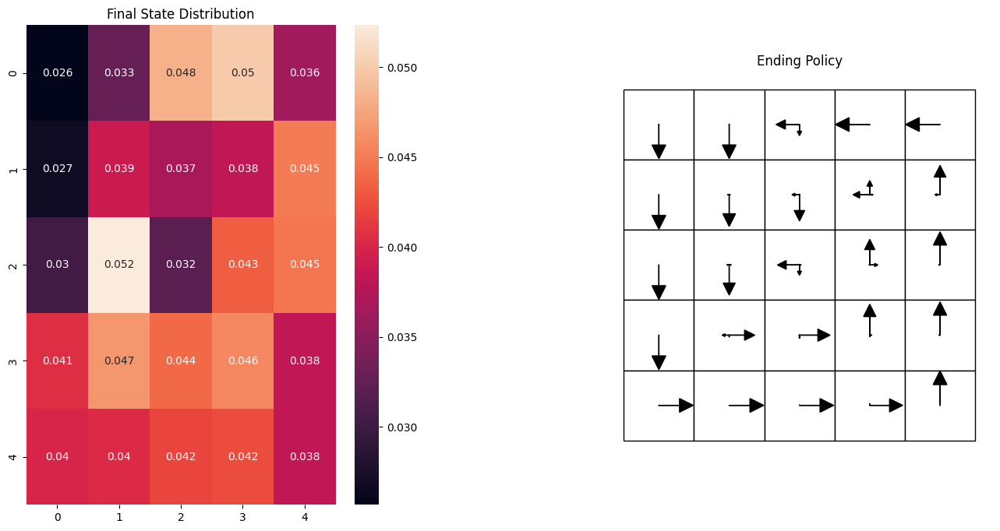

visuals incoming


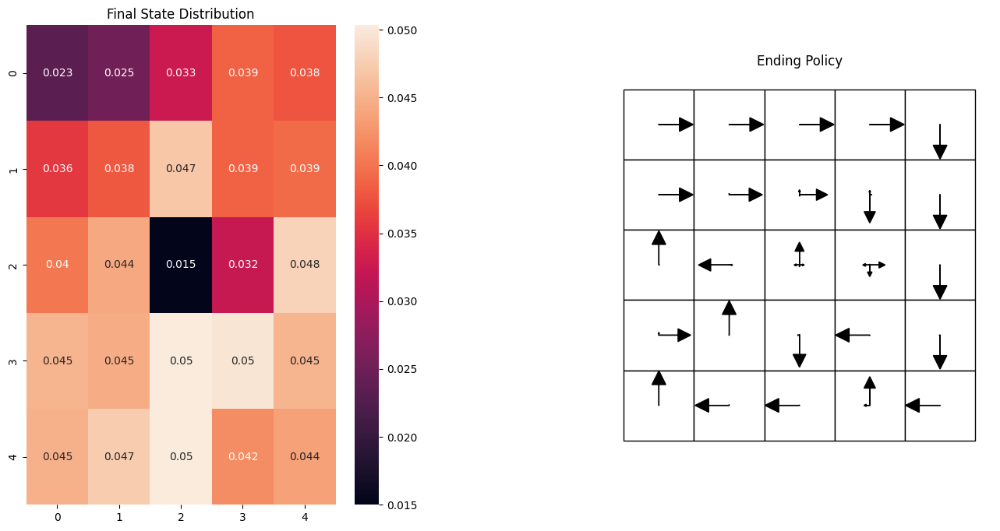

visuals incoming


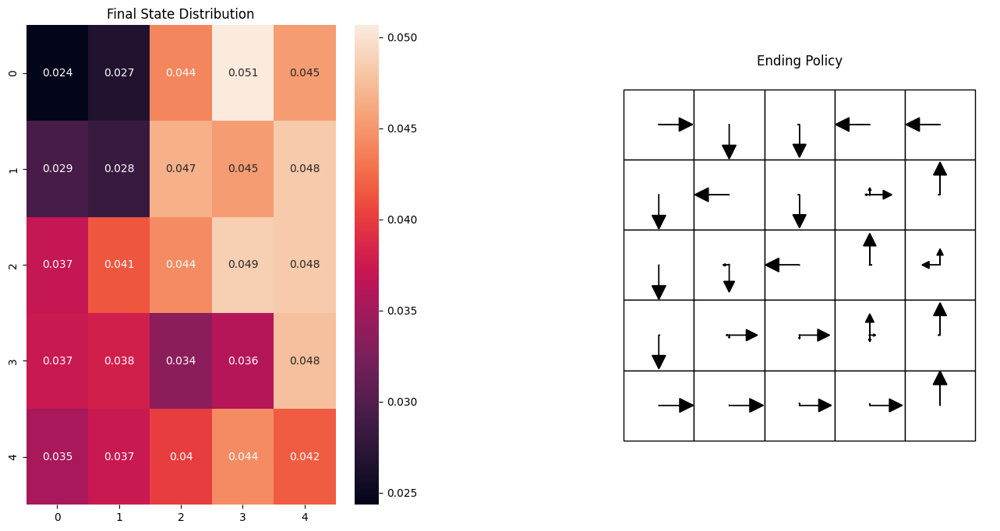

visuals incoming


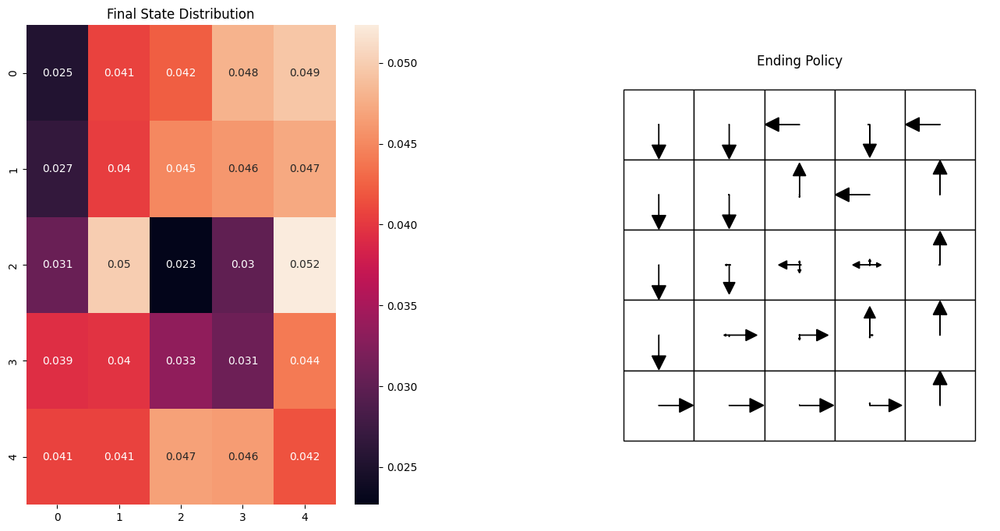

visuals incoming


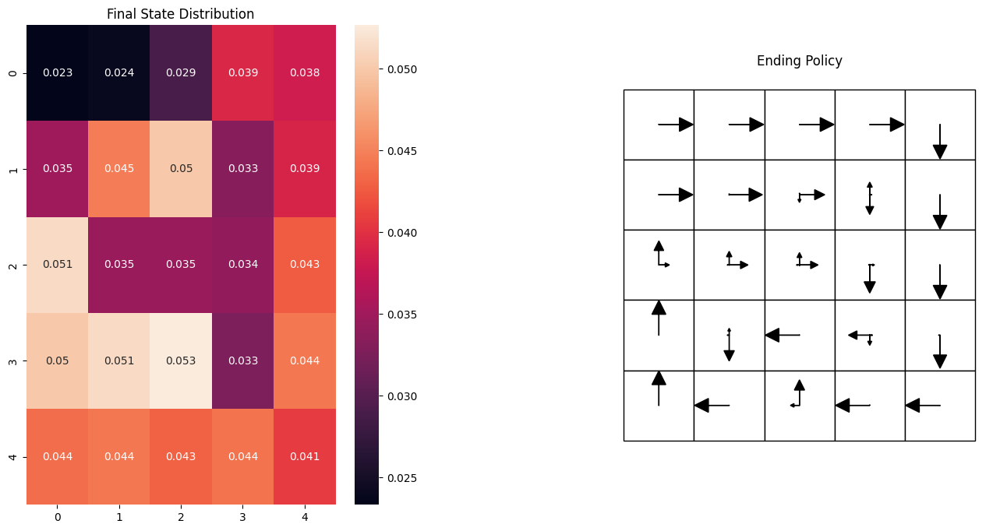

visuals incoming


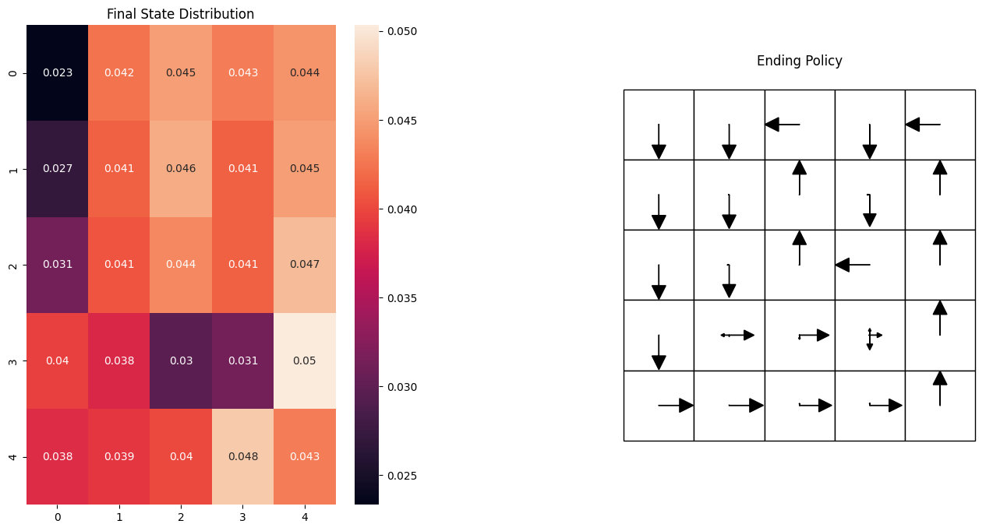

visuals incoming


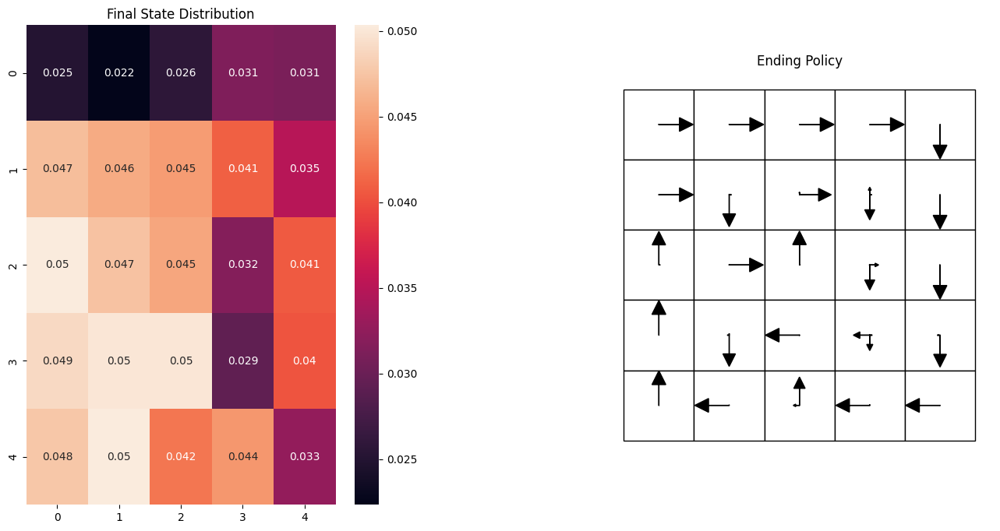

Stochastic Optimal mean: 2.870838924452691
Stochastic Learned mean: 3.0679067717272455


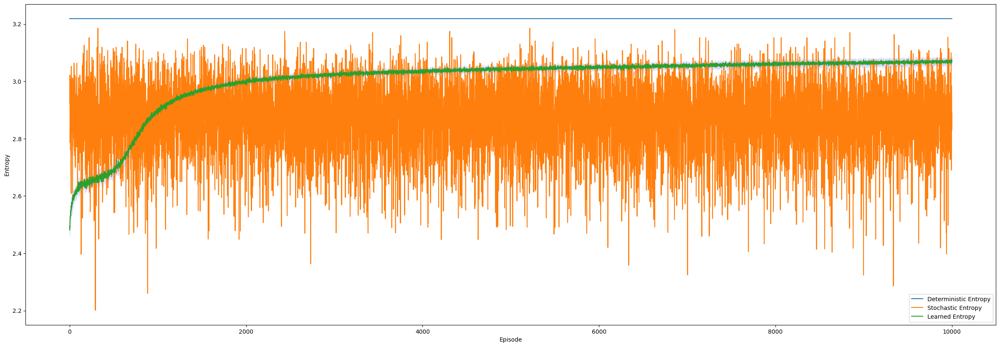

In [ ]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
prob=0.1
randomize=0
# Agent variables
alpha = 0.25
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
for result in results:
    entropies = result
    list_entropies.append(entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic Multiple Sampling')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(entropies_means[5500:])))

# Gridworld POMDP

In [3]:
env = gym.make('GridworldPOMDPEnv-v0', steepness=501)

## Test observation matrix


1.0
1.0


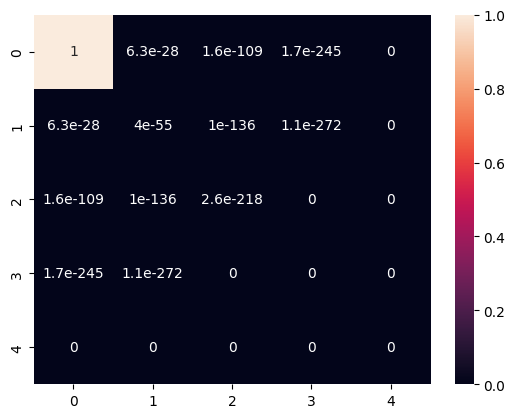

In [ ]:
sns.heatmap(np.reshape(env.observation_matrix[0], (env.grid_size, env.grid_size)), annot=True)
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

## Reward Reinforce POMDP

**Test Reward POMDP sampled state**

  0%|                                                   | 0/500 [00:00<?, ?it/s]

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:187: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the environment initialisation to be passed additional information.
  logger.warn(
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
 20%|████████▏                                | 100/500 [00:09<00:32, 12.49it/s]

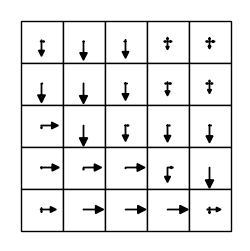

 40%|████████████████▎                        | 199/500 [00:19<00:23, 12.78it/s]

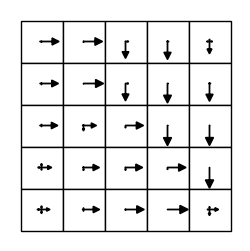

 60%|████████████████████████▌                | 300/500 [00:29<00:14, 13.59it/s]

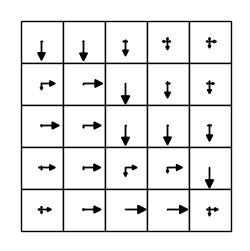

 80%|████████████████████████████████▊        | 400/500 [00:39<00:07, 12.59it/s]

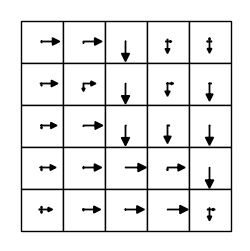

100%|████████████████████████████████████████▉| 499/500 [00:49<00:00, 12.35it/s]

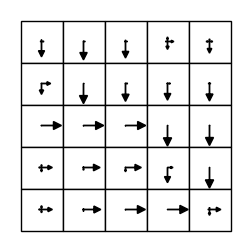

100%|█████████████████████████████████████████| 500/500 [00:49<00:00, 10.02it/s]


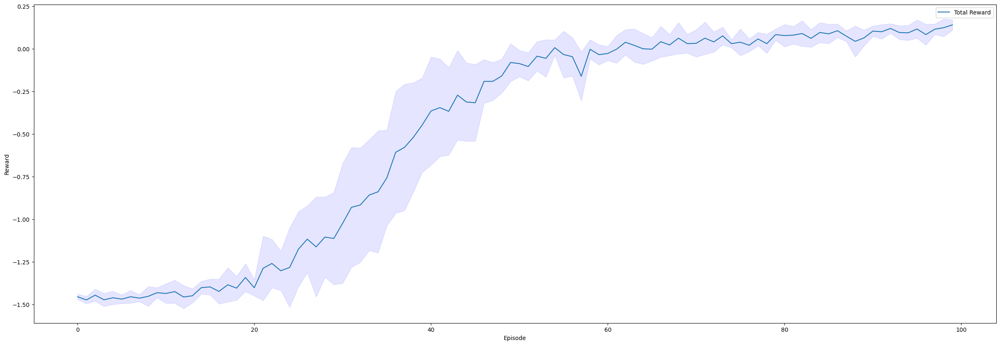

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
# Number of runs of training
n_run = 5
# Initialize environment
env = gym.make('GridworldPOMDPEnv-v0', time_horizon=15)

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = agents.REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes, total_rewards = agent.play(env, n_traj)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        # Print final policy
        print_gridworld_with_policy(agent, env, (3,3), "Final Policy run #" + str(r))
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Prepare values to print
plot_args = {}

total_rewards_means = np.mean(list_total_rewards, axis=1)
total_rewards_stds = np.std(list_total_rewards, axis=1)
plot_args["Total Reward"] = [total_rewards_means, total_rewards_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Reward', 'Reward POMDP')

In [ ]:
reward_sampled_version = total_rewards_means
agent_sampled_version = agent

**Test Reward POMDP belief state**

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
#number of run per episode
n_run = 5

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = agents.REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes = []
            total_rewards = []
            for k in range(n_traj):
                episode = []
                agent.belief_state = env.reset()
                done = False
                total_reward = 0
                while not done:
                    # Sample the action from the state
                    action, probs = agent.get_action(agent.belief_state)
                    # Compute the step
                    next_obs, reward, done, true_state = env.step(action)
                    # Save step in the episode
                    episode.append((agent.belief_state, action, probs, reward, true_state))
                    # Update belief
                    agent.belief_update(action, next_obs)
                    total_reward += reward
                episodes.append(episode)
                total_rewards.append(total_reward)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Print the ending policy
print("Ending Policy:")
print_gridworld_with_policy(agent, env)

# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
total_rewards_means = []
under_line = []
over_line = []
for i in range(n_episodes):
    total_rewards_mean = np.mean(list_total_rewards[i])
    total_rewards_std = np.std(list_total_rewards[i])
    freedom_deg = n_run - 1
    t_crit = np.abs(t.ppf((1 - confidence) / 2, freedom_deg))
    total_rewards_means.append(total_rewards_mean)
    under_line.append(total_rewards_mean - total_rewards_std * t_crit / np.sqrt(n_run))
    over_line.append(total_rewards_mean + total_rewards_std * t_crit / np.sqrt(n_run))
ax.clear()
ax.plot(total_rewards_means, label='Total Reward')
ax.fill_between(np.arange(n_episodes), under_line, over_line, color='b', alpha=0.1)
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

In [ ]:
reward_belief_version = total_rewards_means
agent_belief_version = agent

**Comparison between the two**

In [ ]:
# Print the ending policy
print("Ending Policy Sampled Version:")
print_gridworld_with_policy(agent_sampled_version, env)
# Print the ending policy
print("Ending Policy Belief Version:")
print_gridworld_with_policy(agent_belief_version, env)
# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
ax.clear()
ax.plot(reward_sampled_version[:3000], label='Total Reward Sampled Version')
ax.plot(reward_belief_version, label='Total Reward Belief Version')
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

**Random Initialization**

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
#number of run per episode
n_run = 5
confidence = 0.95

env = GridworldPOMDPEnv(time_horizon=15, randomize=1)

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes = []
            total_rewards = []
            for k in range(n_traj):
                episode = []
                agent.belief_state = env.reset()
                done = False
                total_reward = 0
                while not done:
                    # Sample state
                    sampled_state = agent.get_state(1)
                    # Get the index of the state
                    state_index = agent.env.state_to_index(sampled_state)
                    # Get the one hot encoding
                    ohe_state = agent.ohe_states[state_index, :]
                    # Sample the action from the state
                    action, probs = agent.get_action(ohe_state)
                    # Compute the step
                    next_obs, reward, done, true_state = env.step(action)
                    # Save step in the episode
                    episode.append((ohe_state, action, probs, reward, true_state))
                    # Update belief
                    agent.belief_update(action, next_obs)
                    total_reward += reward
                episodes.append(episode)
                total_rewards.append(total_reward)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Print the ending policy
print("Ending Policy:")
print_gridworld_with_policy(agent, env)

# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
total_rewards_means = []
under_line = []
over_line = []
for i in range(n_episodes):
    total_rewards_mean = np.mean(list_total_rewards[i])
    total_rewards_std = np.std(list_total_rewards[i])
    freedom_deg = n_run - 1
    t_crit = np.abs(t.ppf((1 - confidence) / 2, freedom_deg))
    total_rewards_means.append(total_rewards_mean)
    under_line.append(total_rewards_mean - total_rewards_std * t_crit / np.sqrt(n_run))
    over_line.append(total_rewards_mean + total_rewards_std * t_crit / np.sqrt(n_run))
ax.clear()
ax.plot(total_rewards_means, label='Total Reward')
ax.fill_between(np.arange(n_episodes), under_line, over_line, color='b', alpha=0.1)
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

In [ ]:
reward_sampled_version = total_rewards_means
agent_sampled_version = agent

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
#number of run per episode
n_run = 5
confidence = 0.95

env = GridworldPOMDPEnv(time_horizon=15, randomize=1)

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes = []
            total_rewards = []
            for k in range(n_traj):
                episode = []
                agent.belief_state = env.reset()
                done = False
                total_reward = 0
                while not done:
                    # Sample the action from the state
                    action, probs = agent.get_action(agent.belief_state)
                    # Compute the step
                    next_obs, reward, done, true_state = env.step(action)
                    # Save step in the episode
                    episode.append((agent.belief_state, action, probs, reward, true_state))
                    # Update belief
                    agent.belief_update(action, next_obs)
                    total_reward += reward
                episodes.append(episode)
                total_rewards.append(total_reward)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1, 0))

# Print the ending policy
print("Ending Policy:")
print_gridworld_with_policy(agent, env)

# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
total_rewards_means = []
under_line = []
over_line = []
for i in range(n_episodes):
    total_rewards_mean = np.mean(list_total_rewards[i])
    total_rewards_std = np.std(list_total_rewards[i])
    freedom_deg = n_run - 1
    t_crit = np.abs(t.ppf((1 - confidence) / 2, freedom_deg))
    total_rewards_means.append(total_rewards_mean)
    under_line.append(total_rewards_mean - total_rewards_std * t_crit / np.sqrt(n_run))
    over_line.append(total_rewards_mean + total_rewards_std * t_crit / np.sqrt(n_run))
ax.clear()
ax.plot(total_rewards_means, label='Total Reward')
ax.fill_between(np.arange(n_episodes), under_line, over_line, color='b', alpha=0.1)
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

In [ ]:
reward_belief_version = total_rewards_means
agent_belief_version = agent

**Comparison between the two**

In [ ]:
# Print the ending policy
print("Ending Policy Sampled Version:")
print_gridworld_with_policy(agent_sampled_version, env)
# Print the ending policy
print("Ending Policy Belief Version:")
print_gridworld_with_policy(agent_belief_version, env)
# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
ax.clear()
ax.plot(reward_sampled_version[:3000], label='Total Reward Sampled Version')
ax.plot(reward_belief_version, label='Total Reward Belief Version')
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

## Entropy Reinforce Agent POMDP

**Test belief Update**

In [ ]:
time_horizon = 25
env = GridworldPOMDPEnvGoalless(time_horizon = time_horizon, steepness=501, prob=0)
agent = REINFORCEAgentEPOMDP(env, alpha = 0.5)

agent.belief_state = env.reset()
done = False
d_t = np.zeros((env.grid_size, env.grid_size))
true_d_t = np.zeros((env.grid_size, env.grid_size))
while not done:
    # Sample action and get probabilities from the belief
    action, probs = agent.get_action(agent.belief_state)
    # Sample state
    sampled_state = agent.get_state(agent.belief_state, 1)
    # Get the index of the state
    state_index = agent.env.state_to_index(sampled_state)
    # Get the one hot encoding
    ohe_state = agent.ohe_states[state_index, :]
    # Take a step of the environment
    next_obs, reward, done, true_state = env.step(action)
    # Update state visitation
    d_t[sampled_state[0]][sampled_state[1]] += 1
    # Update state visitation
    true_d_t[true_state[0]][true_state[1]] += 1
    episode.append((agent.belief_state, action, probs, reward, true_state))
    print(action, probs, reward, true_state)
    print(np.sum(agent.belief_state))
    agent.belief_update(action, next_obs)

**Training method to allow parallel runs**

In [15]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize = args
    env = gym.make("GridworldPOMDPEnvGoalless-v0", time_horizon=time_horizon, steepness=steepness, prob=prob, randomize=randomize, uniform=uniform)  # Create a new environment for each run
    agent = agents.REINFORCEAgentEPOMDP(env, alpha=alpha)
    avg_entropies = []
    avg_true_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for ep in range(n_episodes):
                if ep == n_episodes/2:
                    agent.alpha *= 2
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
                pbar.update(1)
    else:
        for ep in range(n_episodes):
                if ep == n_episodes/2:
                    agent.alpha *= 2
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies, avg_true_entropies

## Deterministic Entropy POMDP

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

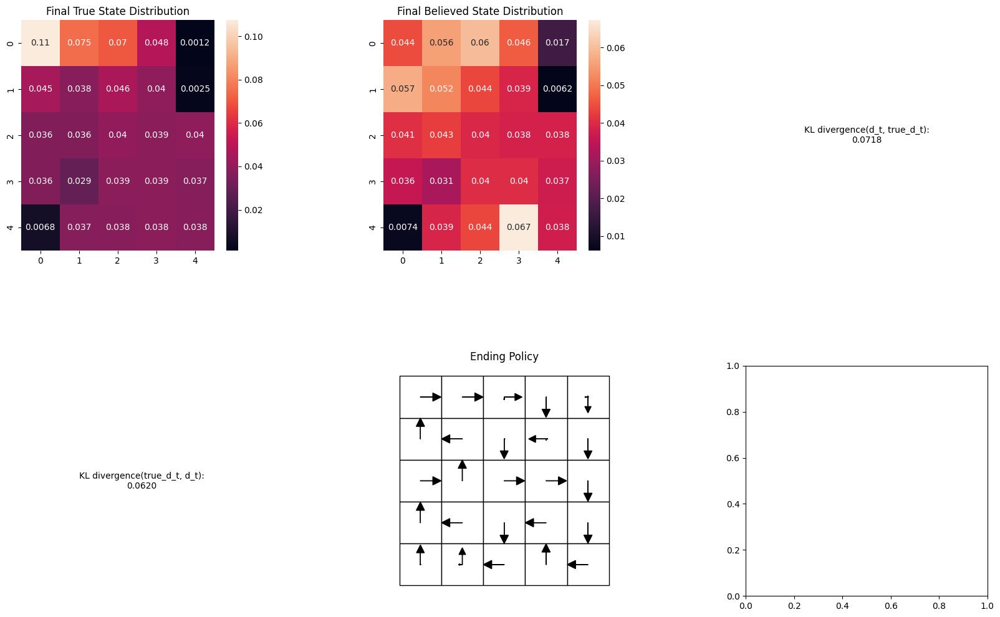

Run 0:  97%|███████████████████████████████ | 5835/6000 [44:50<01:15,  2.19it/s]

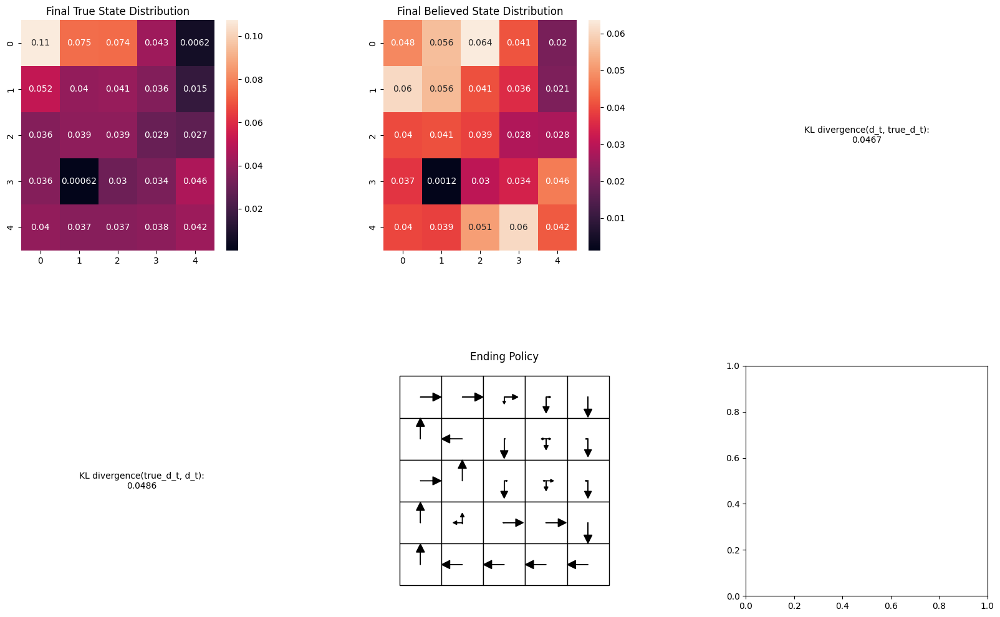

Run 0:  97%|███████████████████████████████▏| 5839/6000 [44:51<01:15,  2.13it/s]

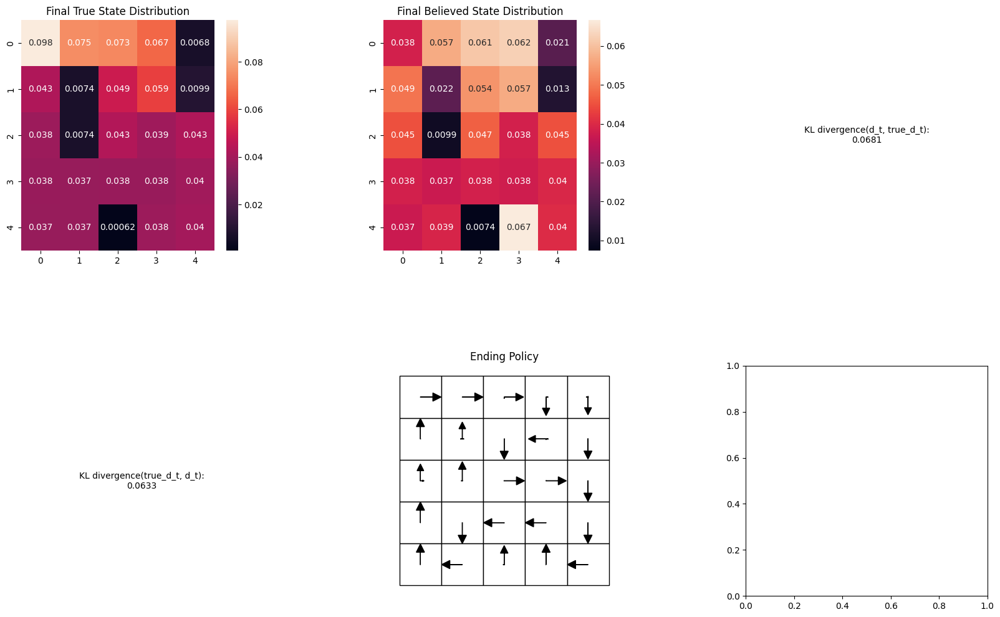

Run 0:  98%|███████████████████████████████▏| 5858/6000 [45:00<01:02,  2.27it/s]

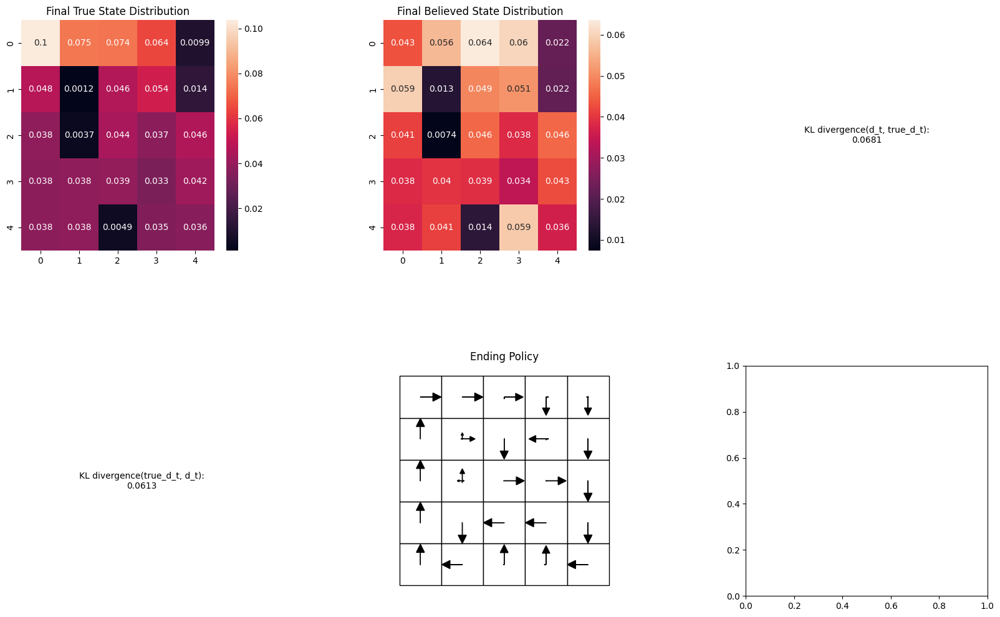

Run 0:  98%|███████████████████████████████▎| 5867/6000 [45:04<01:04,  2.05it/s]

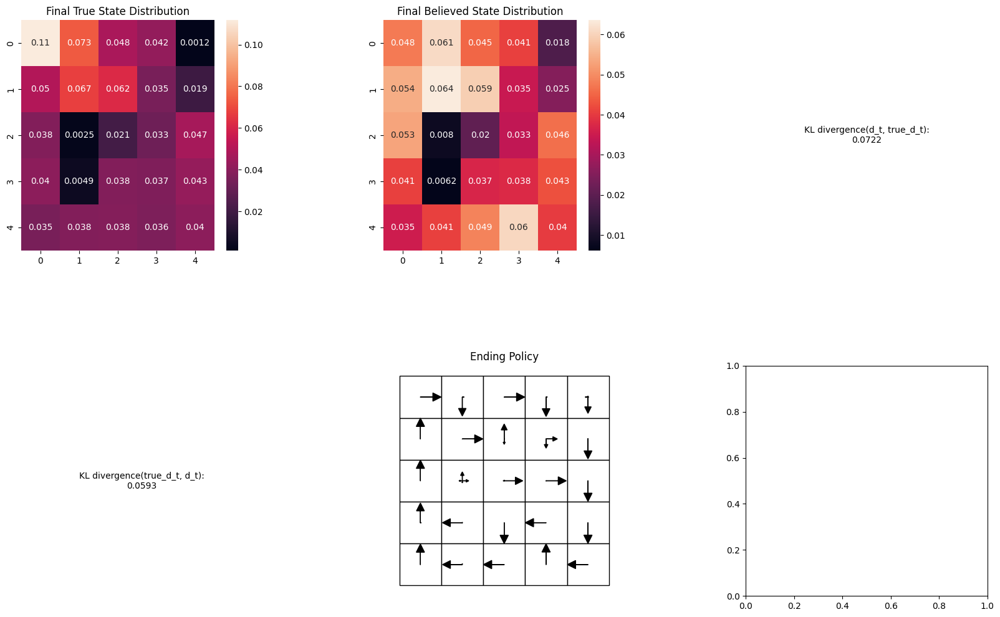

Run 0:  98%|███████████████████████████████▍| 5889/6000 [45:15<00:53,  2.07it/s]

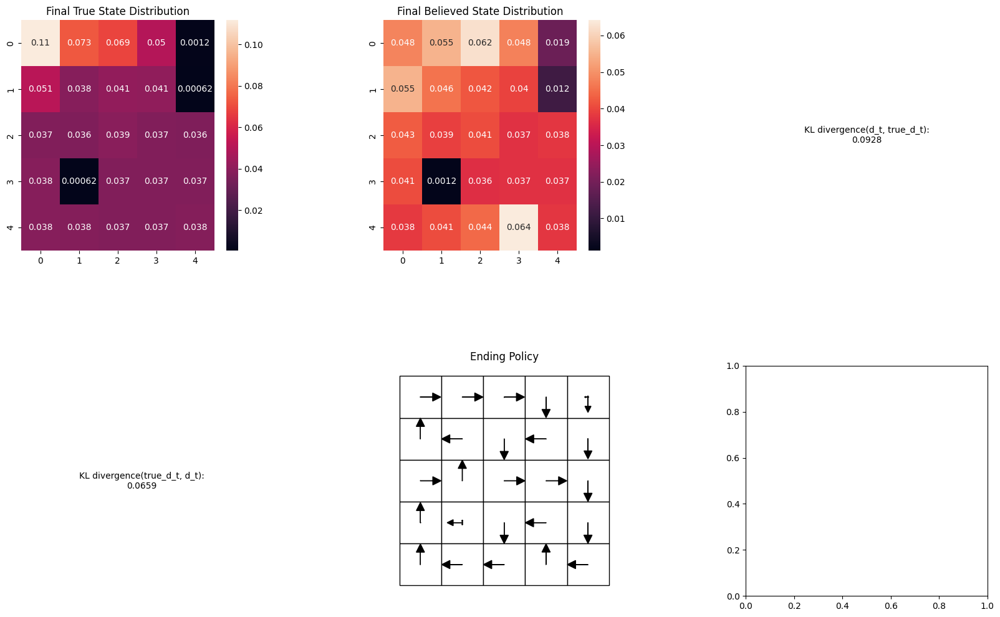

Run 0: 100%|███████████████████████████████▉| 5984/6000 [45:59<00:07,  2.14it/s]

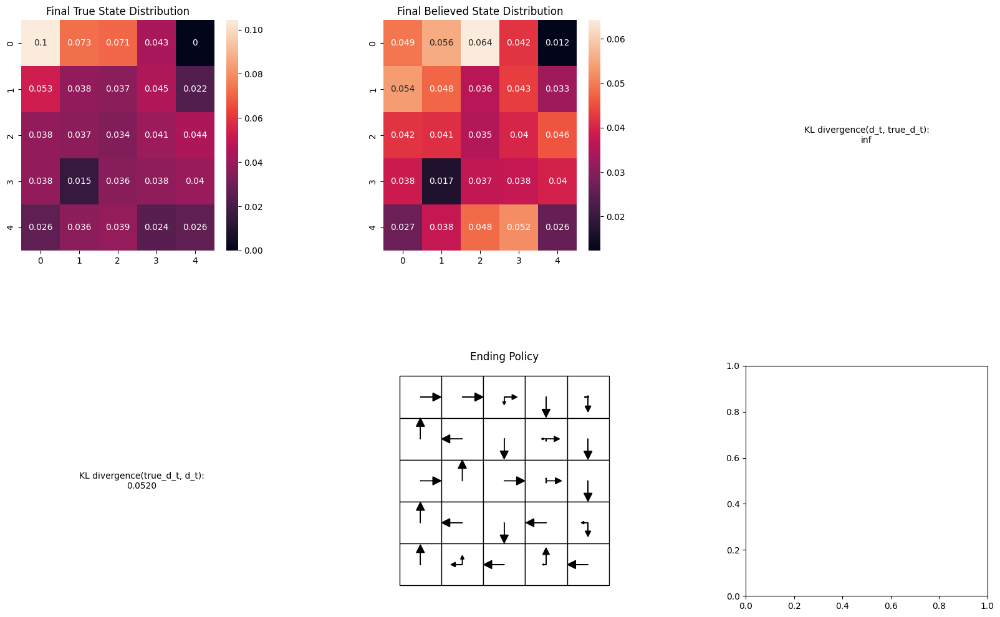

Run 0: 100%|███████████████████████████████▉| 5993/6000 [46:03<00:03,  2.25it/s]

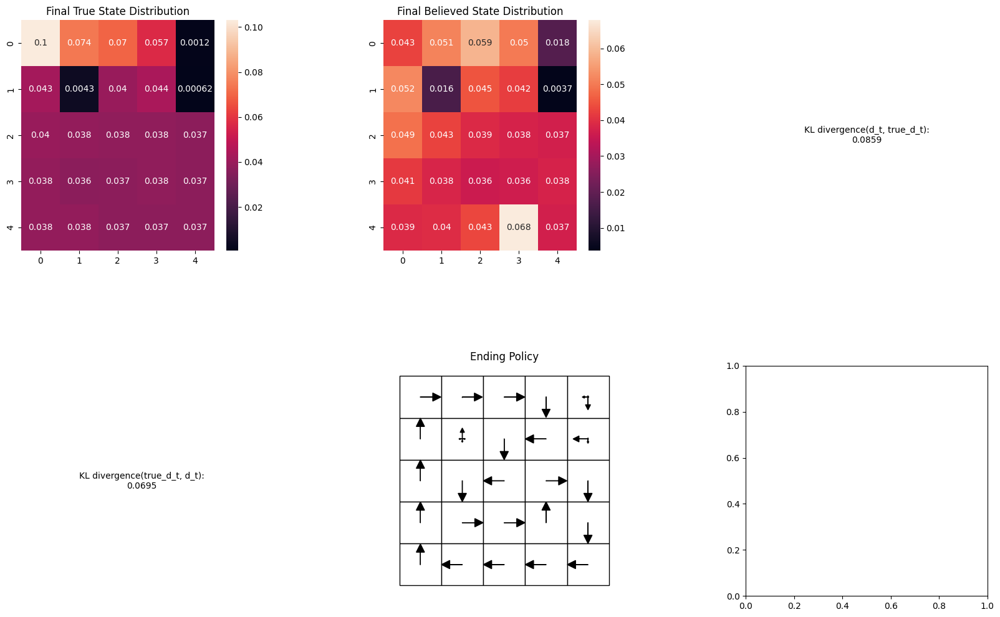

Run 0: 100%|████████████████████████████████| 6000/6000 [46:07<00:00,  2.17it/s]


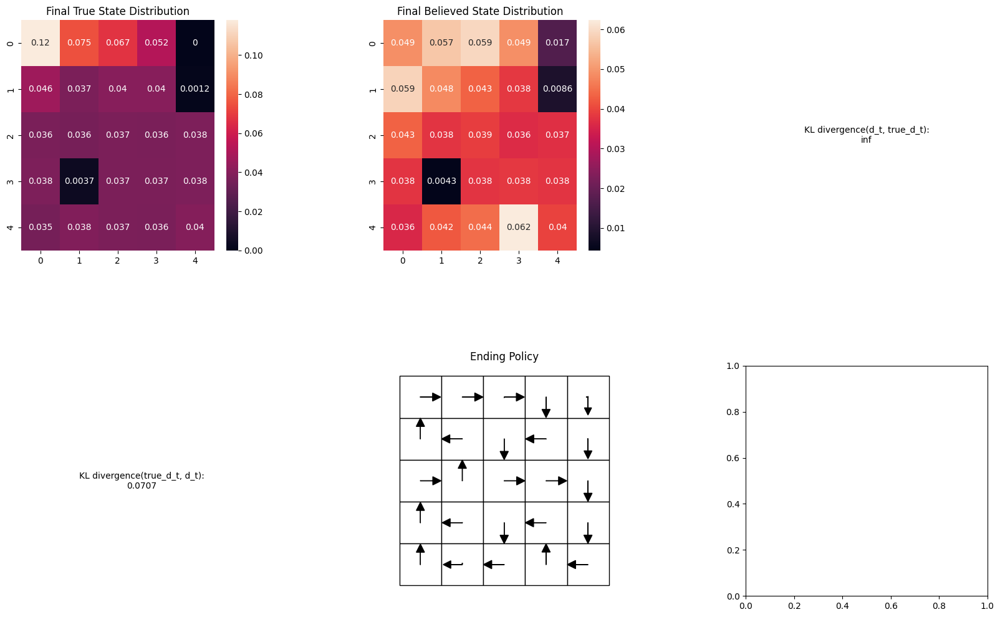

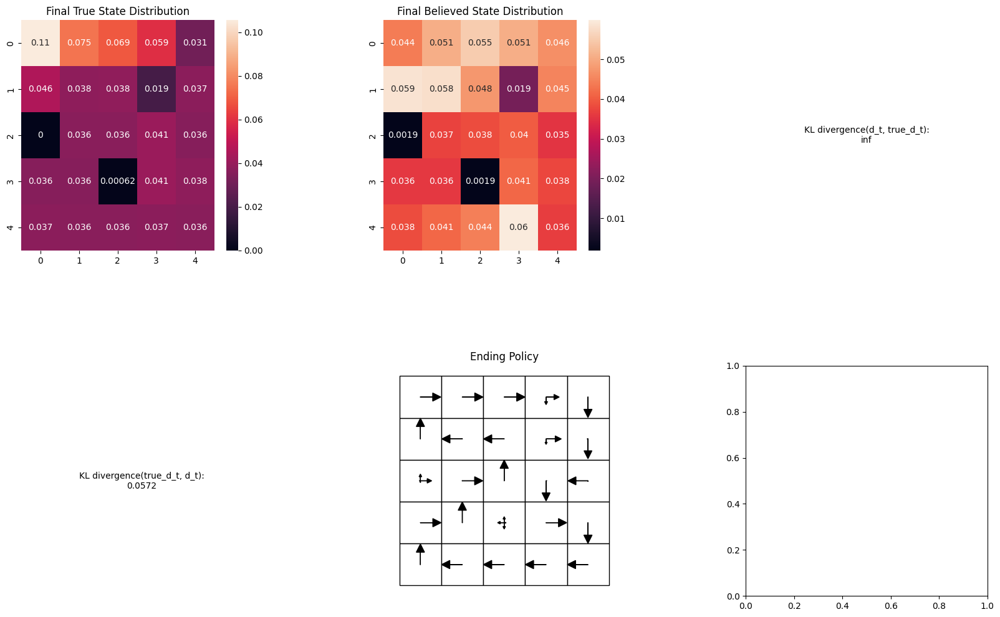

Stochastic Learned mean: 2.961689017467824


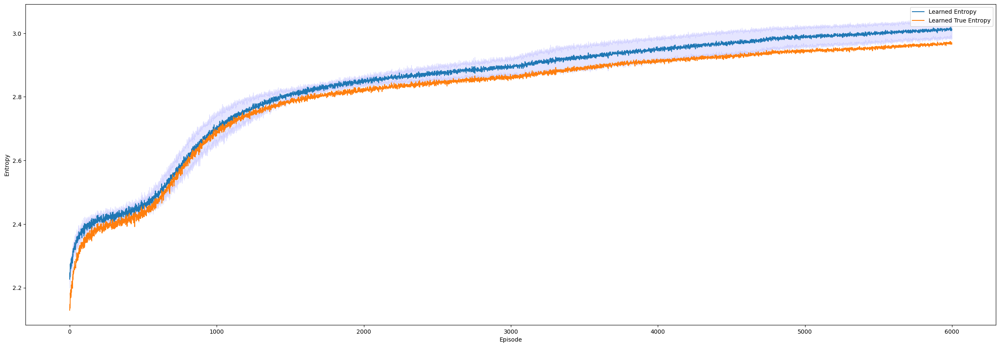

In [21]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
uniform=0
prob=0
randomize=0
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon+2, steepness,uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

## Deterministic Entropy POMDP Random Initial Position

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:  98%|████████████████████████████▎| 9751/10000 [1:06:32<01:55,  2.16it/s]

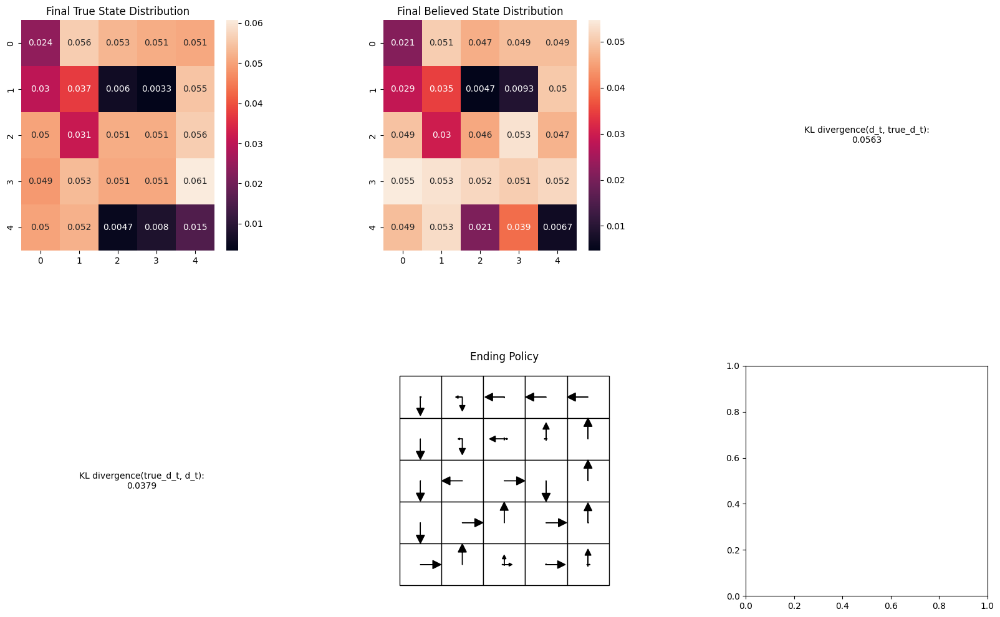

Run 0:  98%|████████████████████████████▎| 9754/10000 [1:06:34<01:48,  2.26it/s]

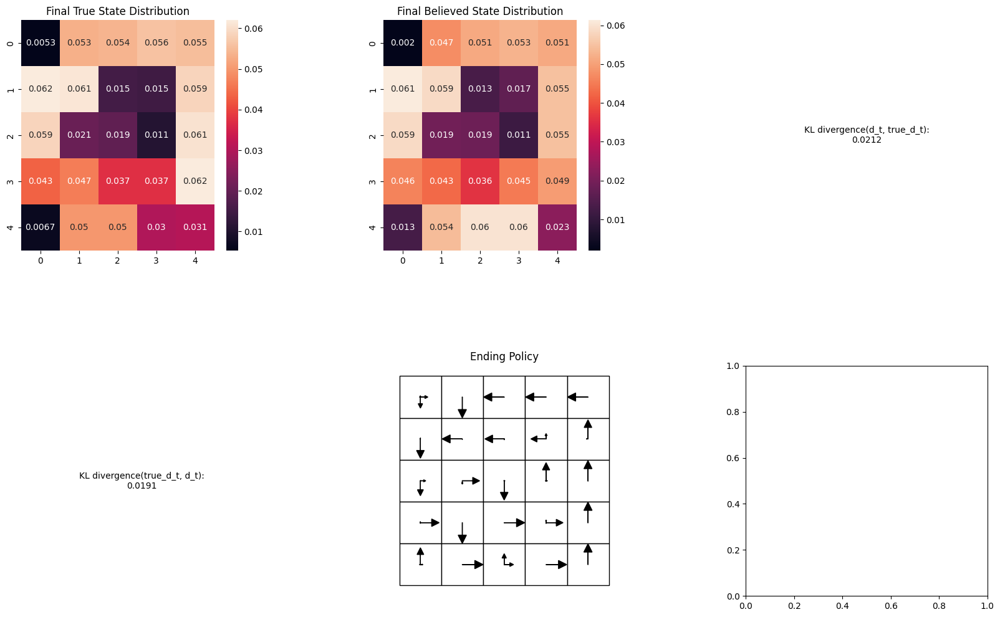

Run 0:  98%|████████████████████████████▎| 9774/10000 [1:06:42<01:36,  2.34it/s]

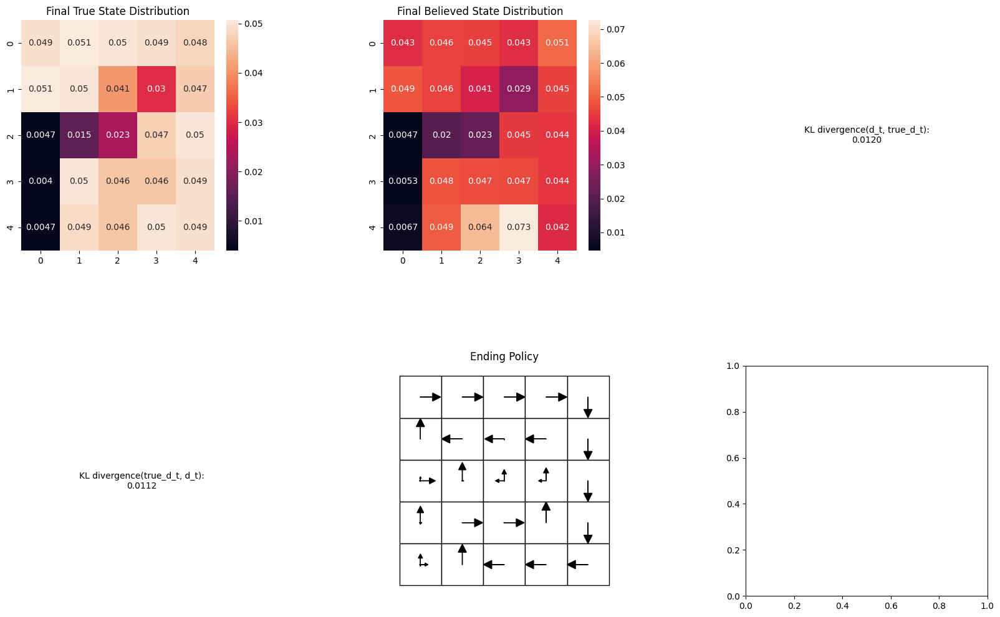

Run 0:  98%|████████████████████████████▎| 9780/10000 [1:06:45<01:32,  2.39it/s]

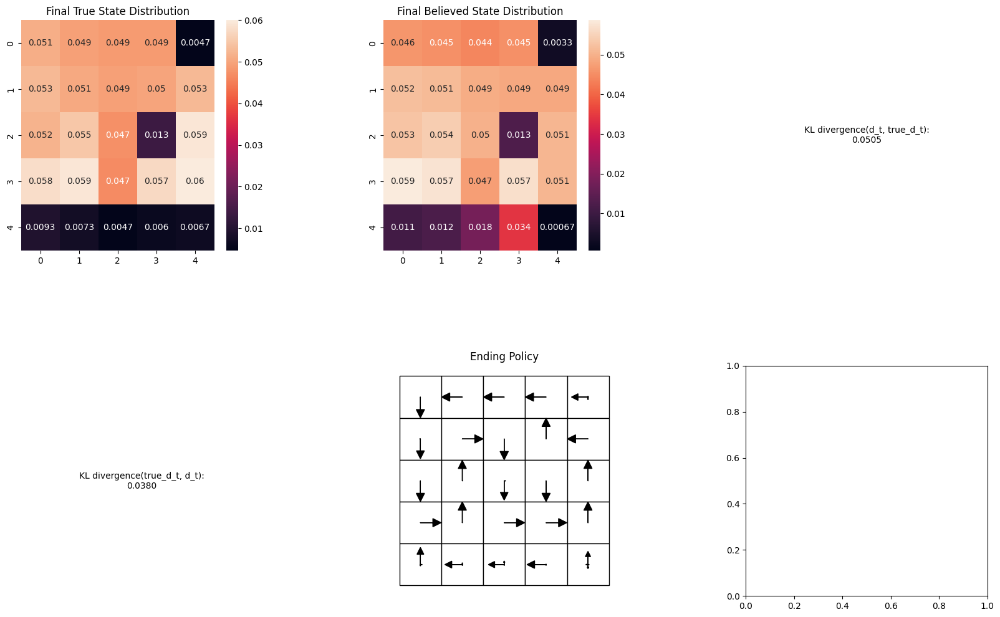

Run 0:  98%|████████████████████████████▍| 9797/10000 [1:06:52<01:32,  2.19it/s]

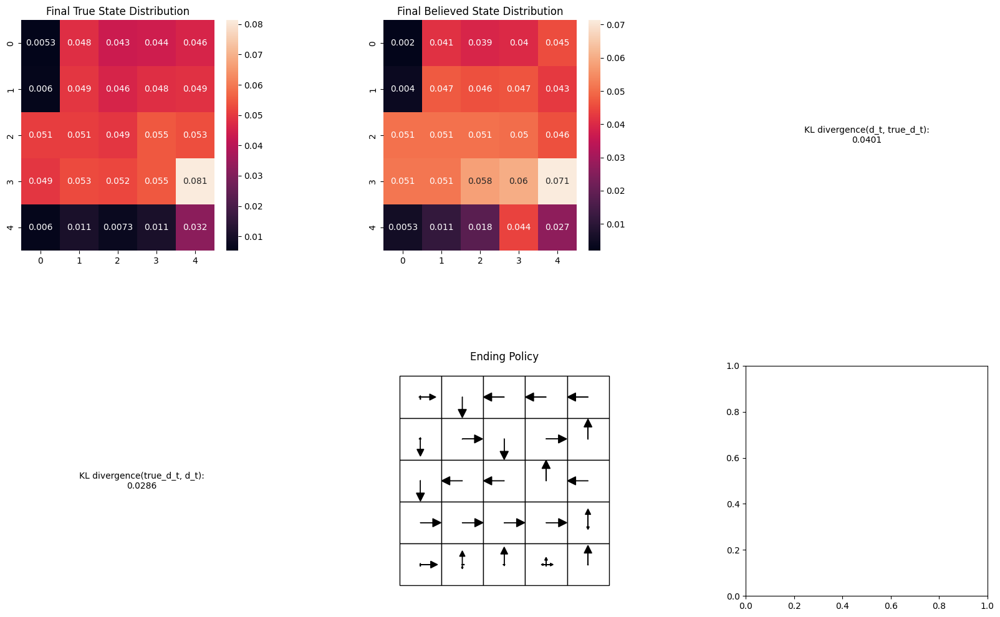

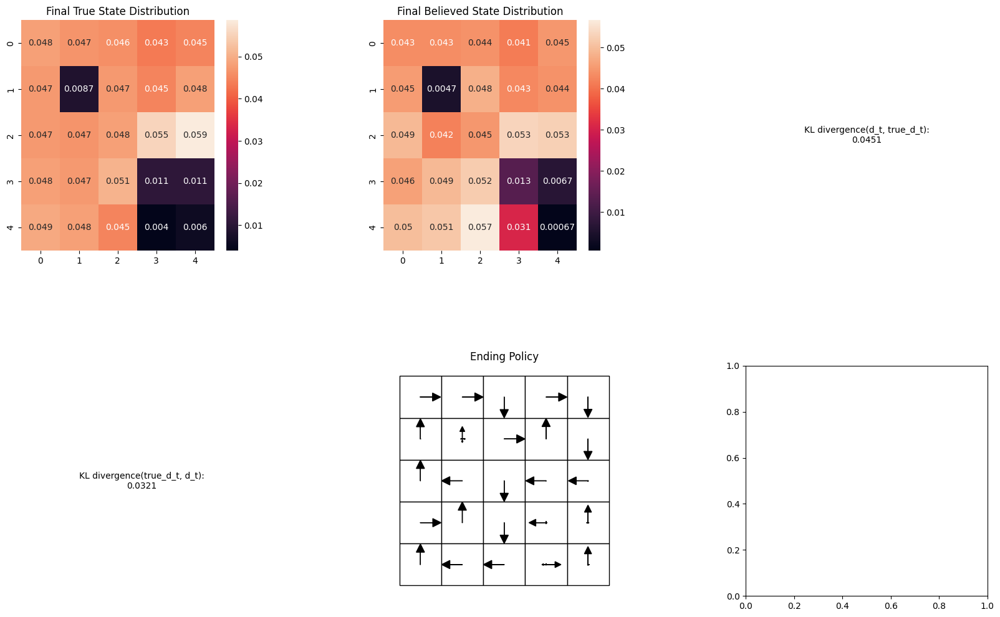

Run 0:  98%|████████████████████████████▍| 9819/10000 [1:07:02<01:16,  2.35it/s]

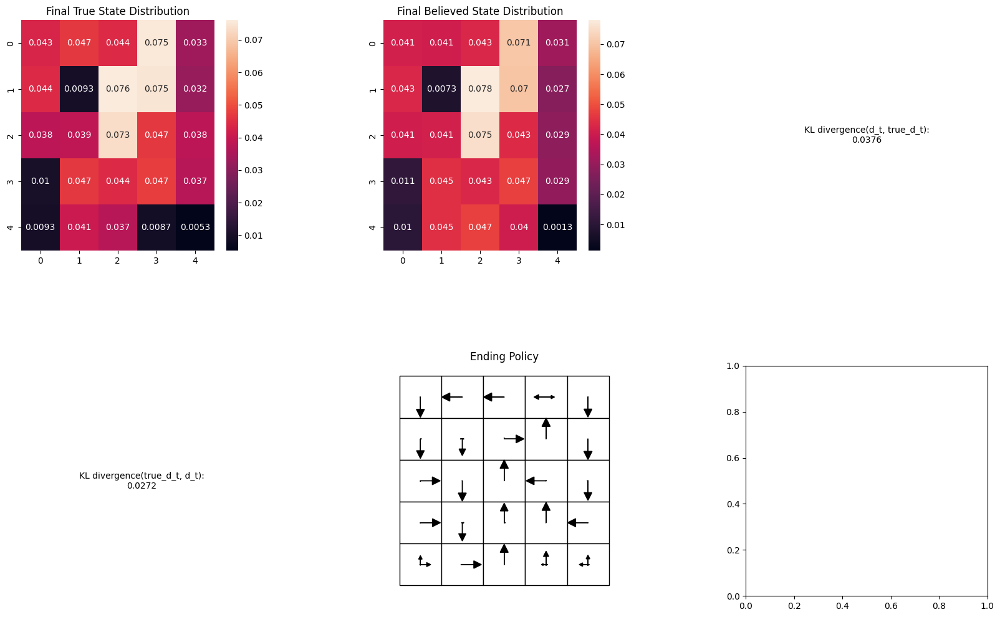

Run 0:  98%|████████████████████████████▍| 9821/10000 [1:07:03<01:14,  2.40it/s]

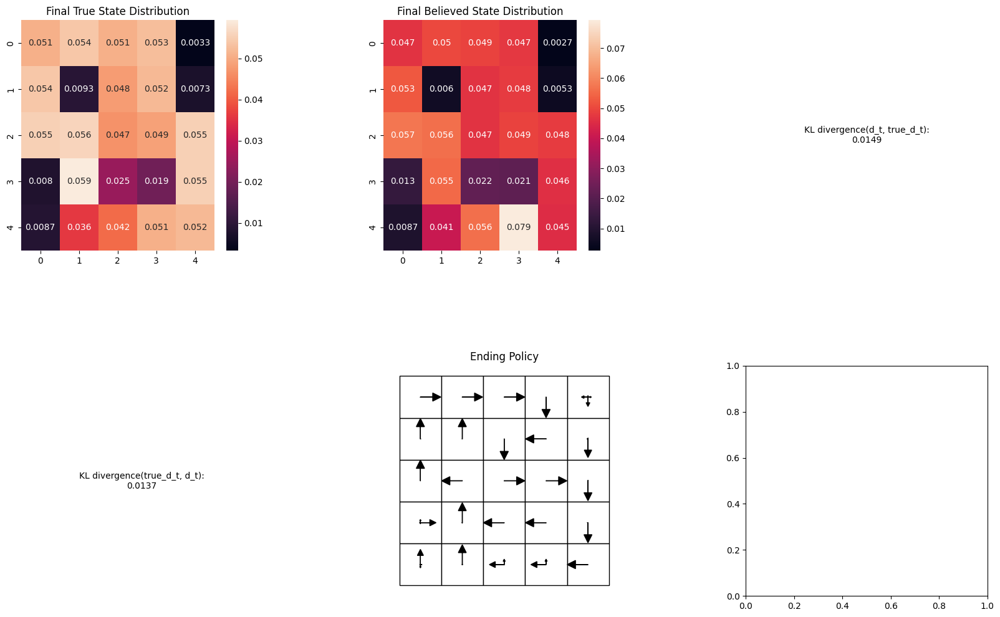

Run 0:  98%|████████████████████████████▍| 9827/10000 [1:07:05<01:09,  2.48it/s]

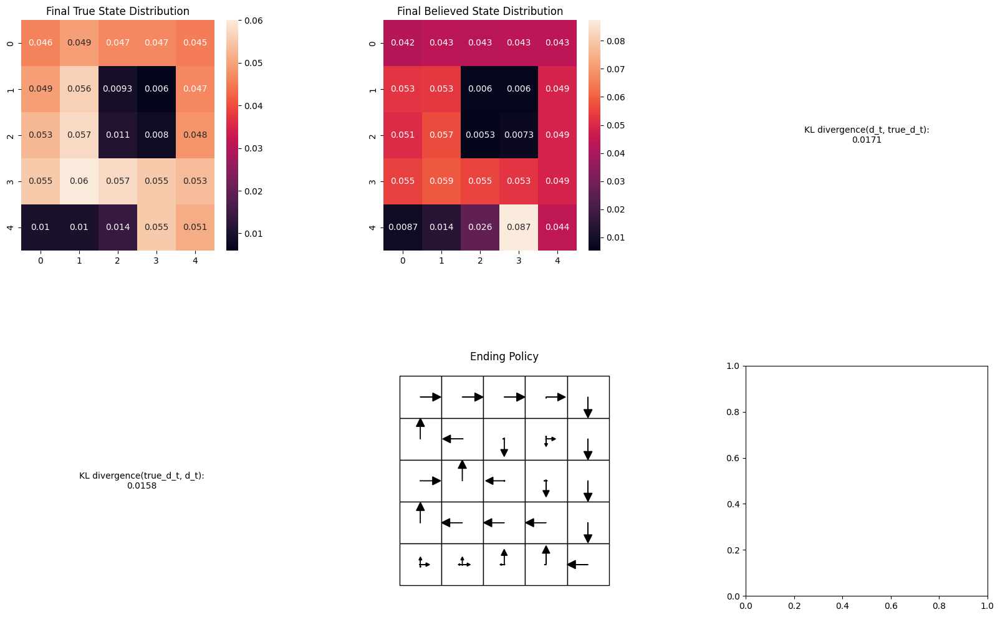

Run 0: 100%|████████████████████████████| 10000/10000 [1:08:13<00:00,  2.44it/s]


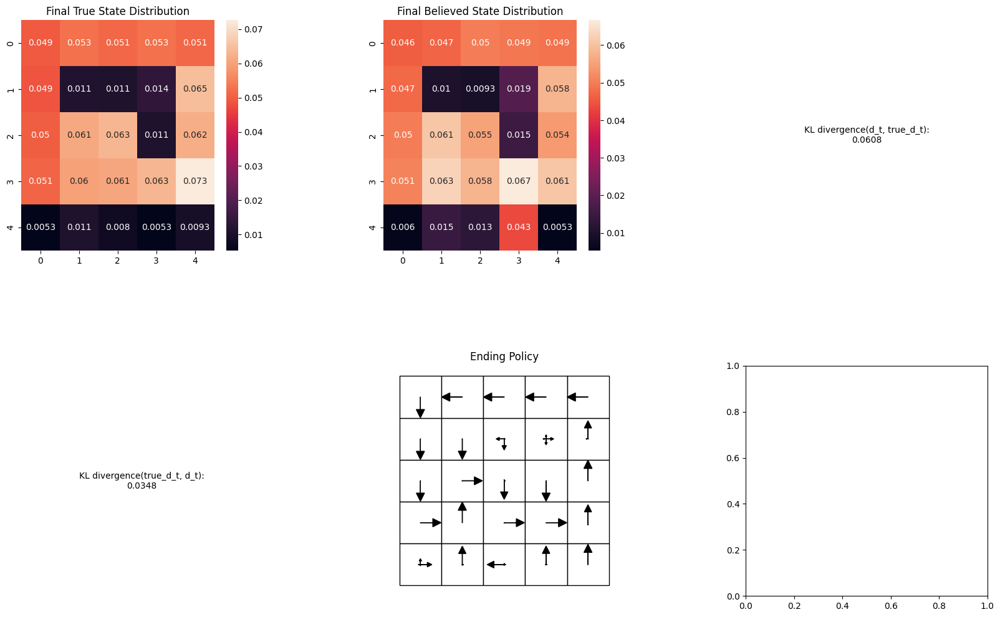

TypeError: slice indices must be integers or None or have an __index__ method

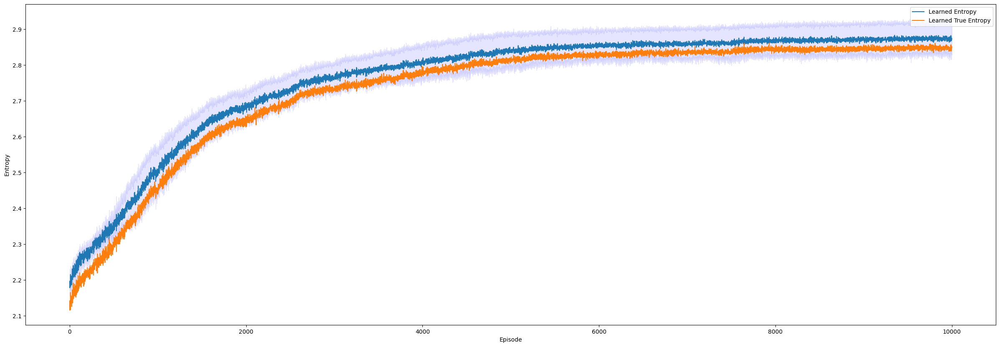

In [ ]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 4
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
uniform=0
prob=0
randomize=1
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP random initial position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

In [ ]:
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

Stochastic Learned mean: 2.847840447849765


## Deterministic Entropy POMDP, Longer Time Horizon

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0: 100%|█████████████████████████████▉| 5984/6000 [1:17:26<00:12,  1.31it/s]

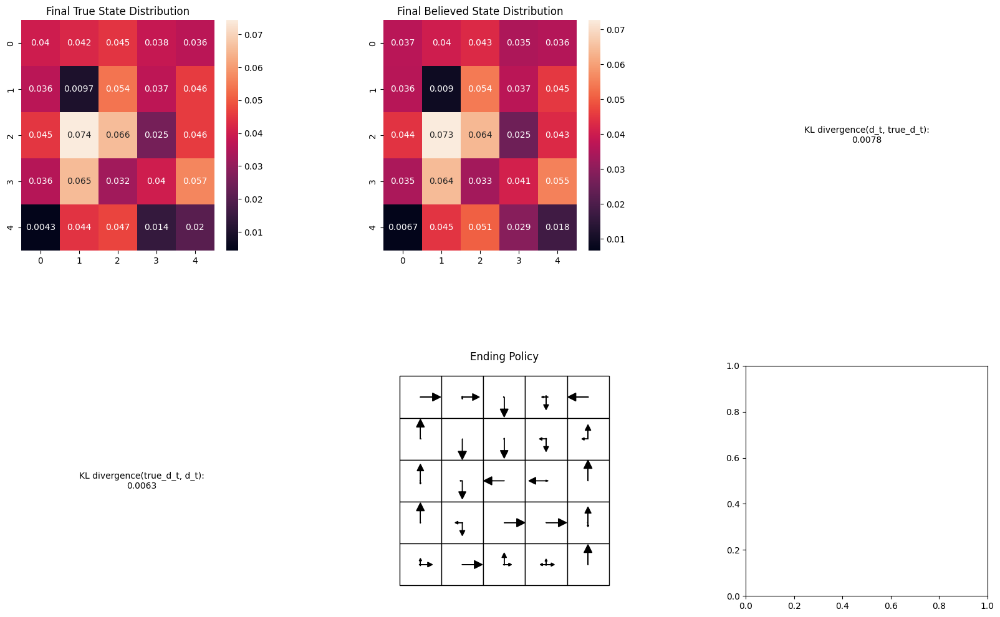

Run 0: 100%|██████████████████████████████| 6000/6000 [1:17:38<00:00,  1.29it/s]


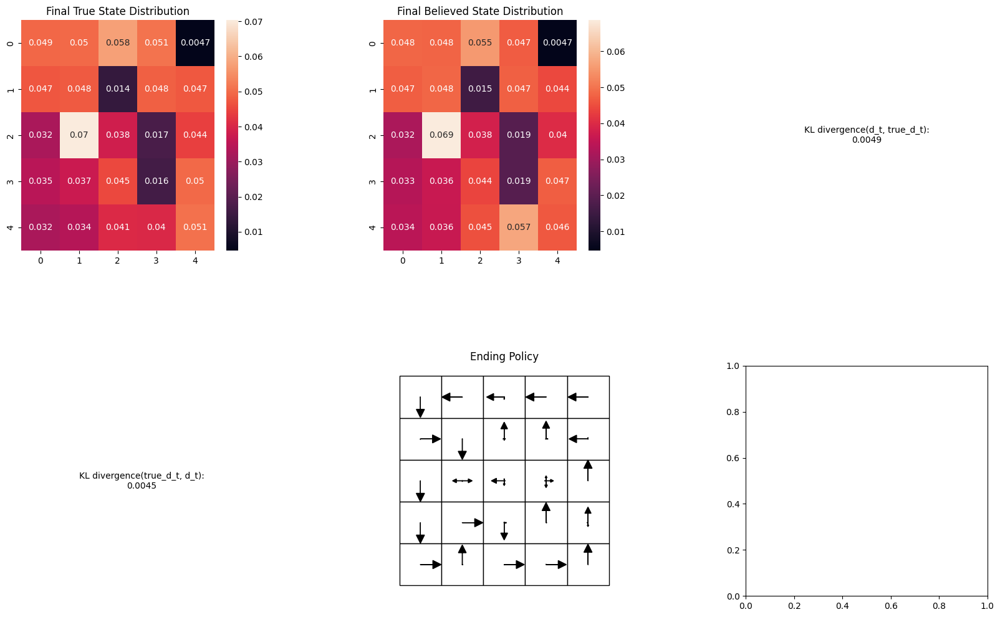

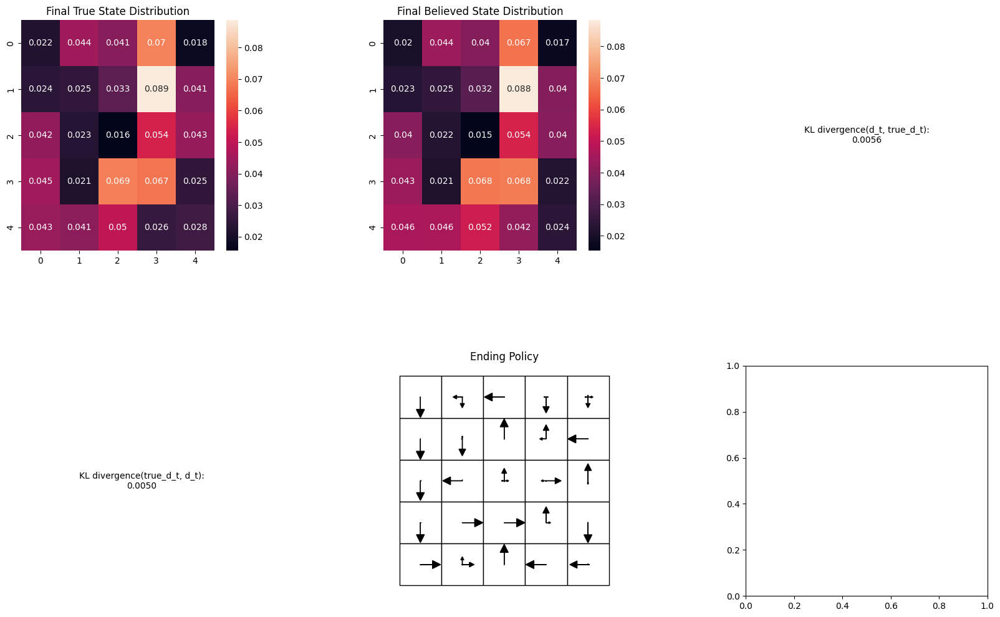

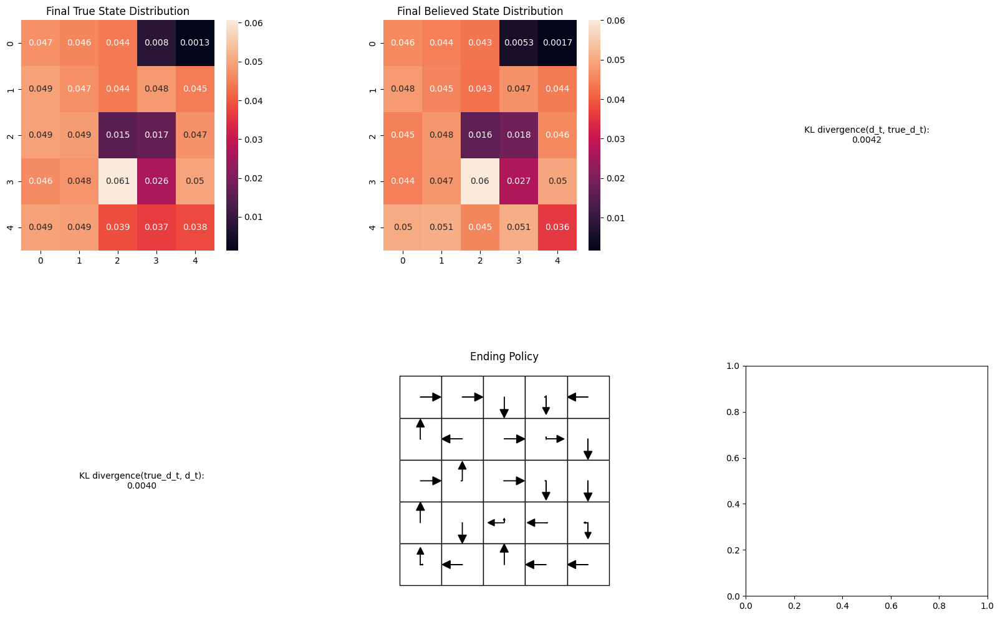

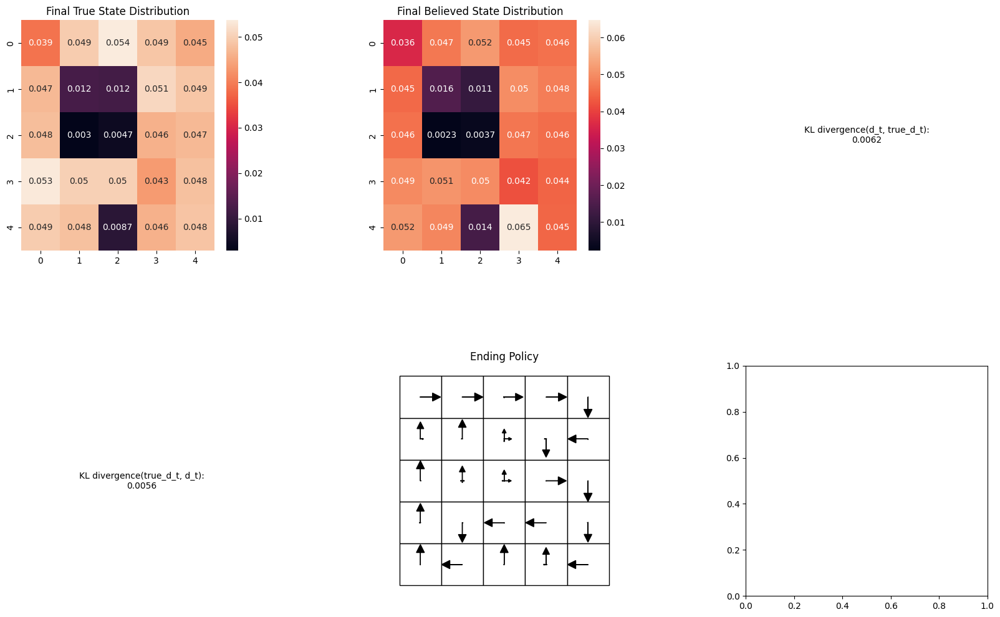

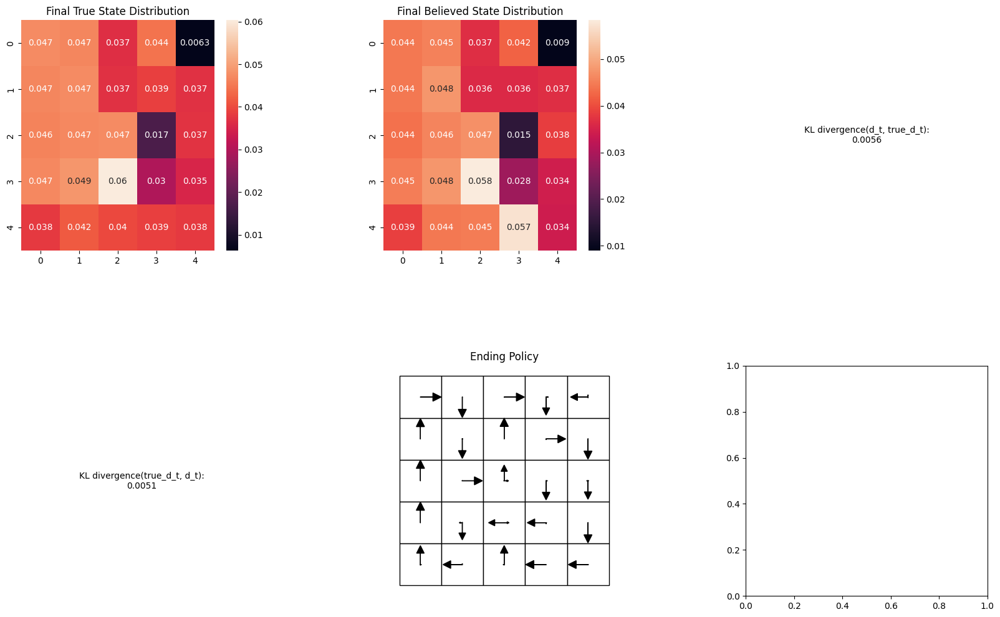

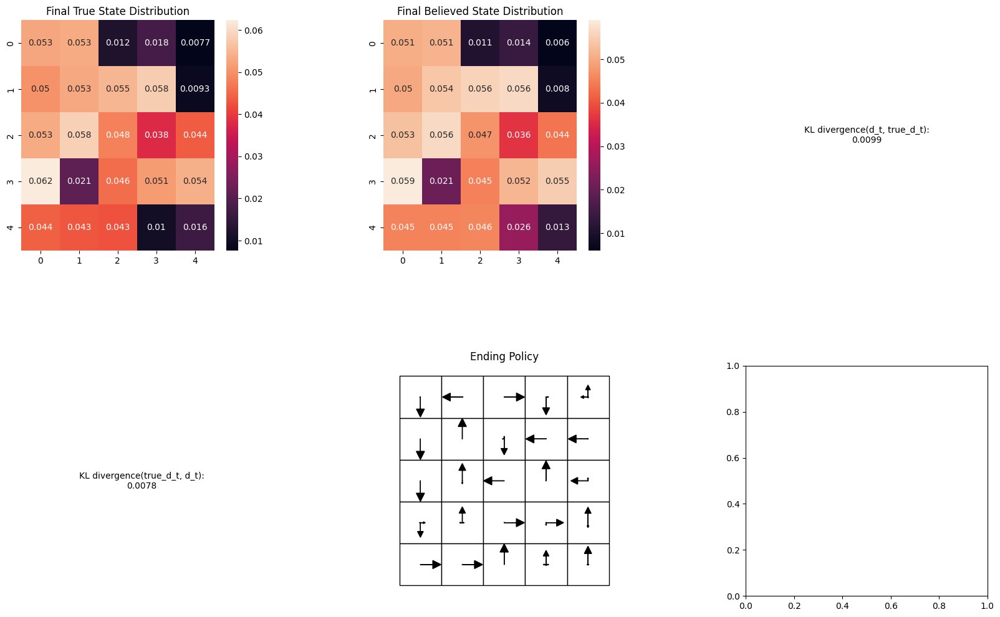

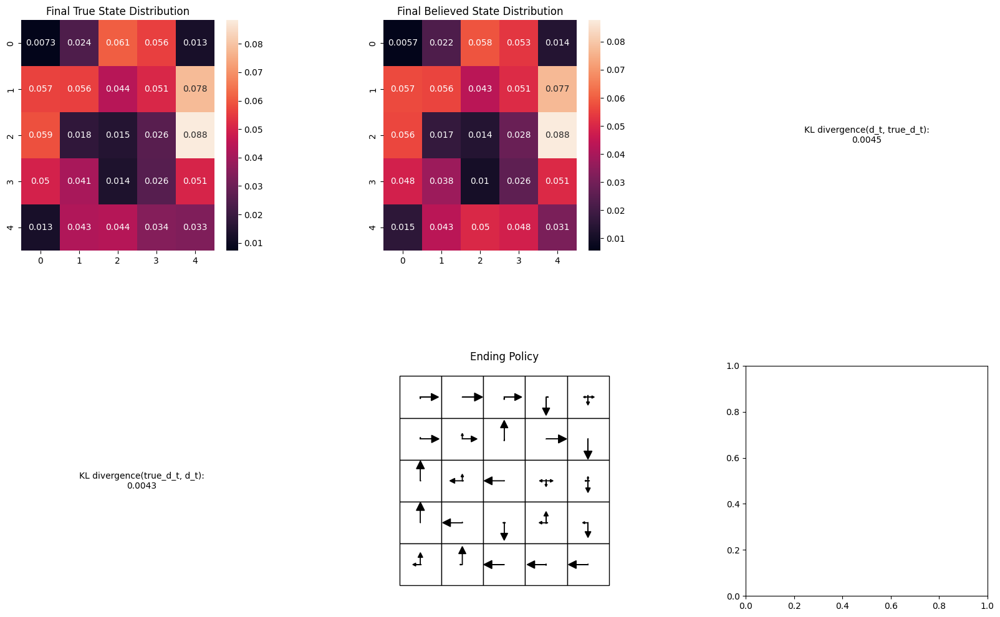

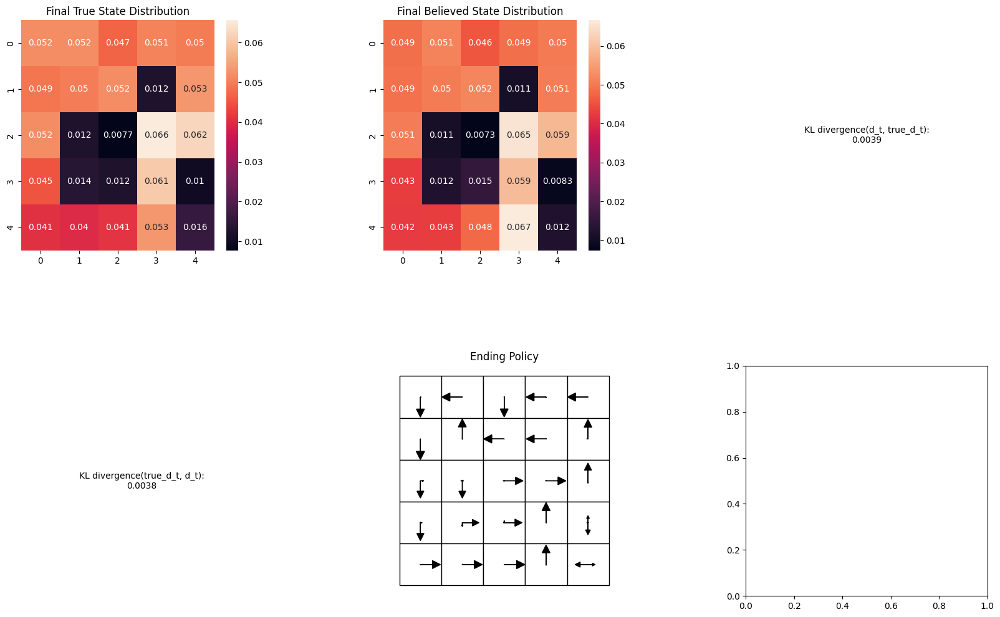

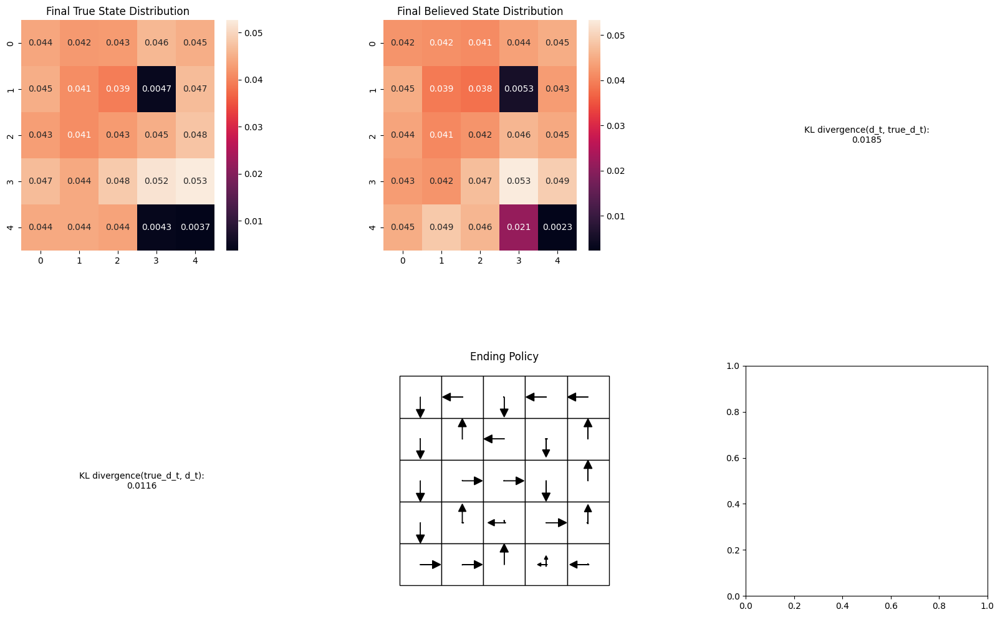

Stochastic Learned mean: 2.9814663404878066


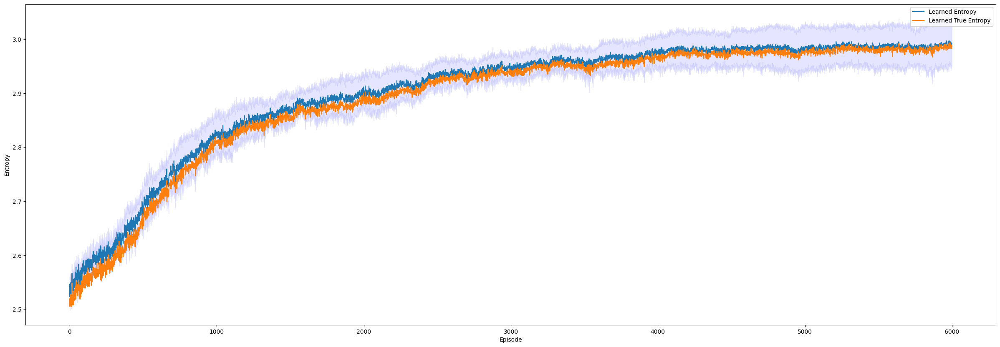

In [ ]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=15
uniform=0
prob=0
randomize=1
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP longer time_horizon")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

## Stochastic Entropy POMDP

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                           | 0/8000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

Run 0: 100%|███████████████████████████████▊| 7965/8000 [51:43<00:13,  2.59it/s]

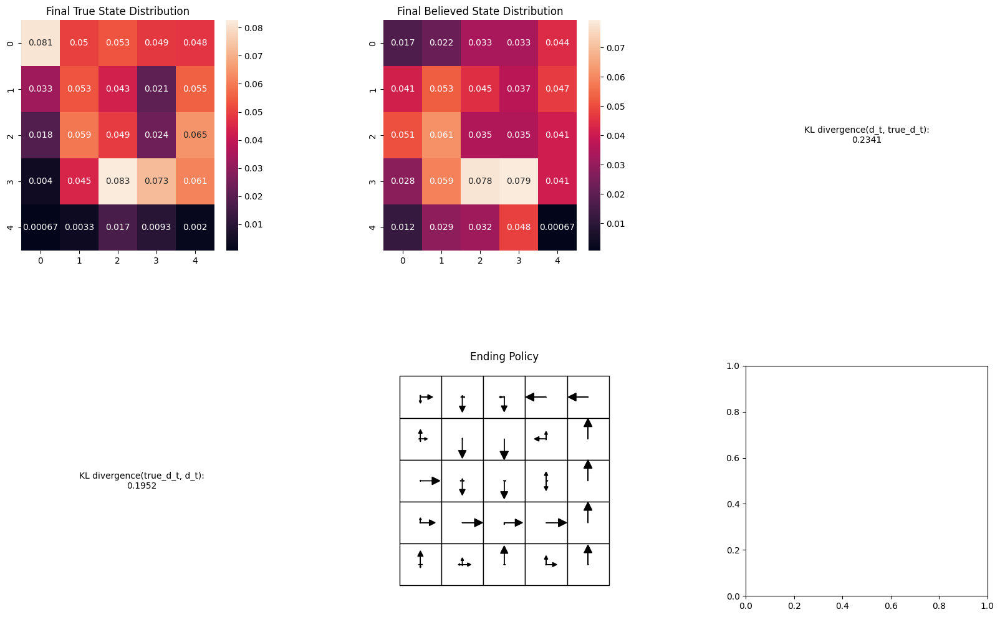

Run 0: 100%|████████████████████████████████| 8000/8000 [51:56<00:00,  2.57it/s]


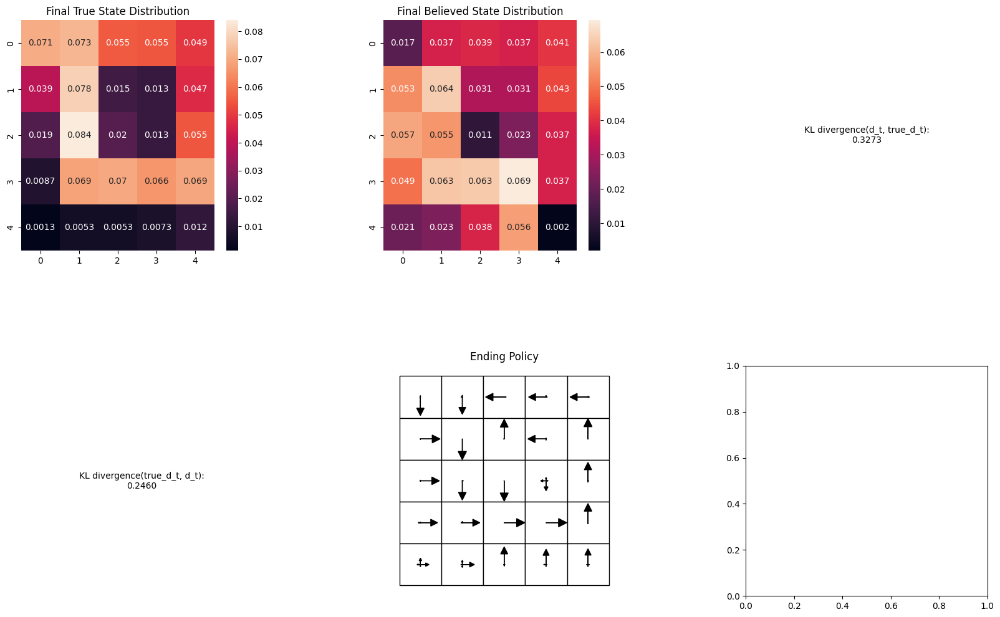

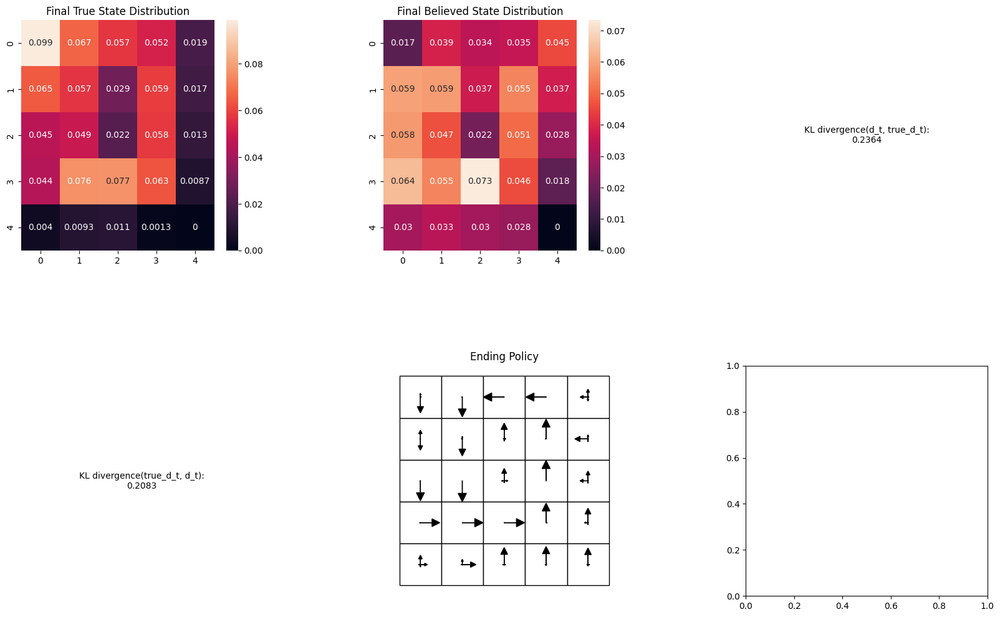

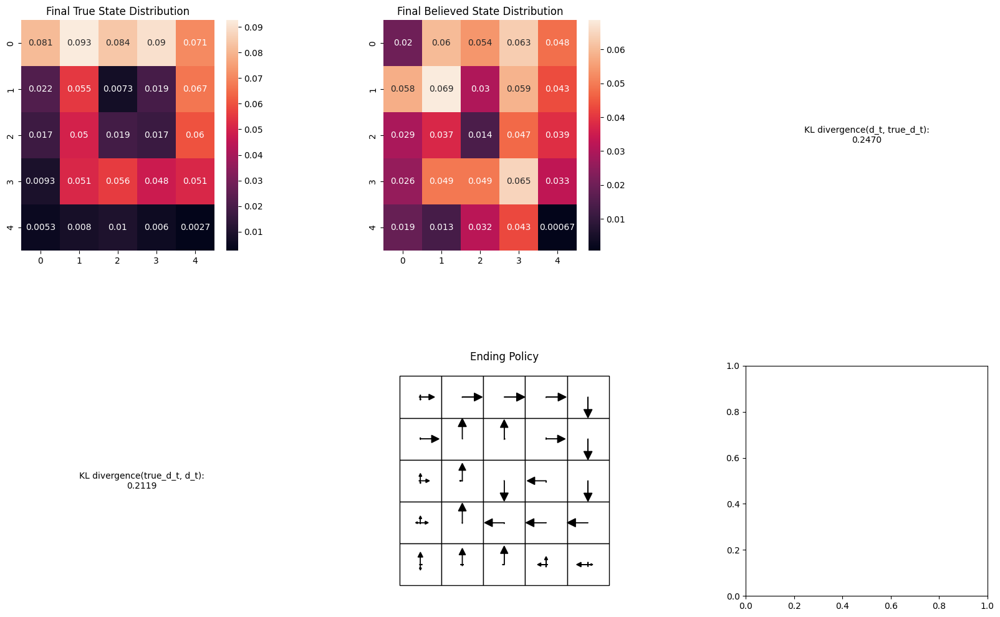

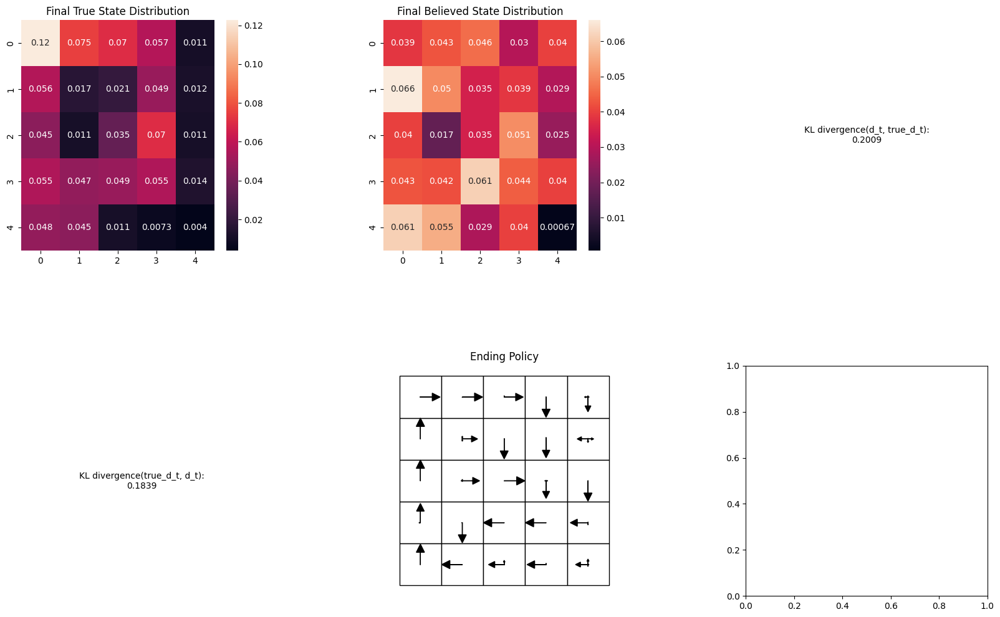

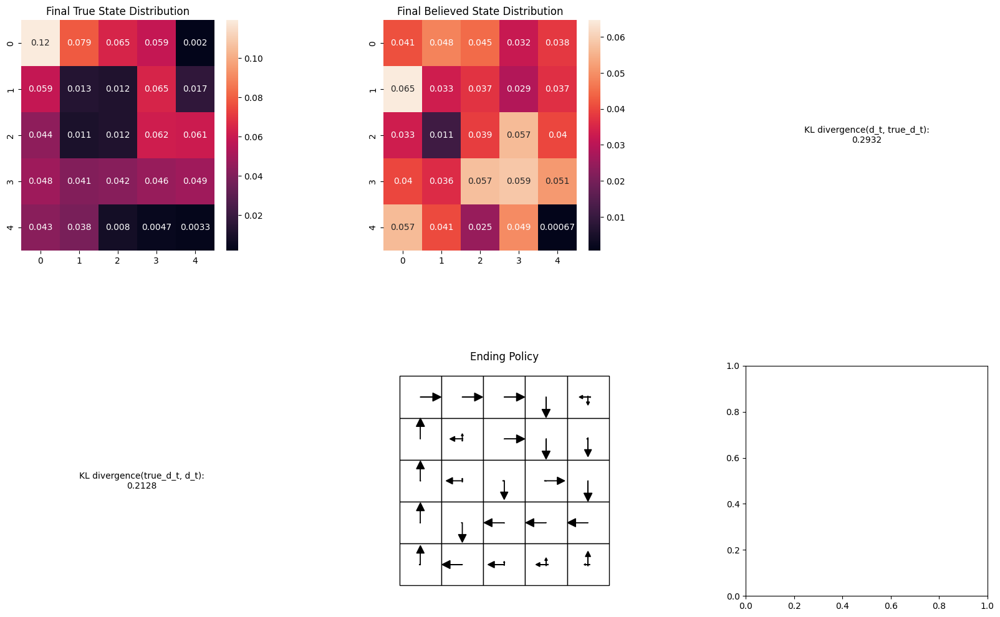

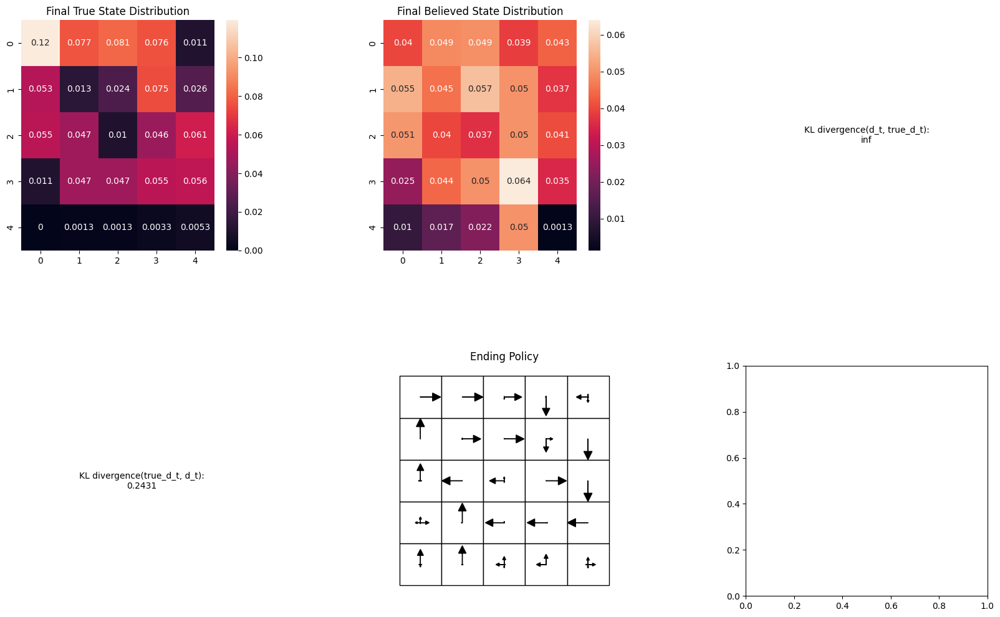

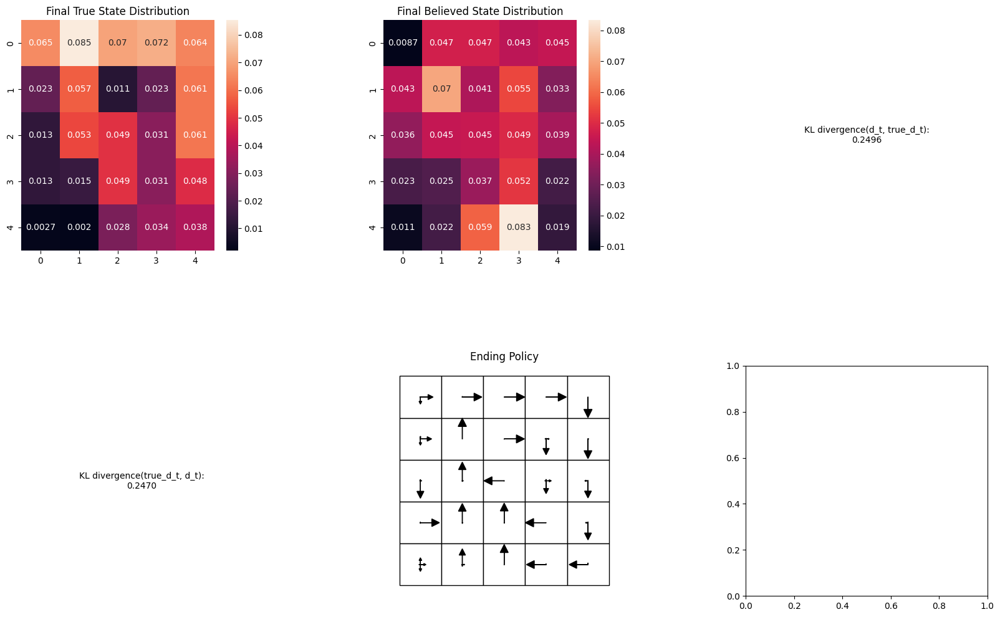

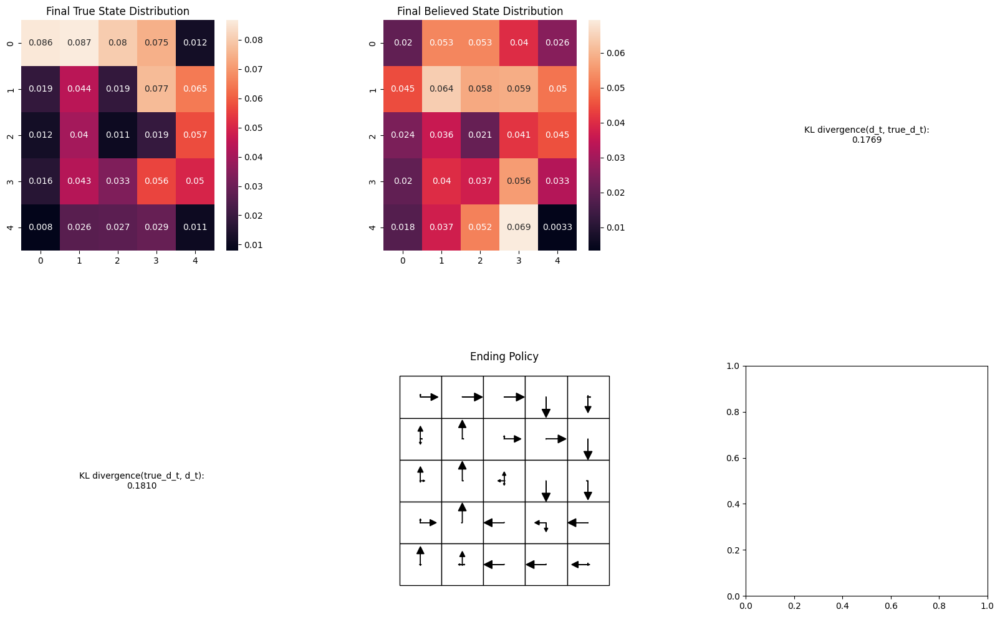

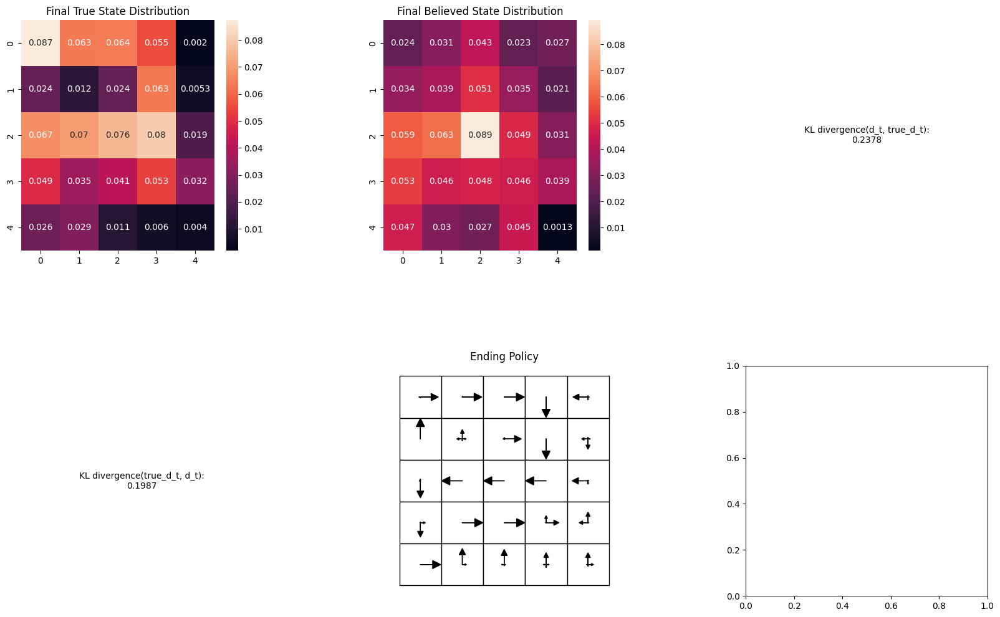

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Stochastic Learned mean: nan


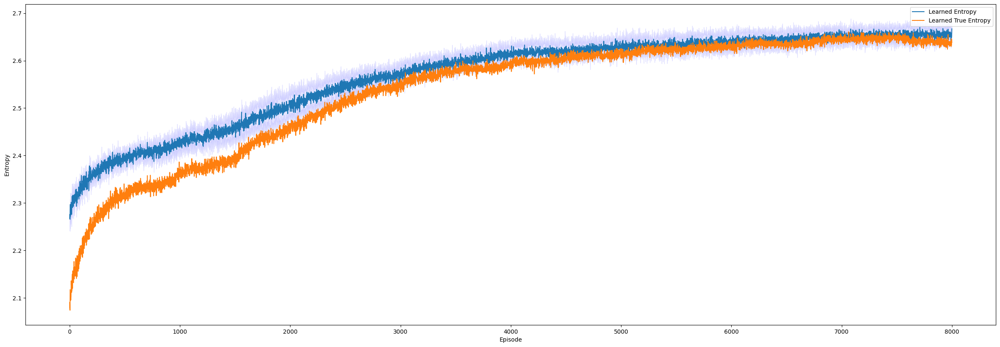

In [ ]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
uniform=0
prob=0.1
randomize=0
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

## Stochastic Entropy POMDP with Random Initial Position

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

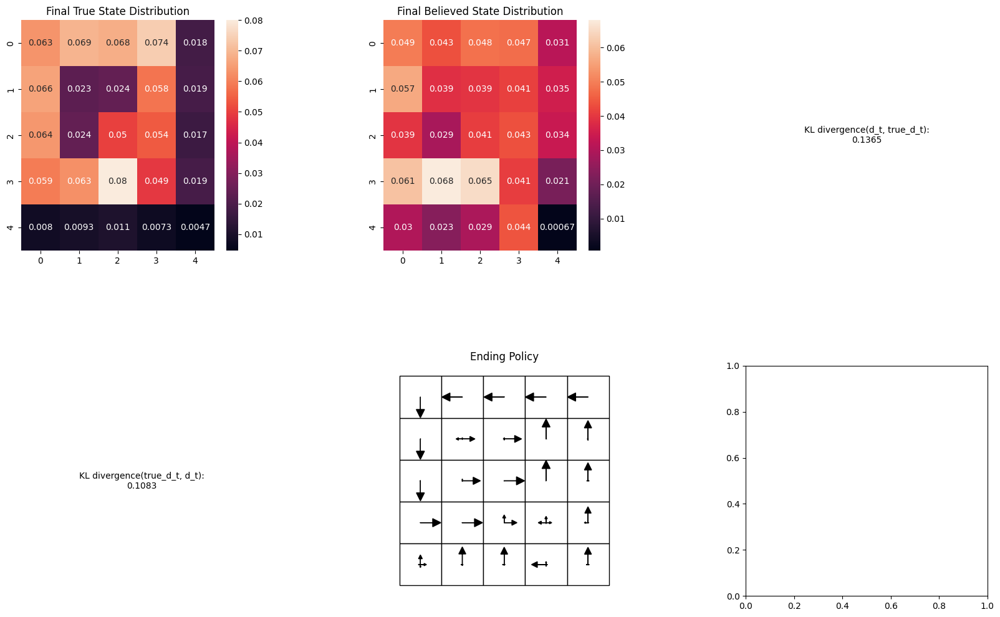

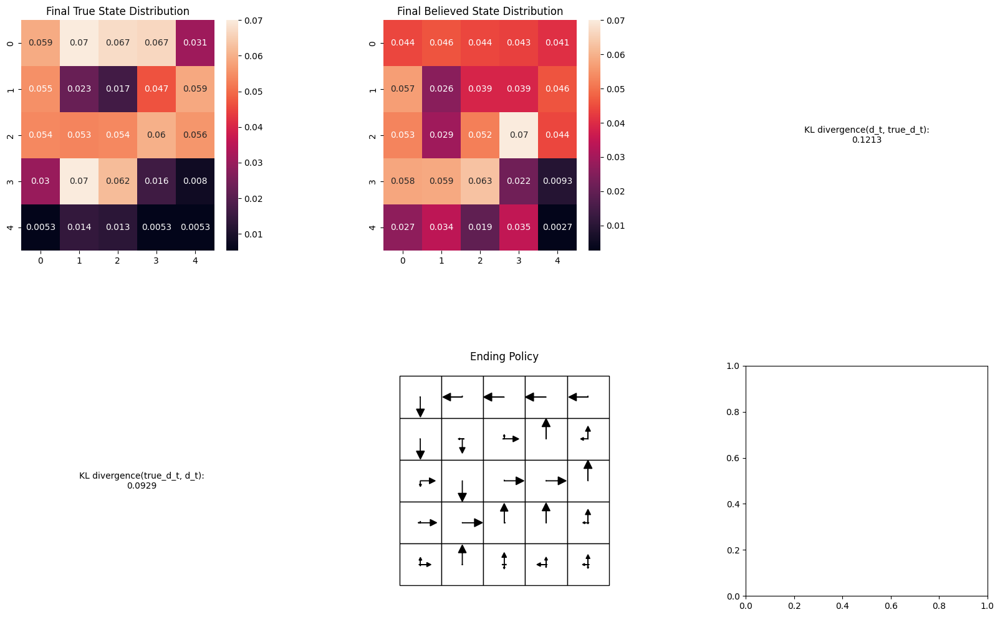

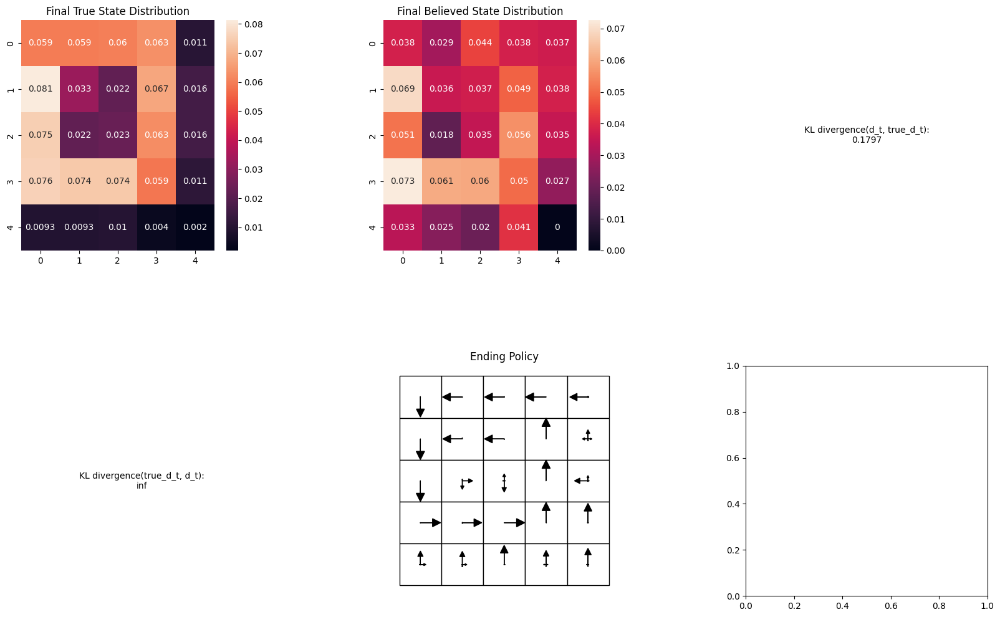

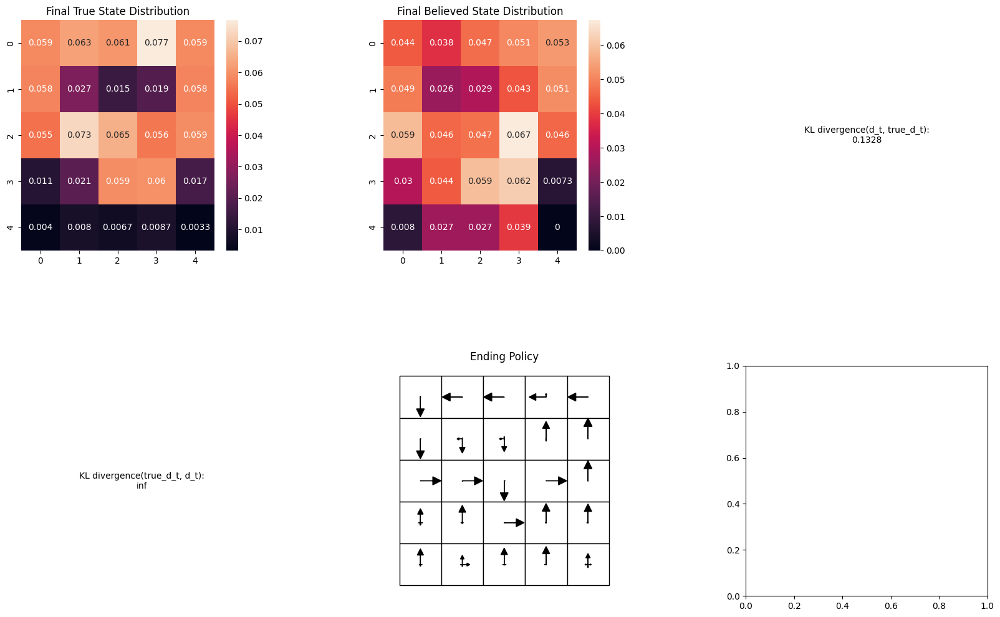

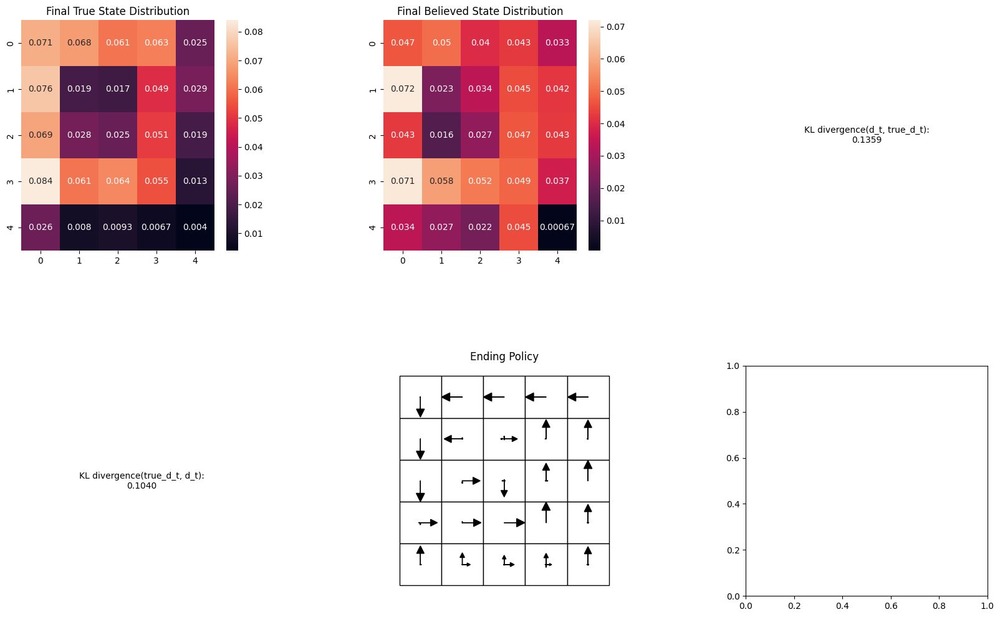

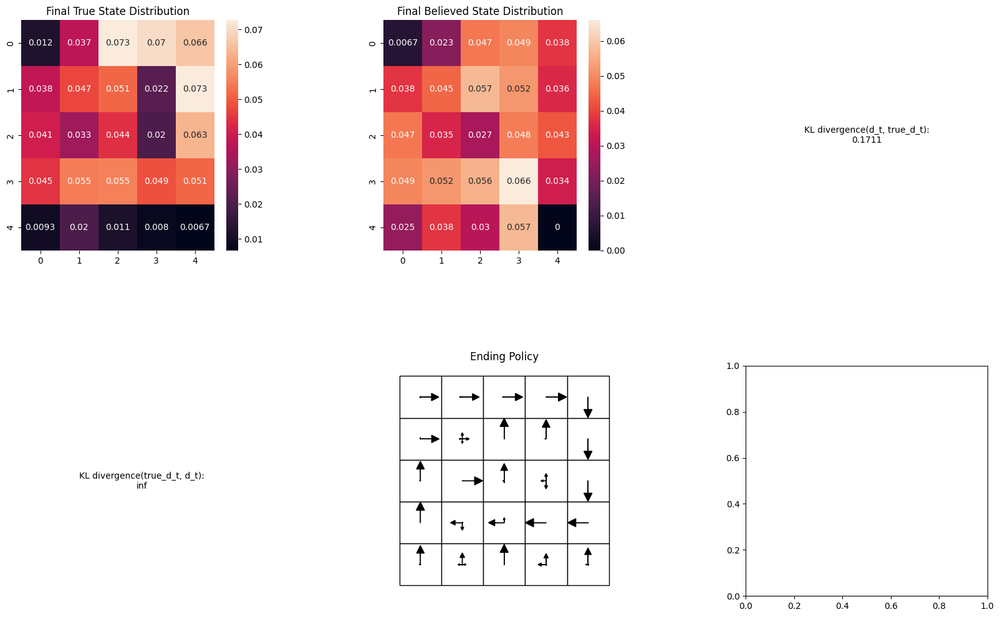

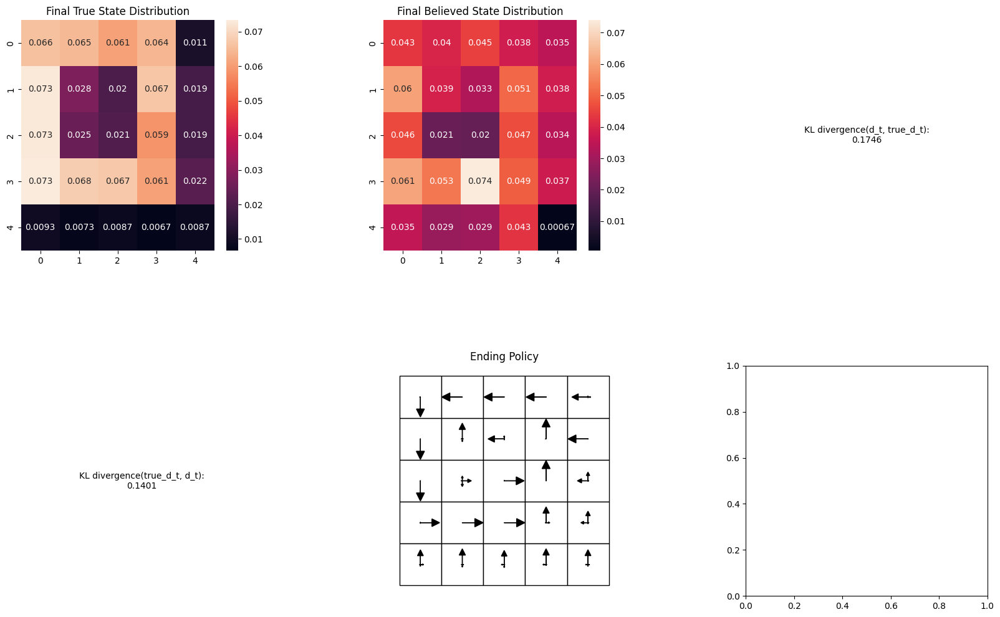

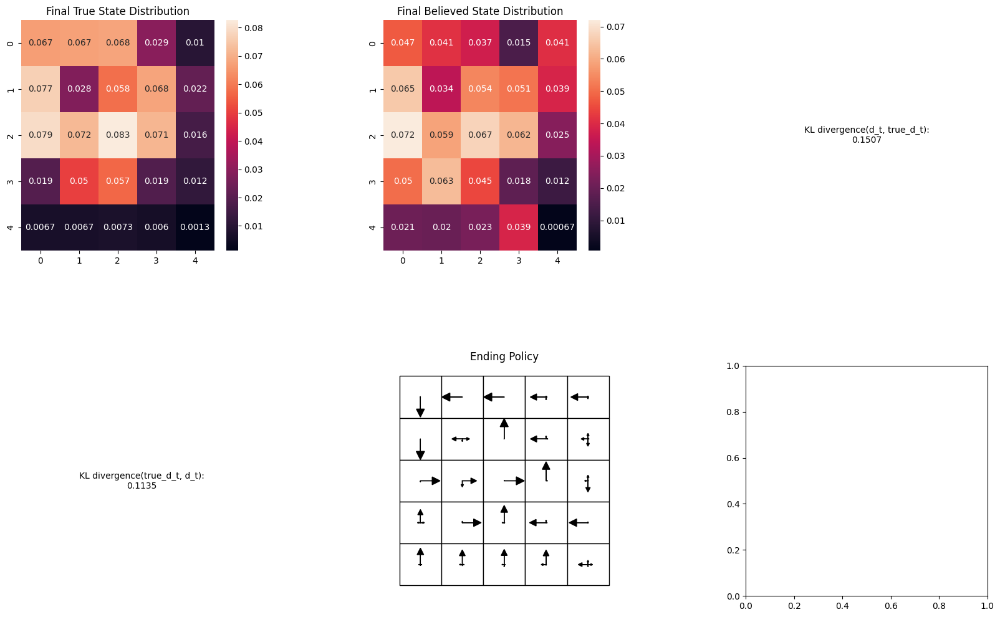

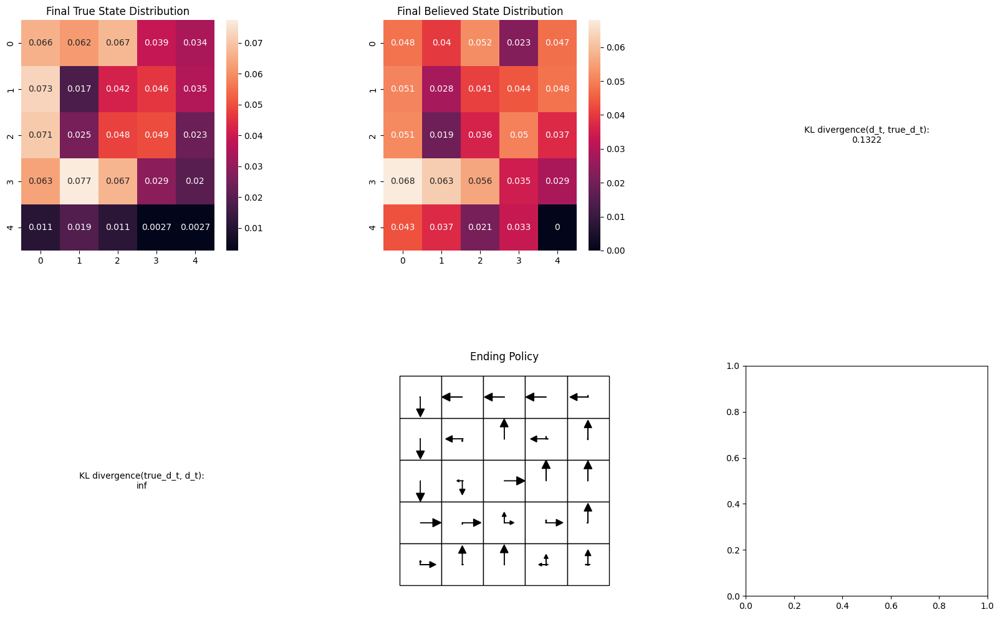

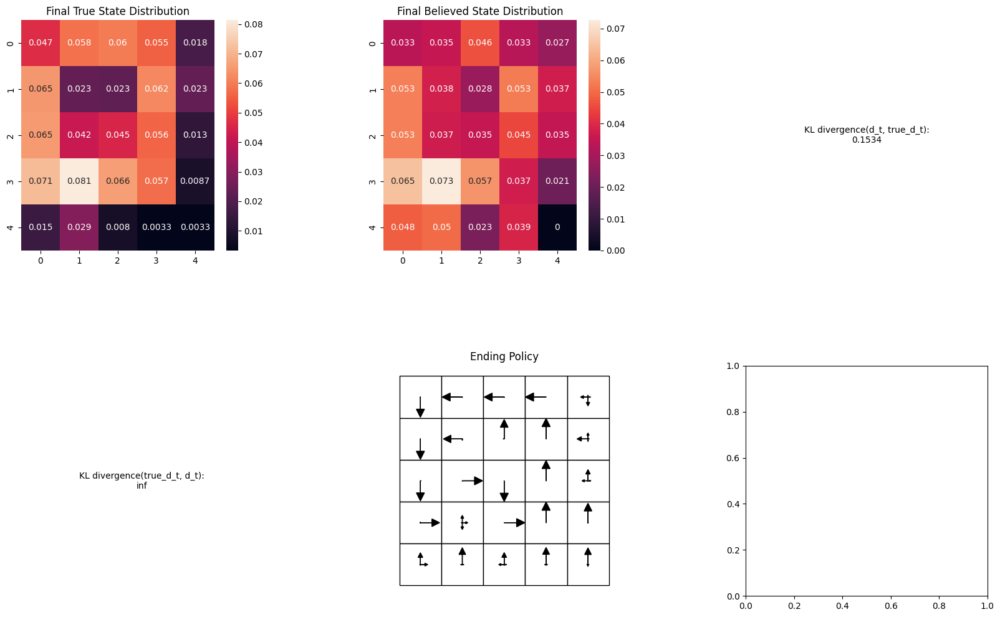

Stochastic Learned mean: nan


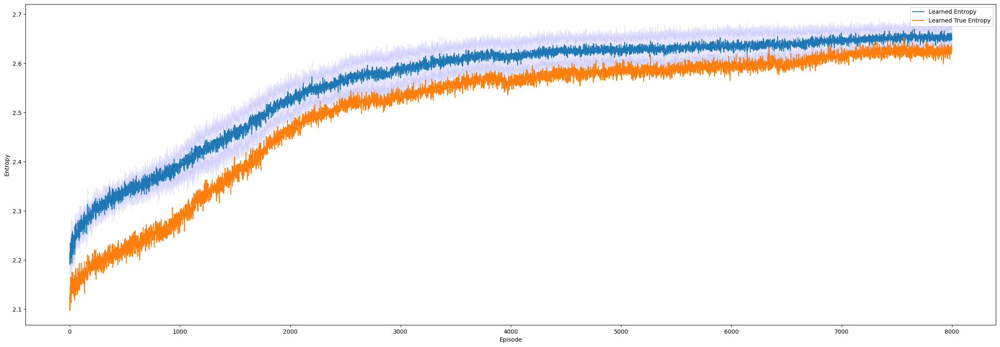

In [ ]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
uniform=0
prob=0.1
randomize=1
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP random initial position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

## Hard Stochastic Entropy POMDP #1
Here the observation are with probability 'uniform' the true state and uniformly all other states

**Observation Matrix view**

0.9999999999999999
0.09999999999999998


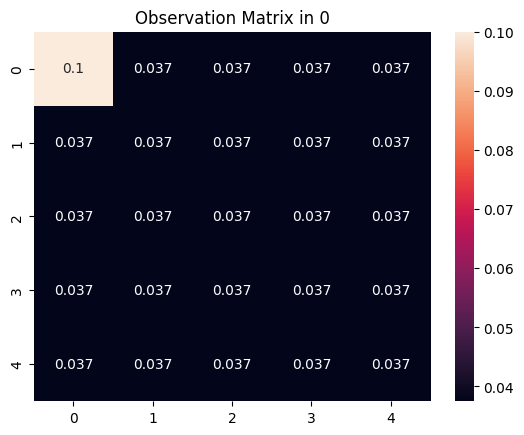

In [ ]:
env = gym.make('GridworldPOMDPEnvGoalless-v0', uniform=0.9)
agent = agents.REINFORCEAgentEPOMDP(env=env)
print_heatmap(agent, env.observation_matrix[0], "Observation Matrix in 0")
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

**Right observation probability 10%**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                           | 0/6000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

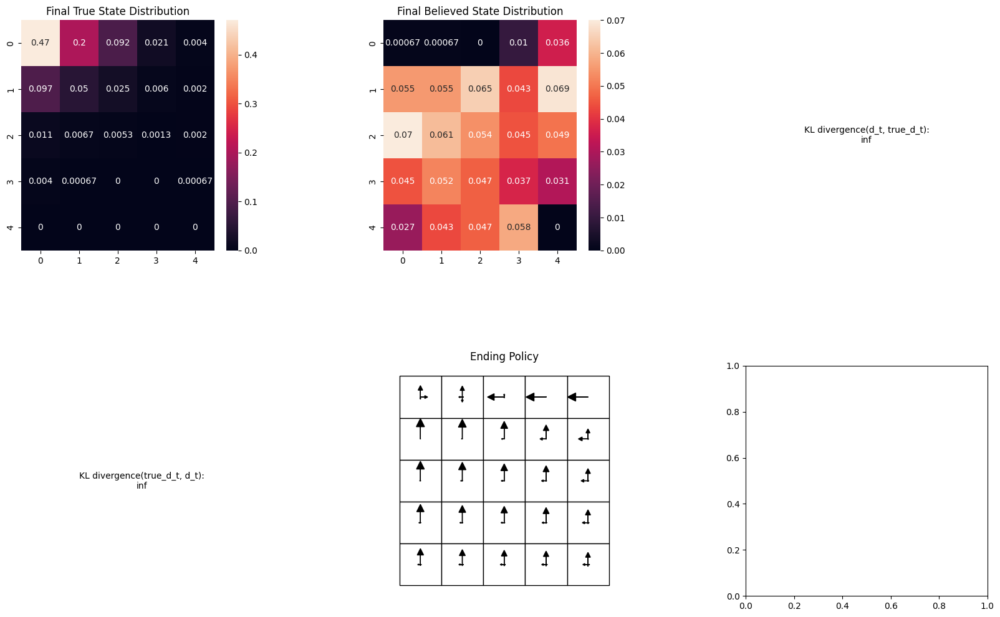

Run 0:  93%|█████████████████████████████▊  | 5601/6000 [43:32<03:09,  2.11it/s]

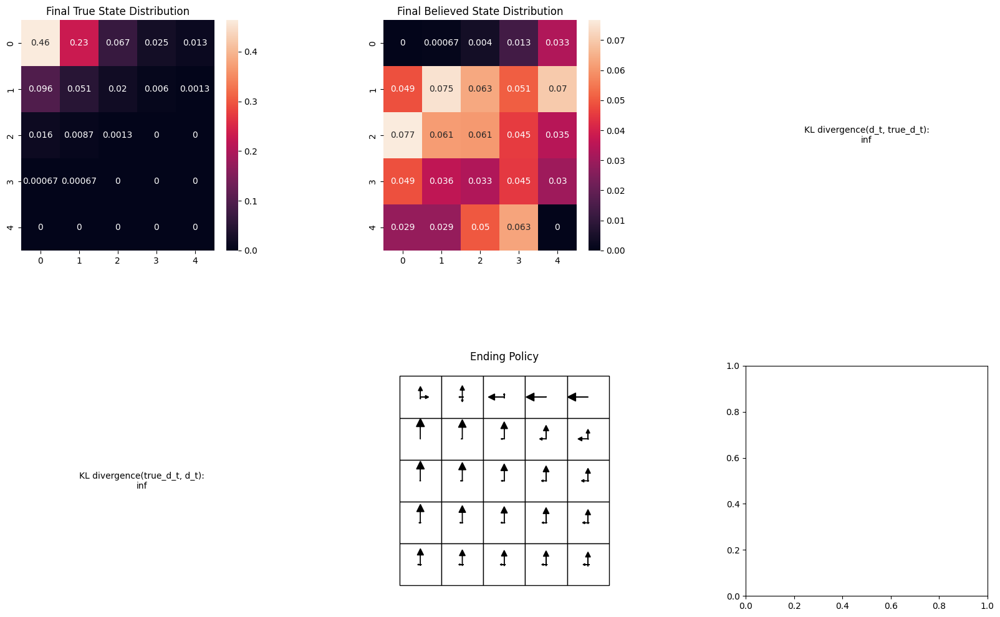

Run 0:  94%|█████████████████████████████▉  | 5610/6000 [43:36<02:44,  2.36it/s]

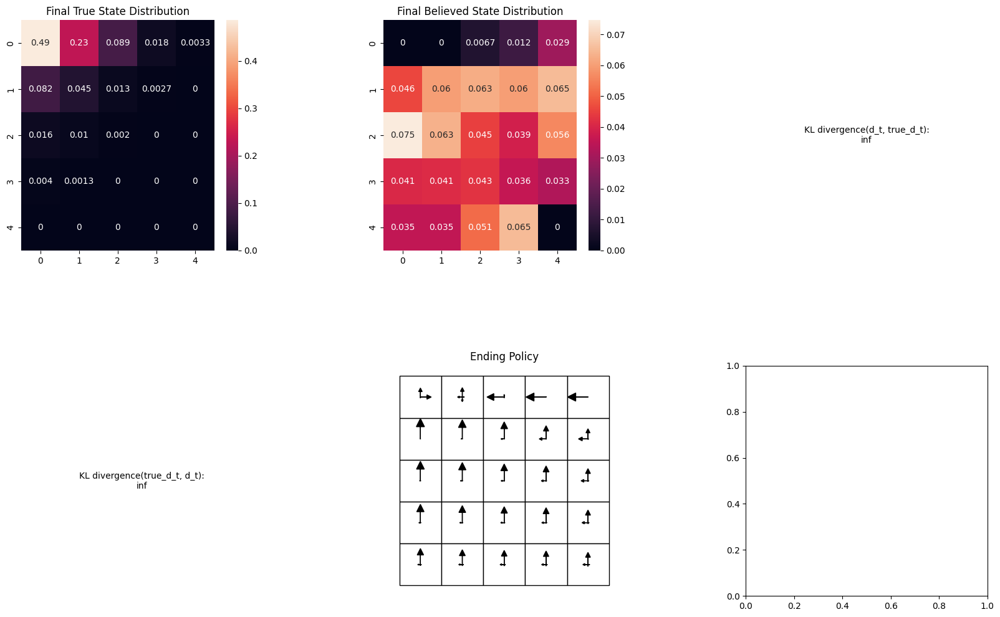

Run 0:  94%|█████████████████████████████▉  | 5615/6000 [43:38<02:54,  2.21it/s]

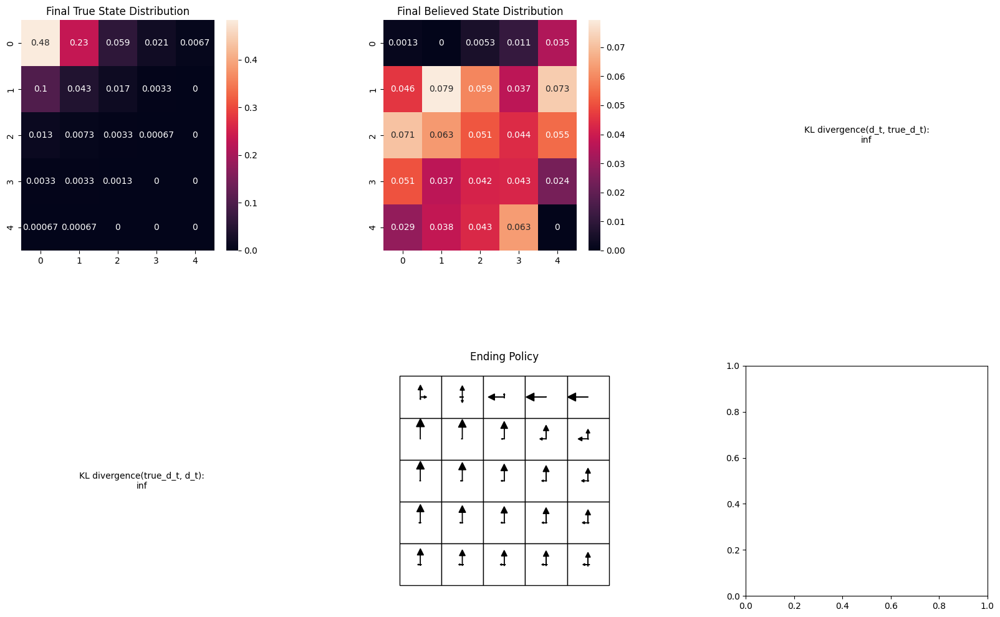

Run 0:  94%|█████████████████████████████▉  | 5624/6000 [43:42<02:58,  2.11it/s]

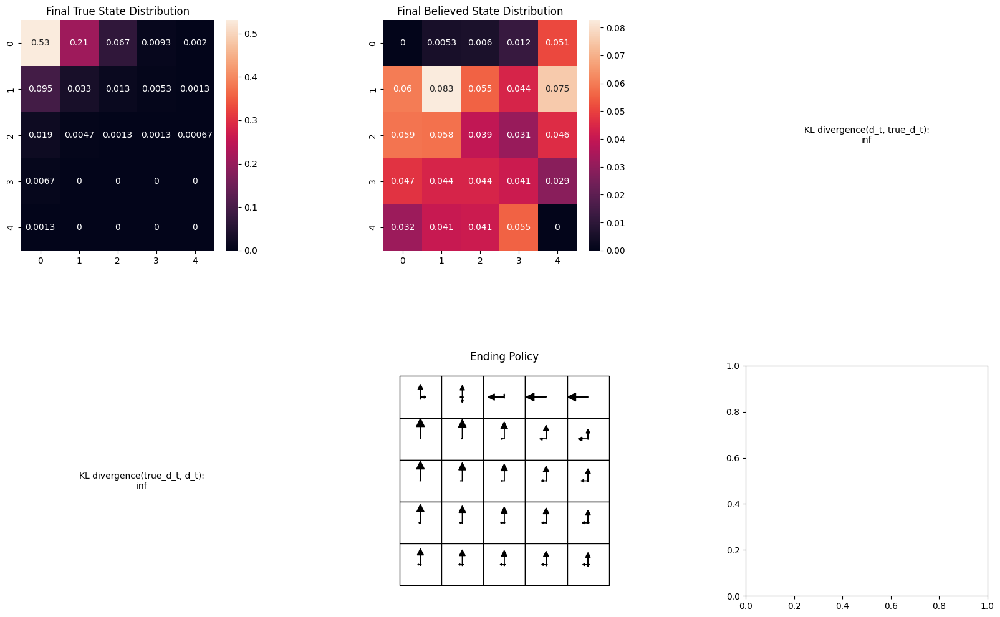

Run 0:  94%|██████████████████████████████  | 5630/6000 [43:45<02:53,  2.14it/s]

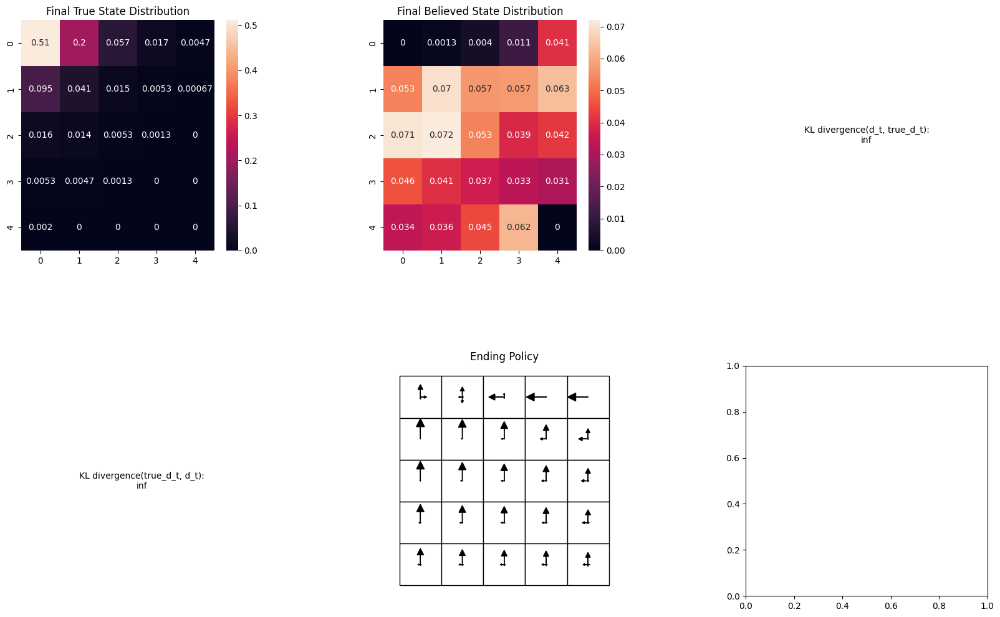

Run 0:  94%|██████████████████████████████  | 5634/6000 [43:47<02:48,  2.18it/s]

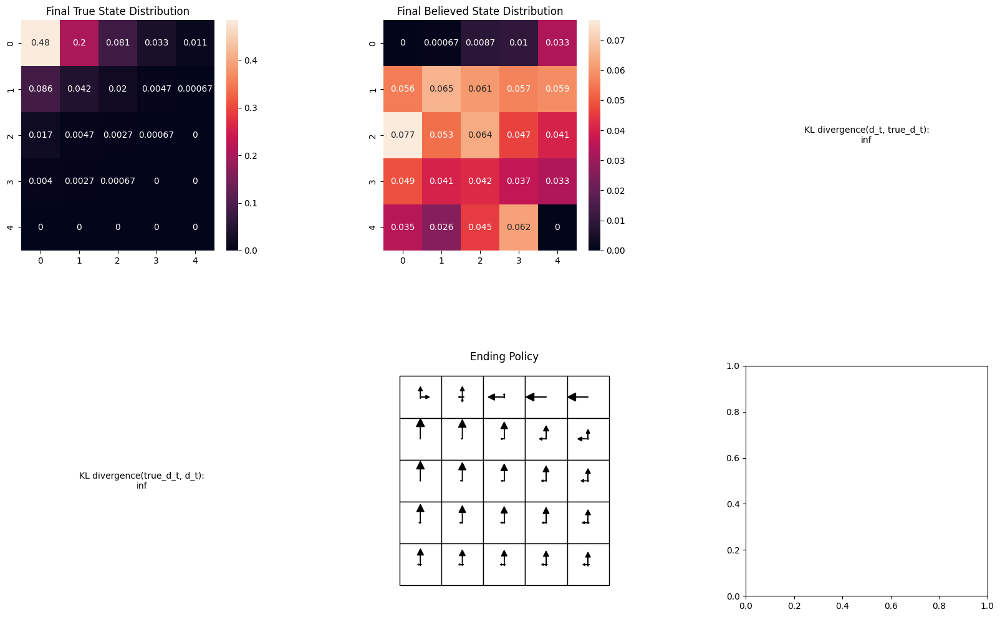

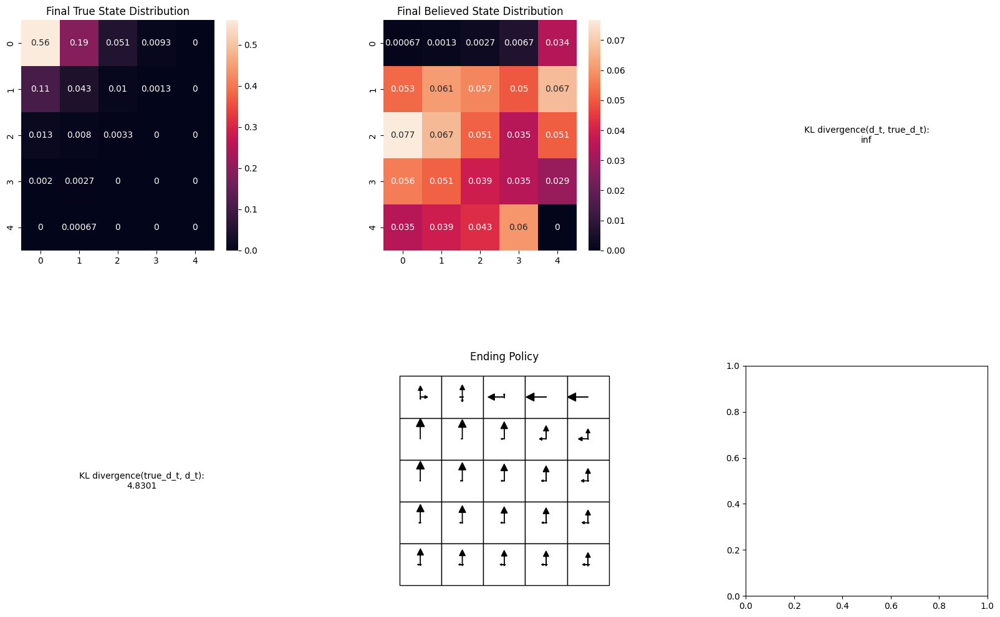

Run 0:  94%|██████████████████████████████  | 5641/6000 [43:50<02:27,  2.44it/s]

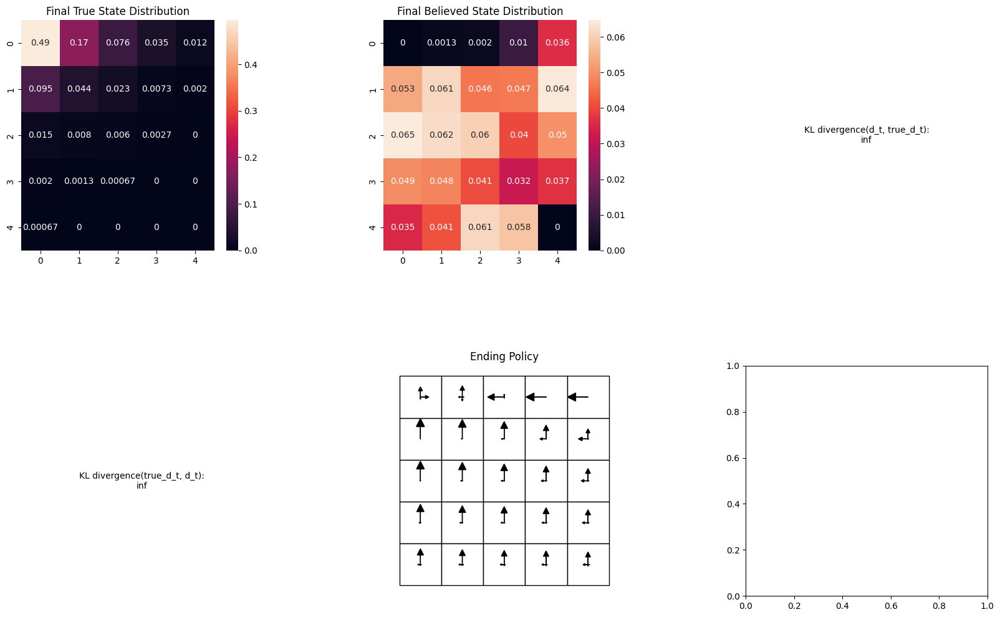

Run 0: 100%|████████████████████████████████| 6000/6000 [46:14<00:00,  2.16it/s]


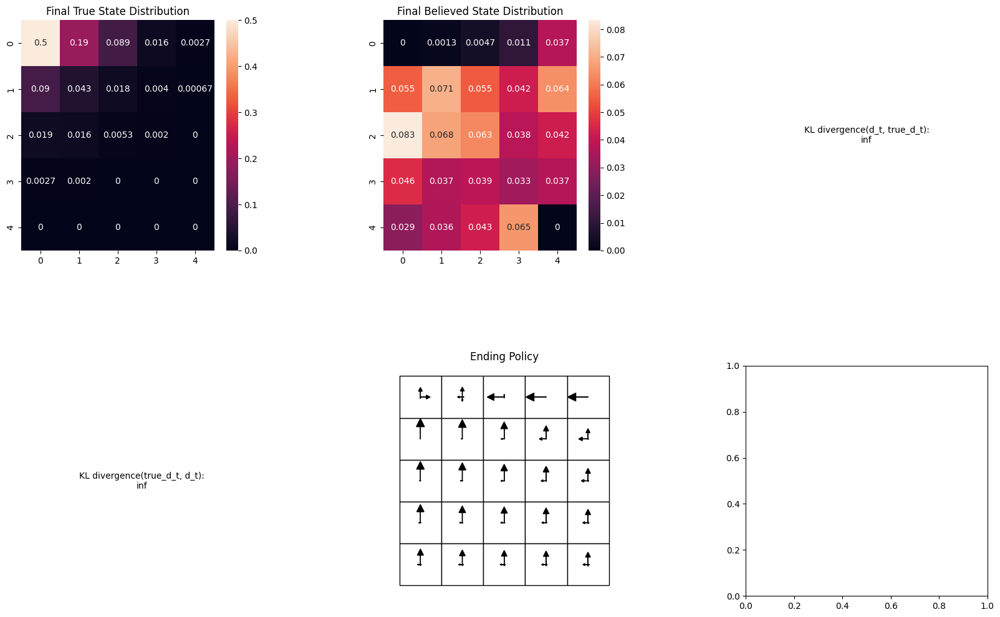

Stochastic Learned mean: 1.2105800022163458


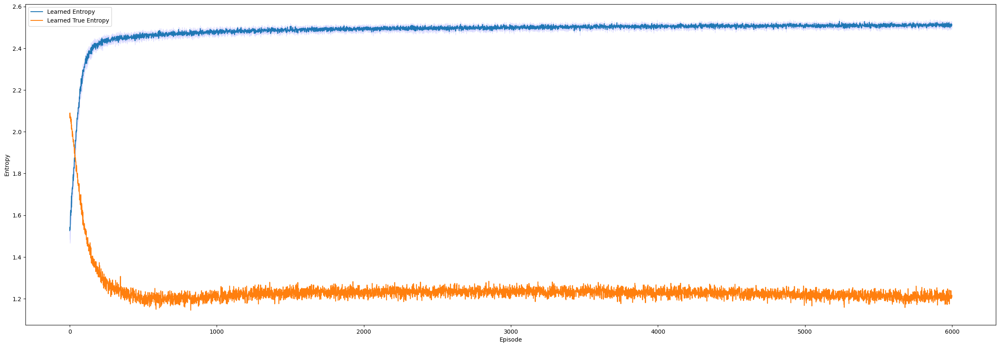

In [6]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
uniform=0.9
prob=0.2
randomize=0
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Increase the time horizon**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0:  95%|████████████████████████████████▎ | 476/500 [07:24<00:21,  1.13it/s]

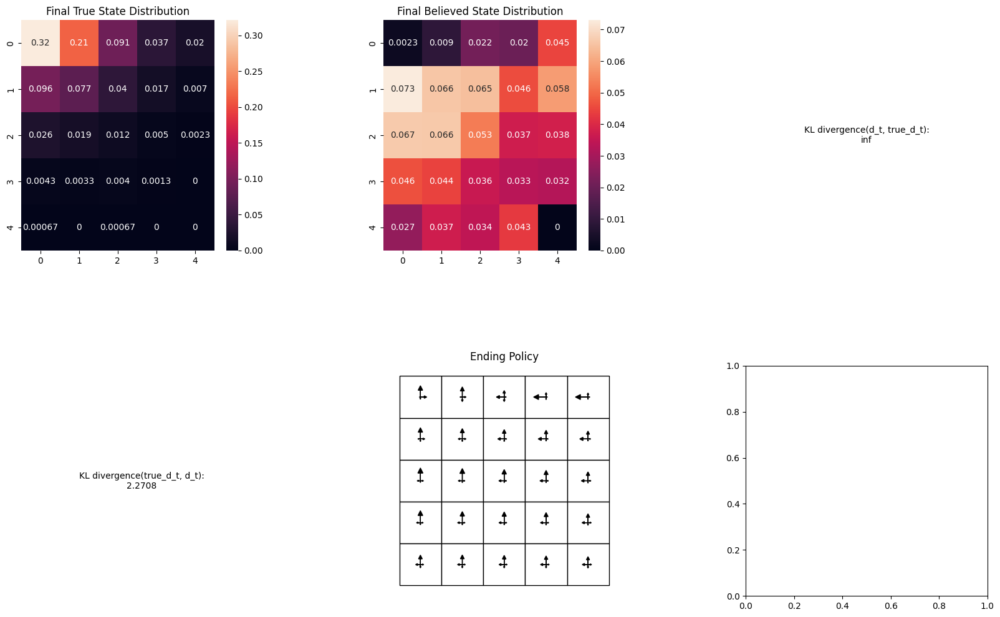

Run 0:  96%|████████████████████████████████▌ | 478/500 [07:26<00:19,  1.12it/s]

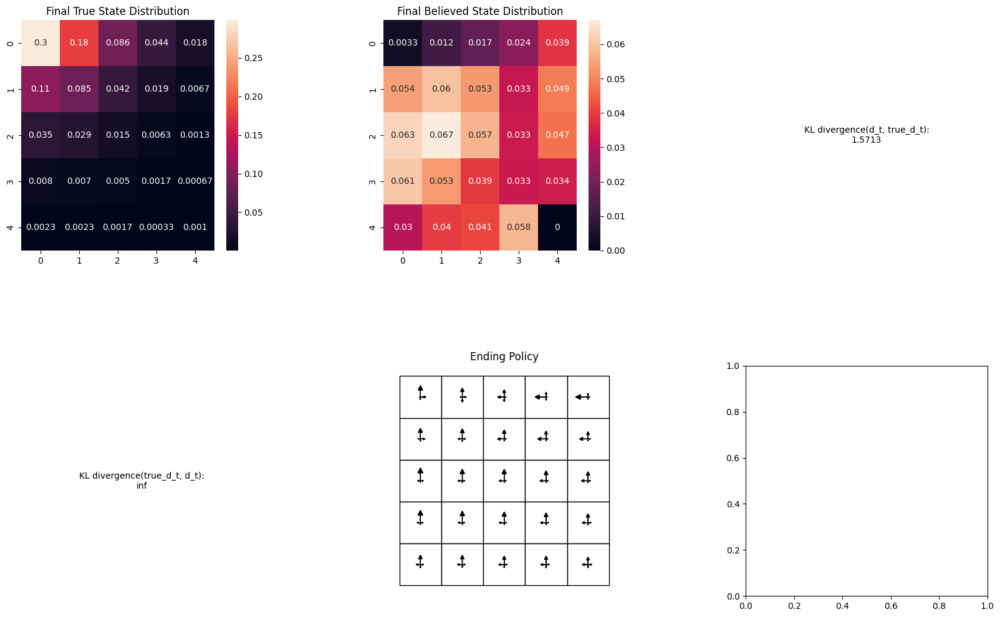

Run 0:  96%|████████████████████████████████▌ | 479/500 [07:27<00:19,  1.10it/s]

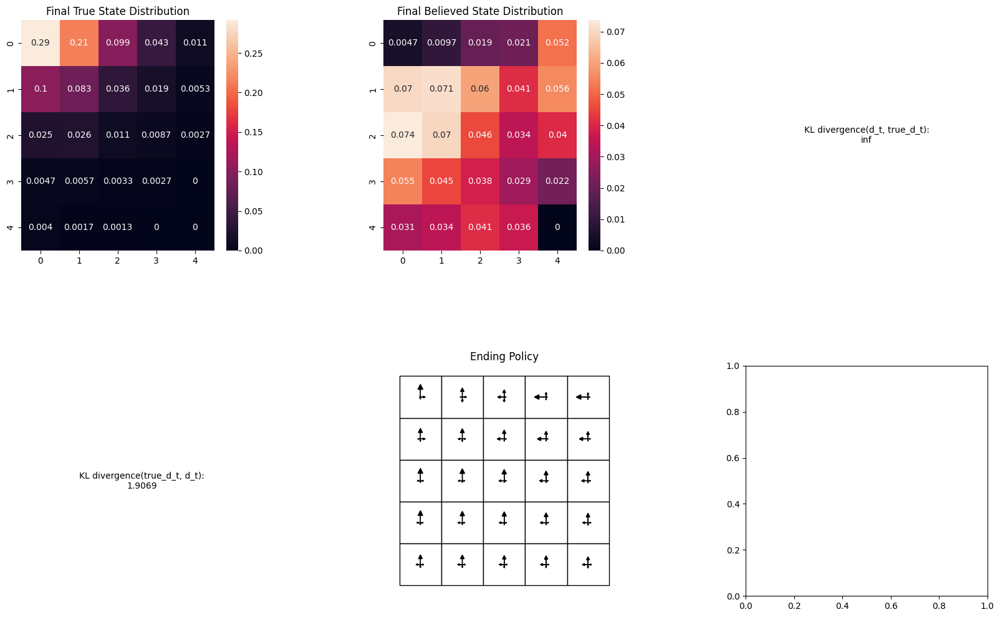

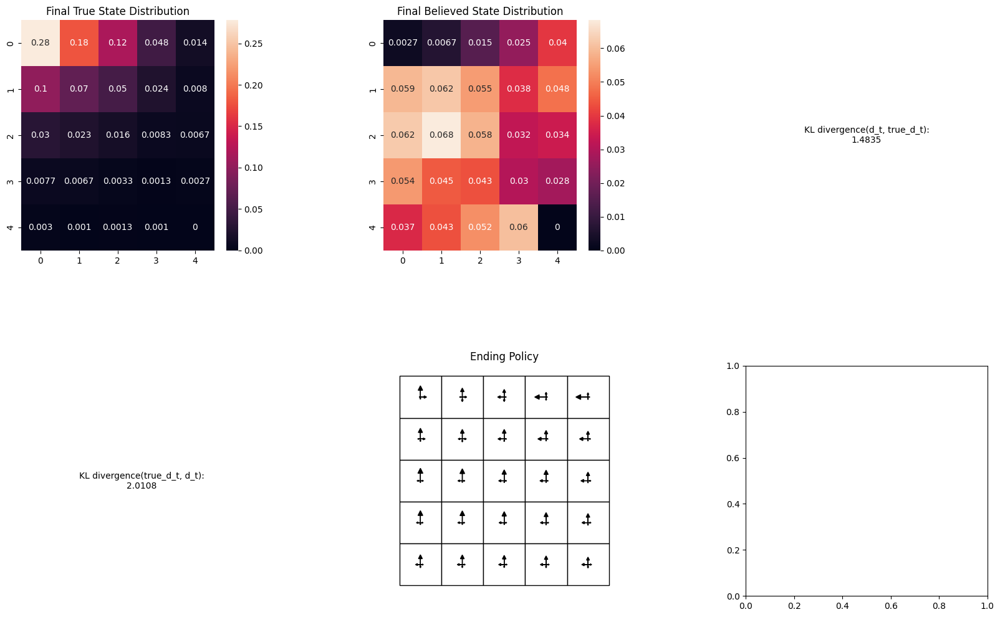

Run 0:  96%|████████████████████████████████▋ | 480/500 [07:28<00:17,  1.15it/s]

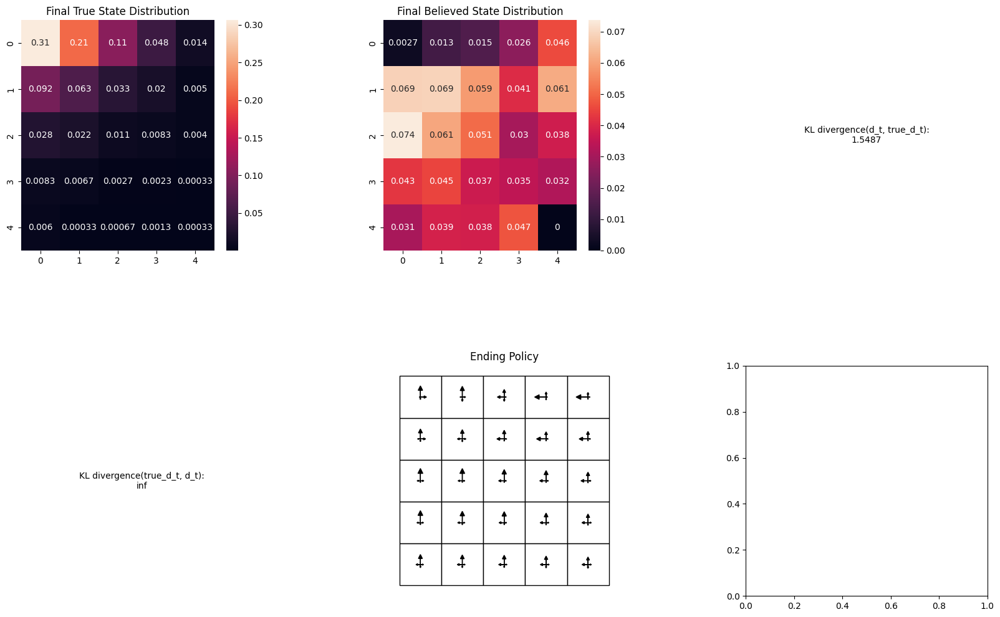

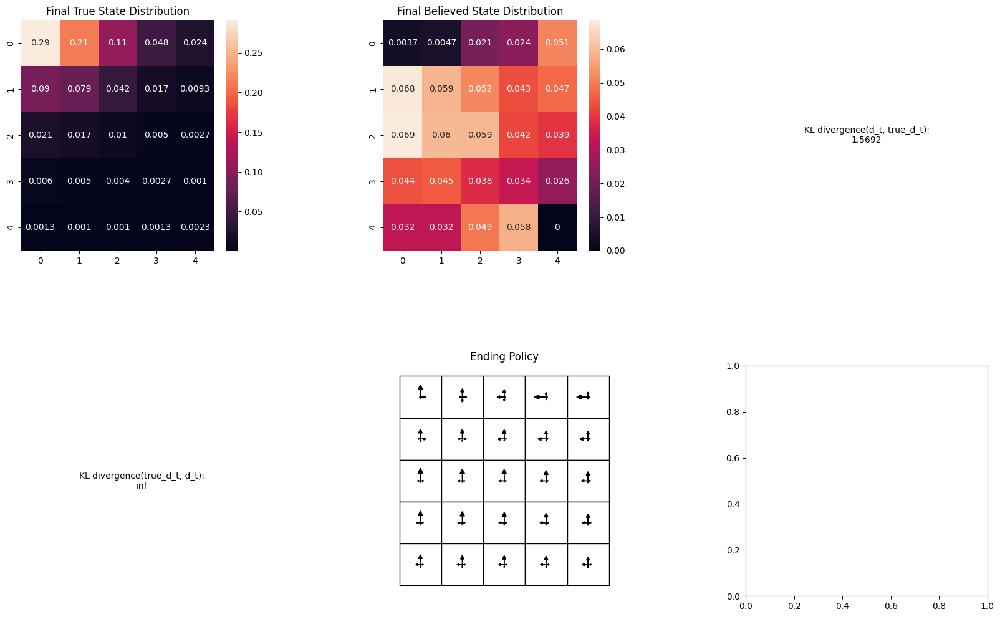

Run 0:  96%|████████████████████████████████▊ | 482/500 [07:29<00:16,  1.12it/s]

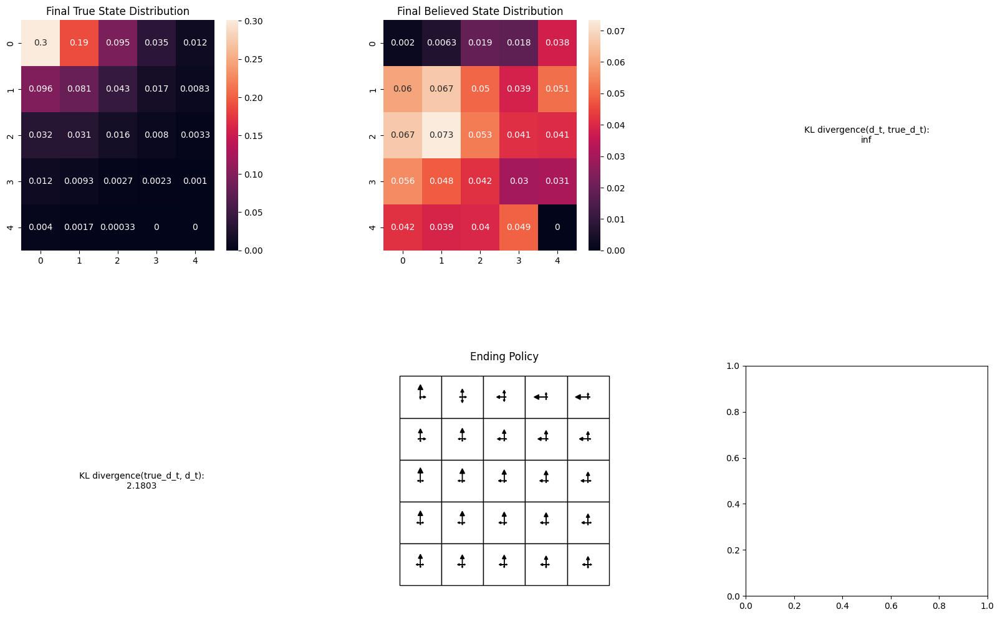

Run 0:  97%|████████████████████████████████▊ | 483/500 [07:30<00:14,  1.13it/s]

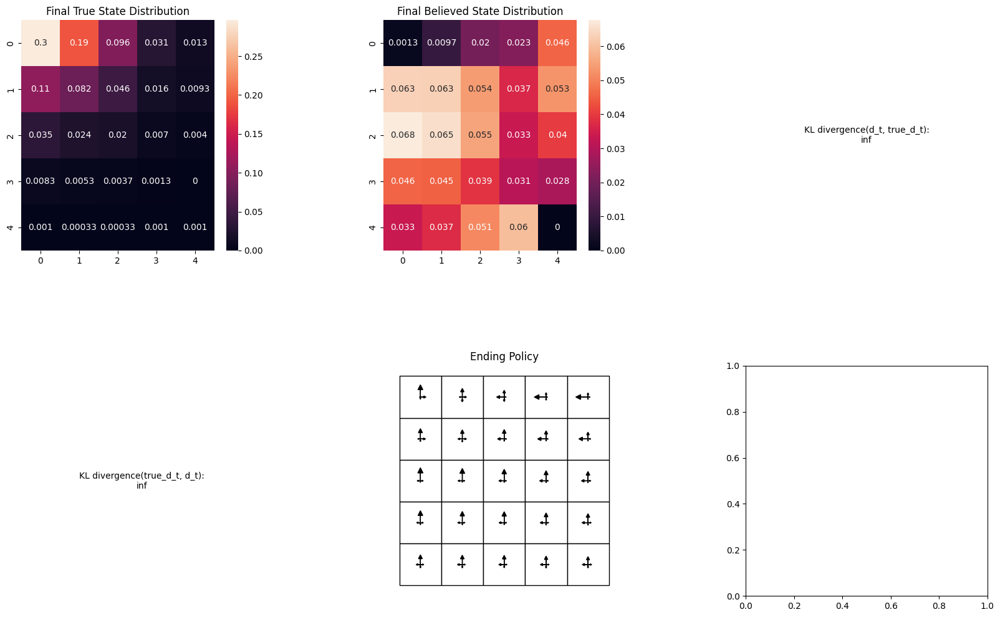

Run 0:  97%|████████████████████████████████▉ | 485/500 [07:32<00:12,  1.18it/s]

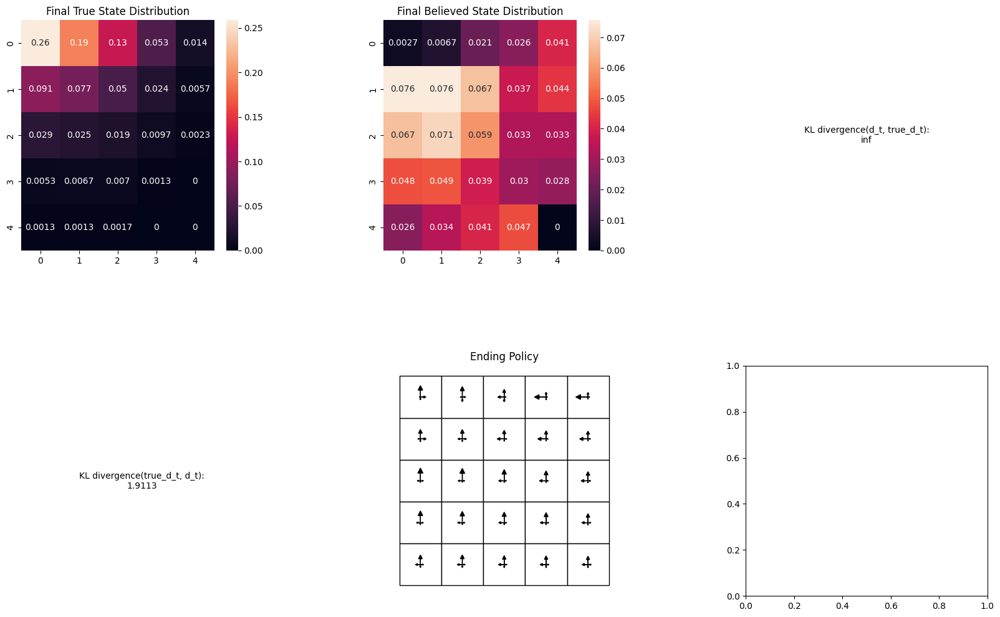

Run 0: 100%|██████████████████████████████████| 500/500 [07:44<00:00,  1.08it/s]


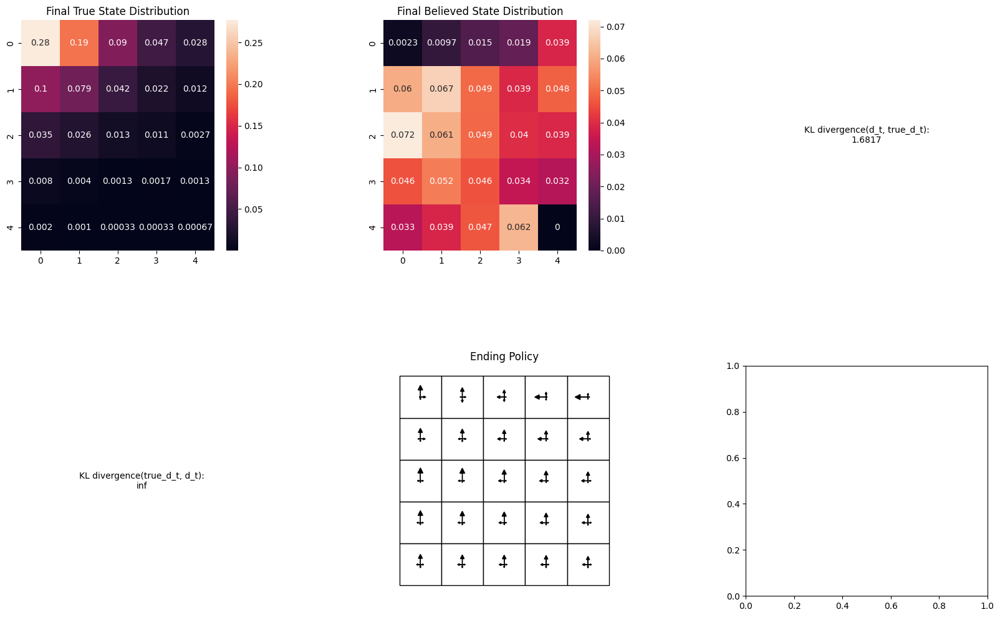

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Stochastic Learned mean: nan


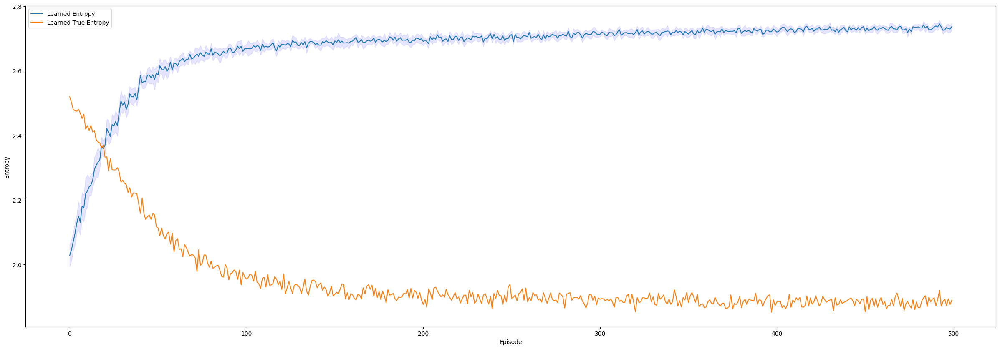

In [8]:
# Number of episodes for the training
n_episodes = 500
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=15
uniform=0.9
prob=0.1
randomize=0
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[450:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[450:])))

**Less noisey: probability 40%**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

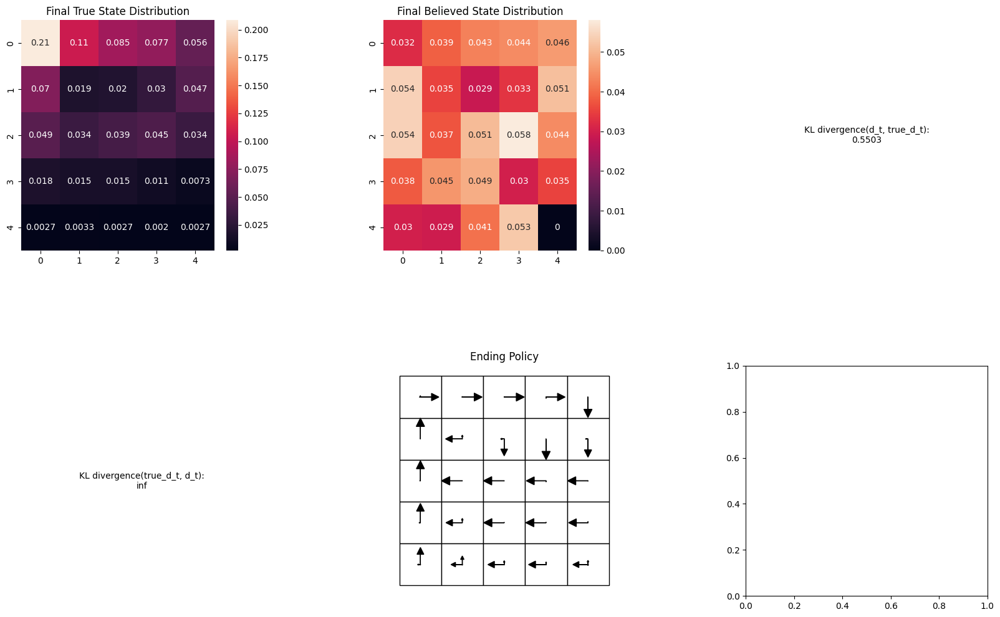

Run 0:  98%|████████████████████████████▌| 9845/10000 [1:09:31<01:02,  2.47it/s]

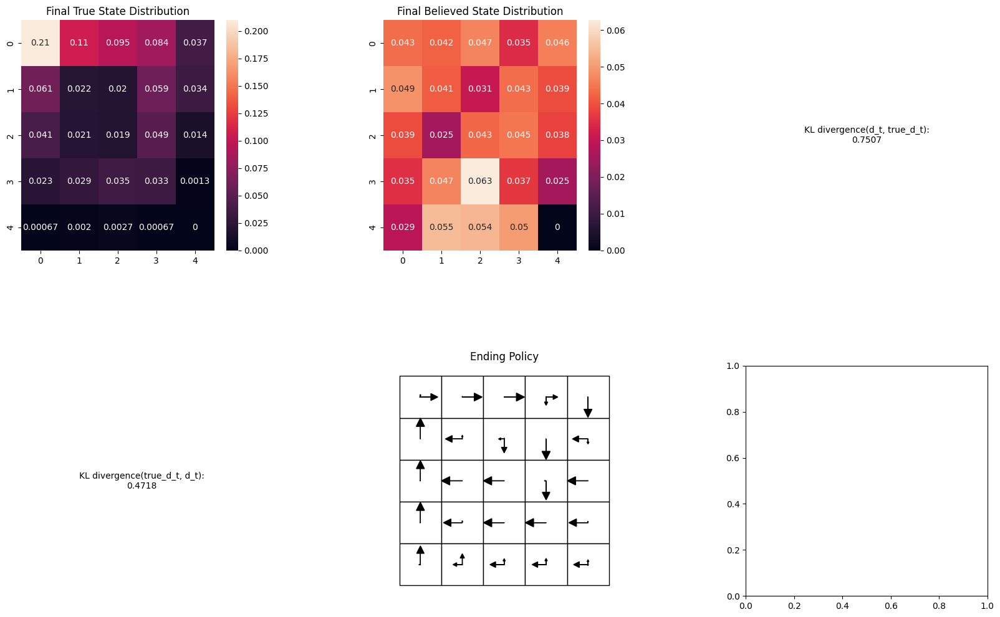

Run 0:  99%|████████████████████████████▊| 9914/10000 [1:09:58<00:34,  2.52it/s]

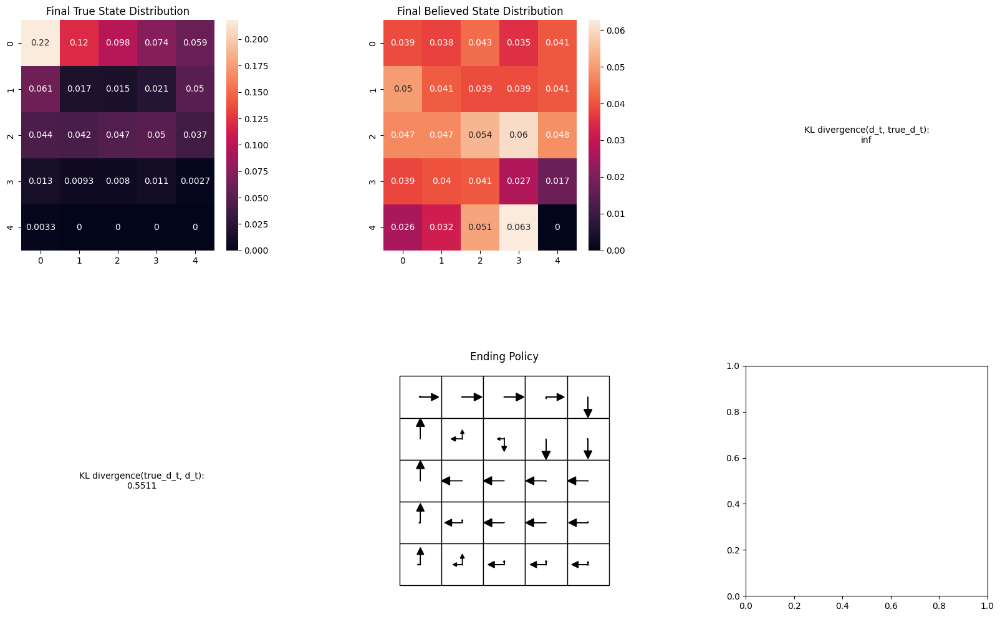

Run 0: 100%|████████████████████████████▉| 9982/10000 [1:10:26<00:06,  2.58it/s]

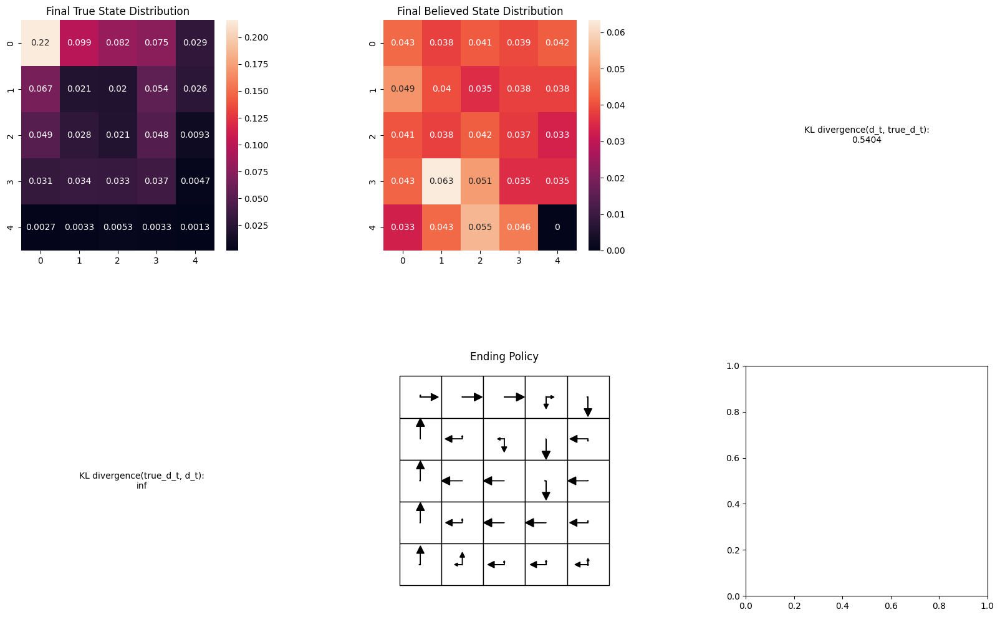

Run 0: 100%|████████████████████████████| 10000/10000 [1:10:35<00:00,  2.36it/s]


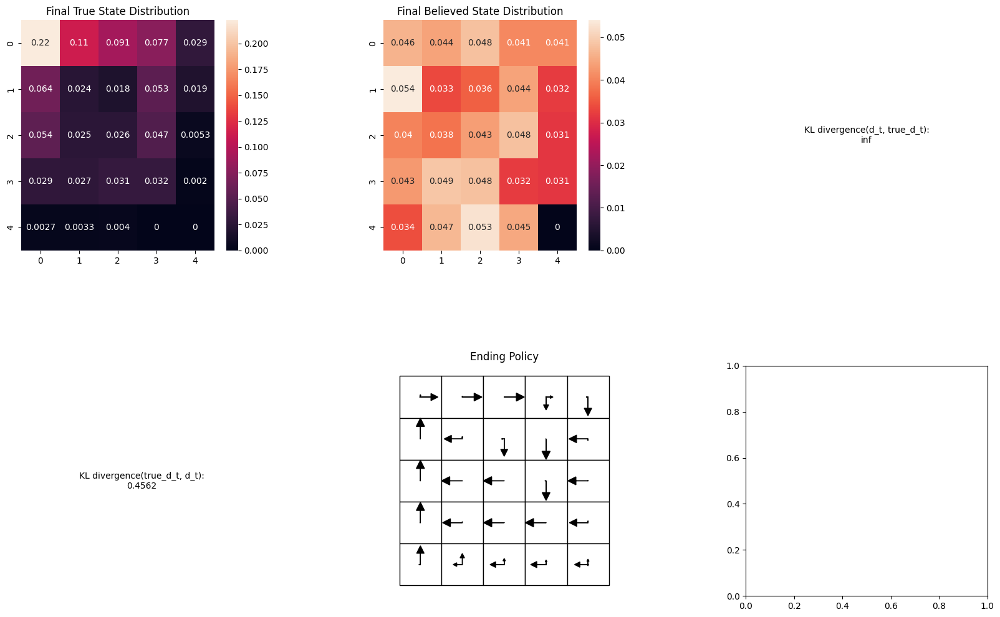

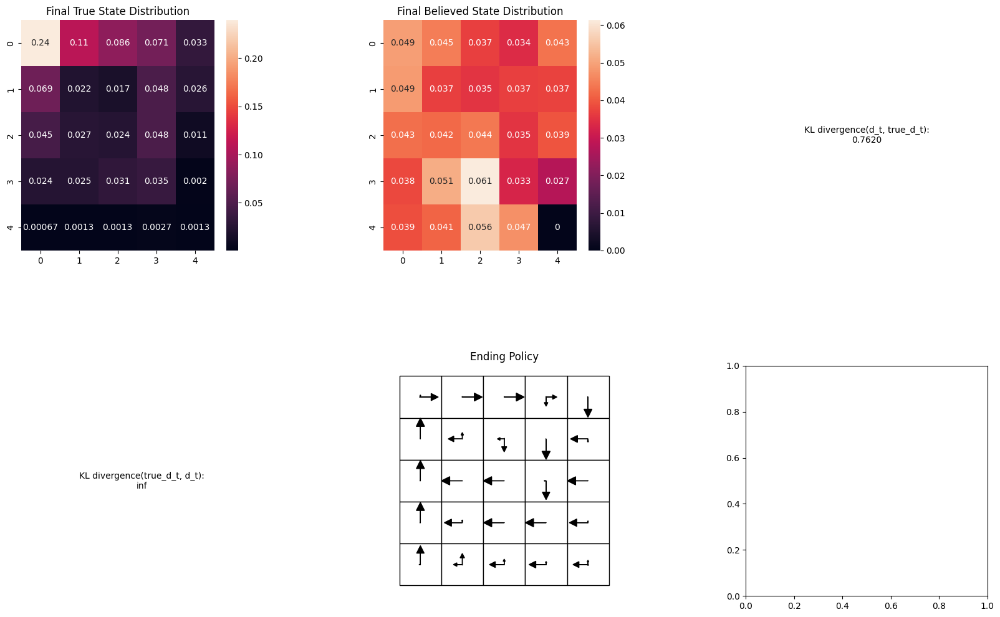

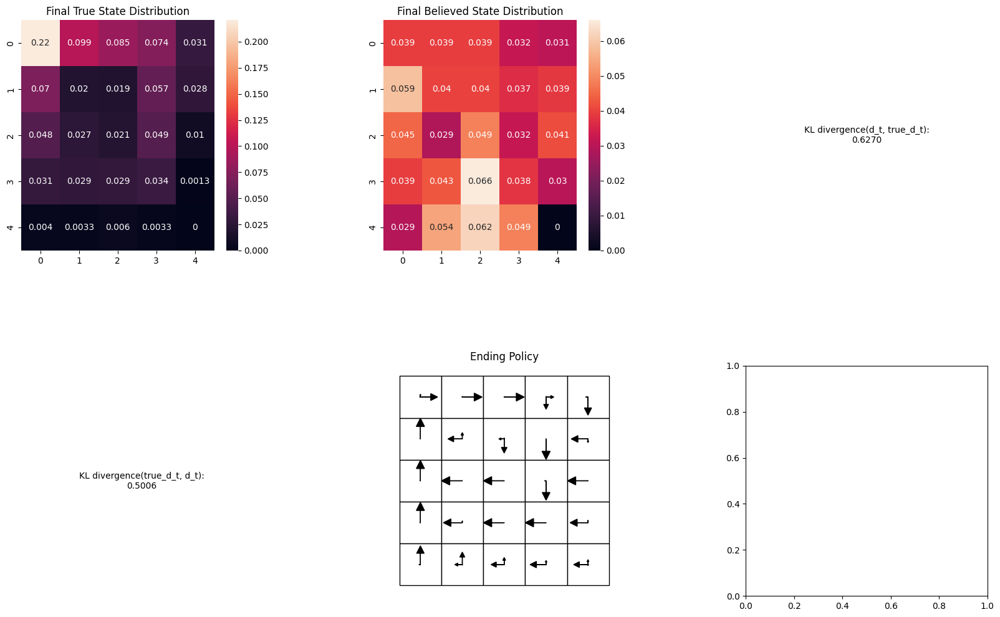

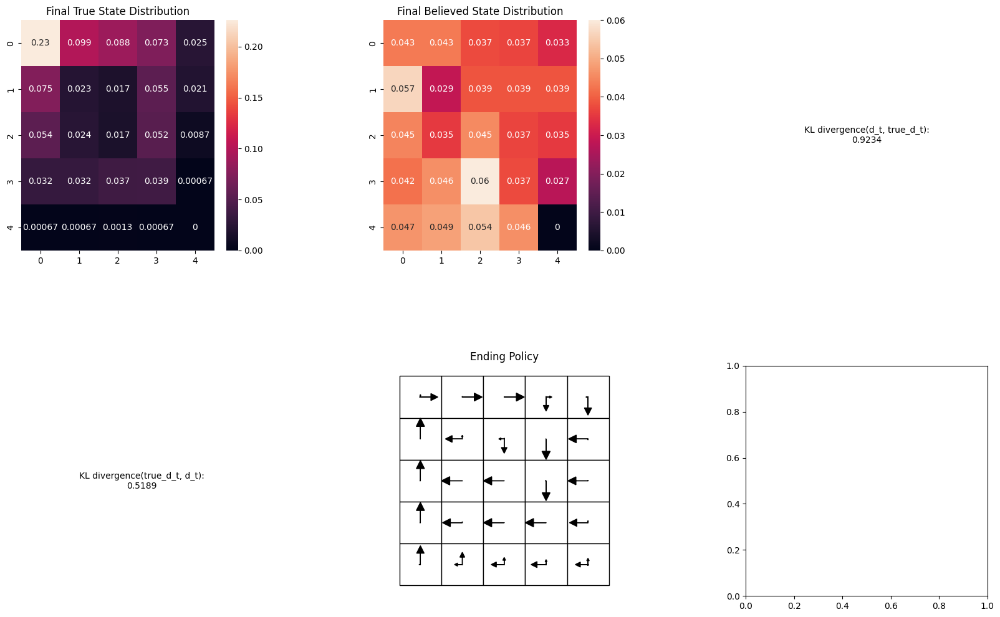

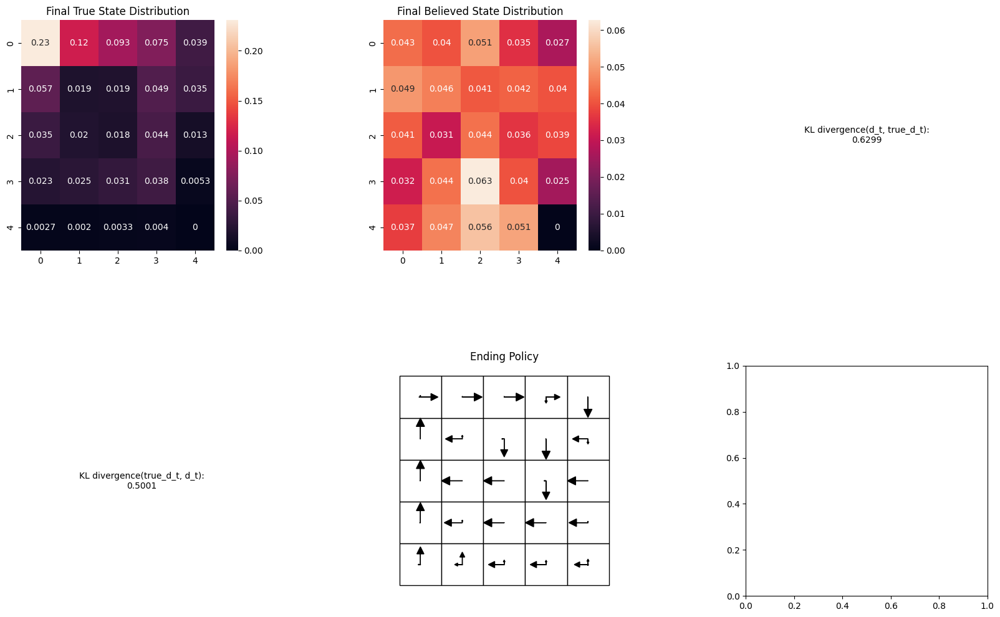

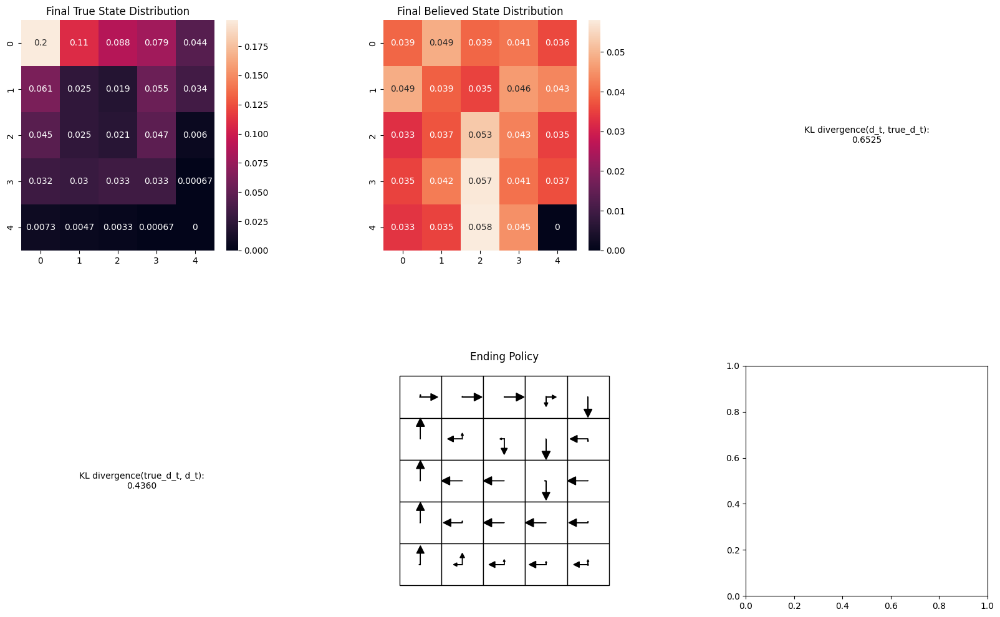

Believed Entropy mean: 2.646778878286104
True Entropy mean: 2.3509622378770776


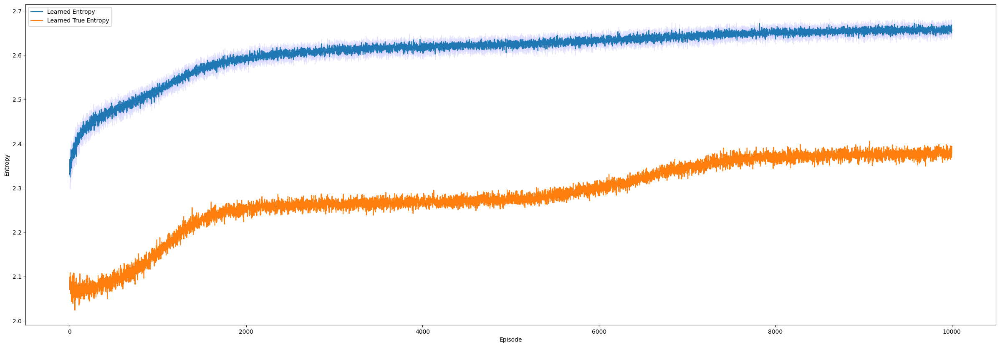

In [16]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
uniform=0.5
prob=0.1
randomize=0
# Agent variables
alpha = 0.4
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Increase the time horizon**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0: 100%|██████████████████████████████| 8000/8000 [1:47:31<00:00,  1.24it/s]


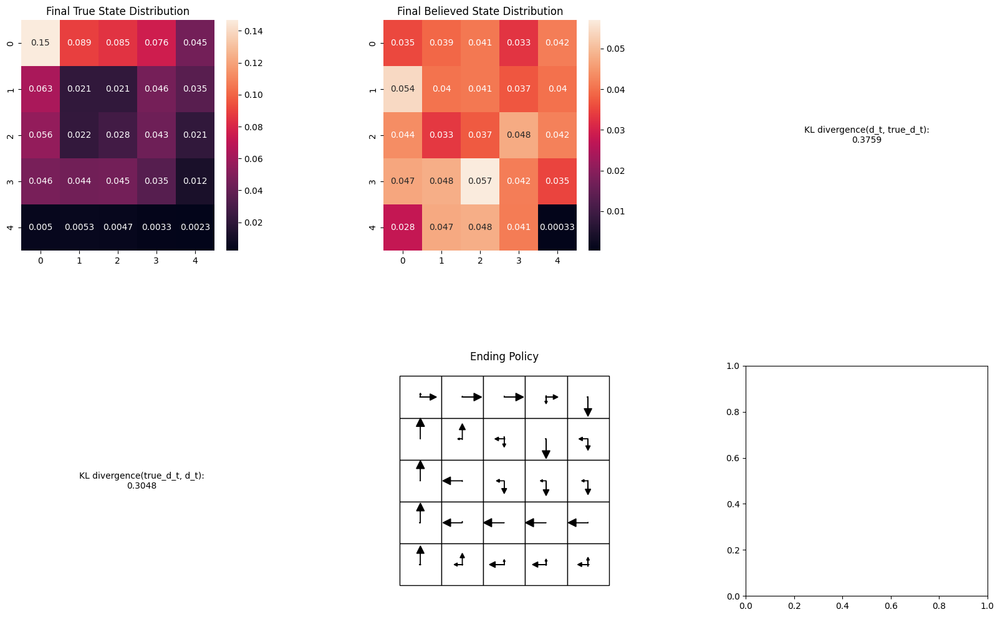

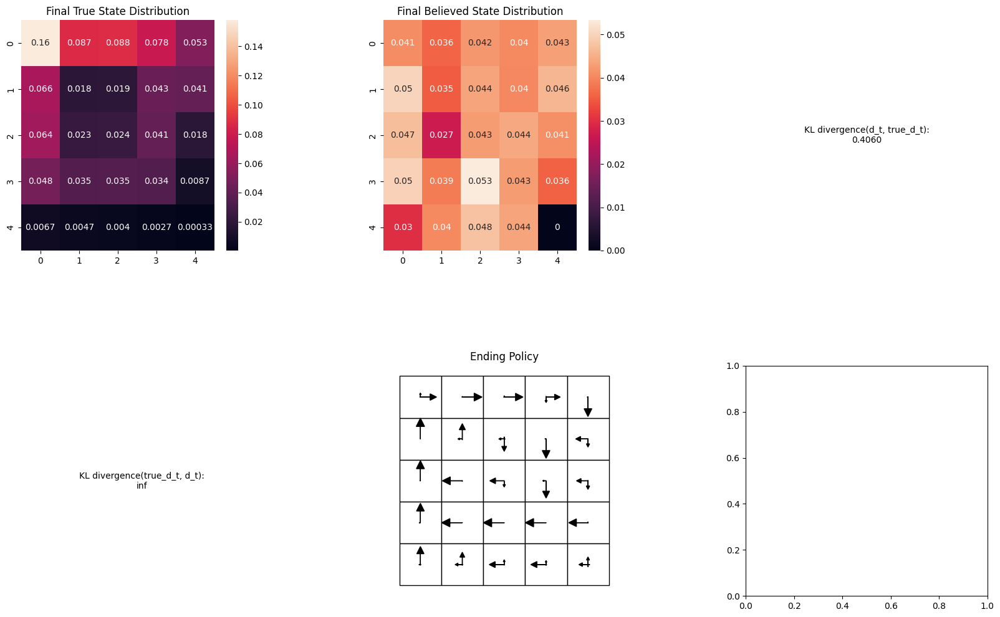

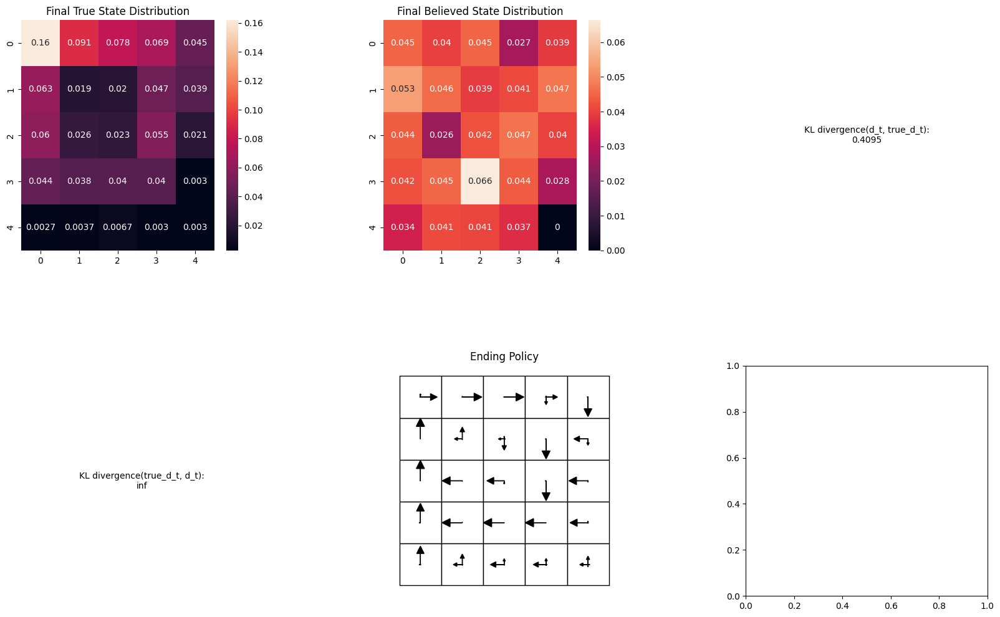

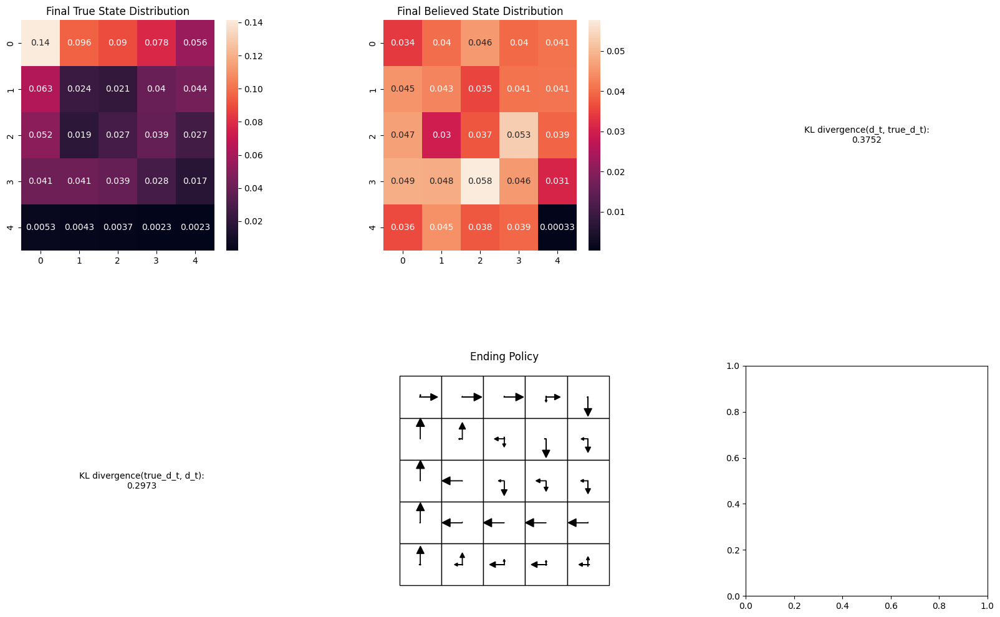

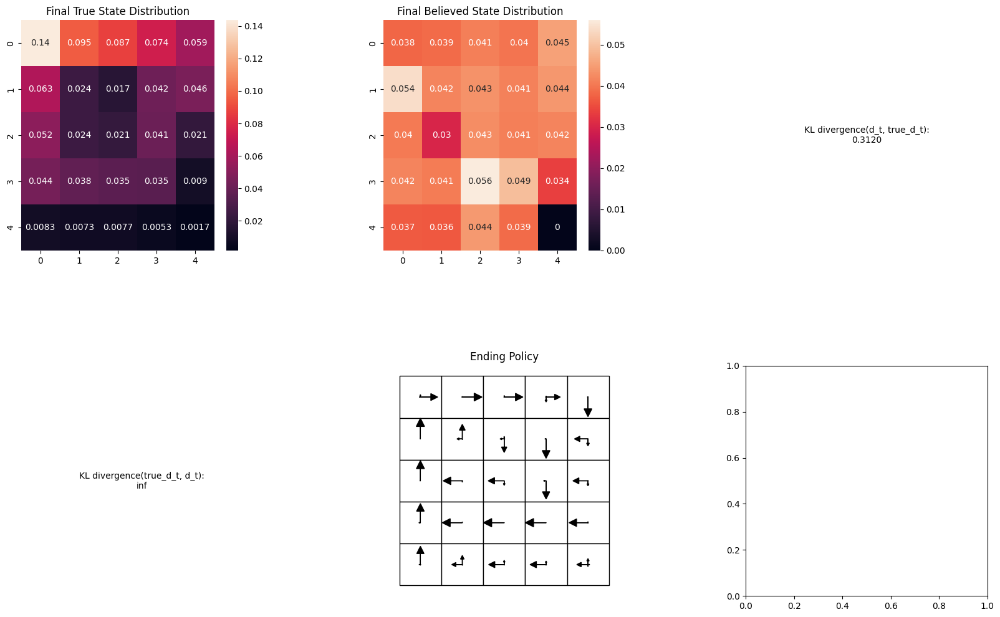

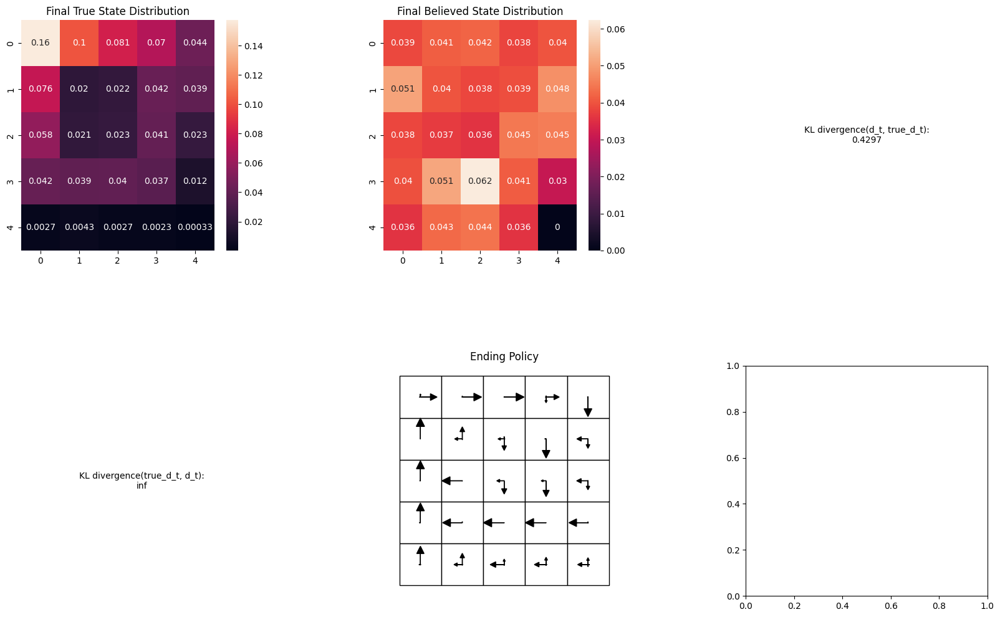

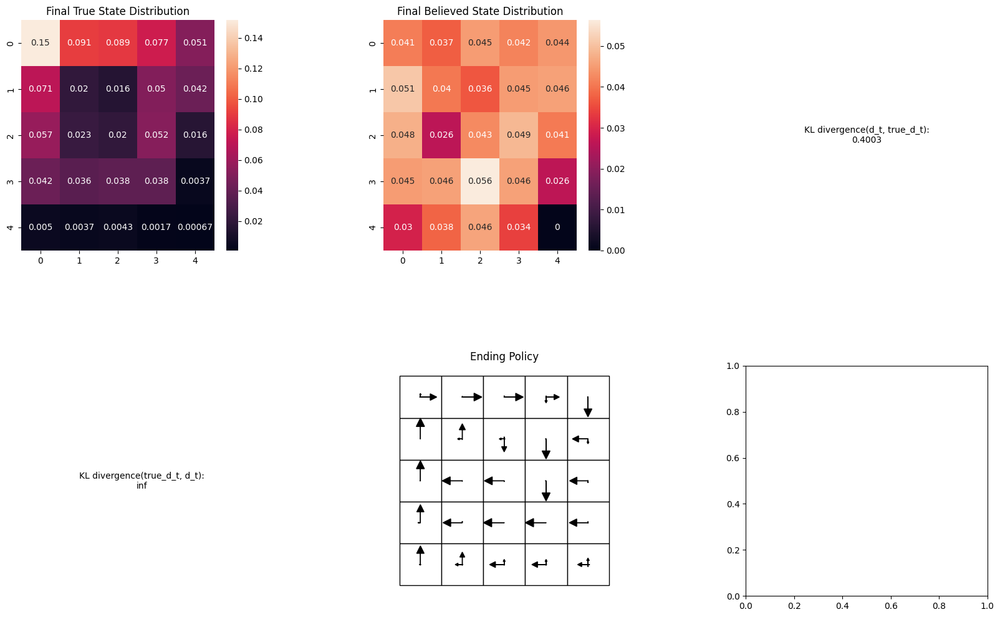

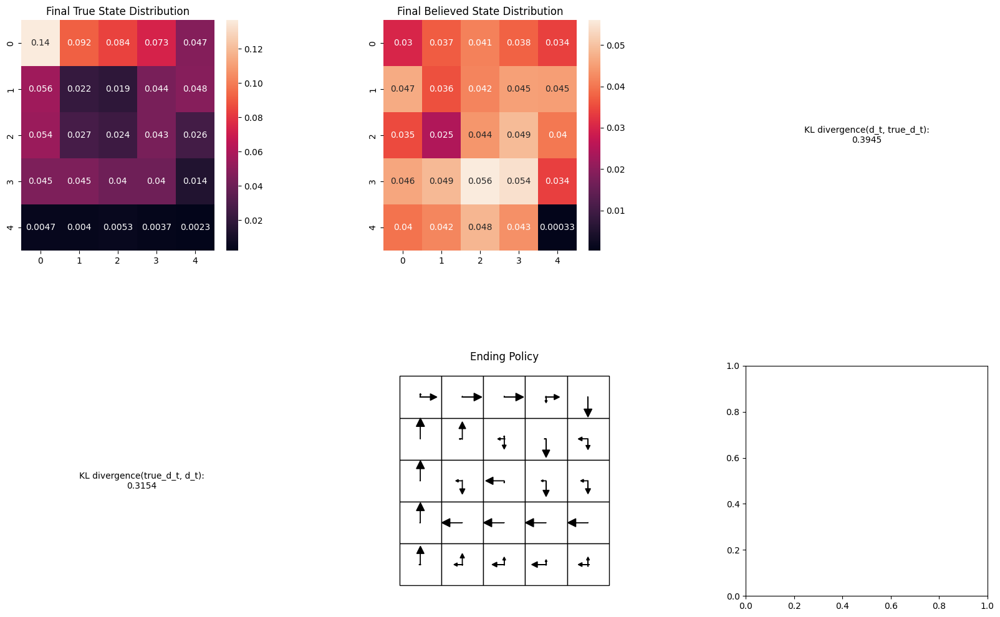

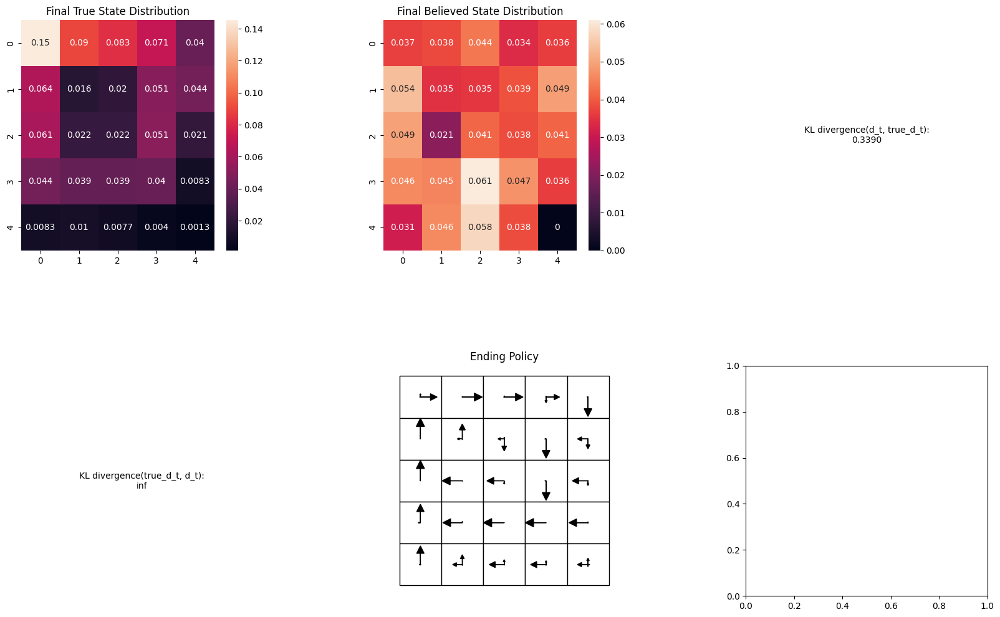

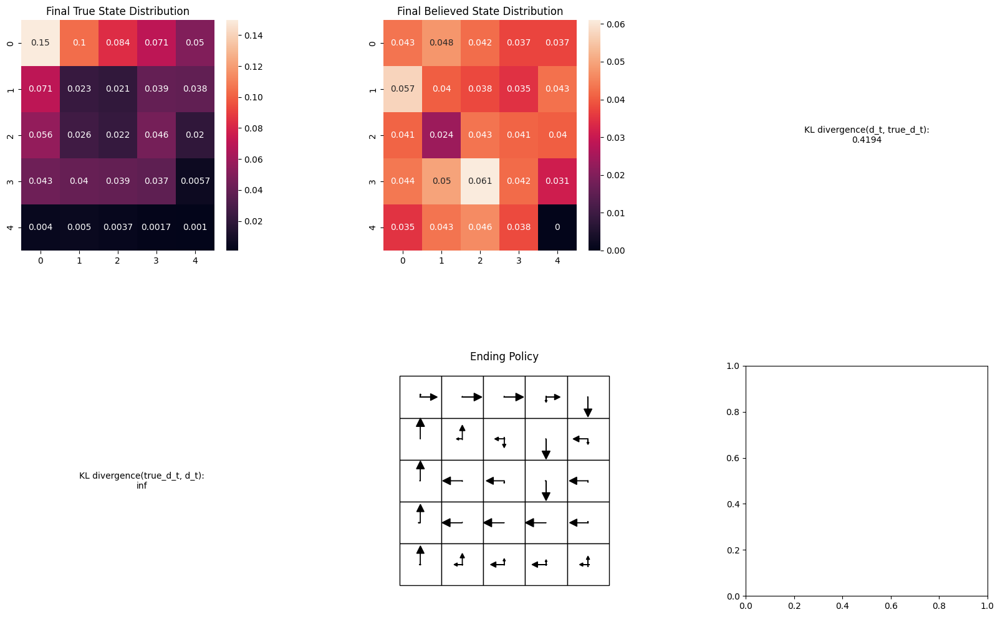

Believed Entropy mean: 2.916431686655029
True Entropy mean: 2.6988726649884636


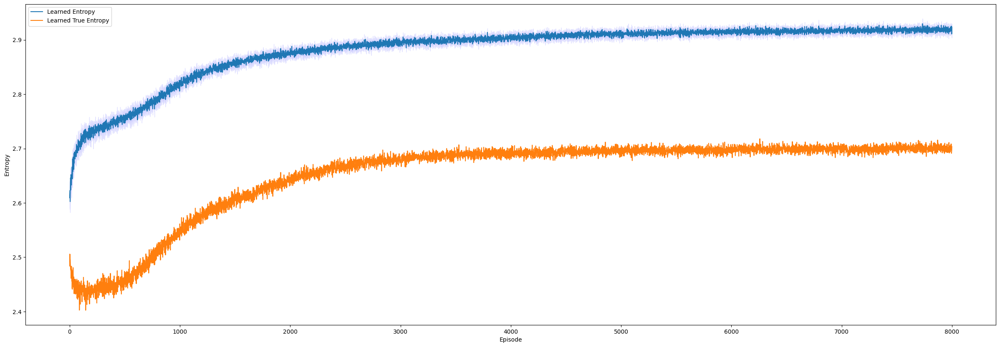

In [17]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=15
uniform=0.5
prob=0.1
randomize=0
# Agent variables
alpha = 0.4
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

## Hard Stochastic Entropy POMDP #2
Here the observation are Gaussian but way less steep with the following probabilities

1.0
0.1149862589922978


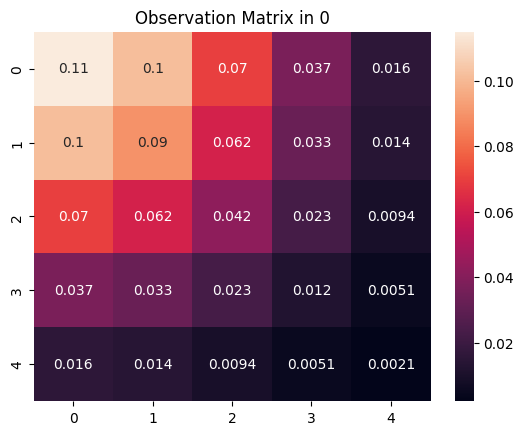

In [16]:
env = gym.make('GridworldPOMDPEnvGoalless-v0', steepness=1)
agent = agents.REINFORCEAgentEPOMDP(env=env)
print_heatmap(agent, env.observation_matrix[0], "Observation Matrix in 0")
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                           | 0/8000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

Run 0: 100%|████████████████████████████████| 8000/8000 [54:38<00:00,  2.44it/s]


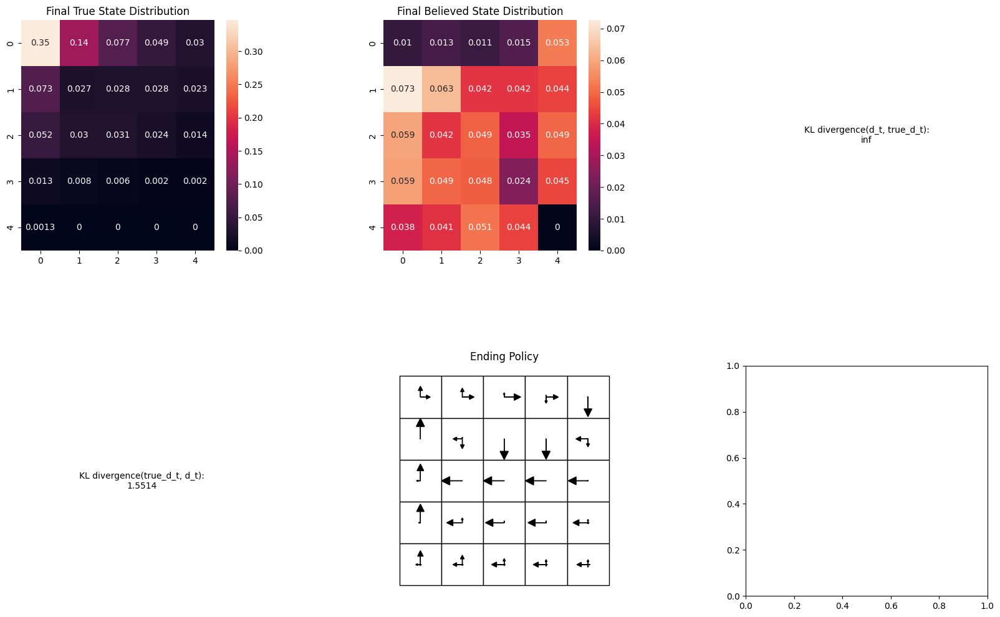

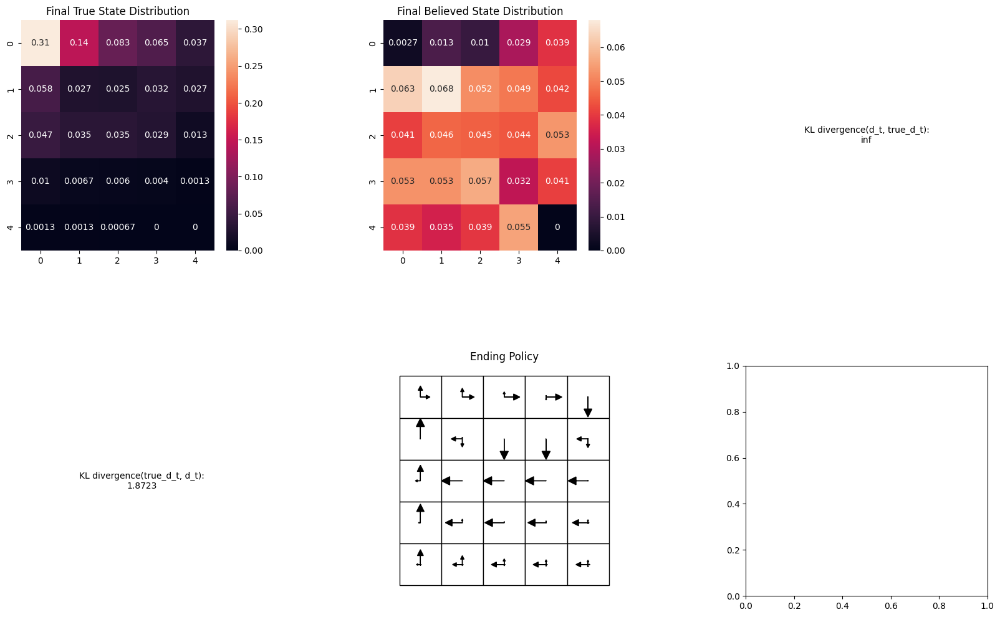

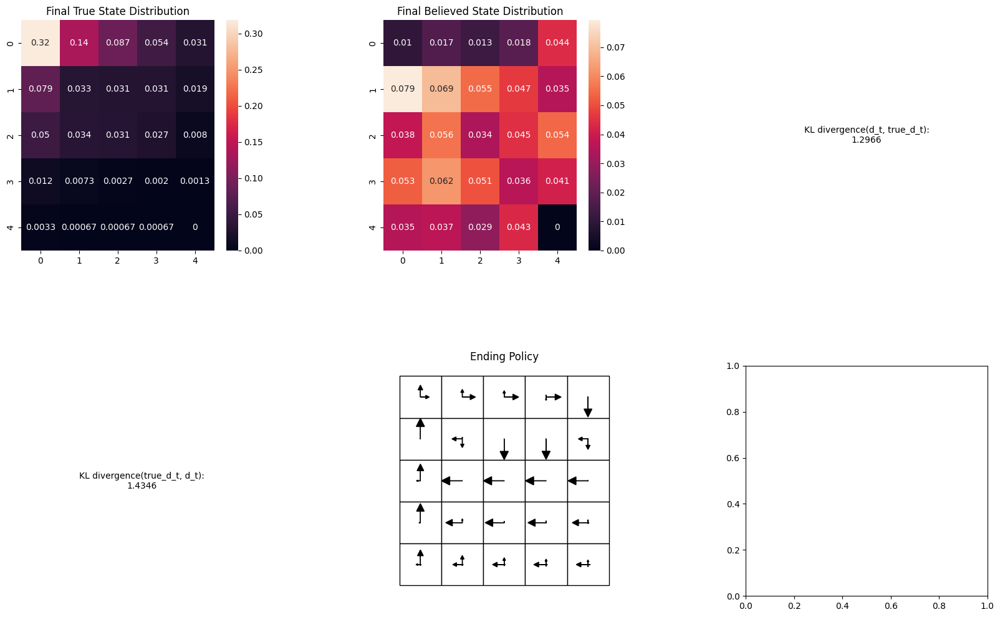

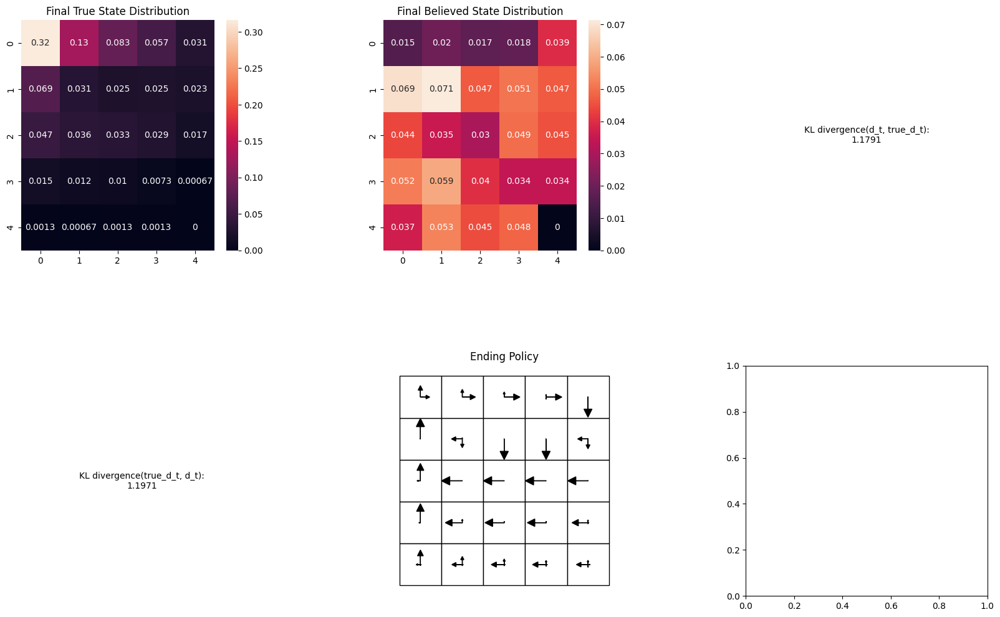

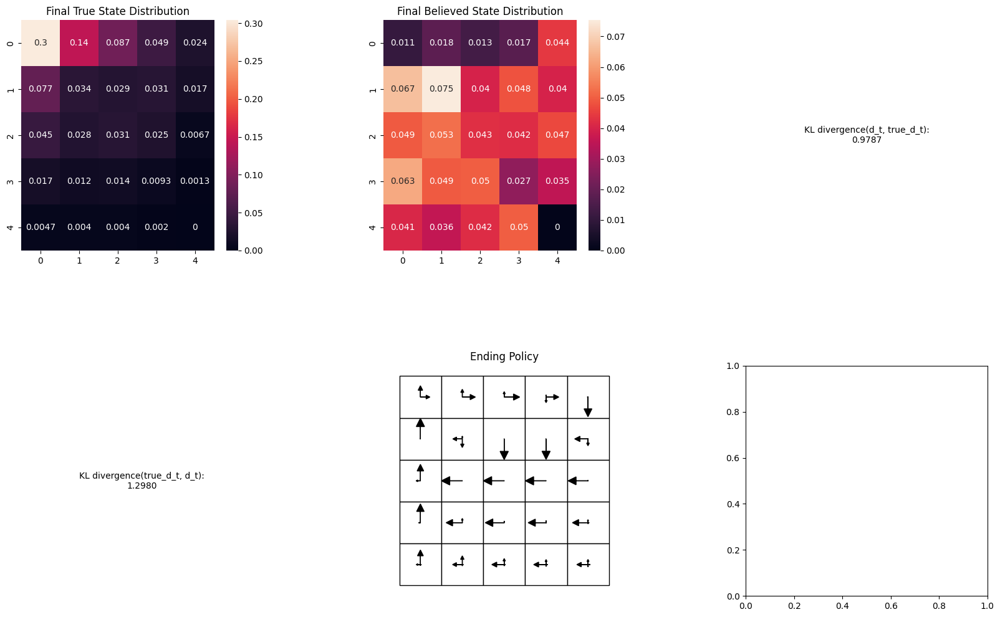

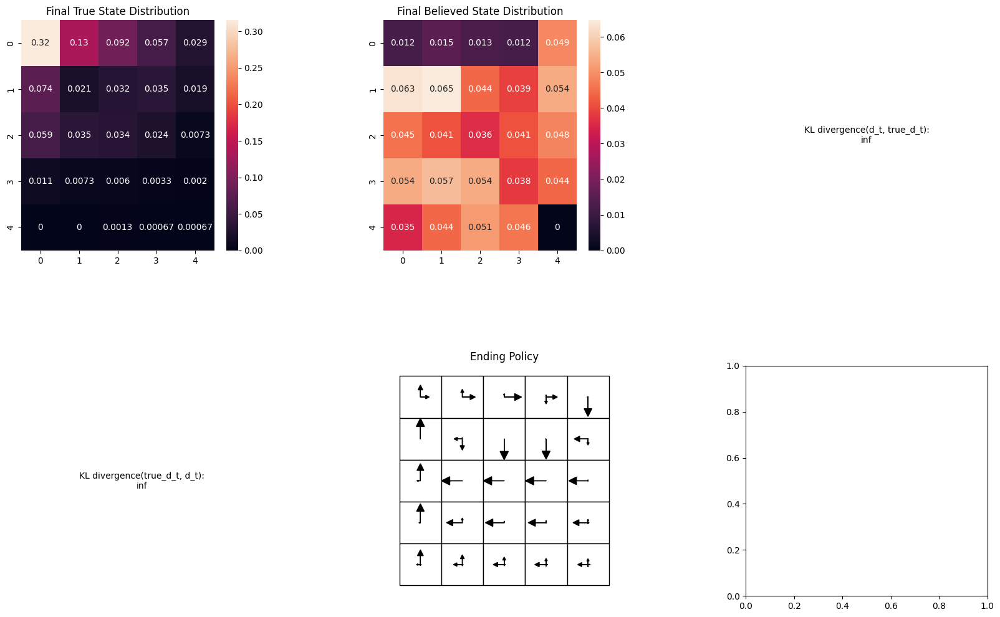

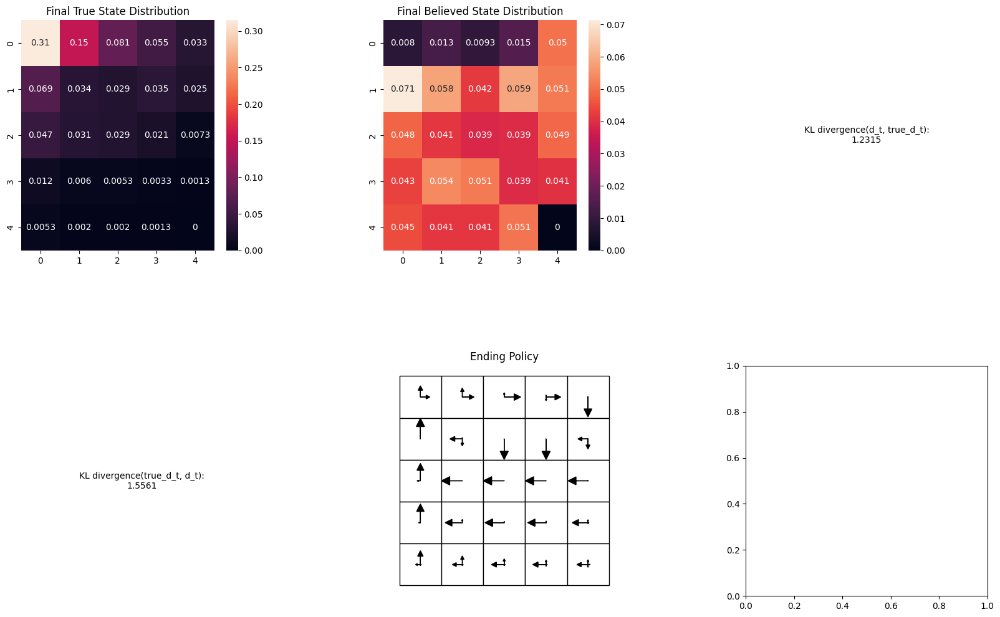

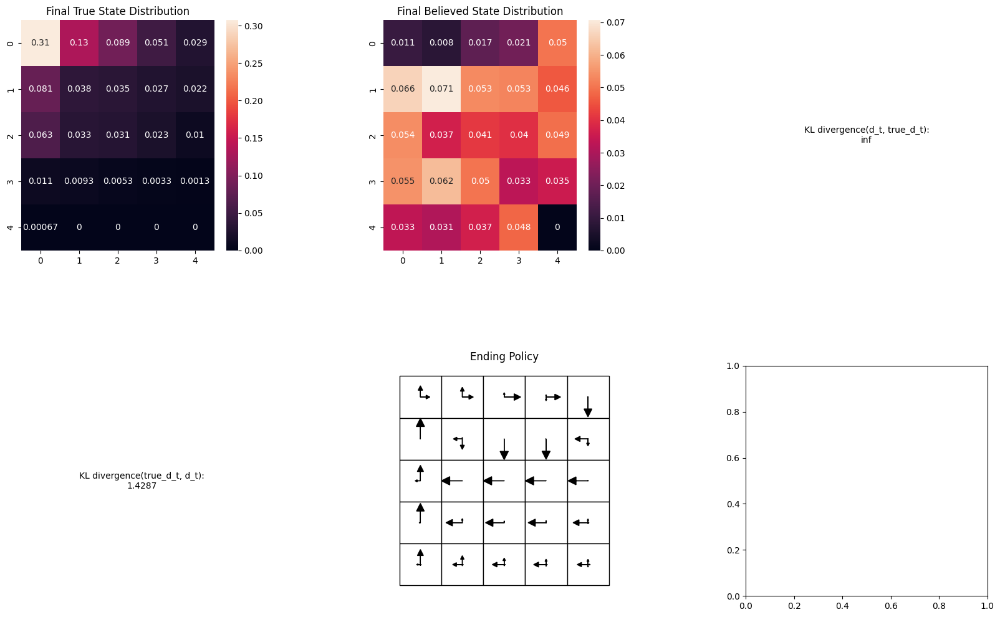

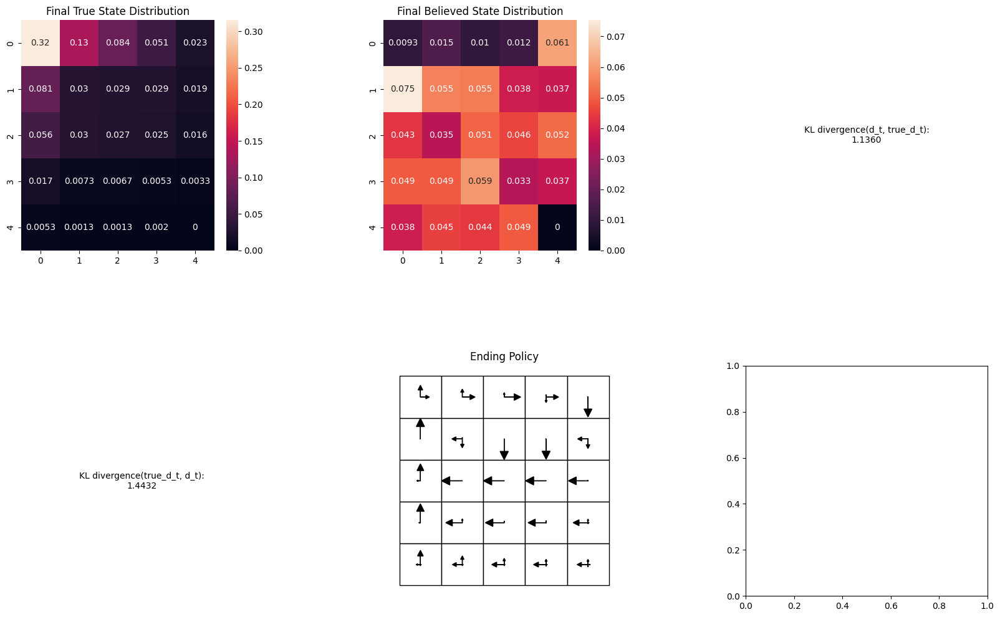

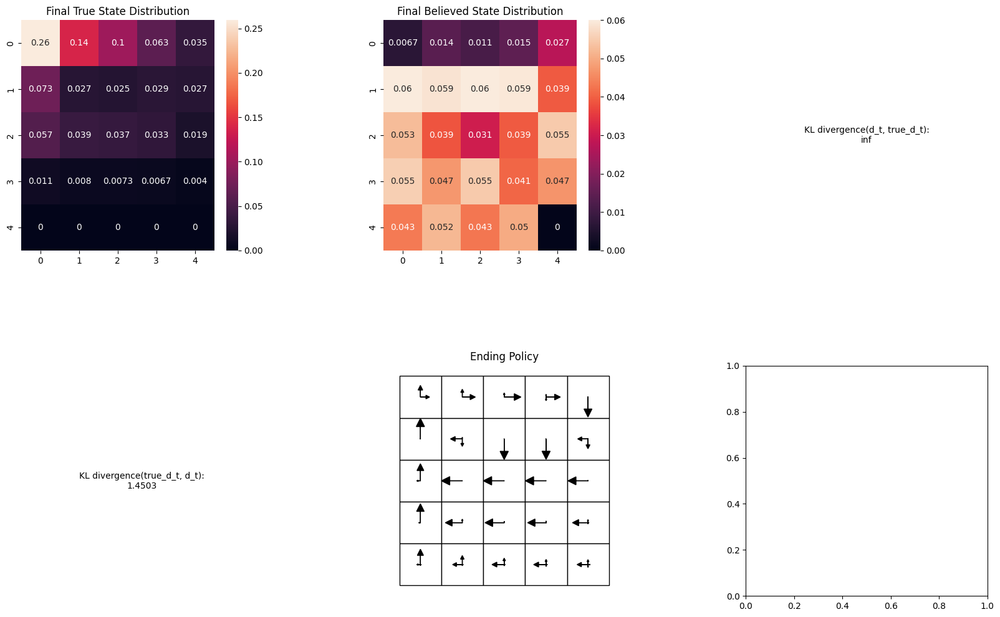

Believed Entropy mean: 2.5675798879806693
True Entropy mean: 2.0227850680207697


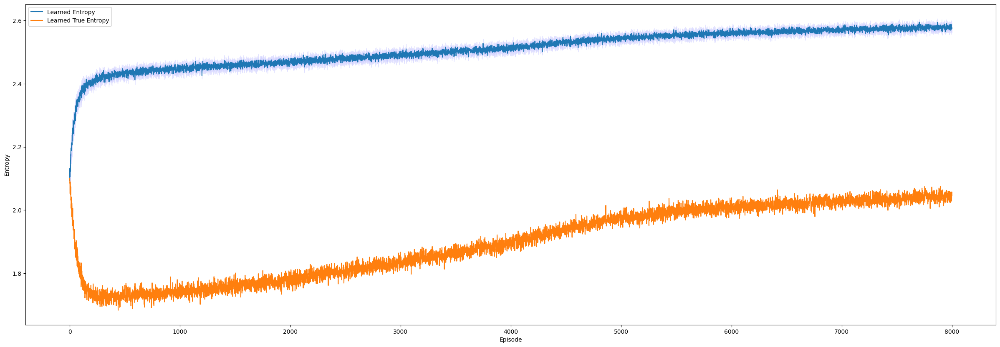

In [18]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=1
uniform=0
prob=0.1
randomize=0
# Agent variables
alpha = 0.4
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

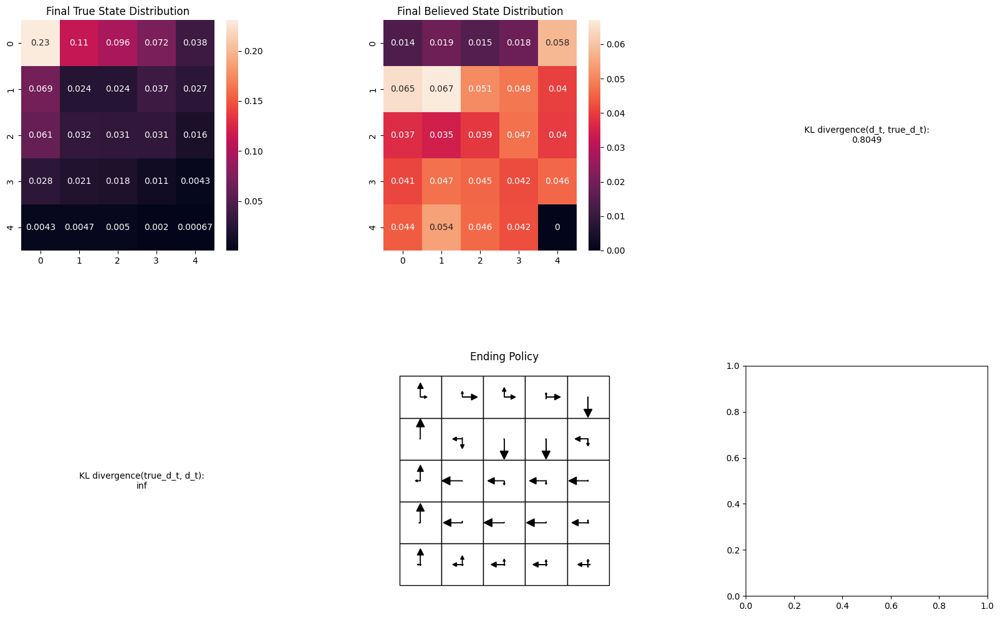

Run 0:  98%|█████████████████████████████▎| 5850/6000 [1:25:12<02:03,  1.21it/s]

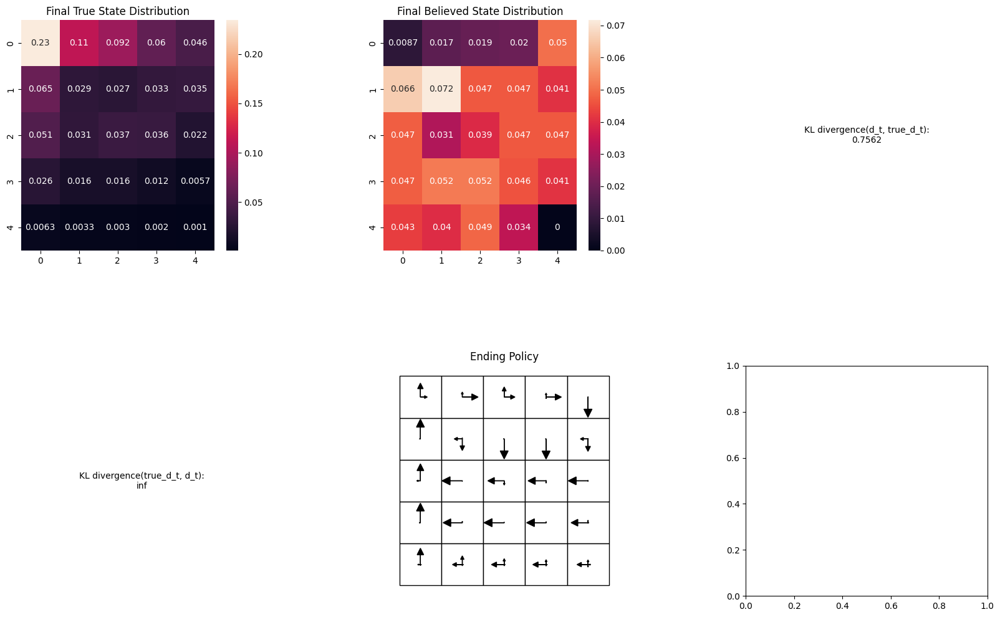

Run 0:  98%|█████████████████████████████▎| 5860/6000 [1:25:20<01:51,  1.25it/s]

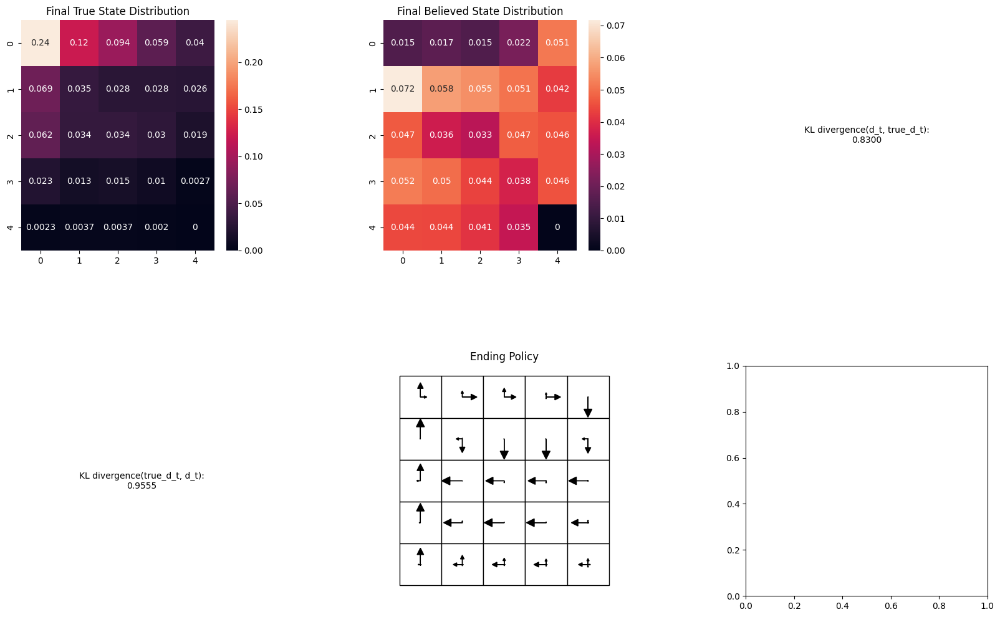

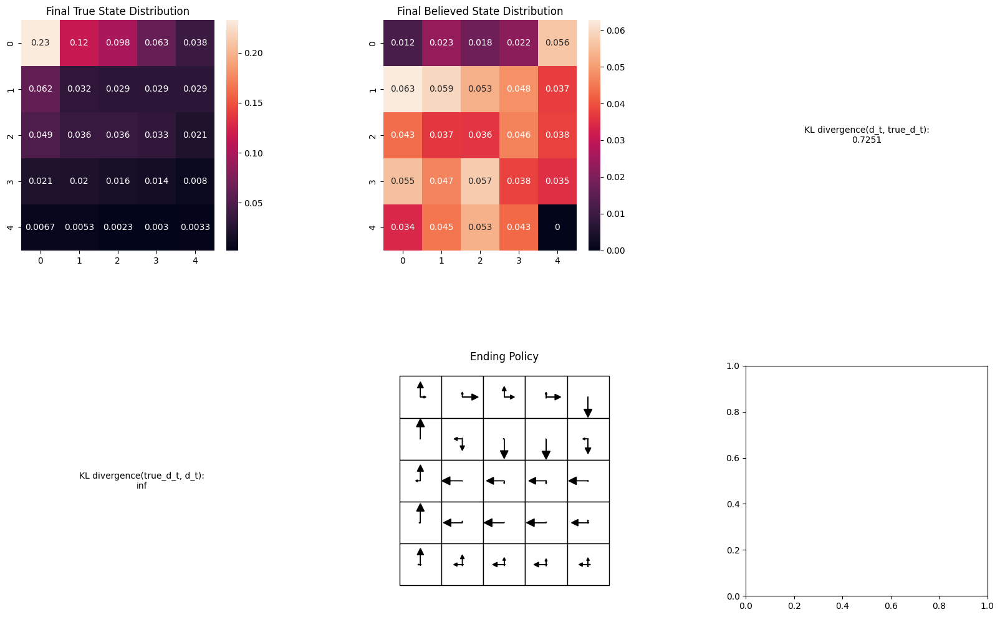

Run 0:  98%|█████████████████████████████▎| 5869/6000 [1:25:28<02:00,  1.08it/s]

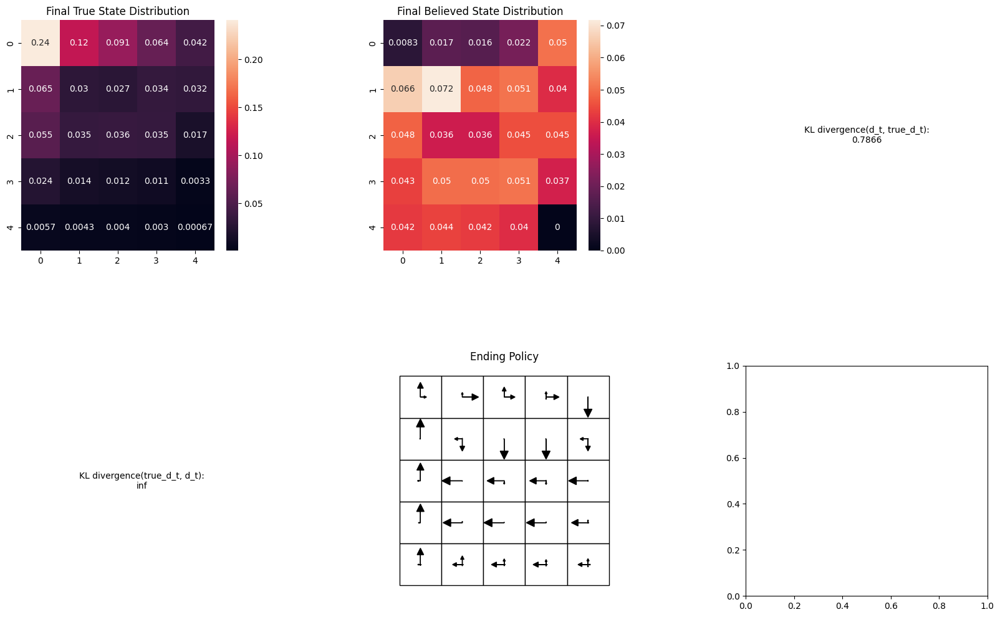

Run 0:  98%|█████████████████████████████▎| 5871/6000 [1:25:30<01:58,  1.09it/s]

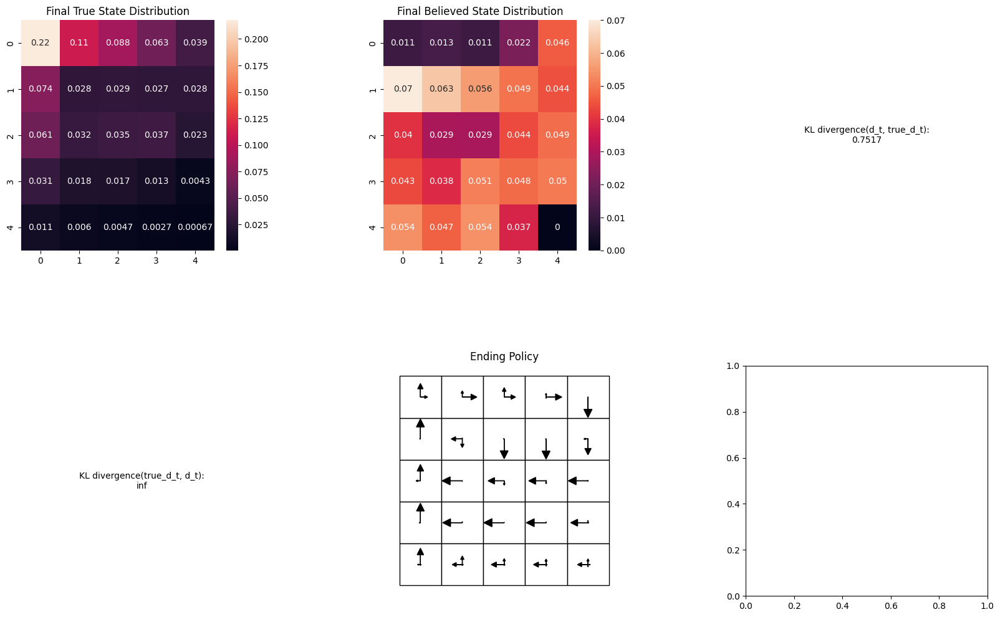

Run 0:  98%|█████████████████████████████▍| 5878/6000 [1:25:36<01:44,  1.16it/s]

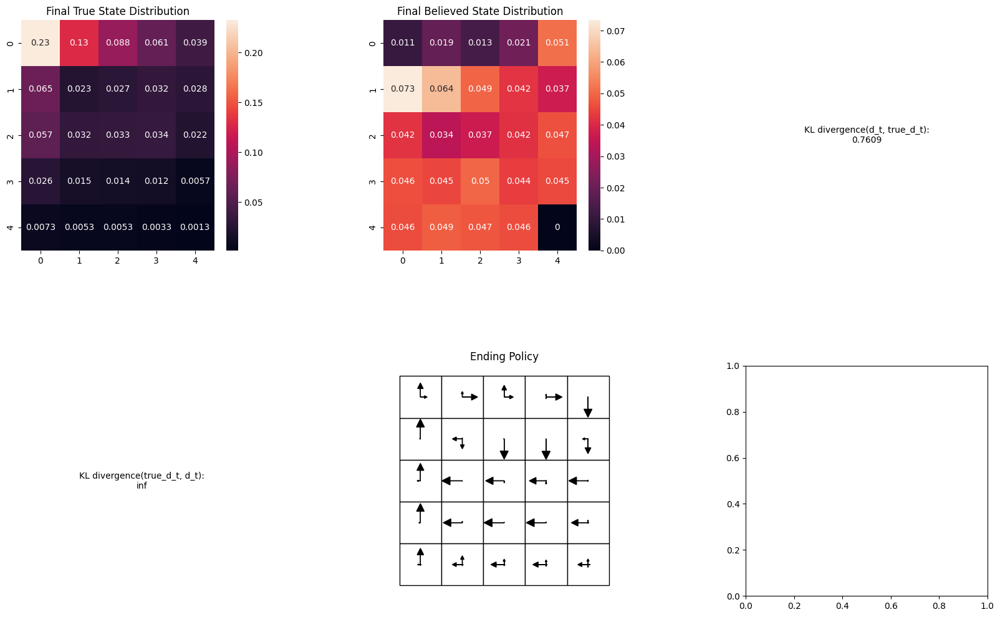

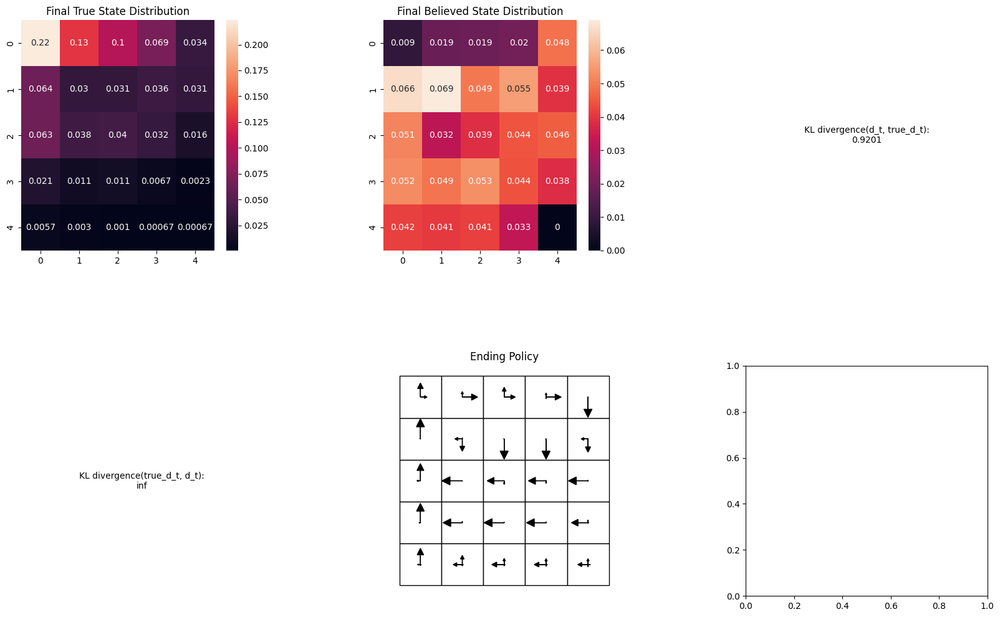

Run 0:  99%|█████████████████████████████▌| 5918/6000 [1:26:08<01:05,  1.26it/s]

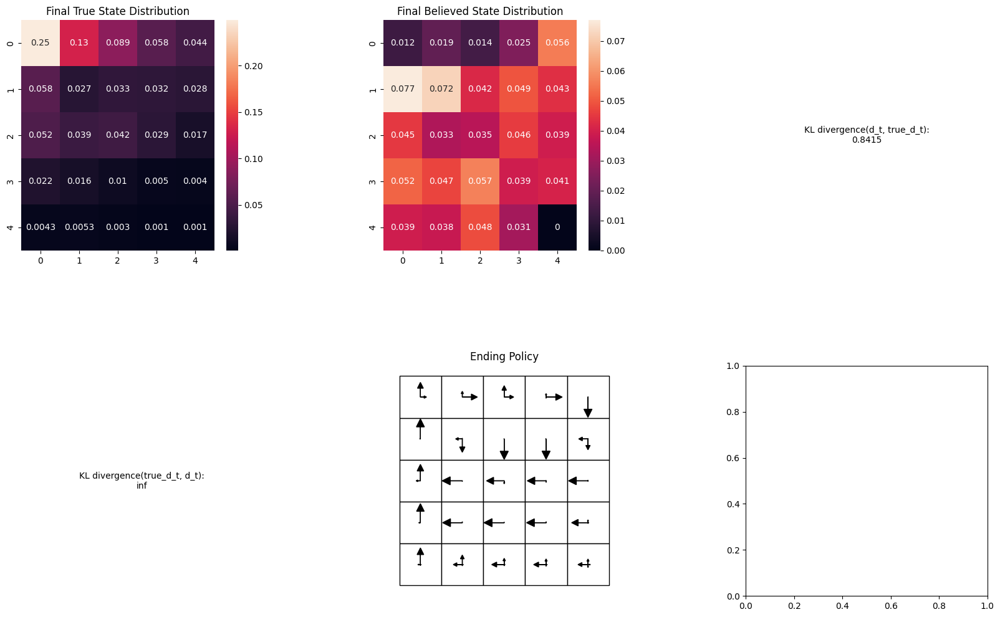

Run 0: 100%|██████████████████████████████| 6000/6000 [1:27:11<00:00,  1.15it/s]


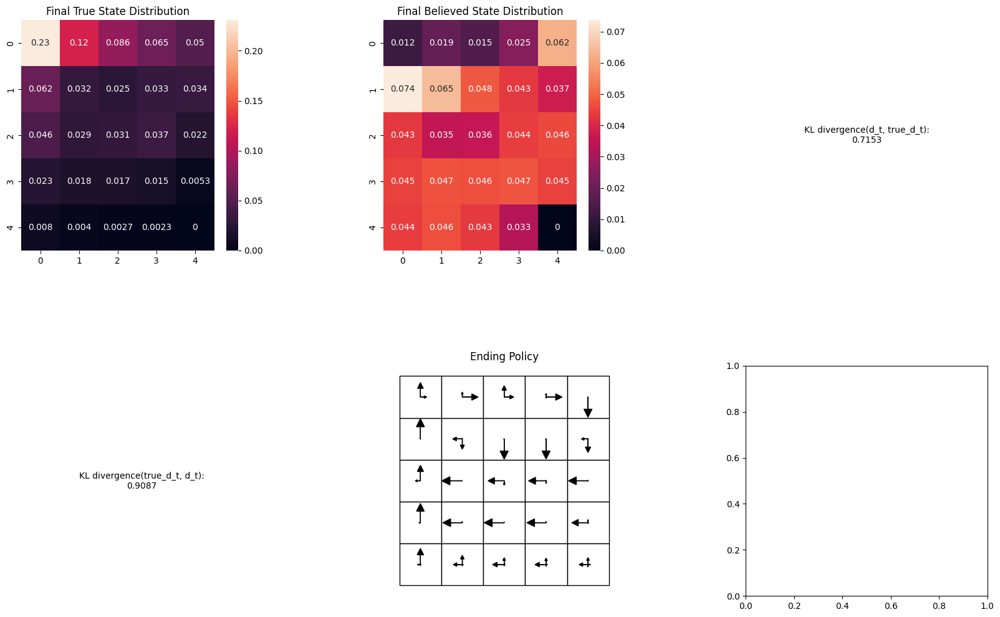

Believed Entropy mean: 2.8401814177196467
True Entropy mean: 2.4320315615407186


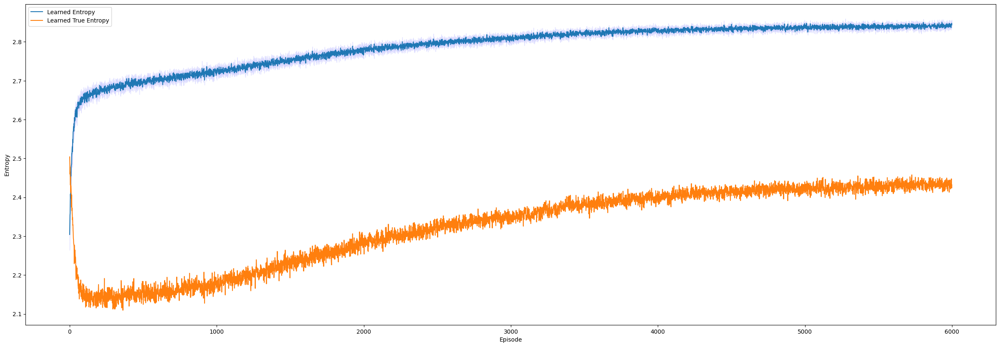

In [21]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=1
uniform=0
prob=0.1
randomize=0
# Agent variables
alpha = 0.4
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

0.9999999999999999
0.19399794212431026


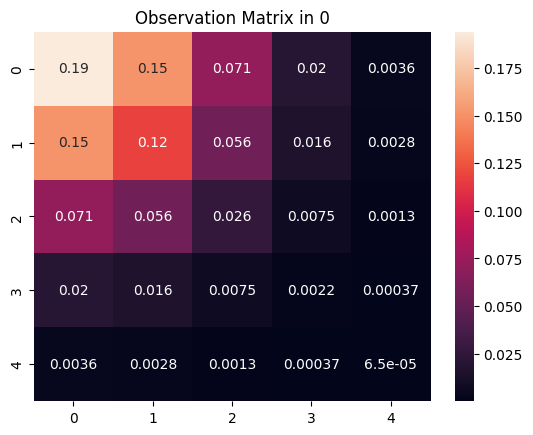

In [19]:
env = gym.make('GridworldPOMDPEnvGoalless-v0', steepness=2)
agent = agents.REINFORCEAgentEPOMDP(env=env)
print_heatmap(agent, env.observation_matrix[0], "Observation Matrix in 0")
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

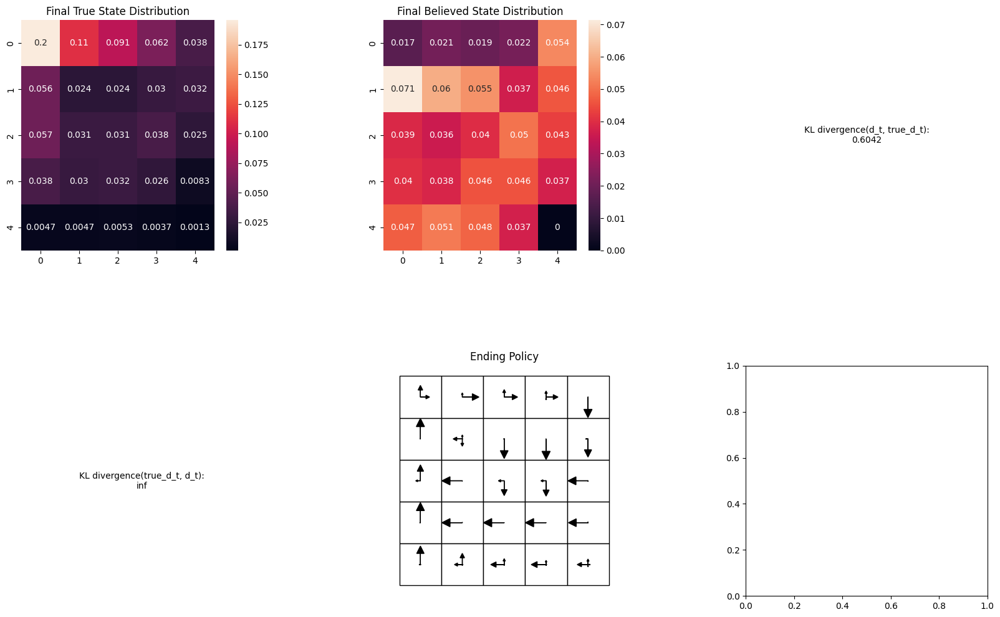

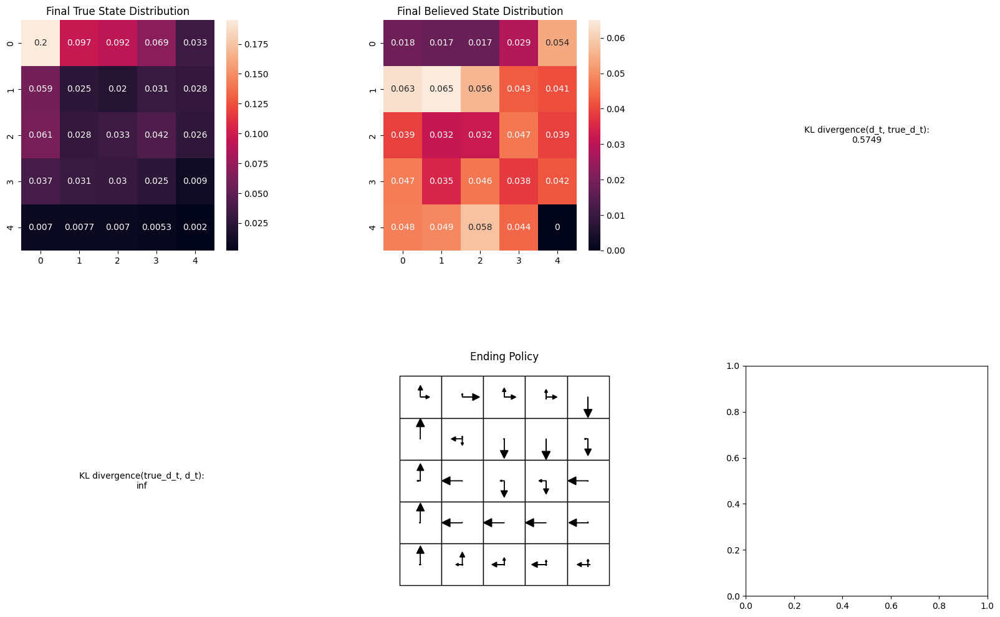

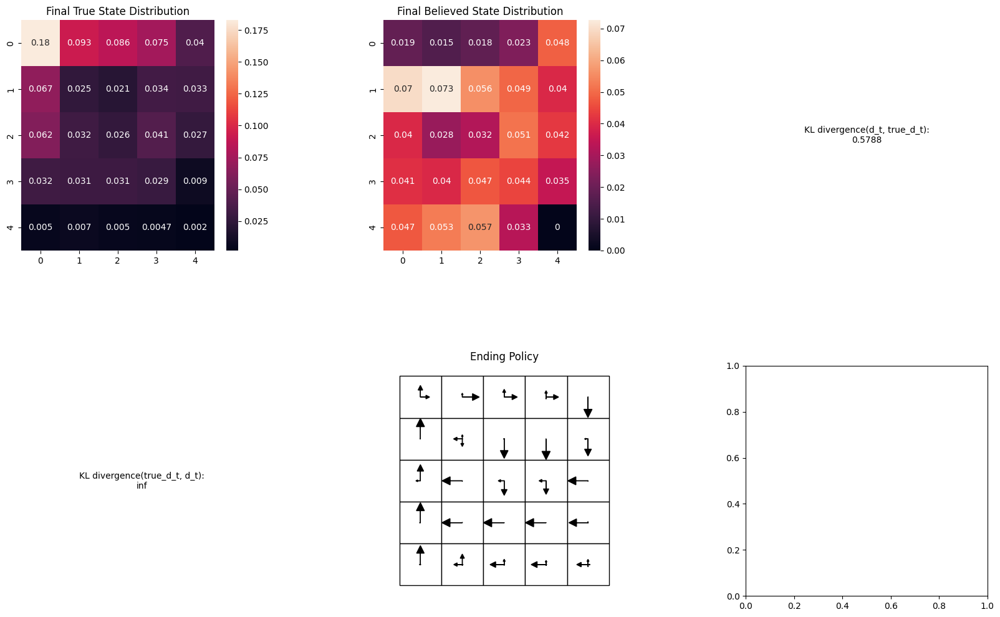

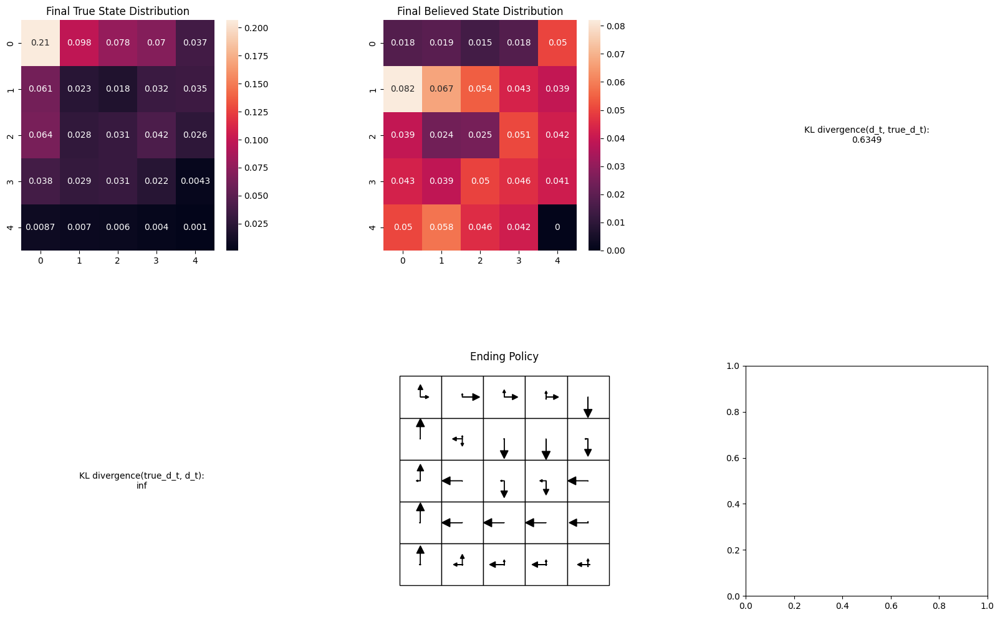

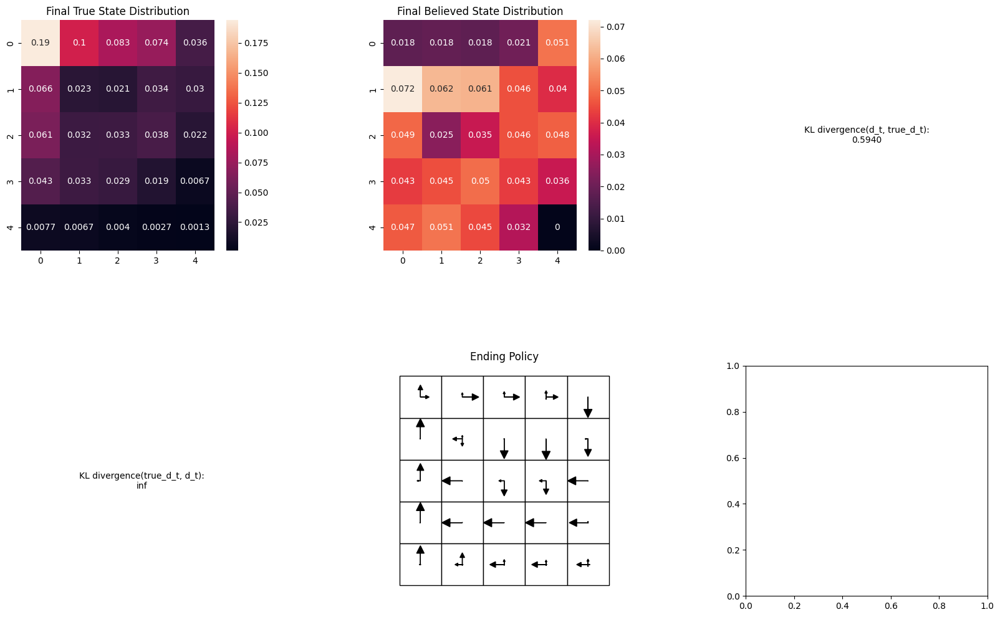

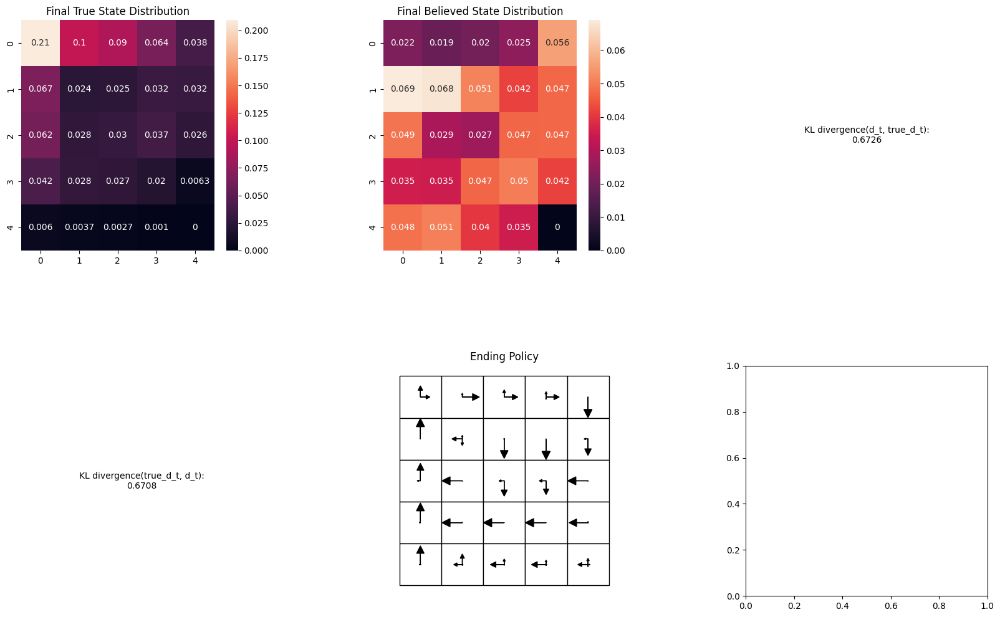

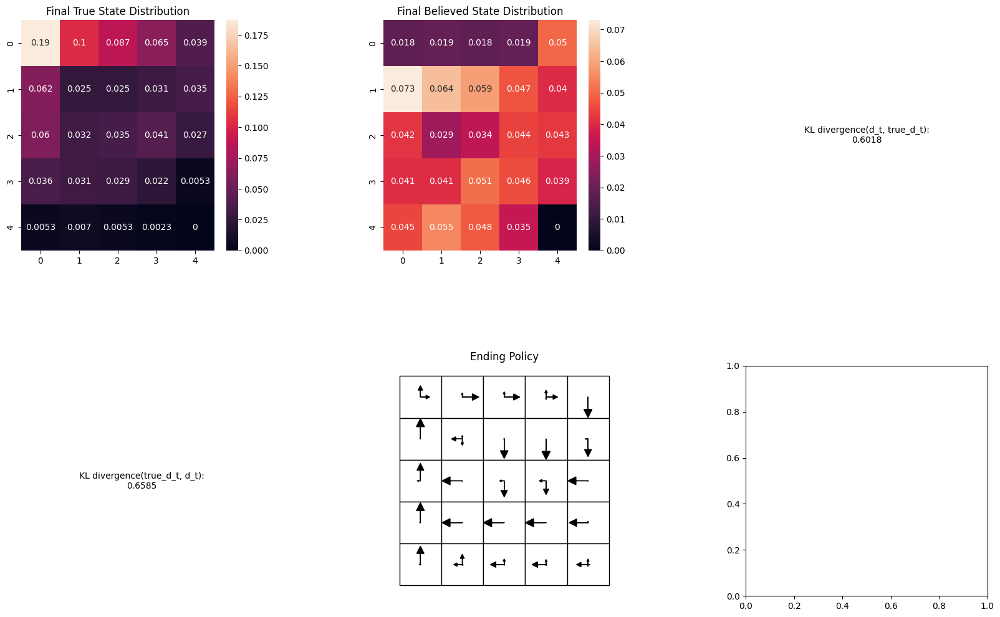

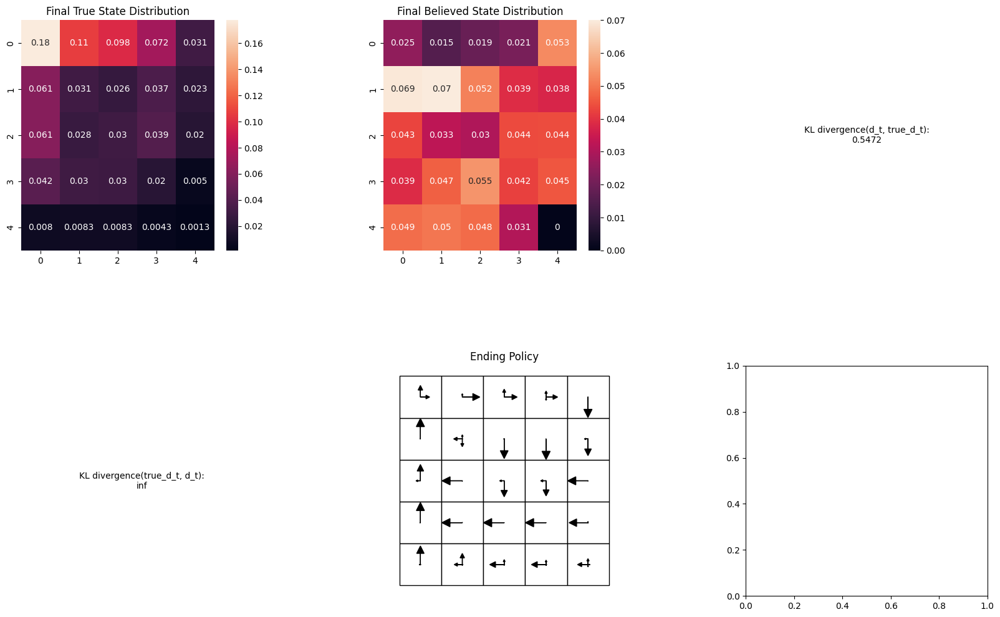

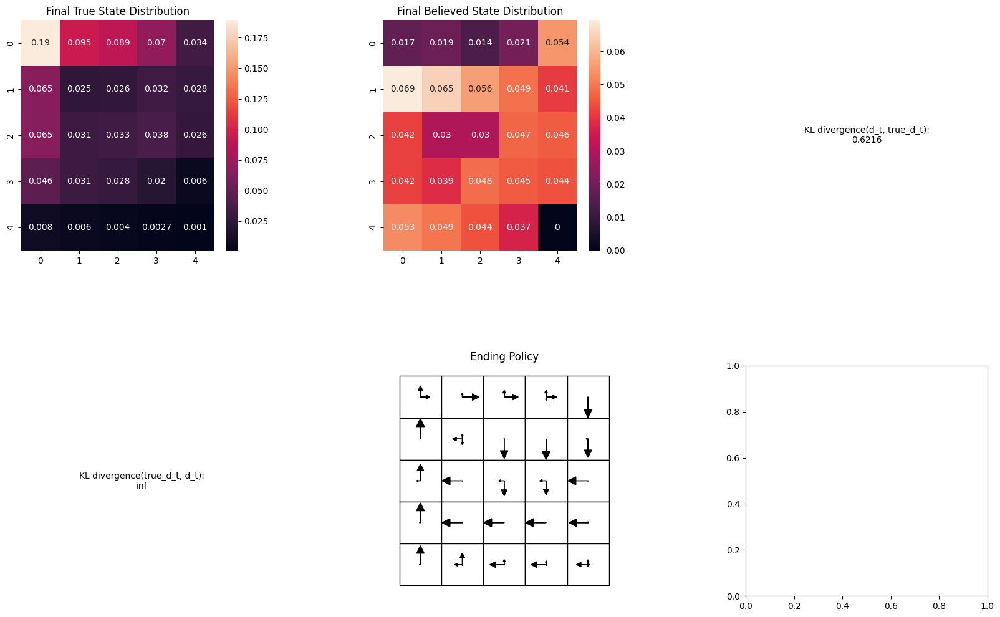

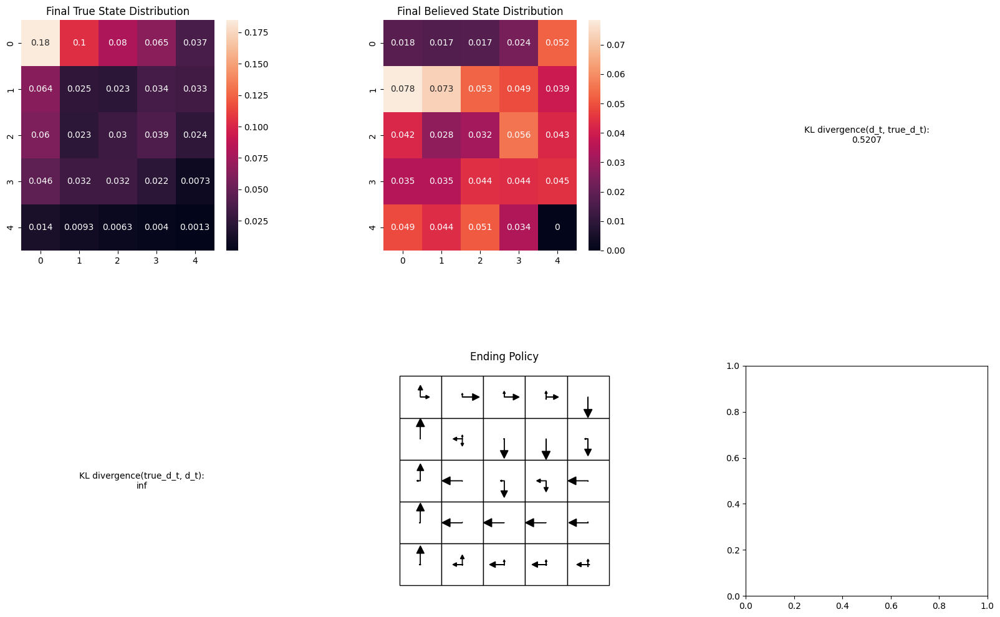

Believed Entropy mean: 2.8563133042240305
True Entropy mean: 2.597429416698357


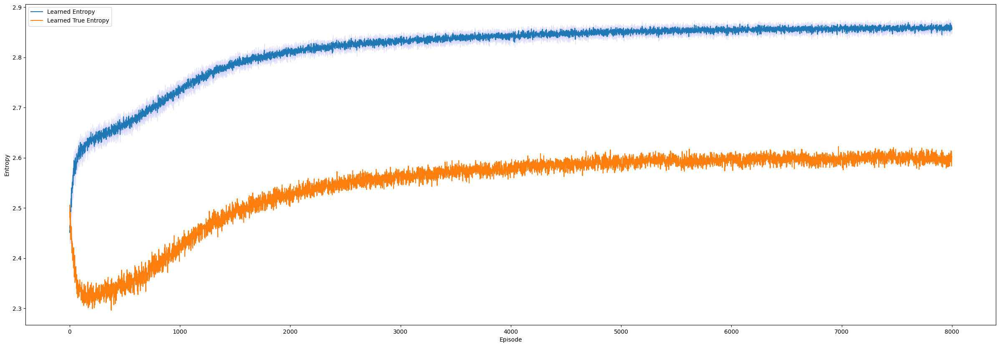

In [20]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=2
uniform=0
prob=0.1
randomize=0
# Agent variables
alpha = 0.4
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

# Bimodal Env

In [21]:
gym.envs.register(
    id='GridworldPOMDPEnvBiModal-v0',
    entry_point=environments.GridworldPOMDPEnvBiModal
)
env = gym.make('GridworldPOMDPEnvBiModal-v0', steepness=20, shift_amount=0.8)

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/envs/registration.py:498: UserWarning: WARN: Overriding environment GridworldPOMDPEnvBiModal-v0 already in registry.
  logger.warn(f"Overriding environment {new_spec.id} already in registry.")


In [22]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount = args
    env = gym.make("GridworldPOMDPEnvBiModal-v0", time_horizon=time_horizon, steepness=steepness, prob=prob, randomize=randomize, shift_amount=shift_amount, uniform=uniform)  # Create a new environment for each run
    agent = agents.REINFORCEAgentEPOMDP(env, alpha=alpha)
    avg_entropies = []
    avg_true_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
                pbar.update(1)
    else:
        for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies, avg_true_entropies

1.0
0.1512499088705753


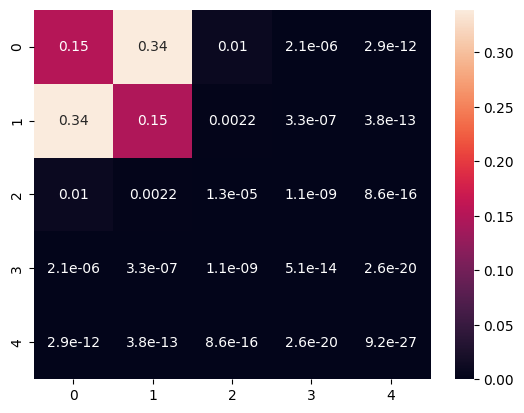

In [23]:
# Test observation matrix
sns.heatmap(np.reshape(env.observation_matrix[0], (env.grid_size, env.grid_size)), annot=True)
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))


**Deterministic BiModal**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0: 100%|████████████████████████████████| 6000/6000 [40:37<00:00,  2.46it/s]


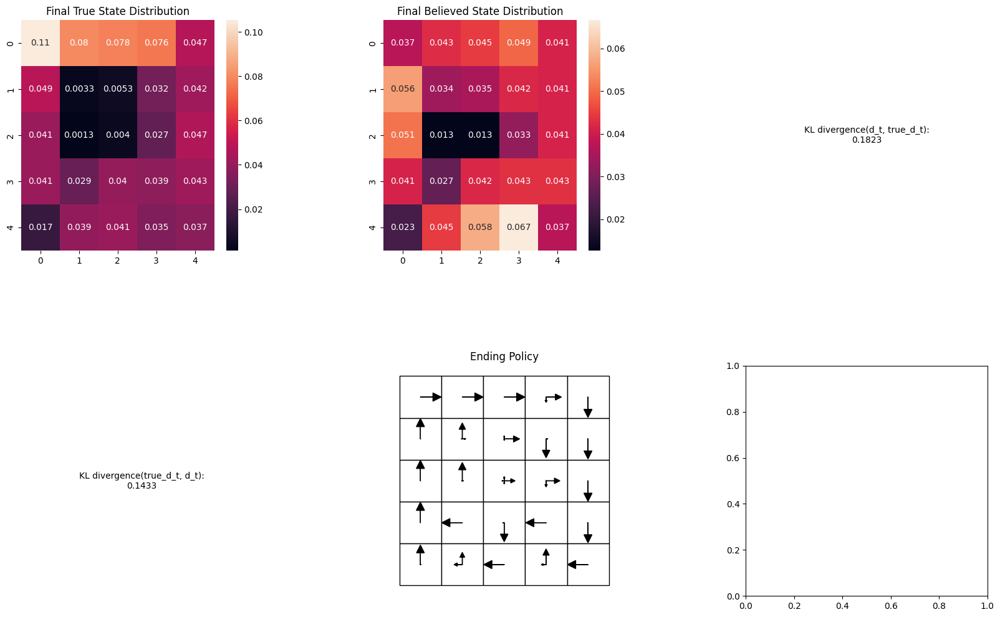

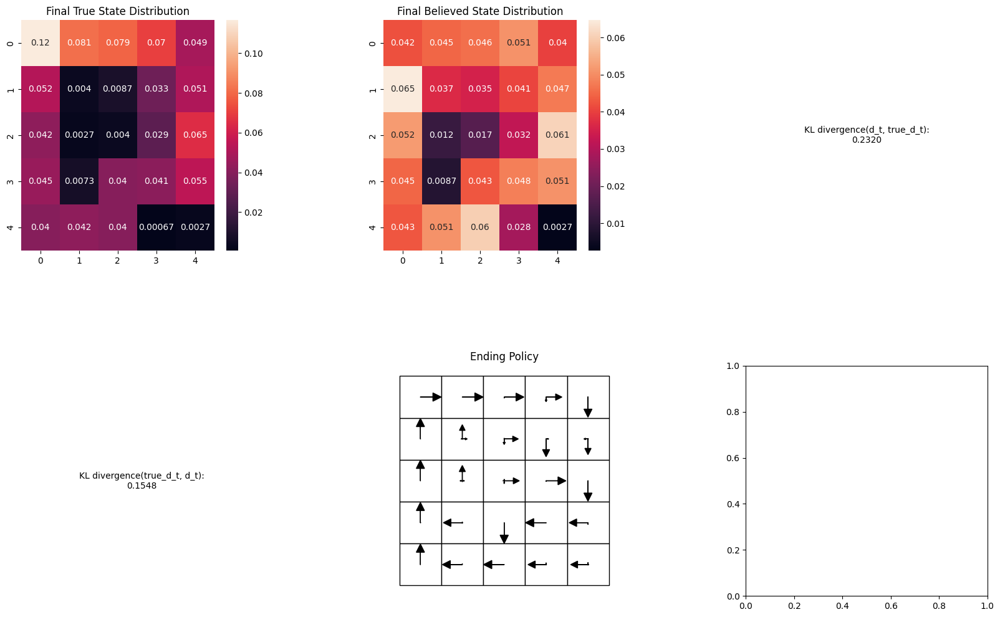

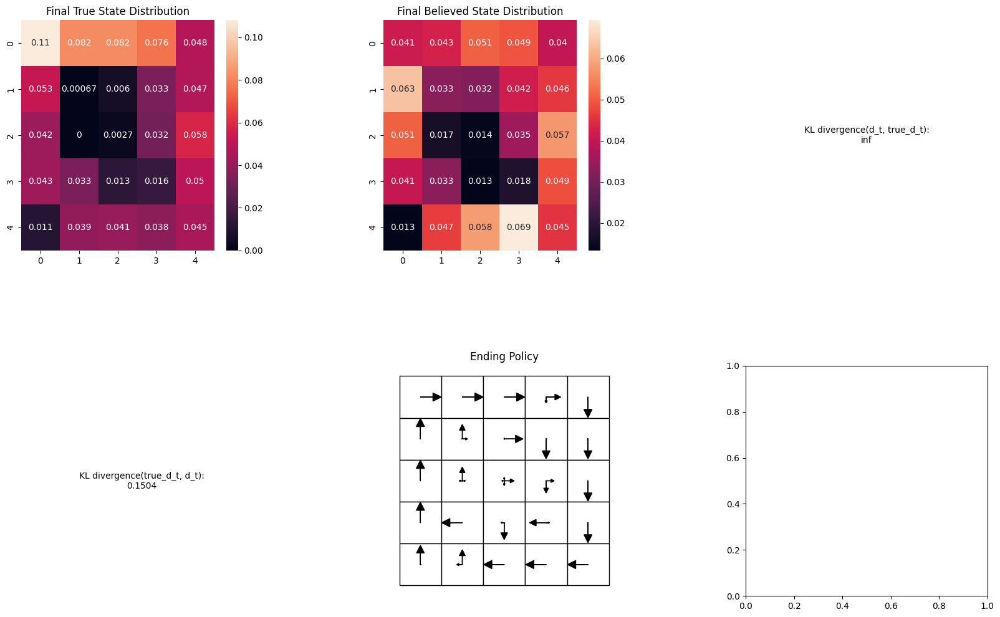

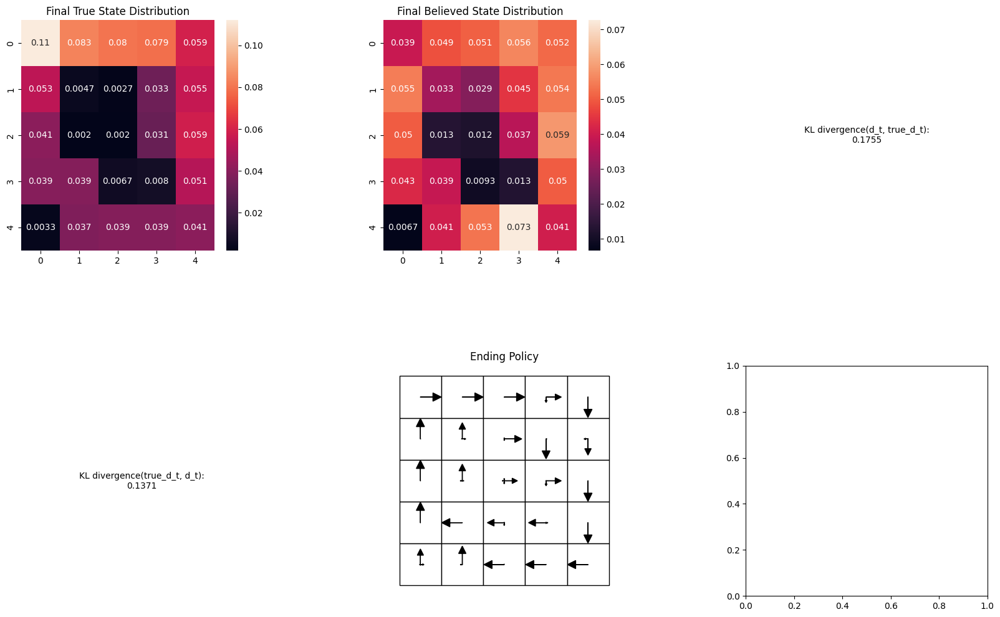

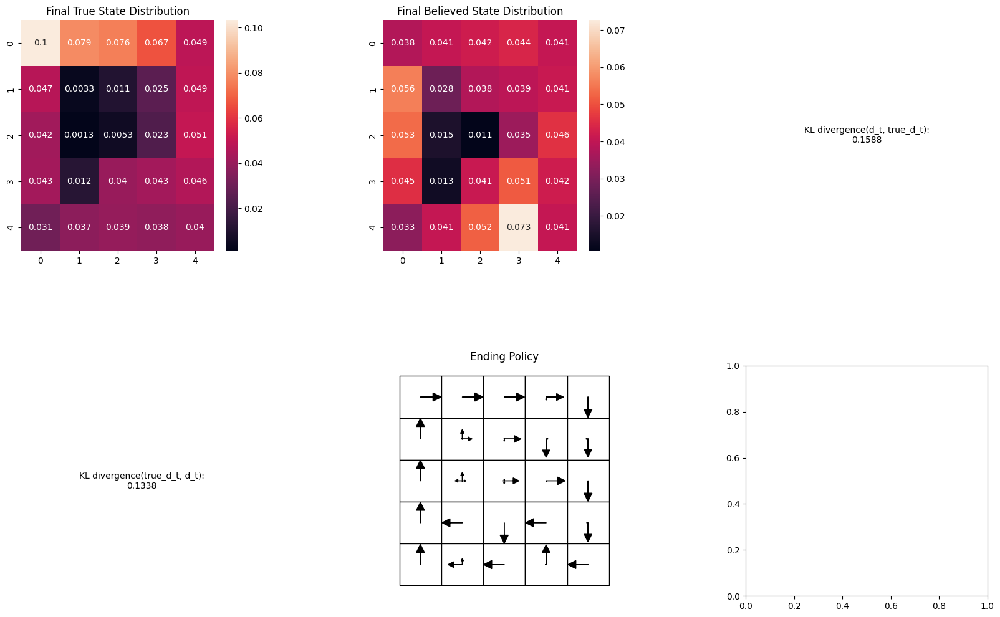

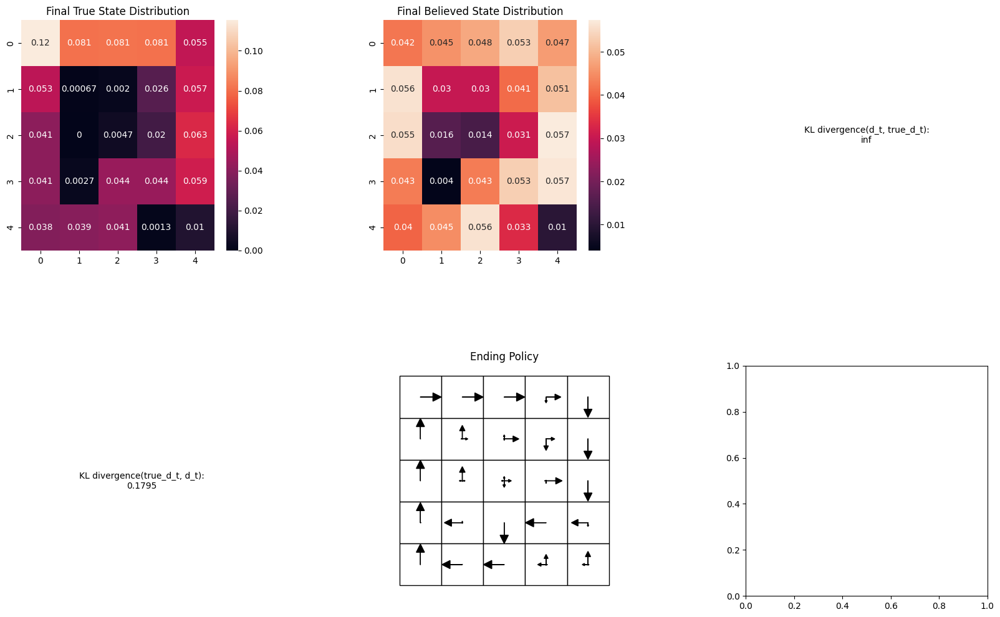

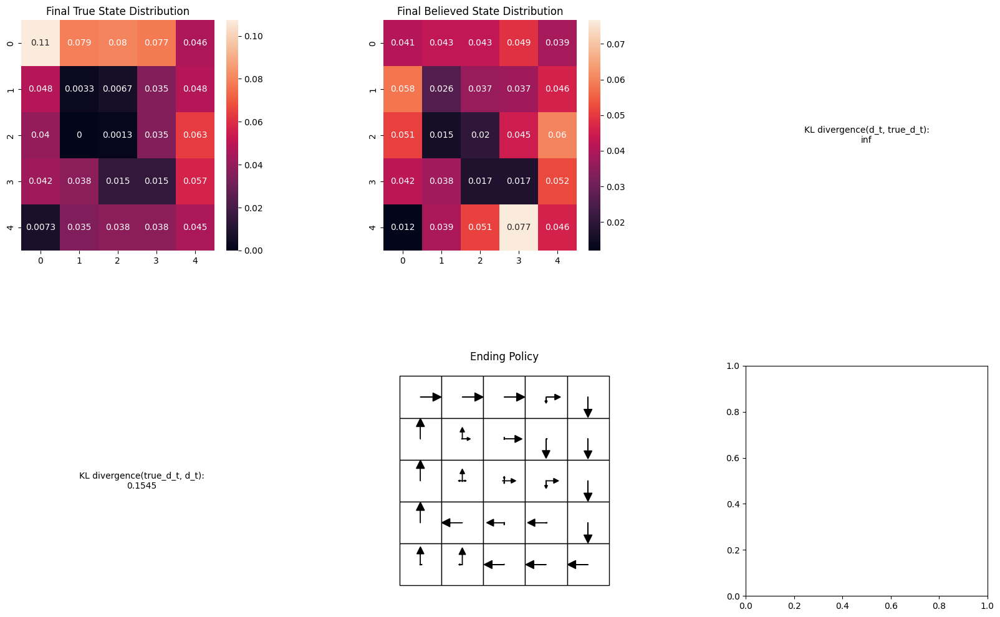

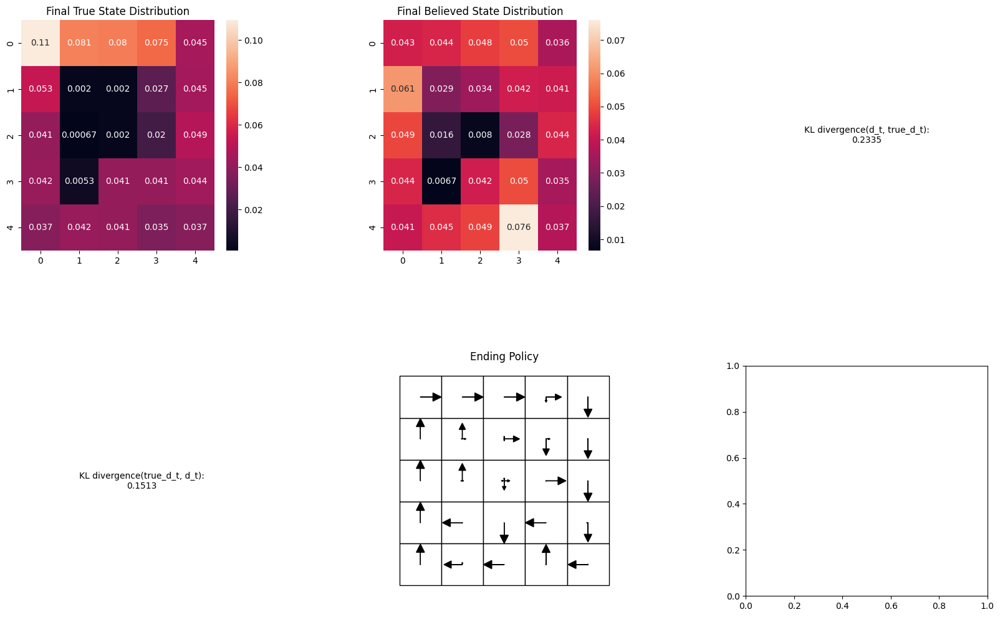

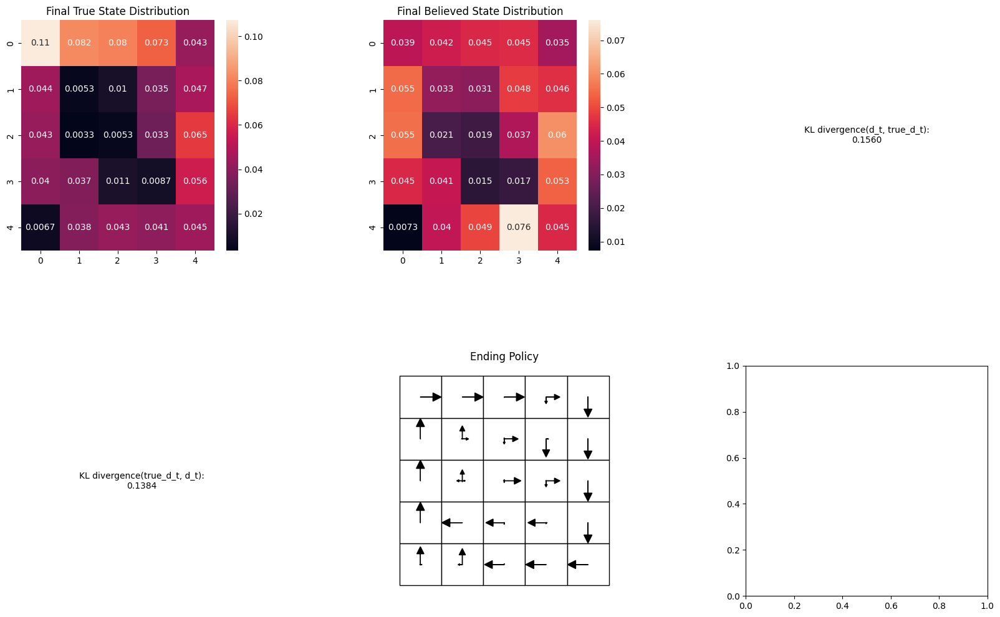

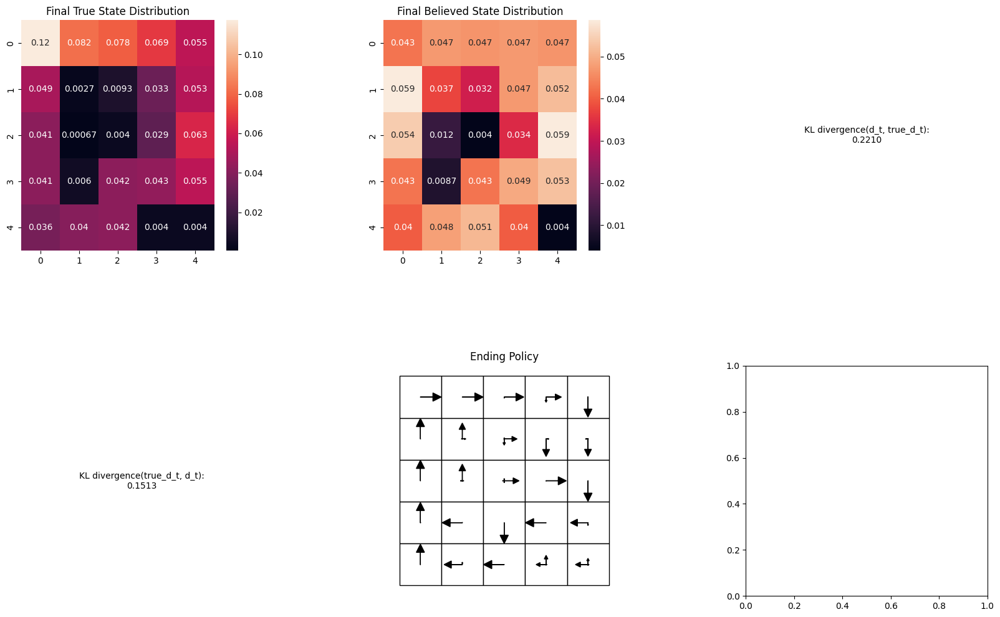

Believed Entropy mean: 2.897958798238971
True Entropy mean: 2.7947130580128143


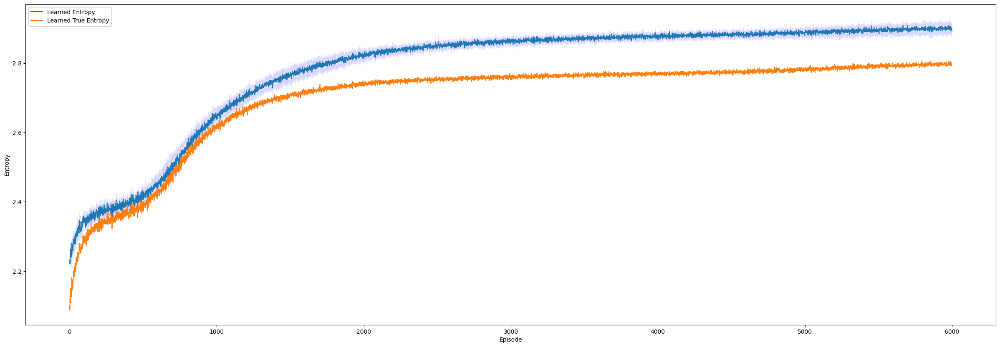

In [24]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0
randomize=0
shift_amount=0.8
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP BiModal")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Deterministic BiModal Random Initial Position**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0: 100%|████████████████████████████████| 6000/6000 [40:30<00:00,  2.47it/s]


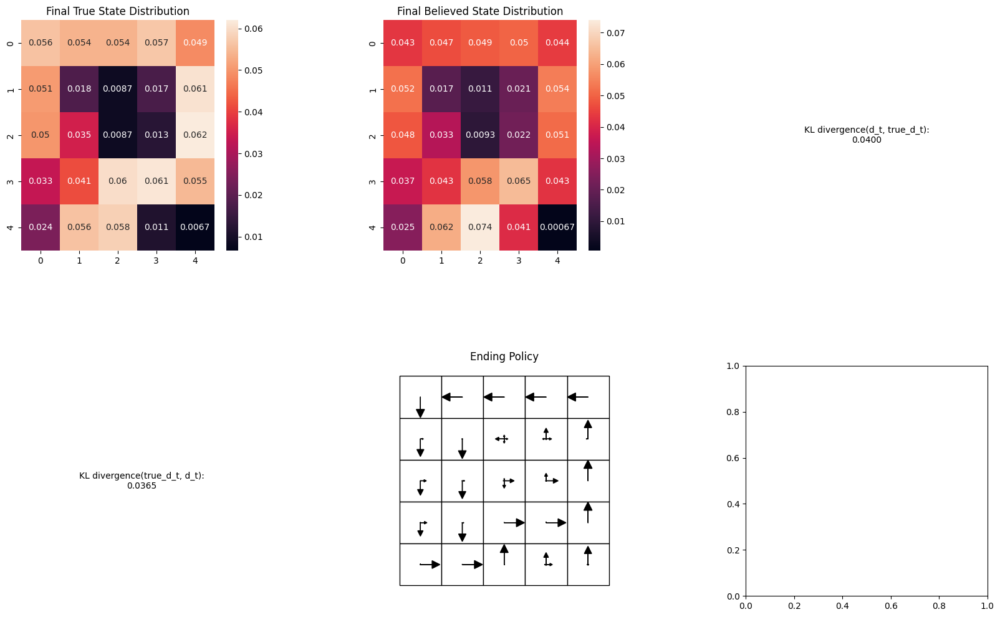

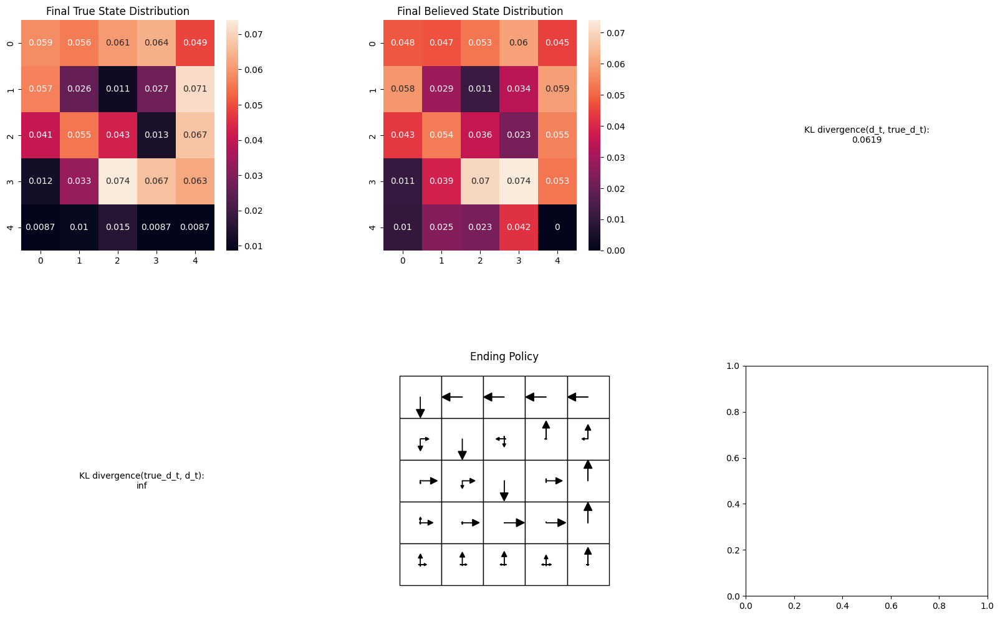

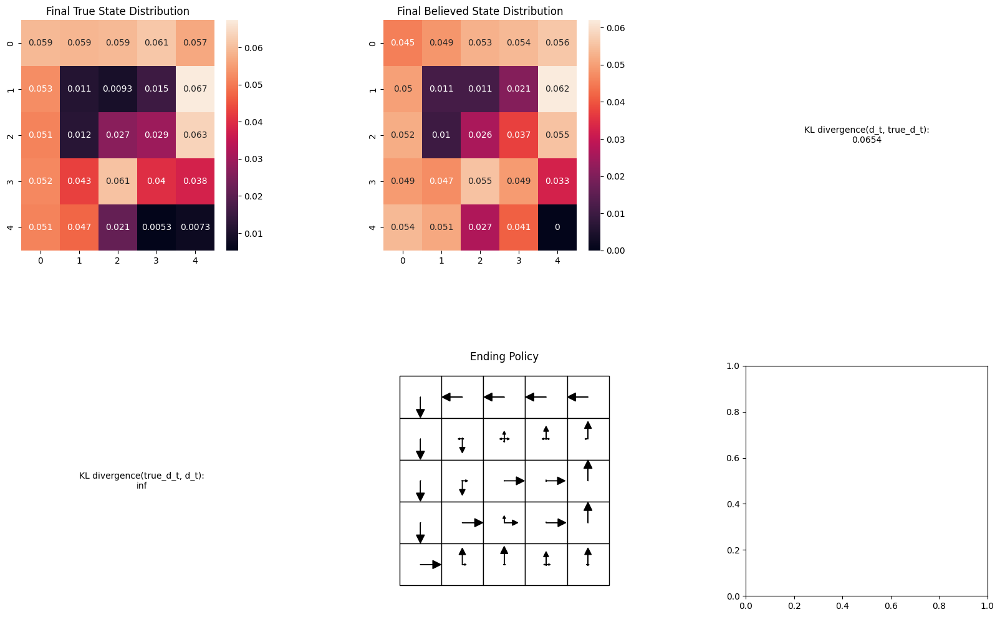

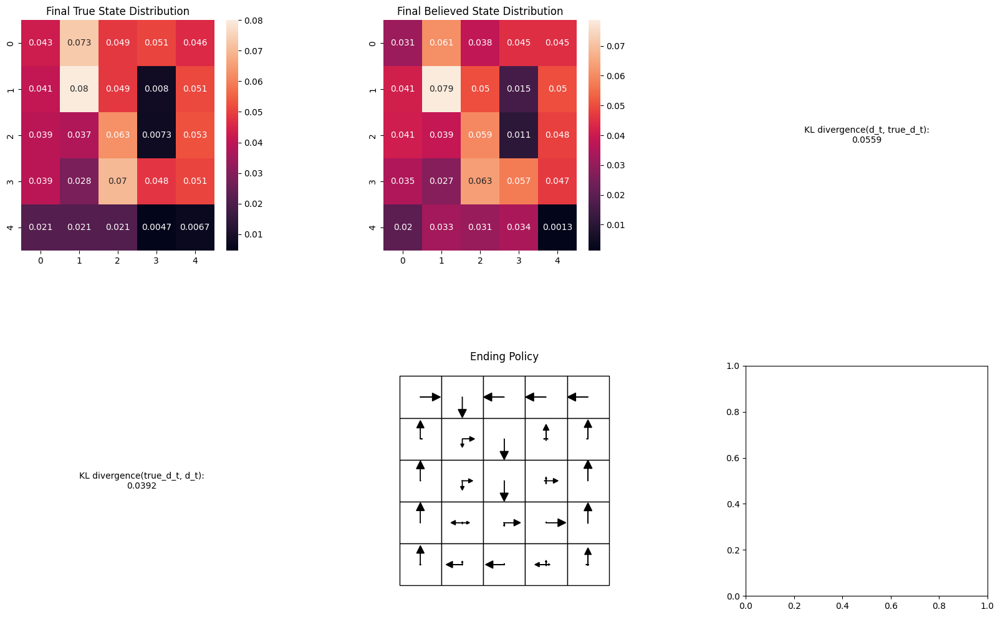

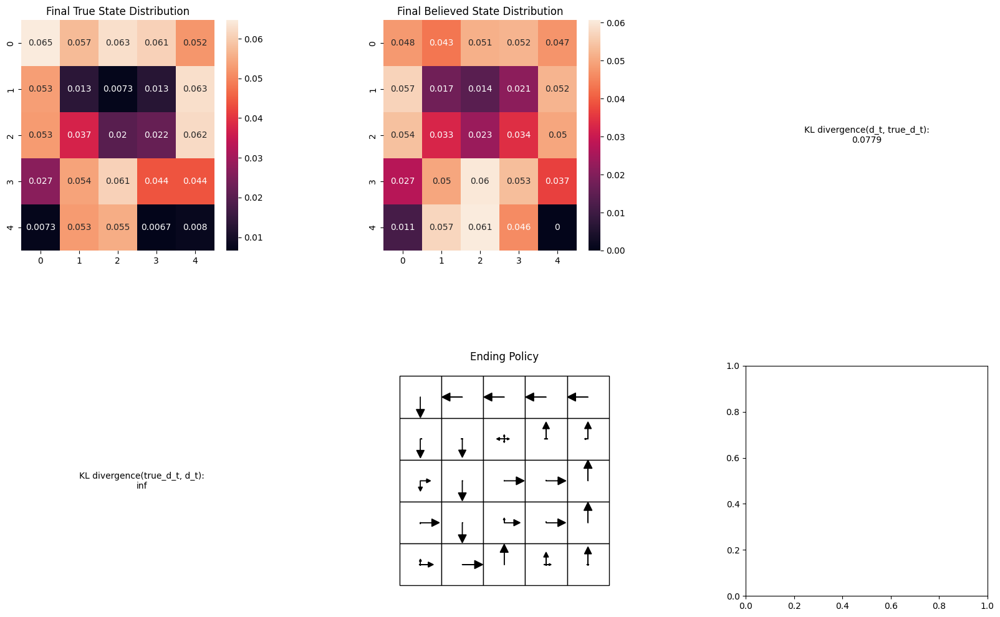

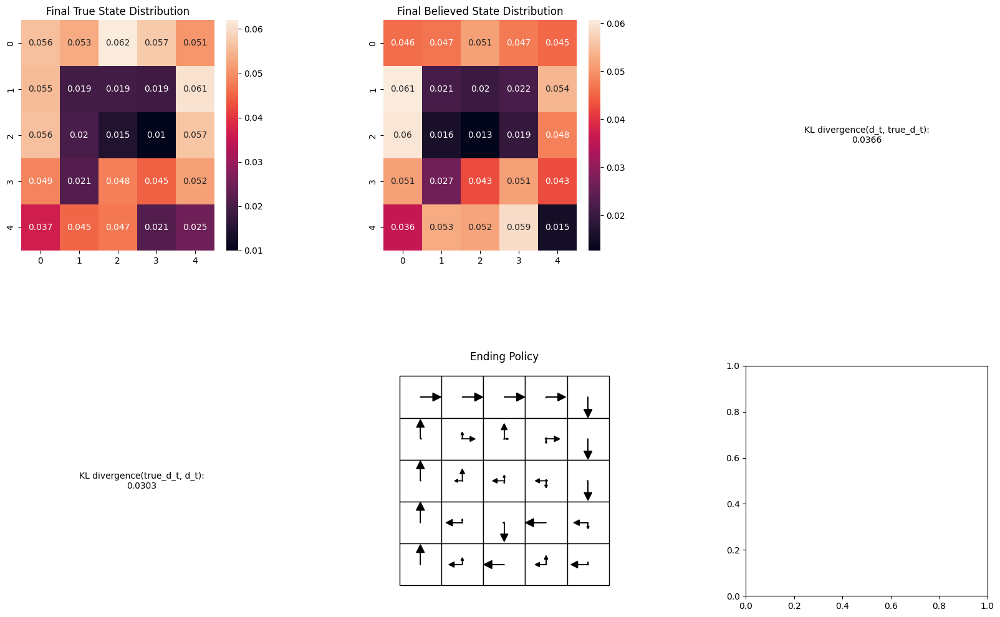

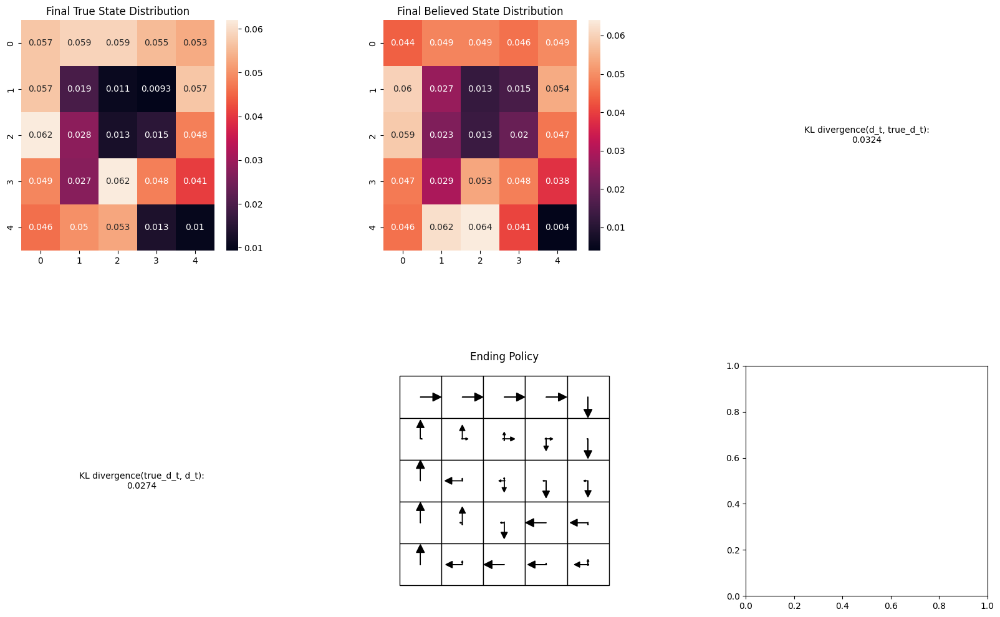

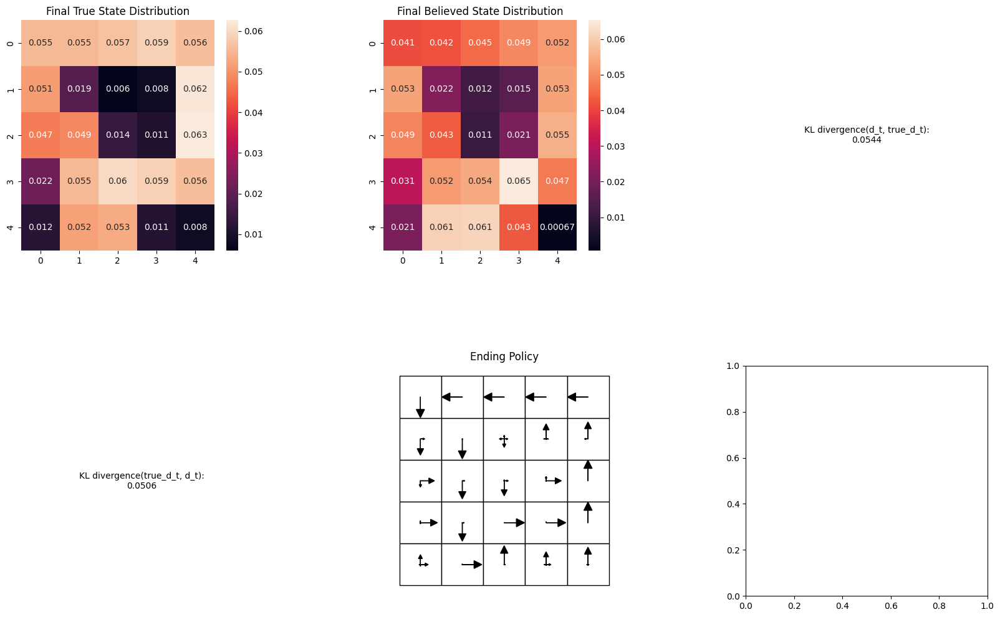

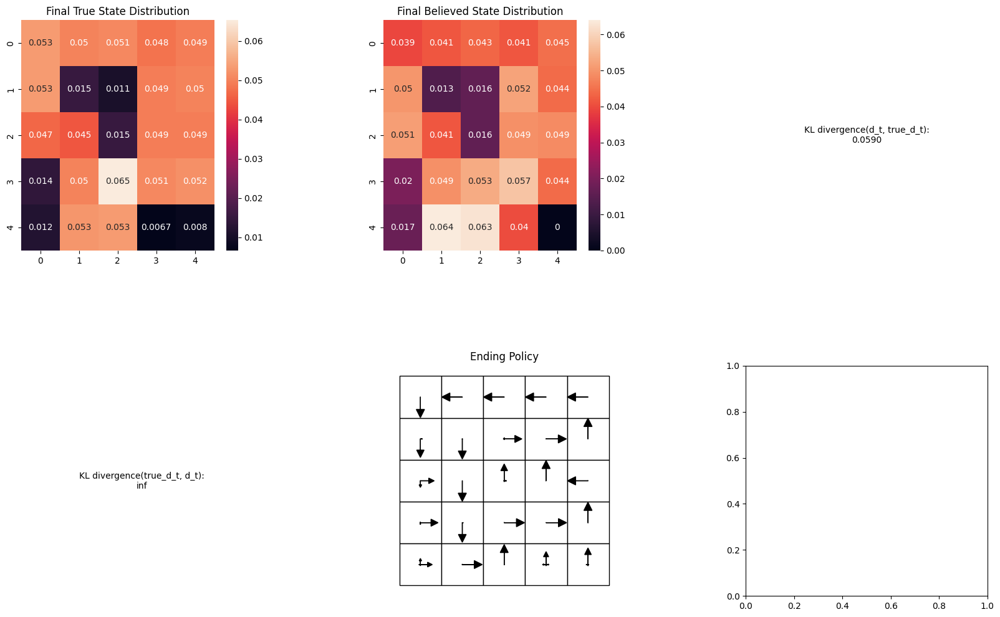

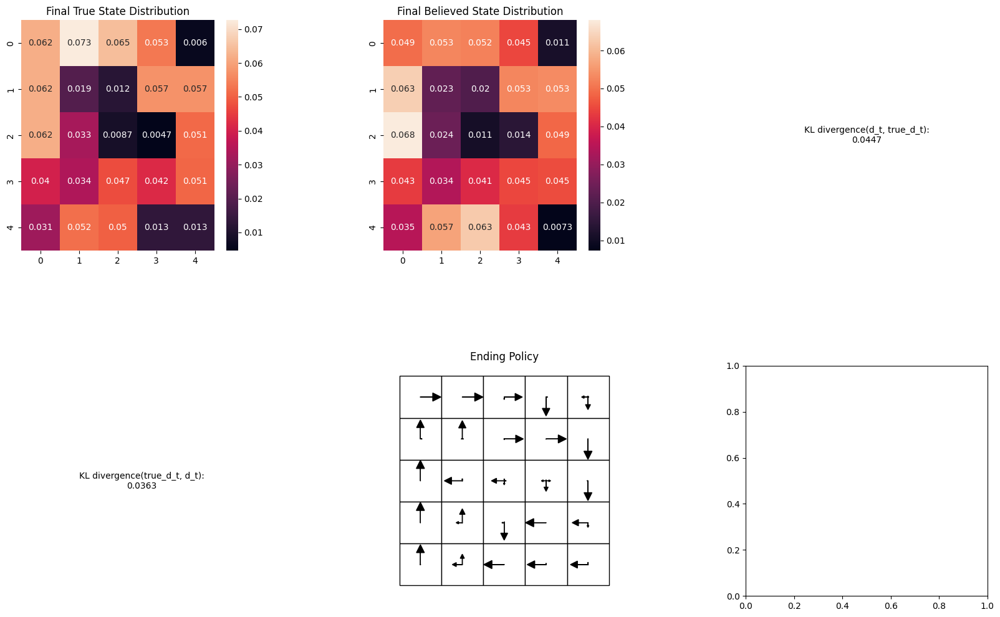

Believed Entropy mean: 2.826636843996718
True Entropy mean: 2.787153294759759


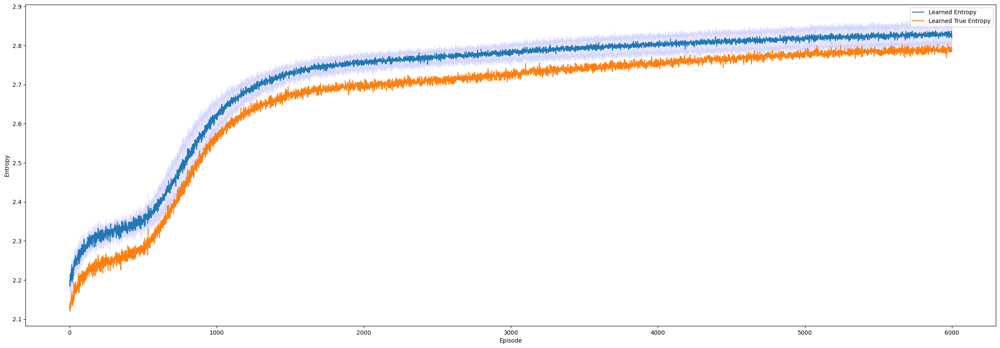

In [25]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0
randomize=1
shift_amount=0.8
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP BiModal Random Initial Position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Stochastic BiModal**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                          | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

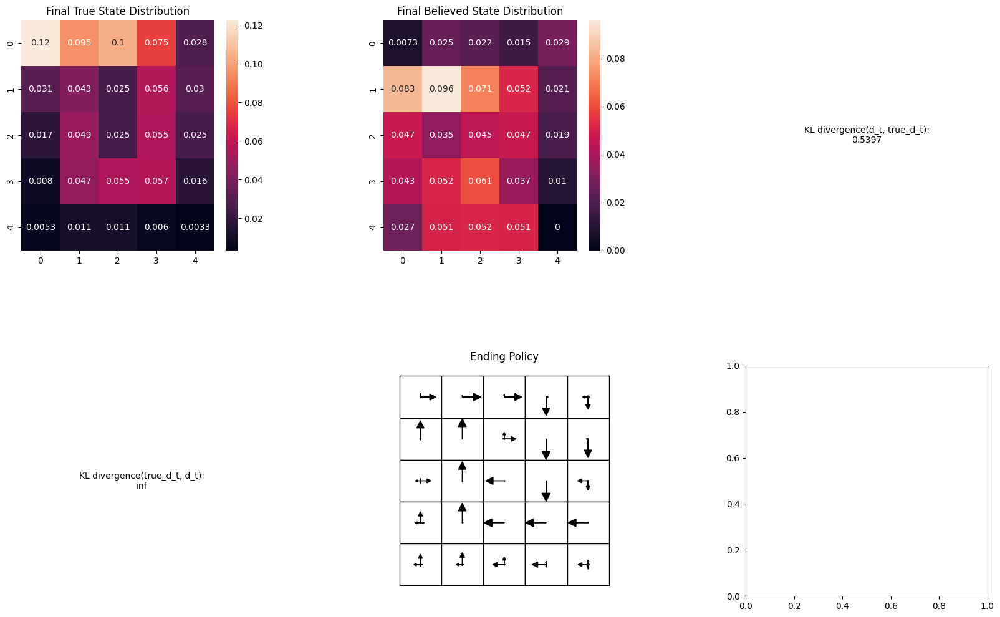

Run 0:  98%|████████████████████████████▍| 9807/10000 [1:07:27<01:18,  2.46it/s]

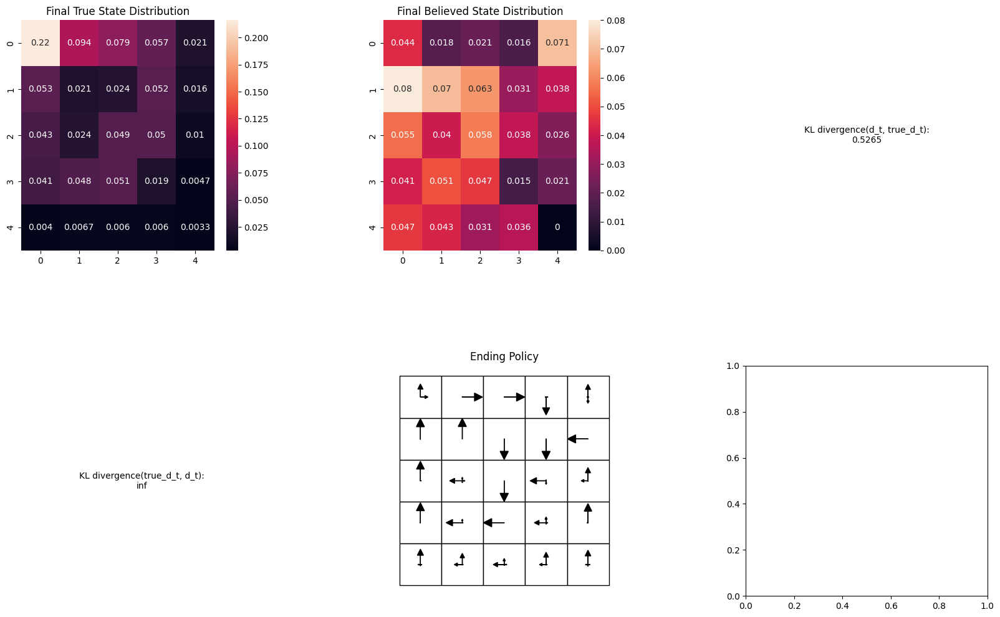

Run 0:  98%|████████████████████████████▌| 9832/10000 [1:07:37<01:15,  2.23it/s]

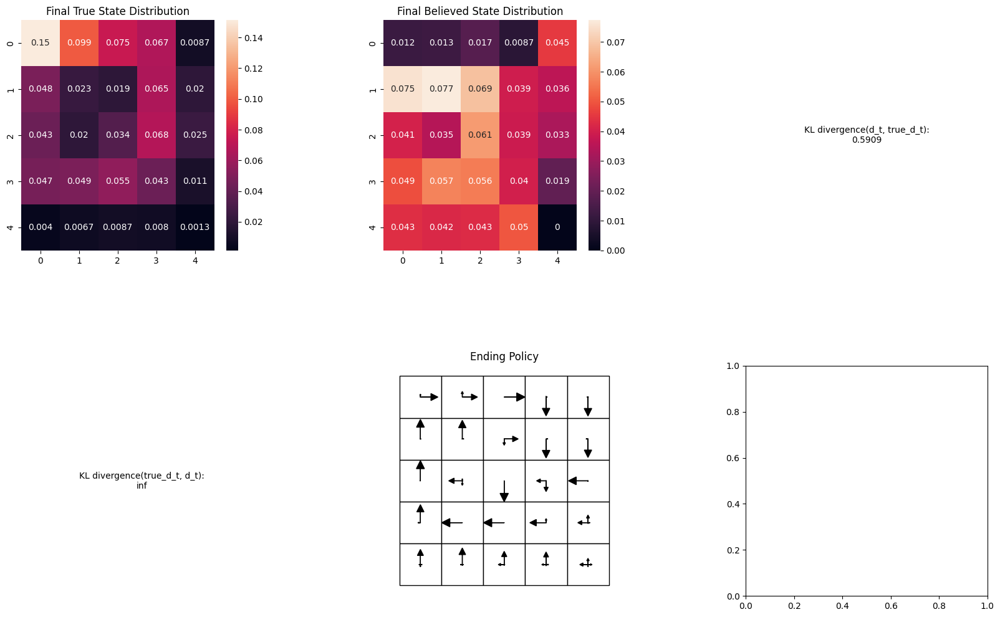

Run 0: 100%|████████████████████████████| 10000/10000 [1:08:42<00:00,  2.43it/s]


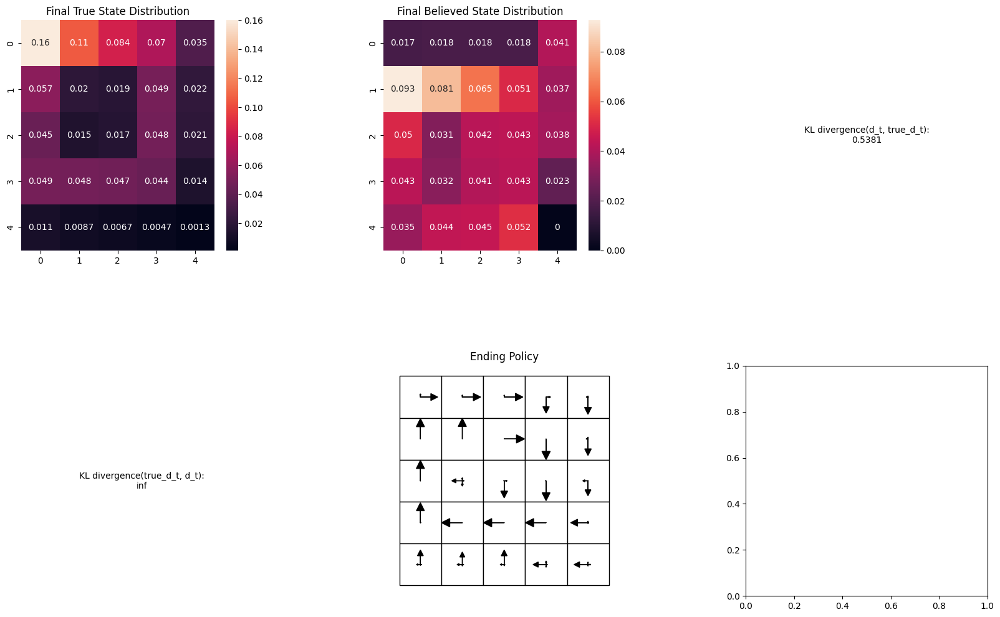

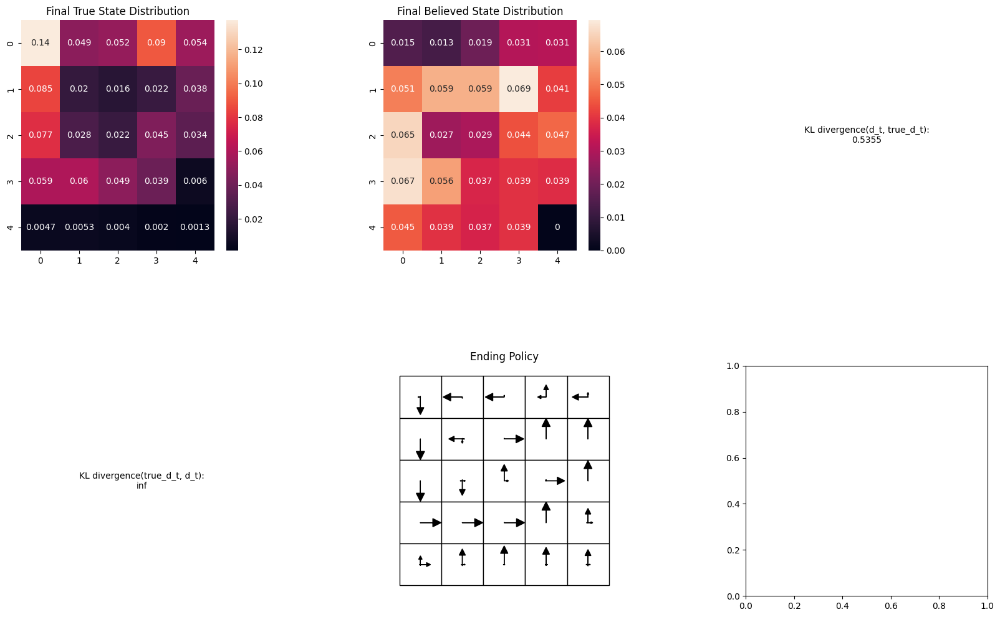

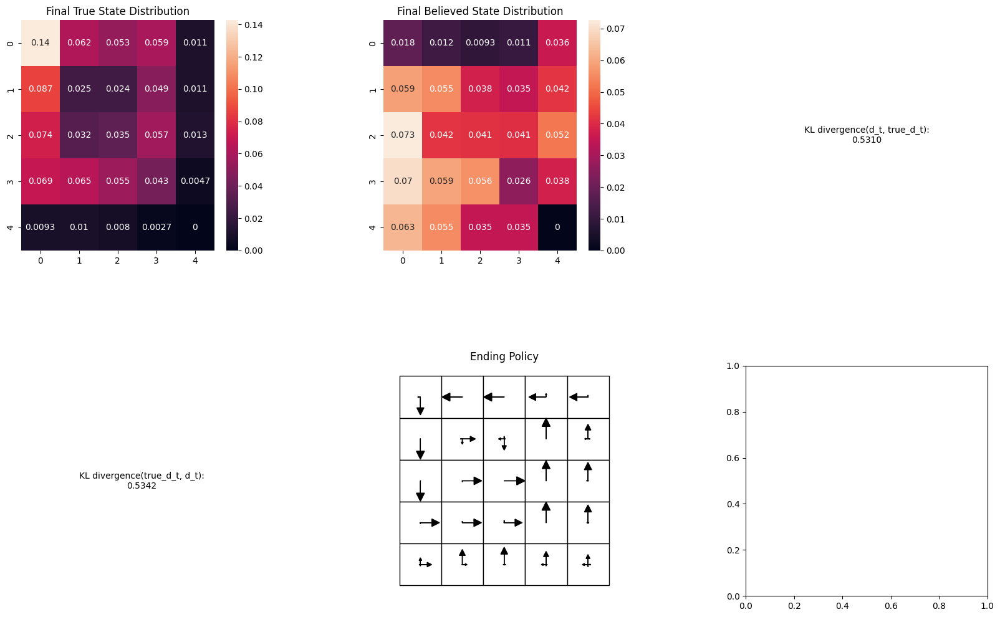

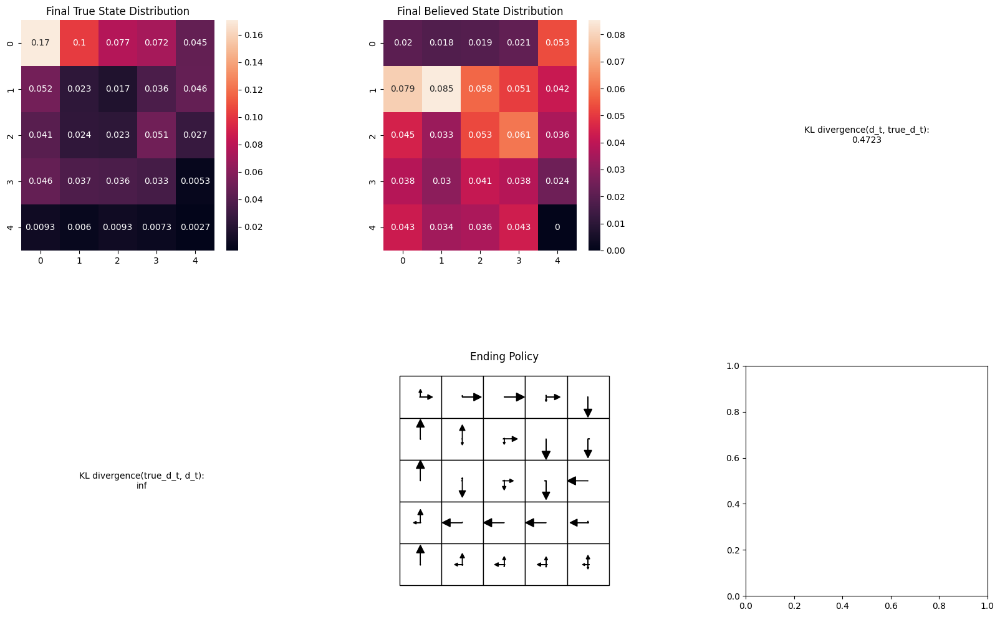

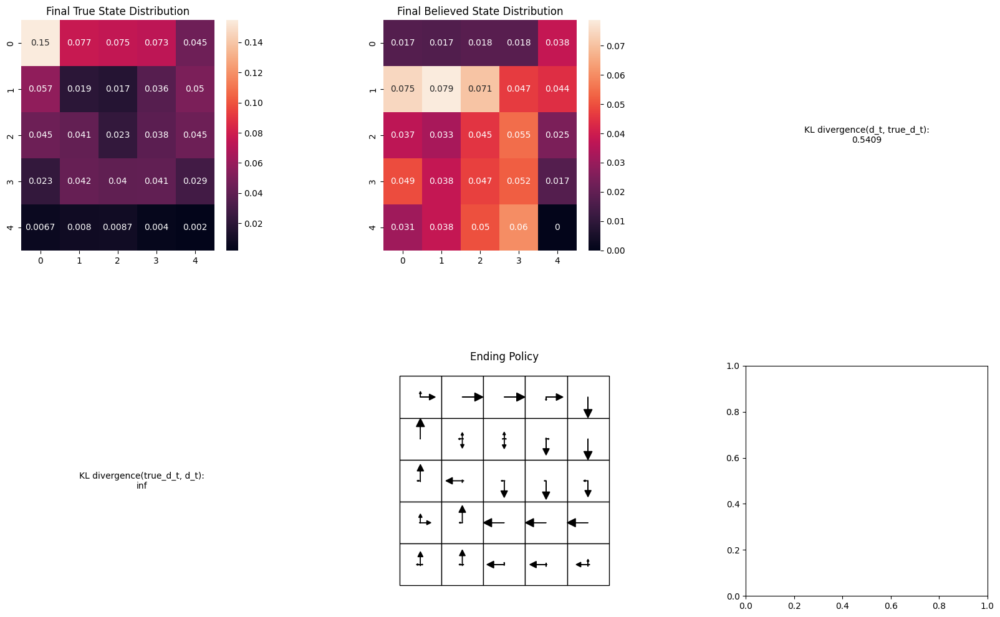

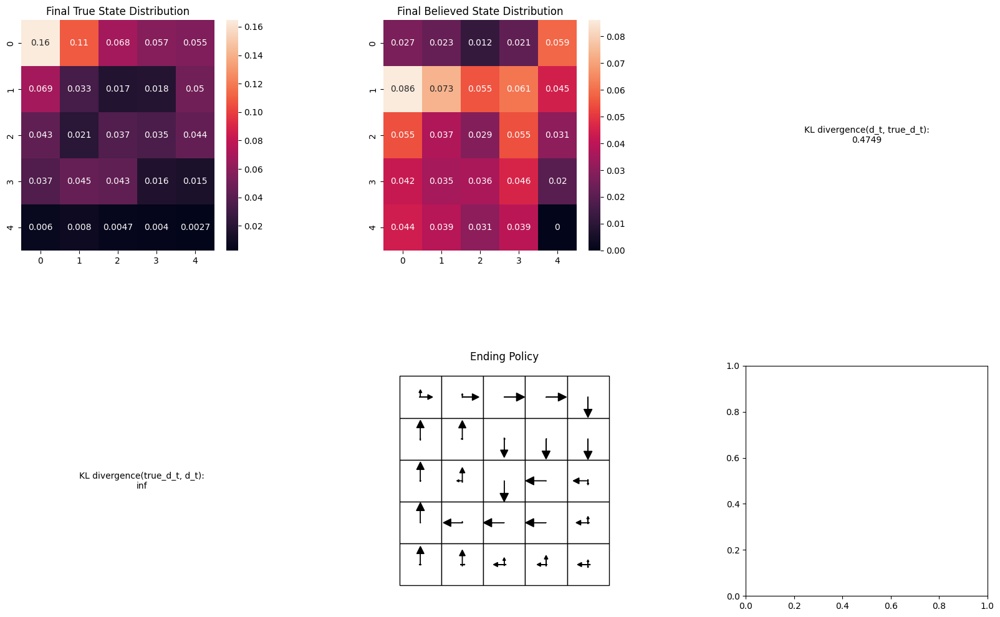

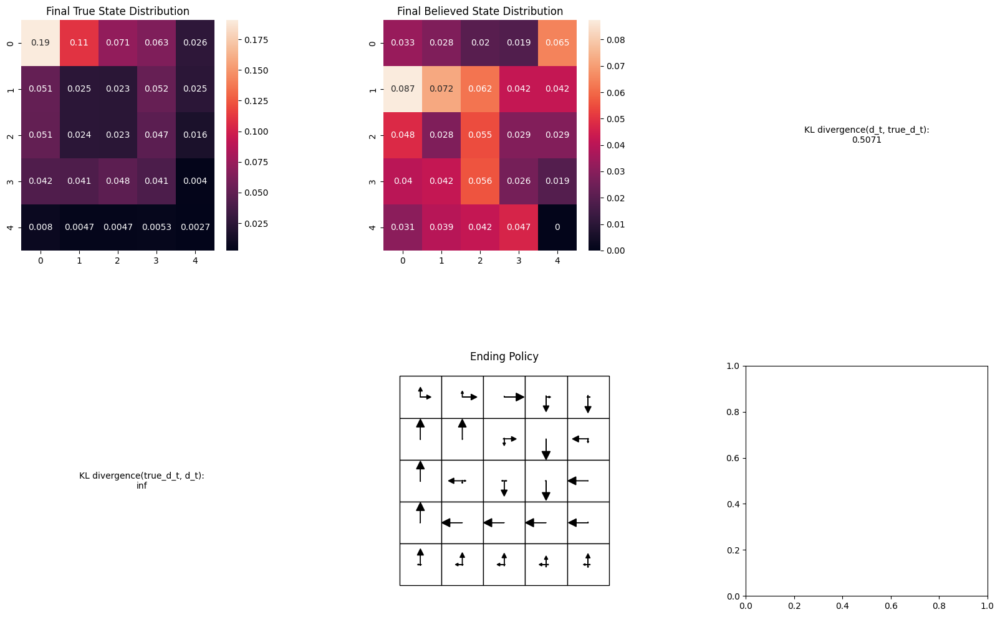

Stochastic Learned mean: 2.505616069343211


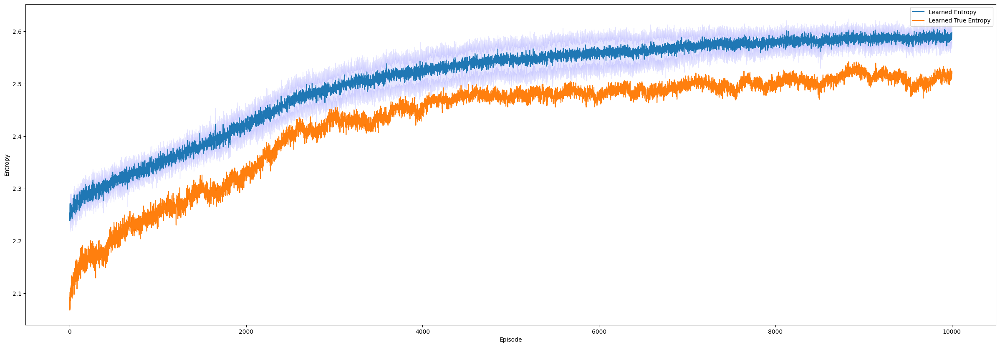

In [ ]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0.1
randomize=0
shift_amount=0.8
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP BiModal")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Stochastic Random BiModal**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0:  98%|███████████████████████████████▎| 5879/6000 [41:34<00:51,  2.35it/s]

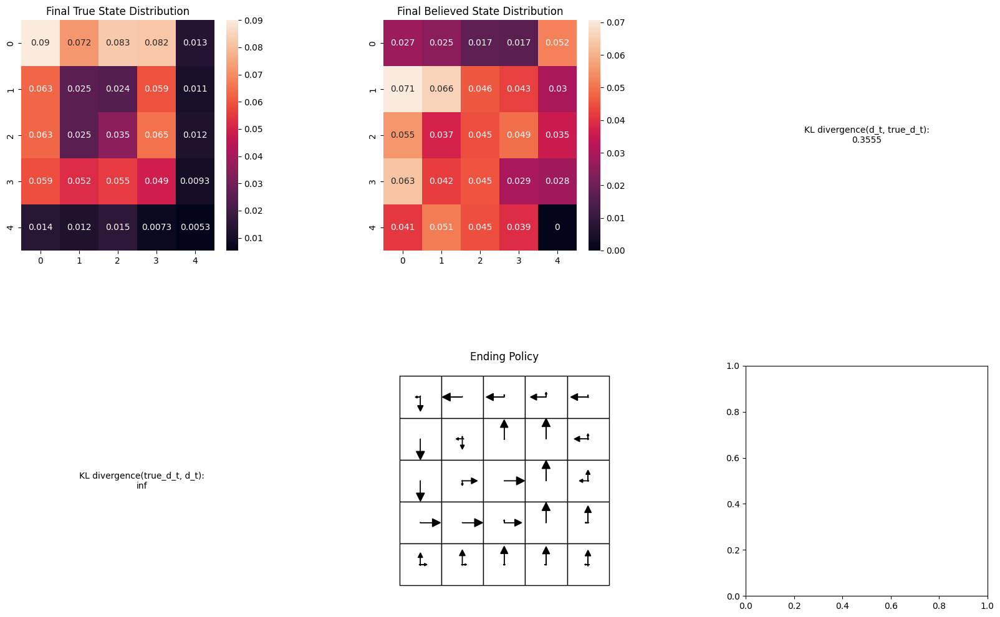

Run 0:  99%|███████████████████████████████▊| 5965/6000 [42:11<00:14,  2.41it/s]

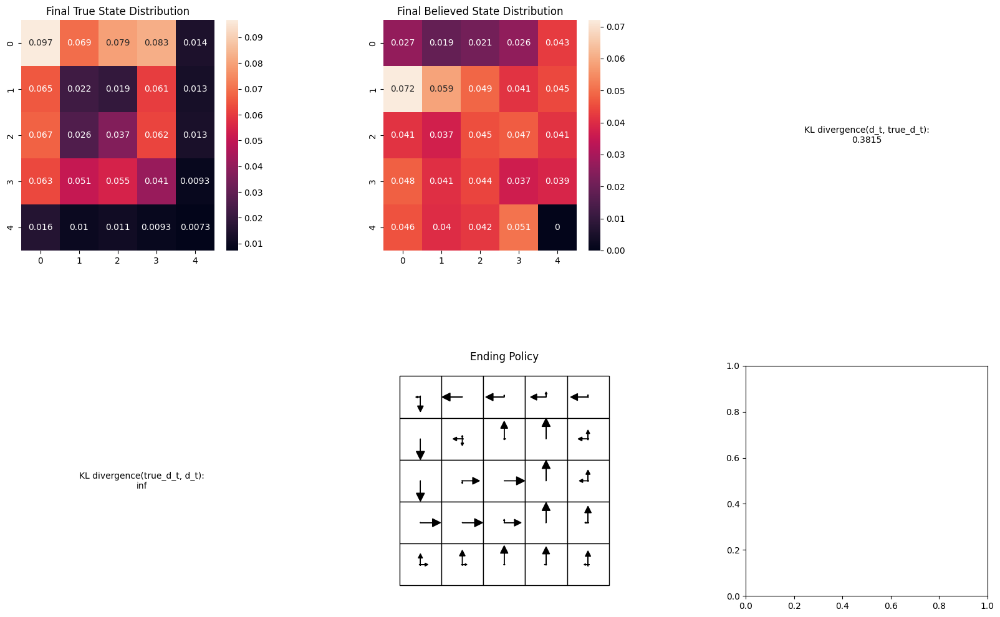

Run 0: 100%|███████████████████████████████▉| 5985/6000 [42:19<00:06,  2.46it/s]

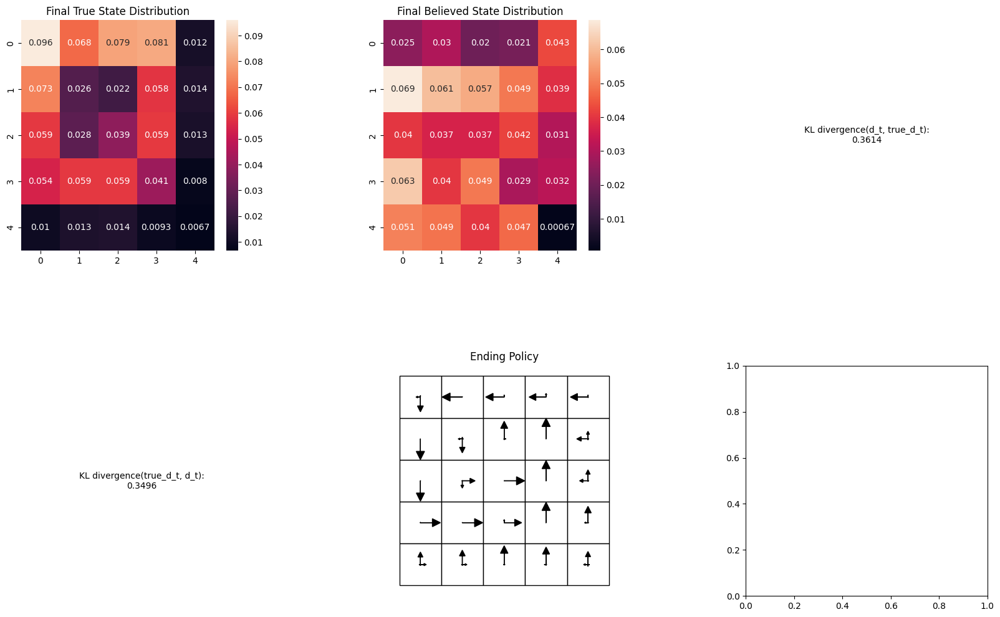

Run 0: 100%|███████████████████████████████▉| 5993/6000 [42:22<00:02,  2.49it/s]

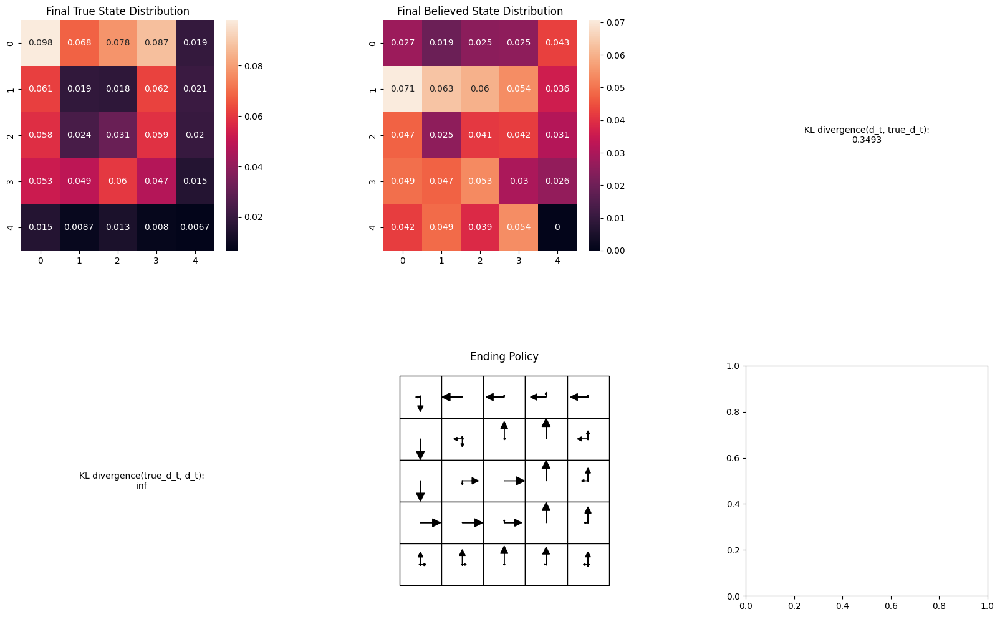

Run 0: 100%|████████████████████████████████| 6000/6000 [42:25<00:00,  2.36it/s]


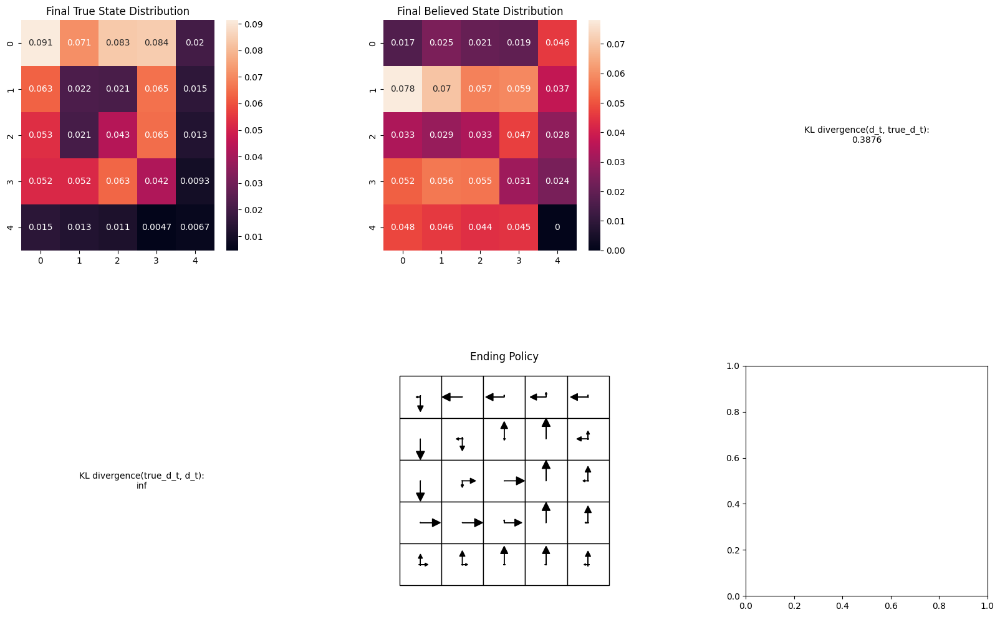

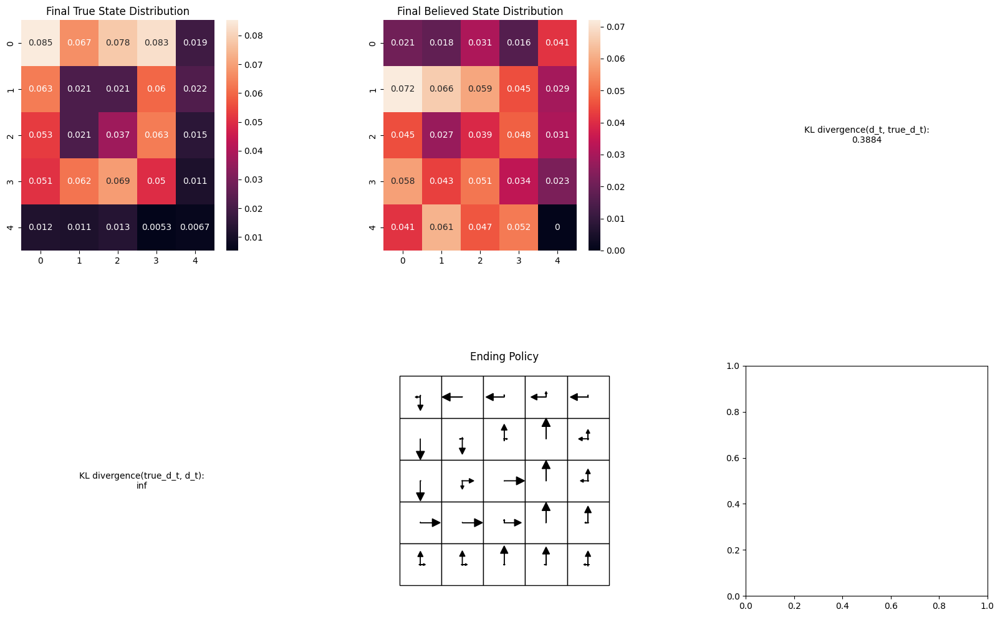

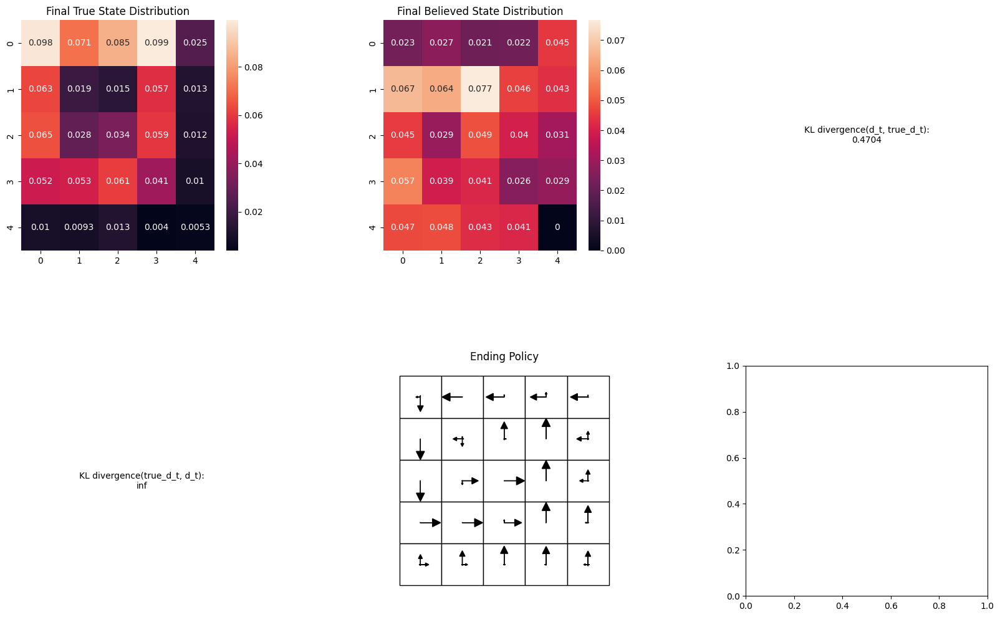

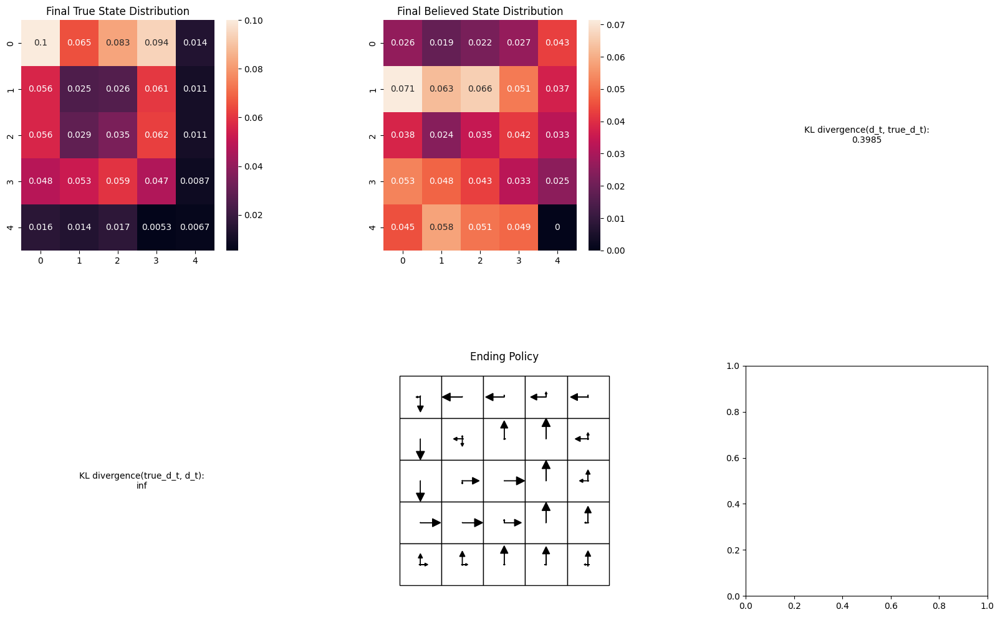

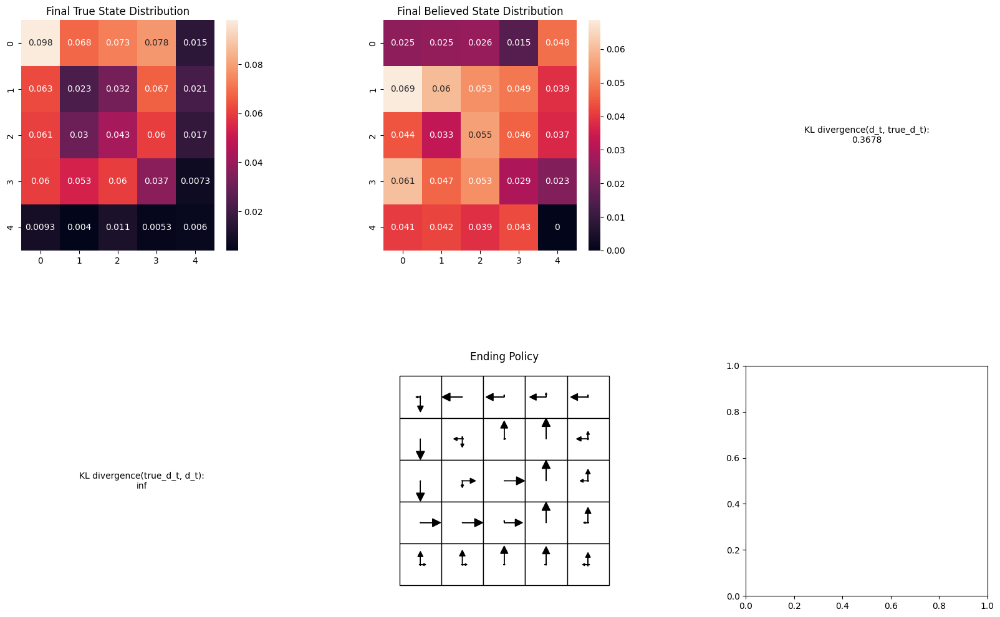

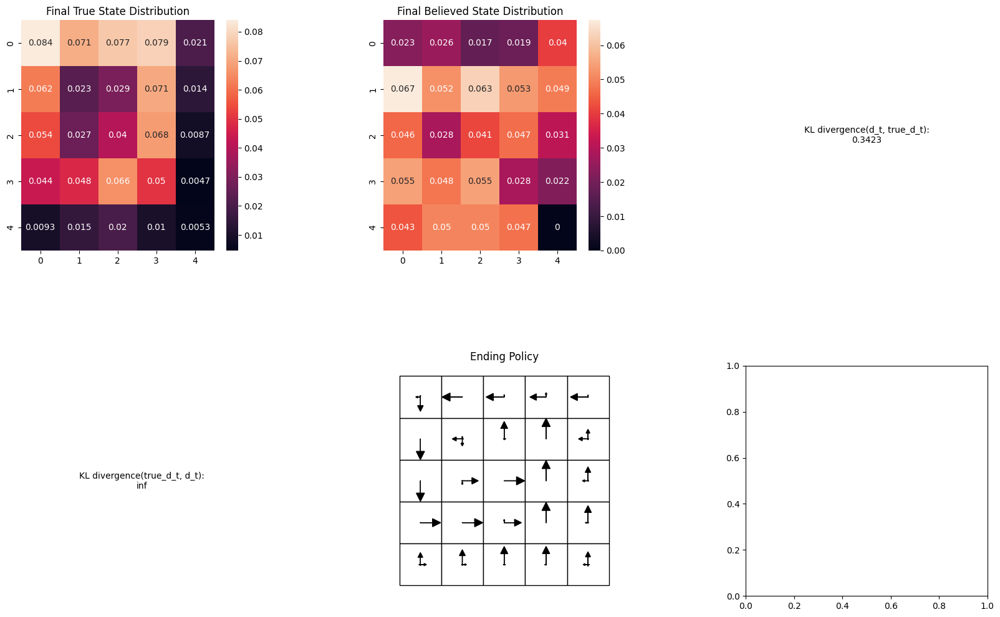

Believed Entropy mean: 2.6193191083675065
True Entropy mean: 2.5698041023504117


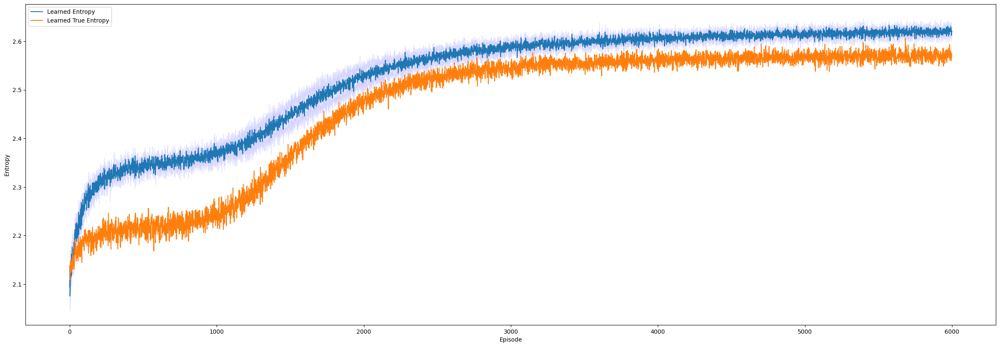

In [26]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0.1
randomize=1
shift_amount=0.8
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP BiModal Random Initial Position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Stochastic Hard BiModal**

Run 0:   0%|                                          | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

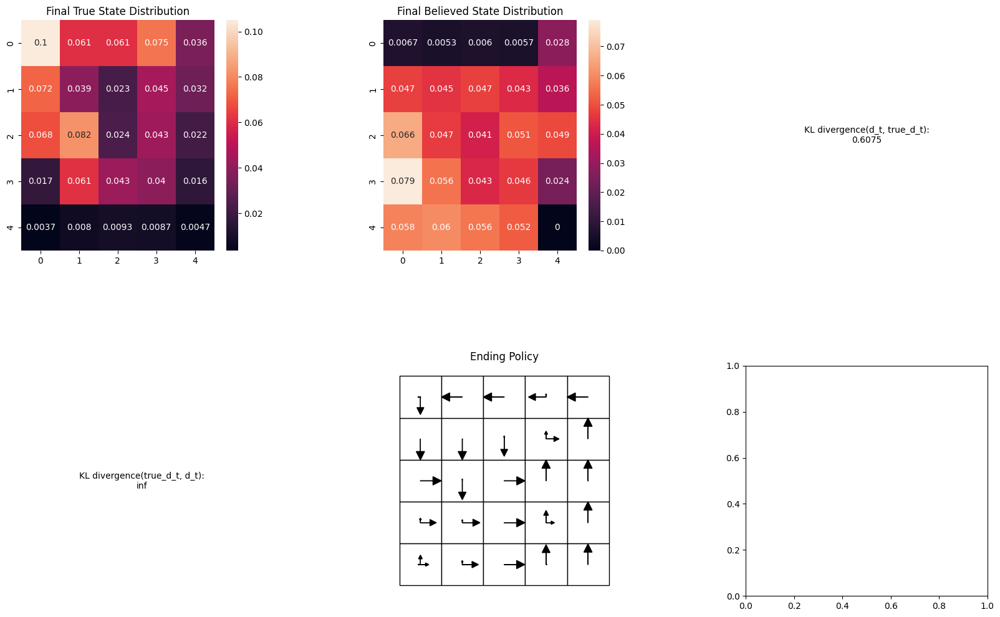

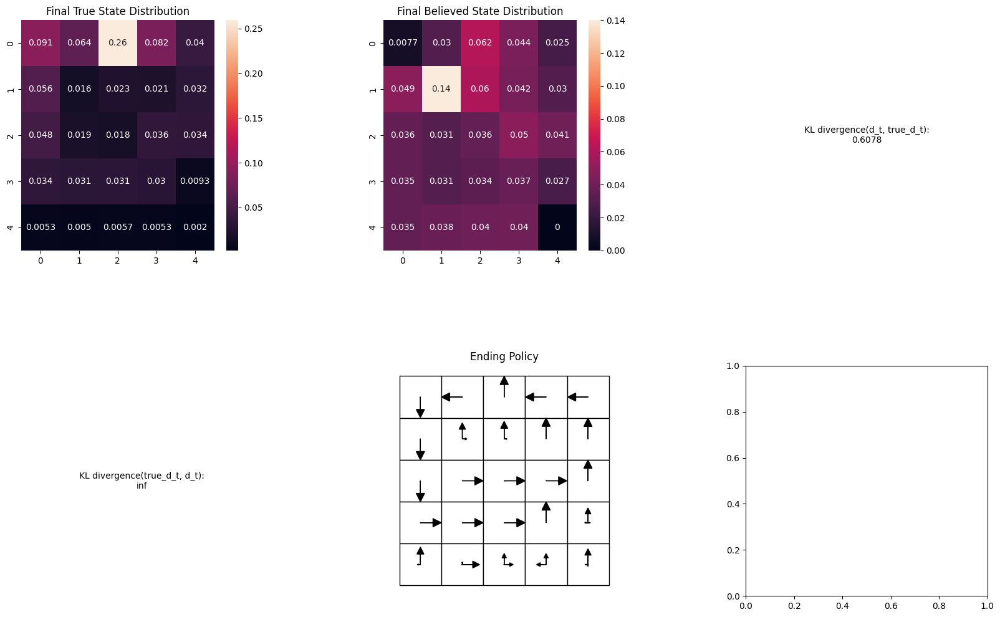

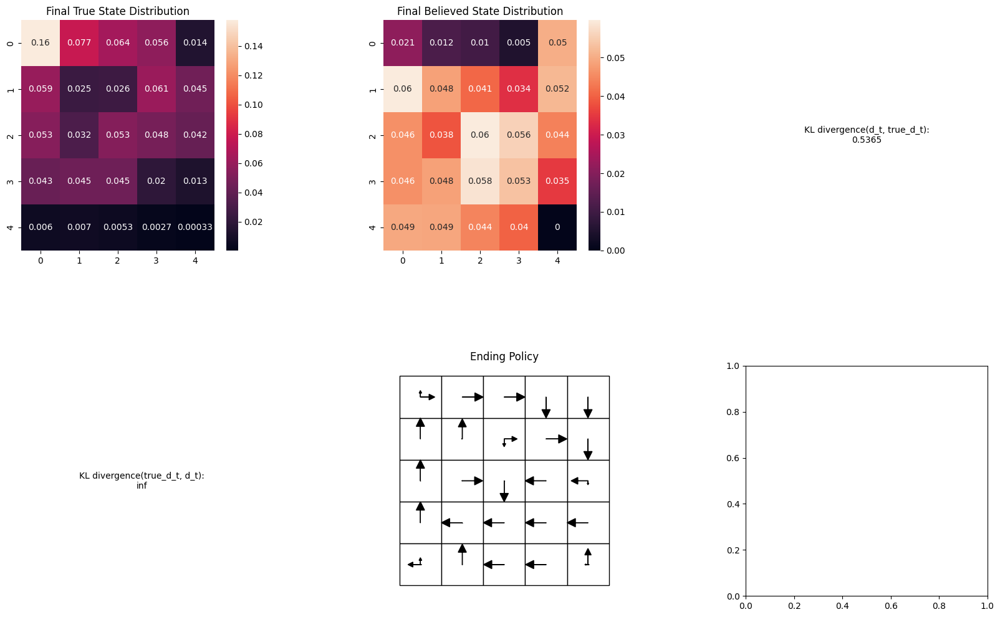

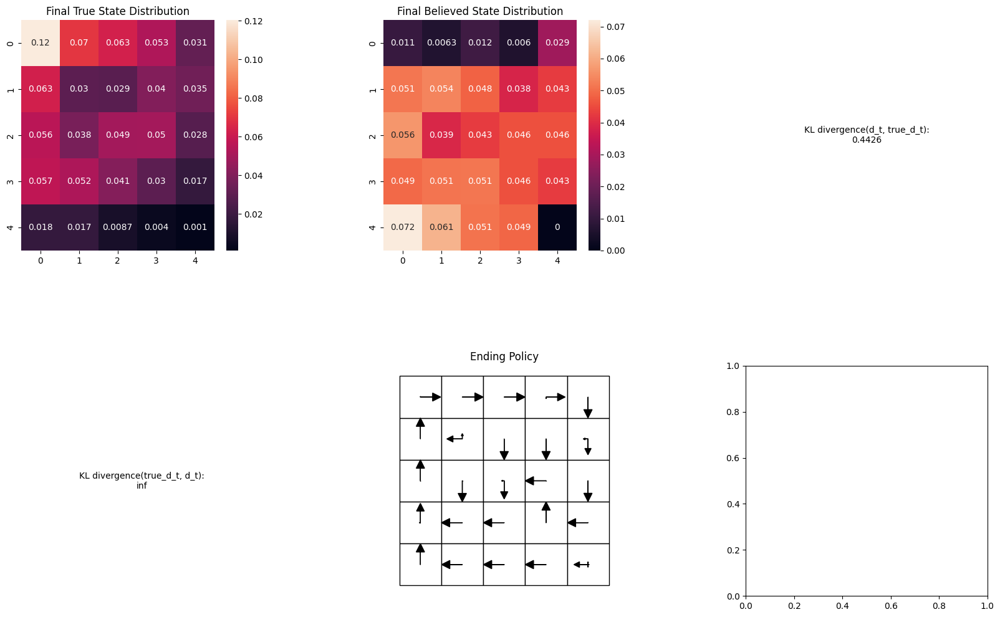

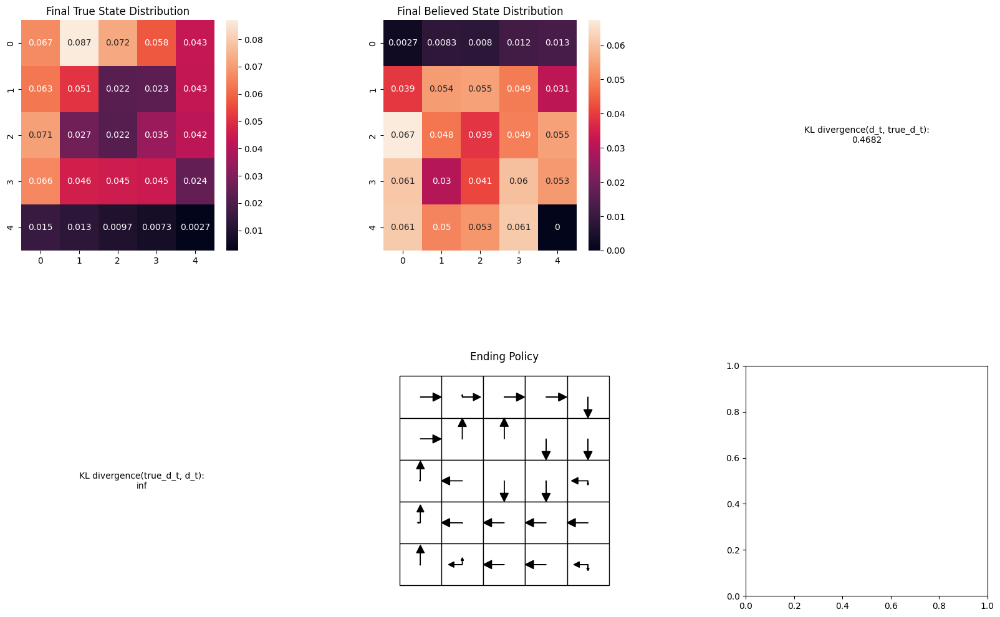

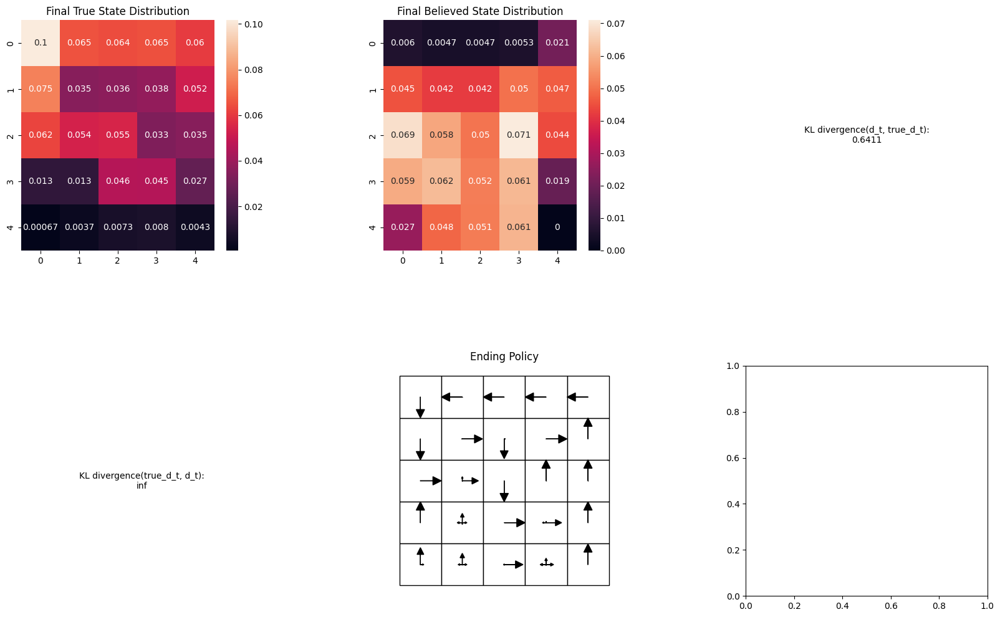

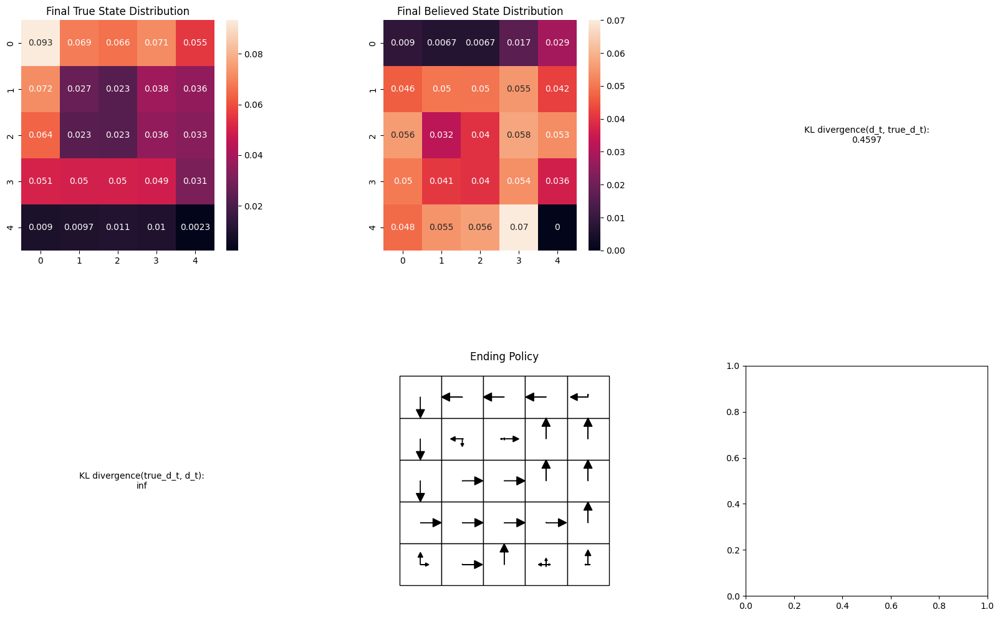

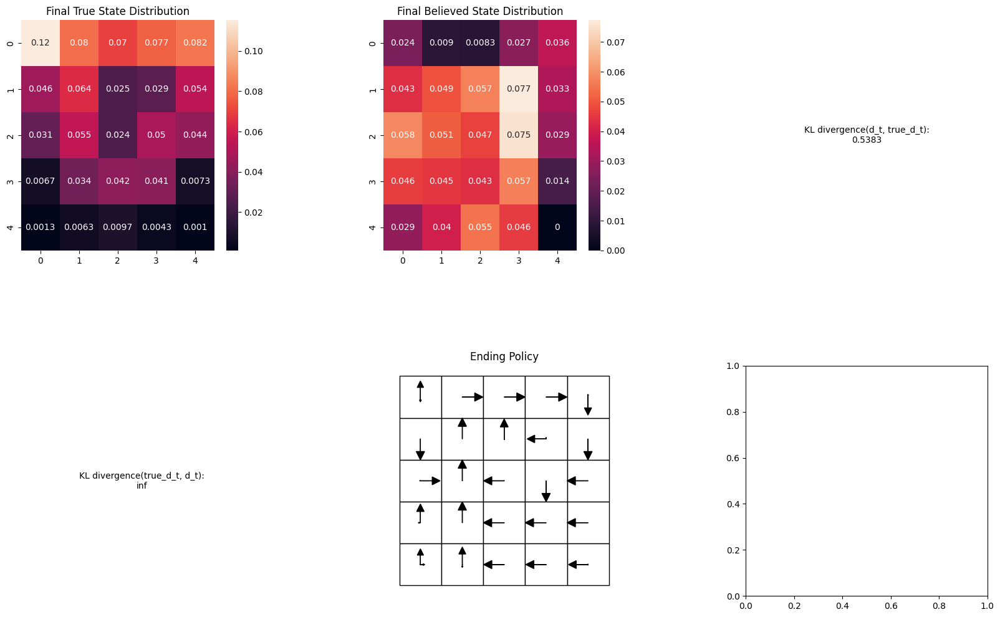

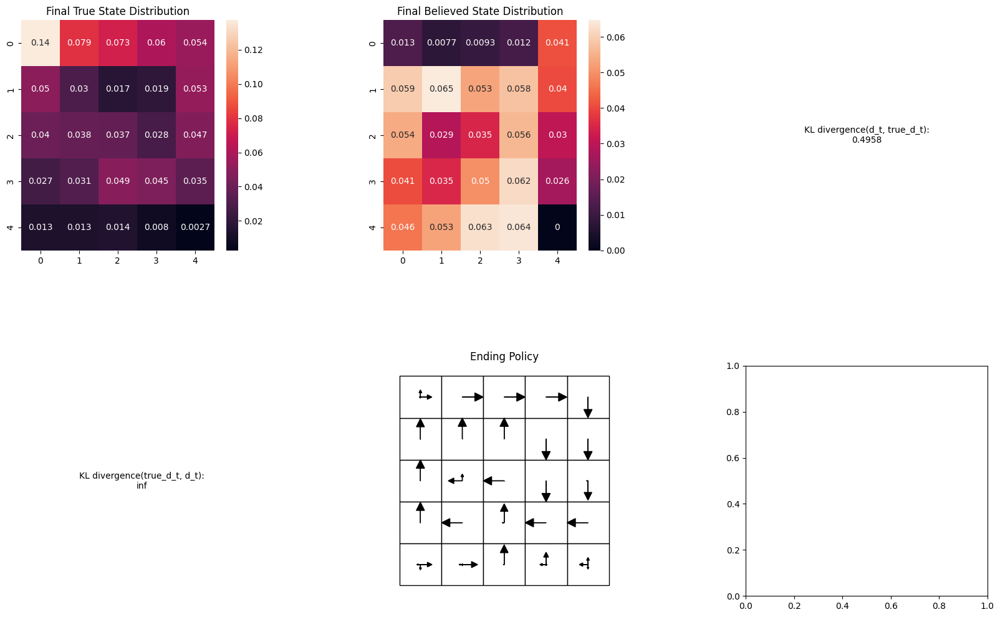

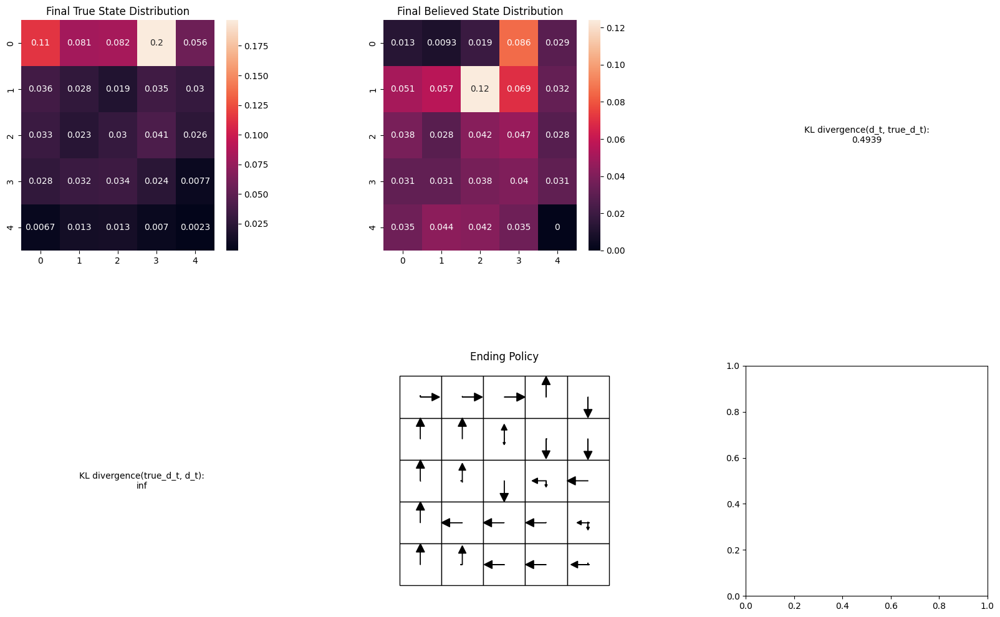

Stochastic Learned mean: 2.760273532962265


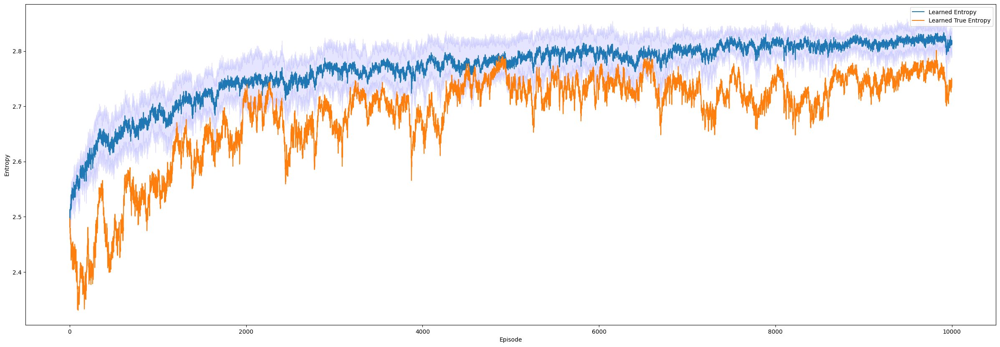

In [ ]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=2
uniform=0
prob=0.1
randomize=0
shift_amount=1
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP BiModal")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

# Asymmetric env

In [49]:
env = gym.make('GridworldPOMDPEnvAsymm-v0', steepness=20, shift_amount=0.5)

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/envs/registration.py:498: UserWarning: WARN: Overriding environment GridworldPOMDPEnvAsymm-v0 already in registry.
  logger.warn(f"Overriding environment {new_spec.id} already in registry.")


In [55]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount = args
    env = gym.make("GridworldPOMDPEnvAsymm-v0", time_horizon=time_horizon, steepness=steepness, prob=prob, randomize=randomize, shift_amount=shift_amount, uniform=uniform)  # Create a new environment for each run
    agent = agents.REINFORCEAgentEPOMDP(env, alpha=alpha)
    avg_entropies = []
    avg_true_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for ep in range(n_episodes):
                if ep == n_episodes/2:
                    agent.alpha *= 2
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
                pbar.update(1)
    else:
        for ep in range(n_episodes):
                if ep == n_episodes/2:
                    agent.alpha *= 2
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes, baseline_coeff)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies, avg_true_entropies

0.9999999999999998
0.25058643075225645


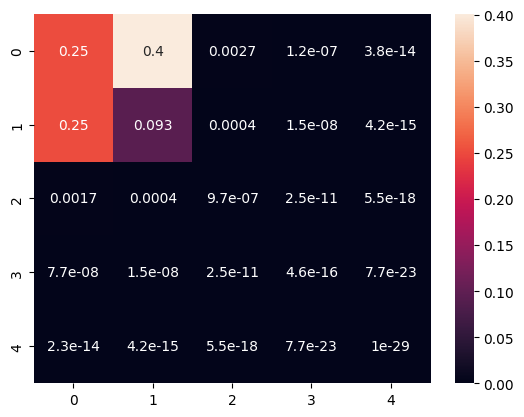

In [50]:
# Test observation matrix
sns.heatmap(np.reshape(env.observation_matrix[0], (env.grid_size, env.grid_size)), annot=True)
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

**Deterministic Asymmetric**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0:  97%|███████████████████████████████ | 5821/6000 [41:47<01:20,  2.21it/s]

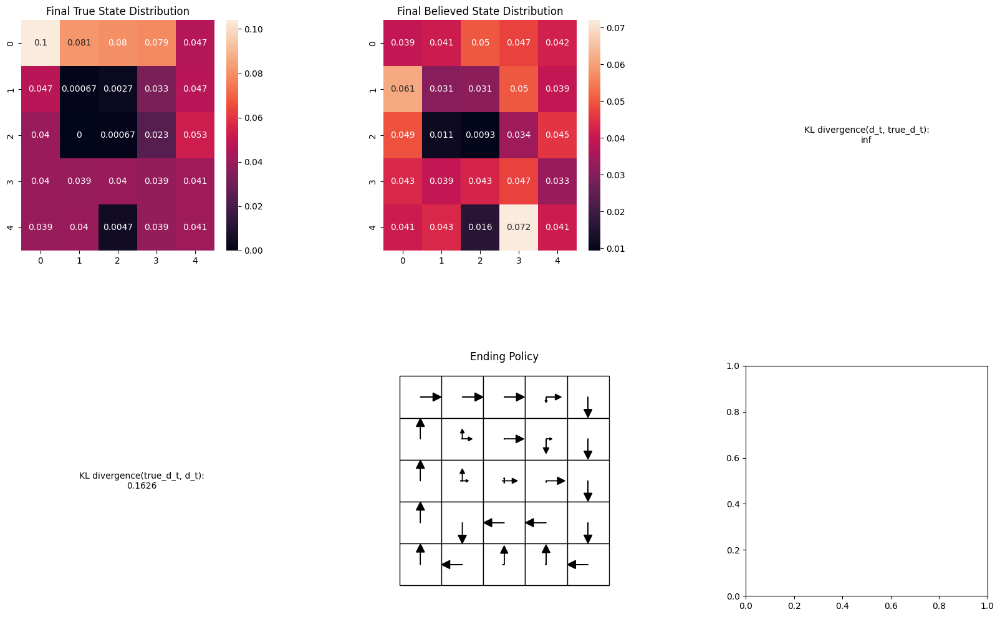

Run 0:  98%|███████████████████████████████▎| 5860/6000 [42:04<00:56,  2.47it/s]

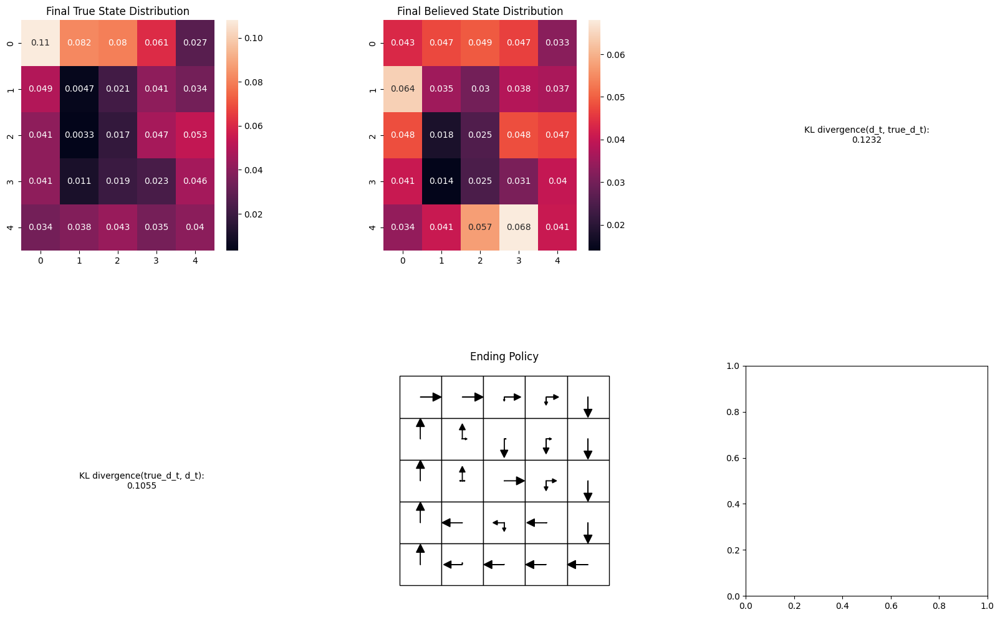

Run 0:  98%|███████████████████████████████▎| 5878/6000 [42:12<00:54,  2.23it/s]

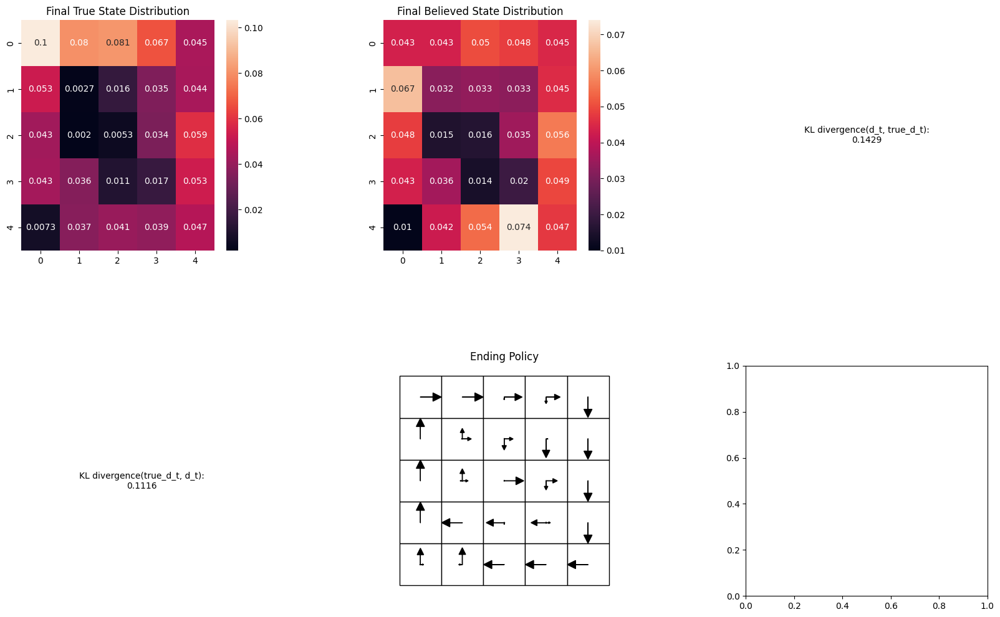

Run 0:  99%|███████████████████████████████▌| 5915/6000 [42:27<00:33,  2.54it/s]

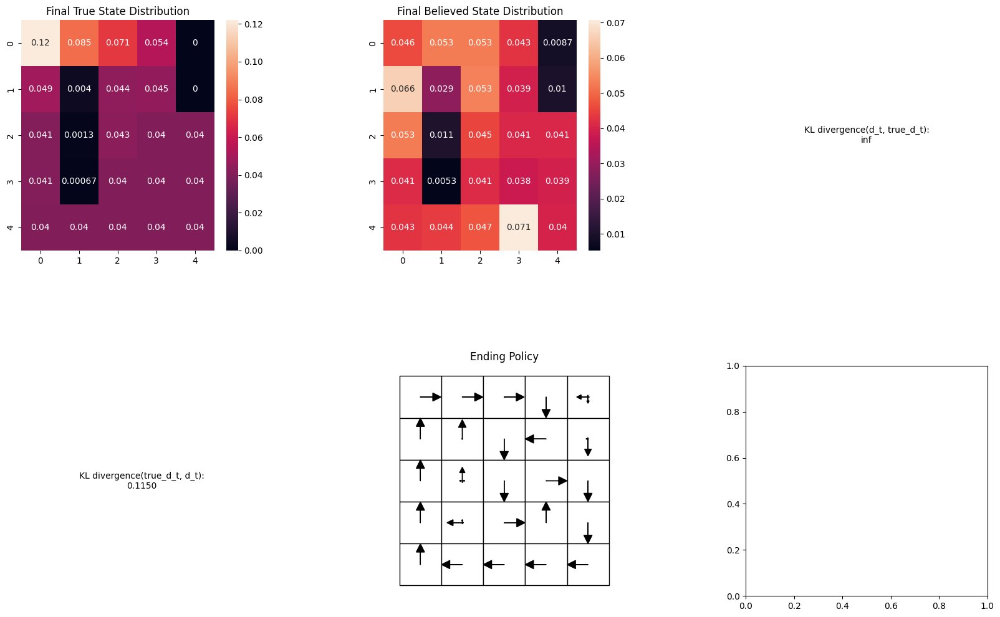

Run 0:  99%|███████████████████████████████▌| 5924/6000 [42:31<00:35,  2.11it/s]

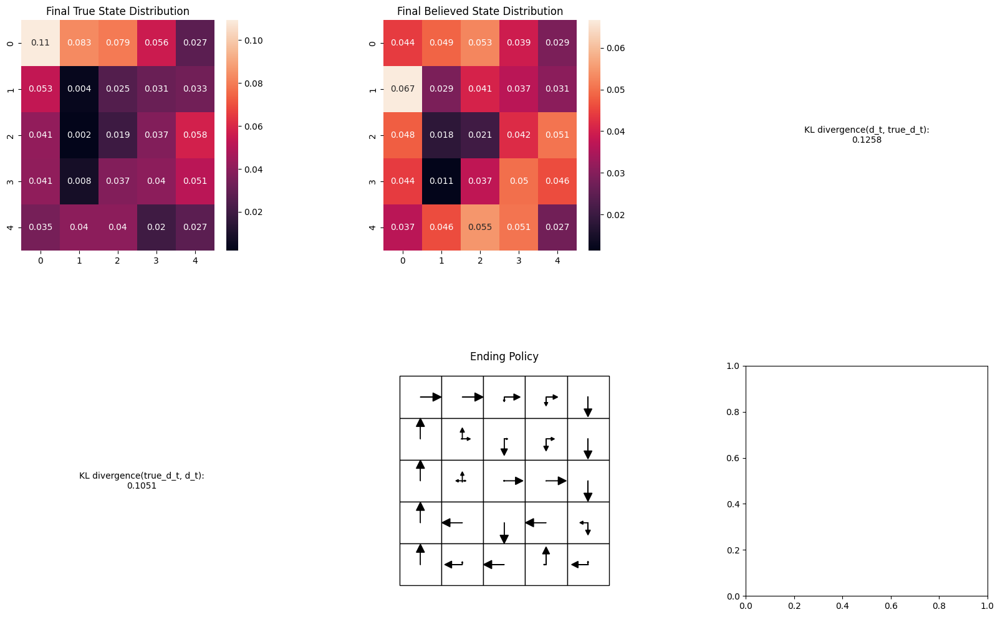

Run 0:  99%|███████████████████████████████▋| 5930/6000 [42:34<00:32,  2.13it/s]

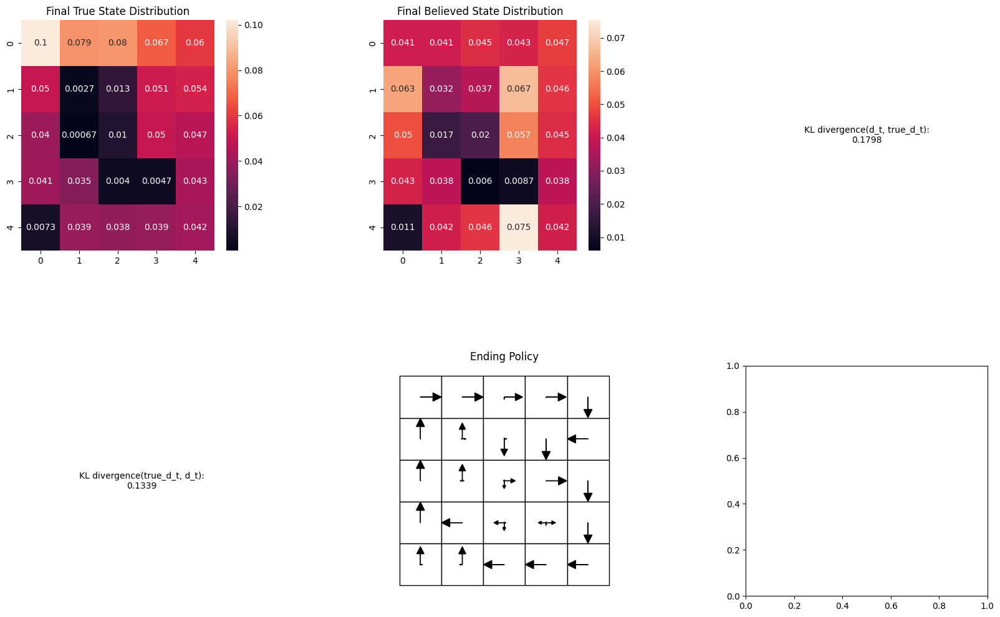

Run 0:  99%|███████████████████████████████▋| 5931/6000 [42:34<00:31,  2.18it/s]

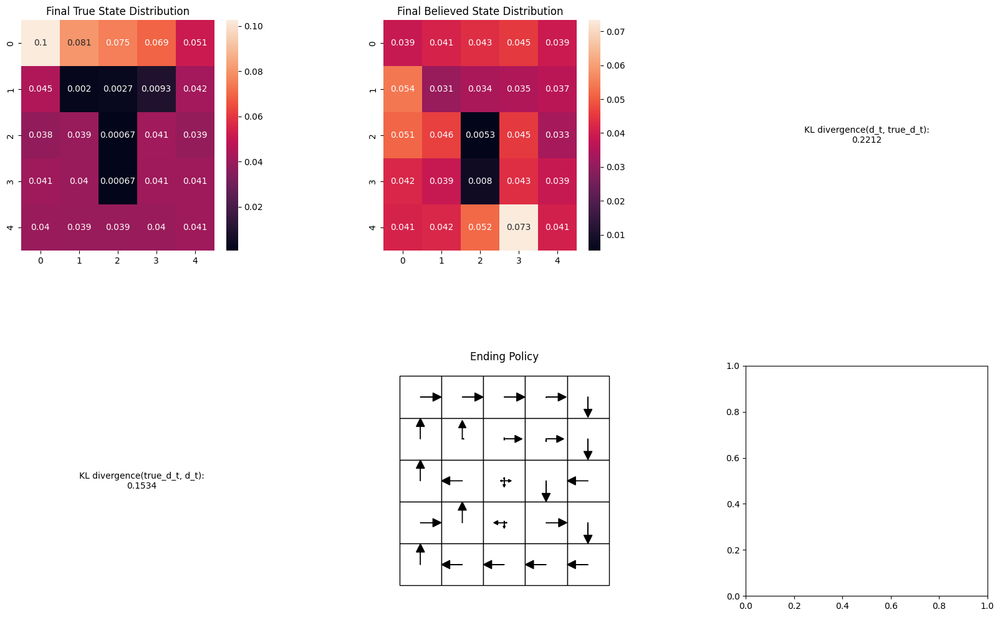

Run 0: 100%|███████████████████████████████▊| 5973/6000 [42:51<00:11,  2.45it/s]

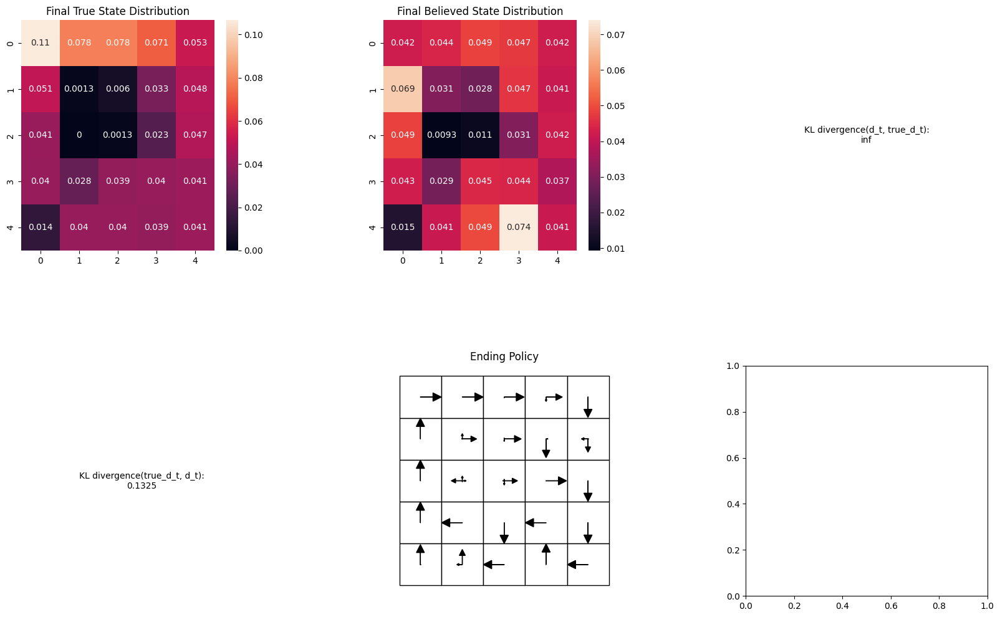

Run 0: 100%|████████████████████████████████| 6000/6000 [43:02<00:00,  2.32it/s]


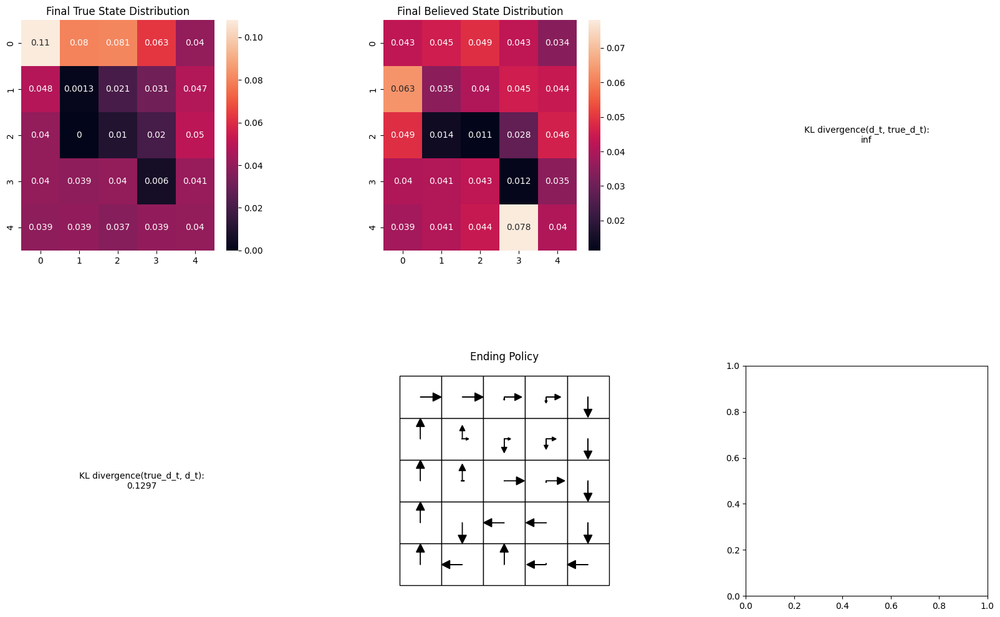

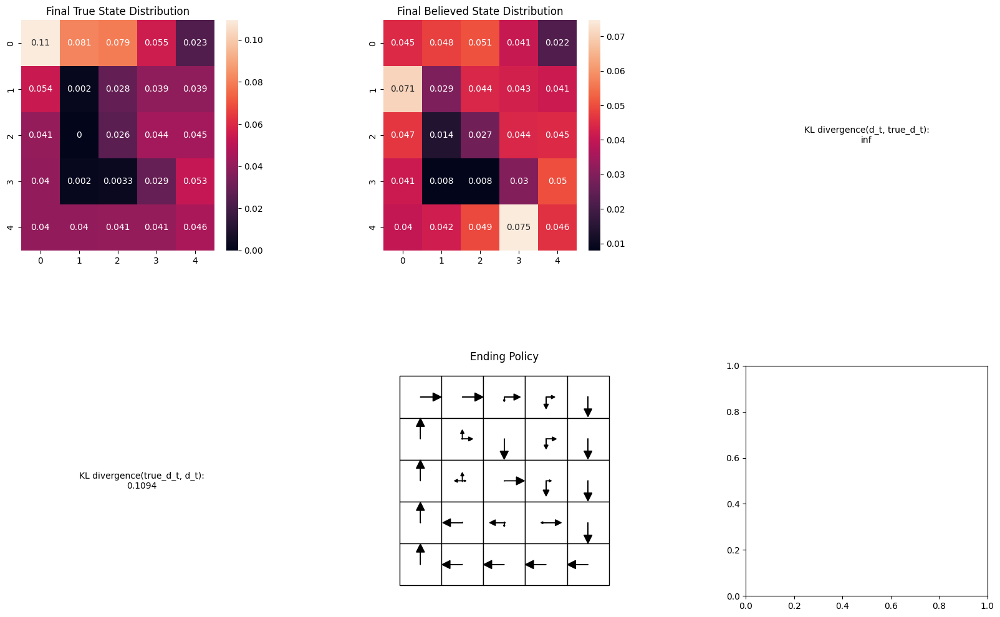

Believed Entropy mean: 2.925975962747468
True Entropy mean: 2.8520480779630133


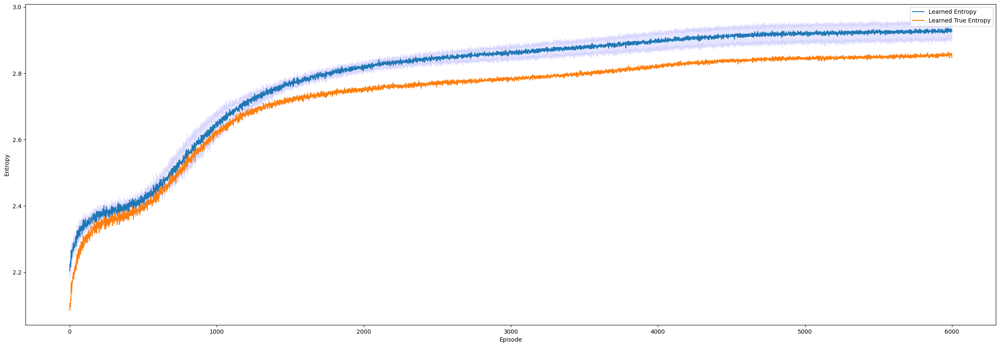

In [58]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0
randomize=0
shift_amount=0.5
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP Asymm")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Deterministic Asymmetric with Random Initial Position**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

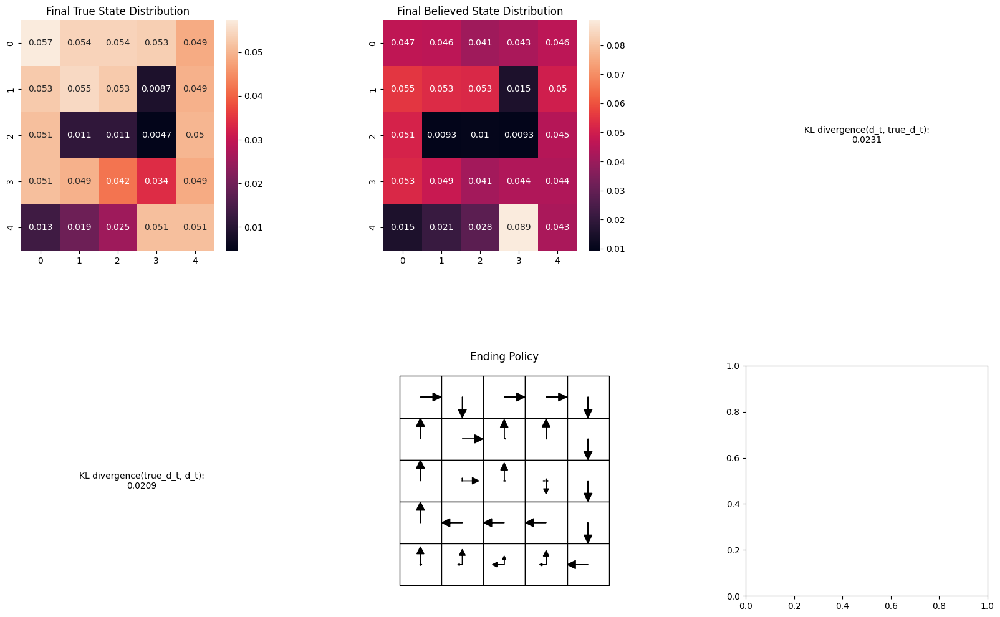

Run 0:  98%|███████████████████████████████▎| 5870/6000 [42:17<00:53,  2.43it/s]

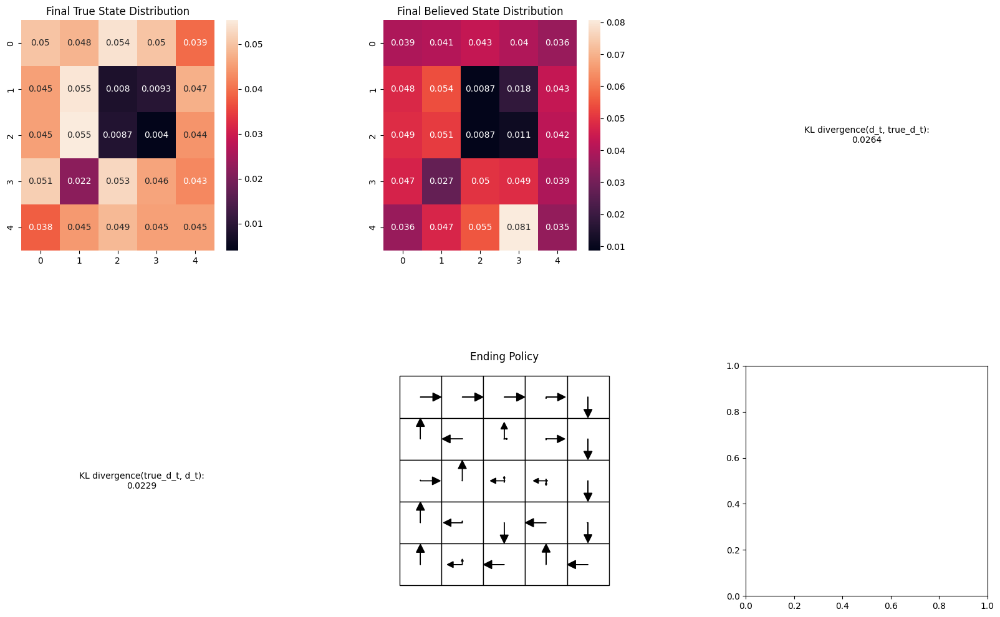

Run 0:  98%|███████████████████████████████▍| 5897/6000 [42:28<00:43,  2.37it/s]

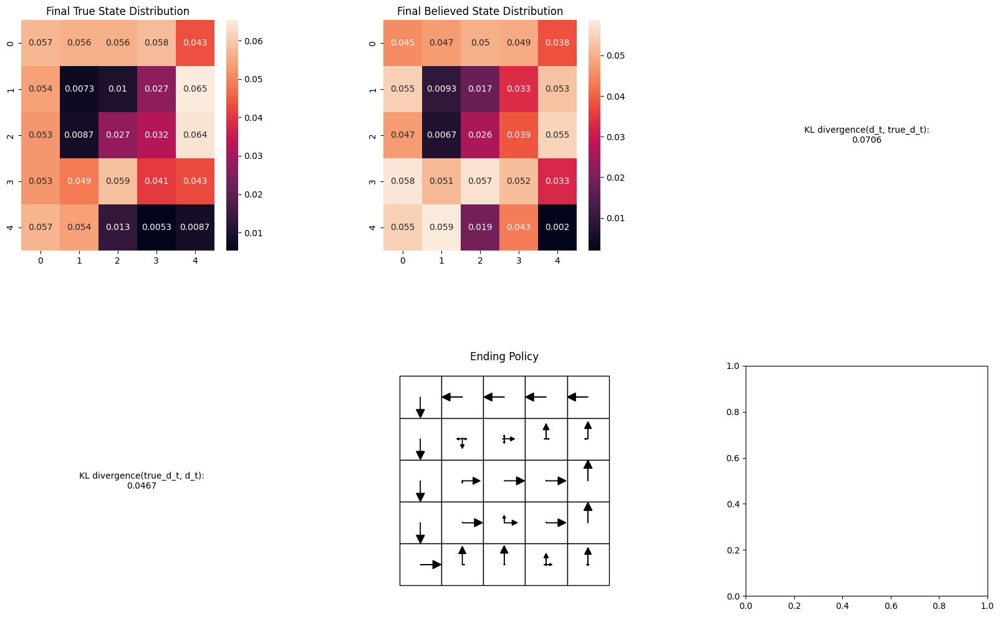

Run 0:  99%|███████████████████████████████▌| 5915/6000 [42:36<00:35,  2.40it/s]

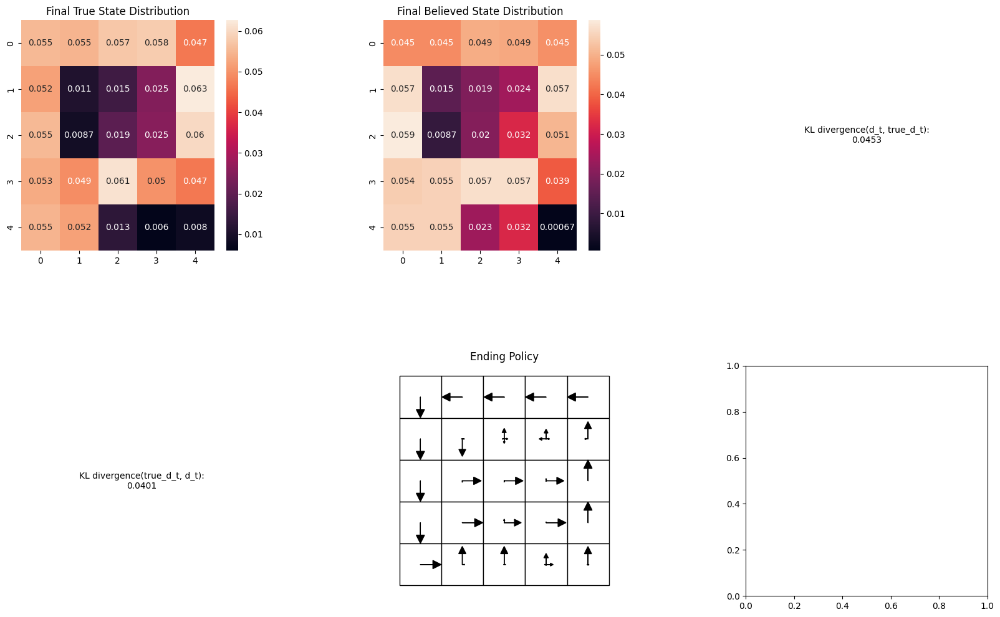

Run 0:  99%|███████████████████████████████▋| 5935/6000 [42:45<00:30,  2.12it/s]

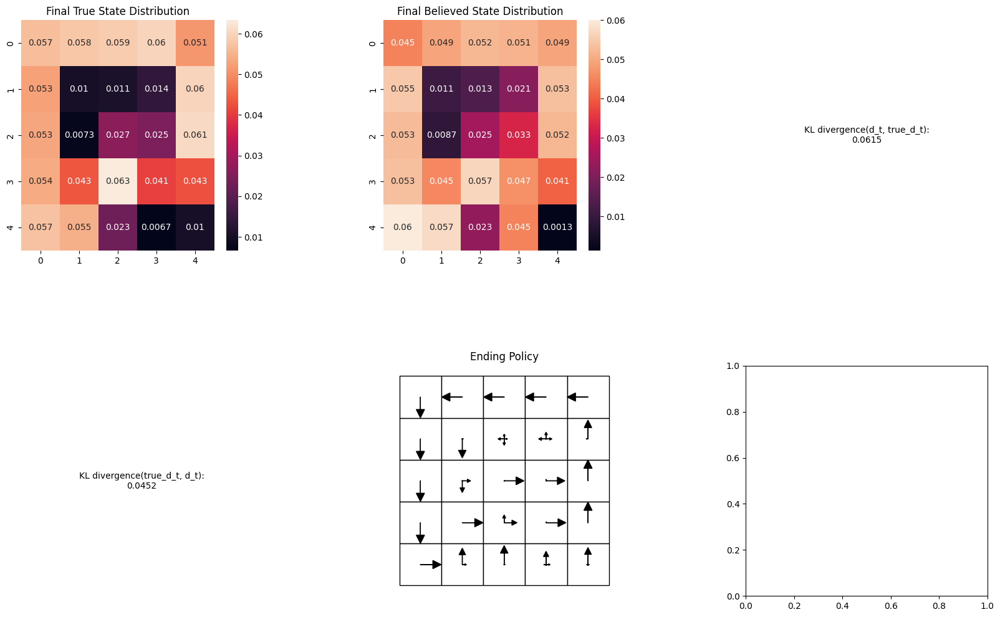

Run 0: 100%|███████████████████████████████▉| 5977/6000 [43:04<00:10,  2.23it/s]

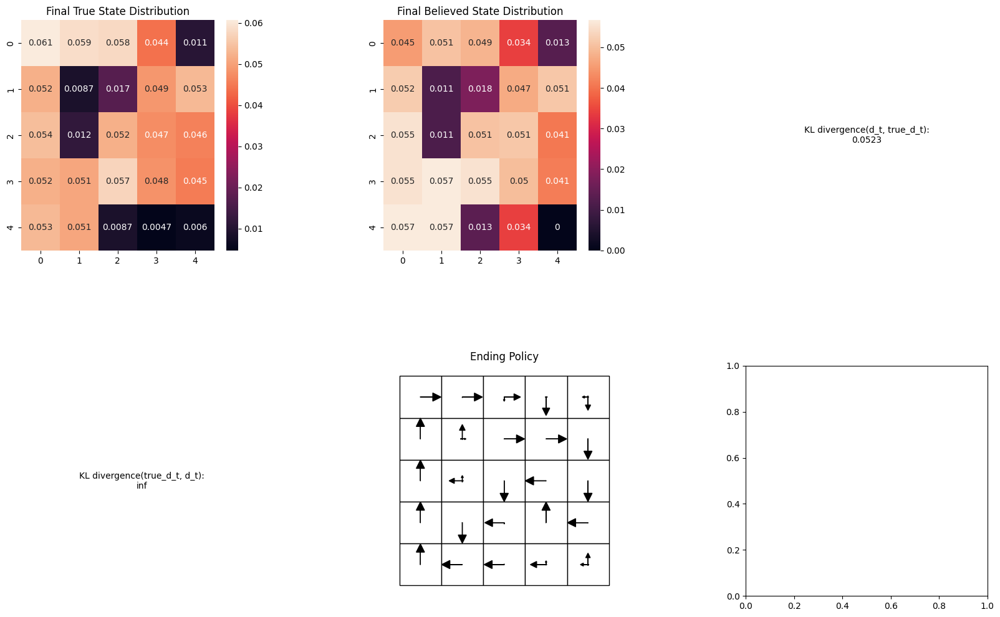

Run 0: 100%|███████████████████████████████▉| 5985/6000 [43:07<00:06,  2.37it/s]

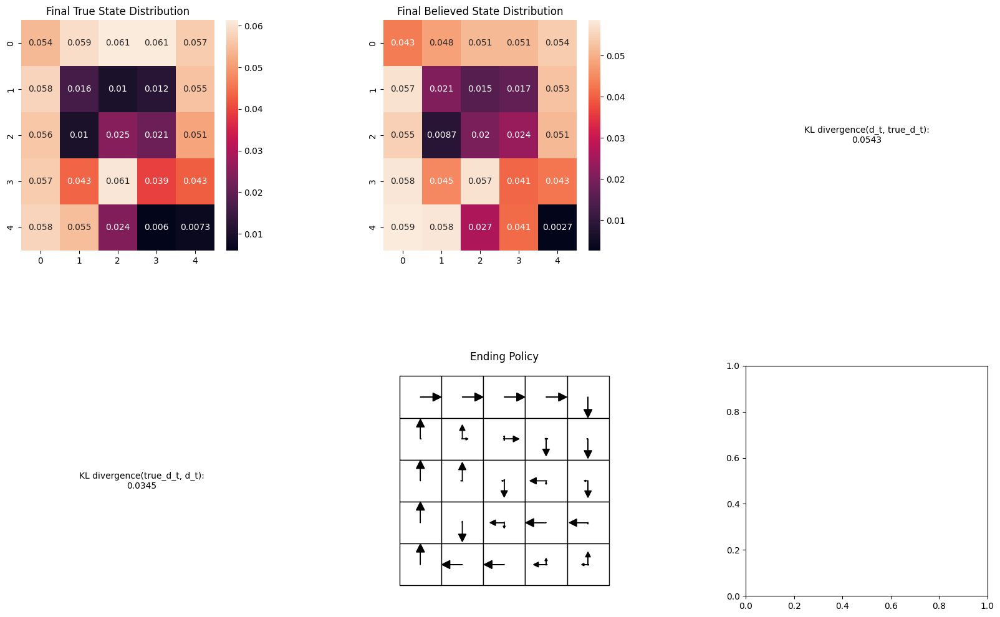

Run 0: 100%|███████████████████████████████▉| 5993/6000 [43:11<00:02,  2.45it/s]

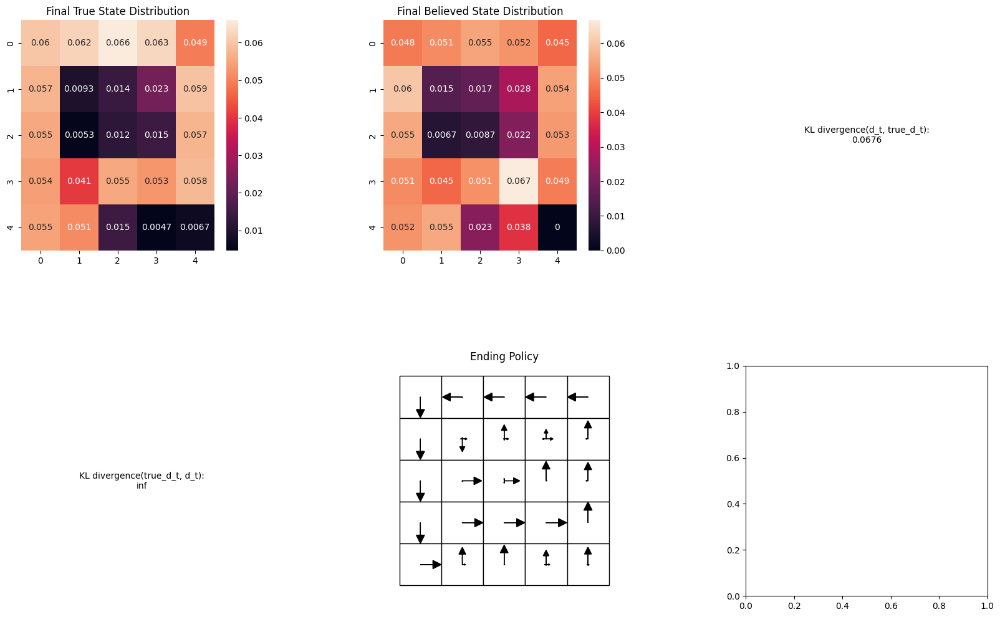

Run 0: 100%|████████████████████████████████| 6000/6000 [43:13<00:00,  2.31it/s]


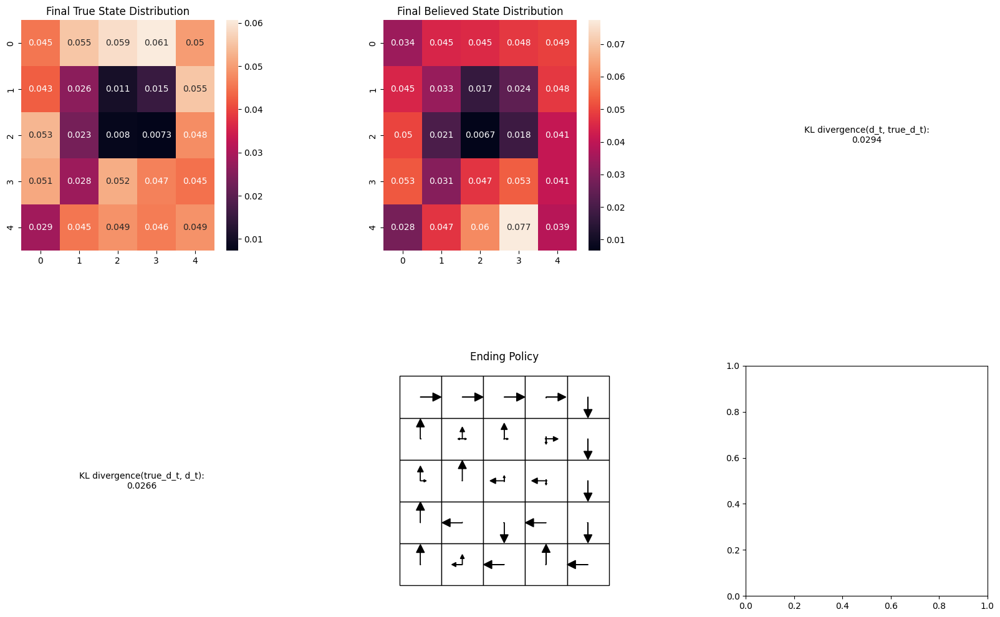

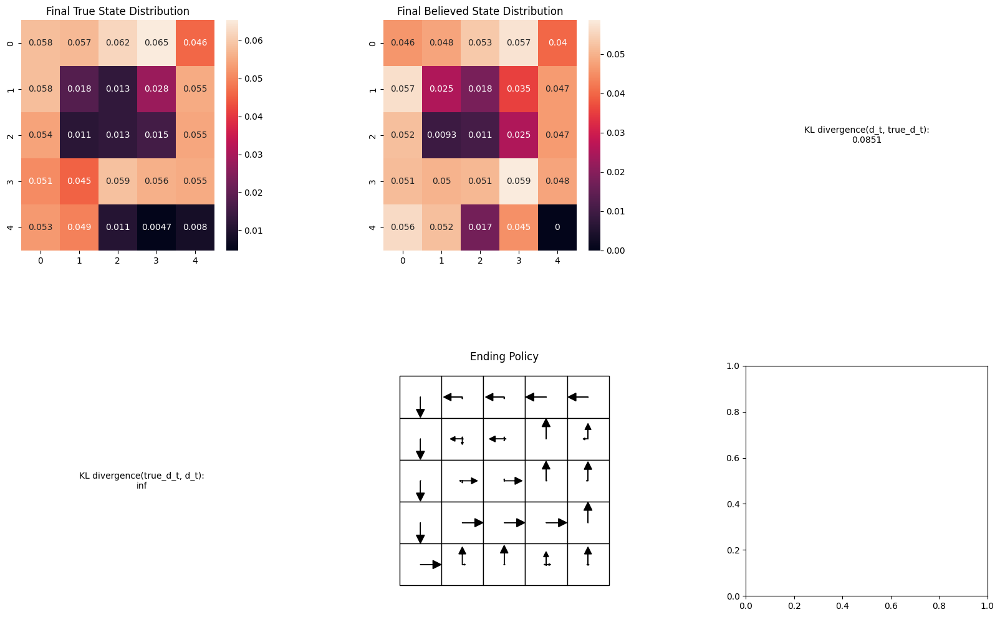

Believed Entropy mean: 2.87036147528738
True Entropy mean: 2.8402179044000495


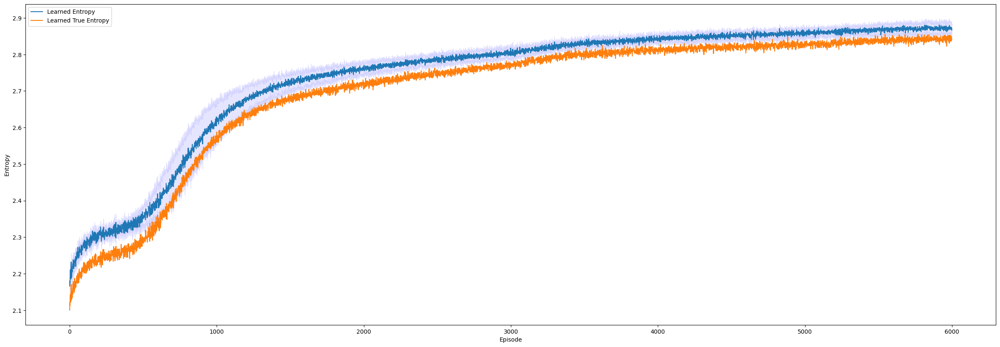

In [59]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0
randomize=1
shift_amount=0.5
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP Asymm Random Initial Position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Stochastic Asymmetric**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:  98%|███████████████████████████████▏| 5853/6000 [42:23<01:07,  2.18it/s]

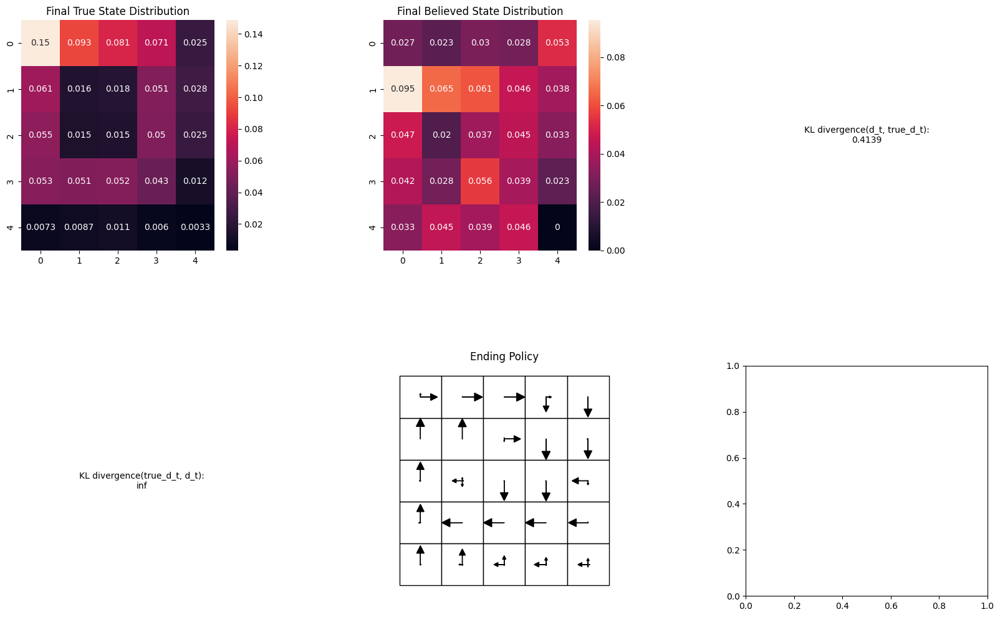

Run 0:  98%|███████████████████████████████▏| 5856/6000 [42:25<01:02,  2.31it/s]

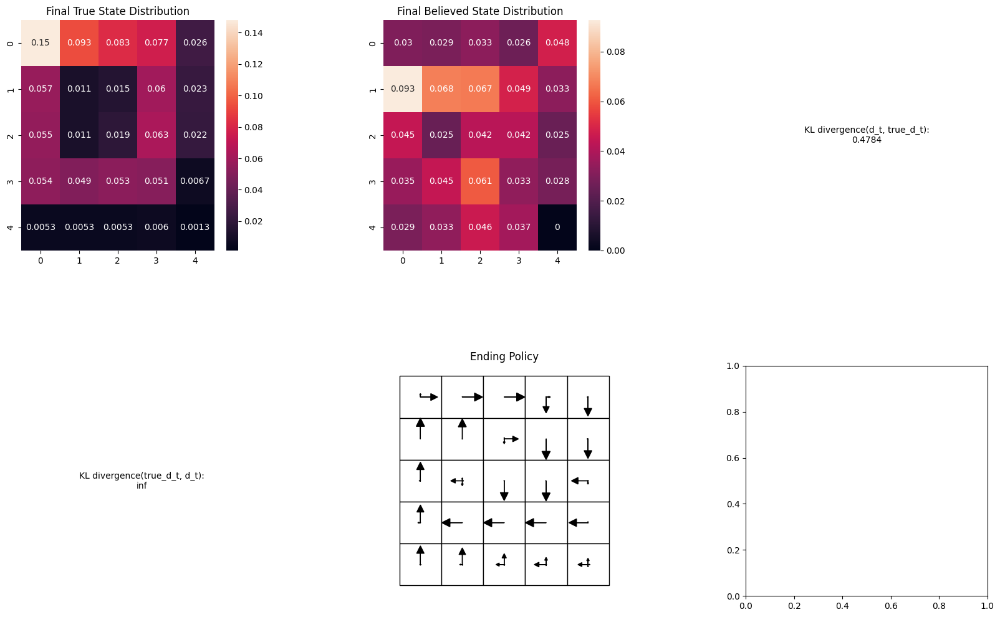

Run 0:  98%|███████████████████████████████▎| 5870/6000 [42:31<00:59,  2.19it/s]

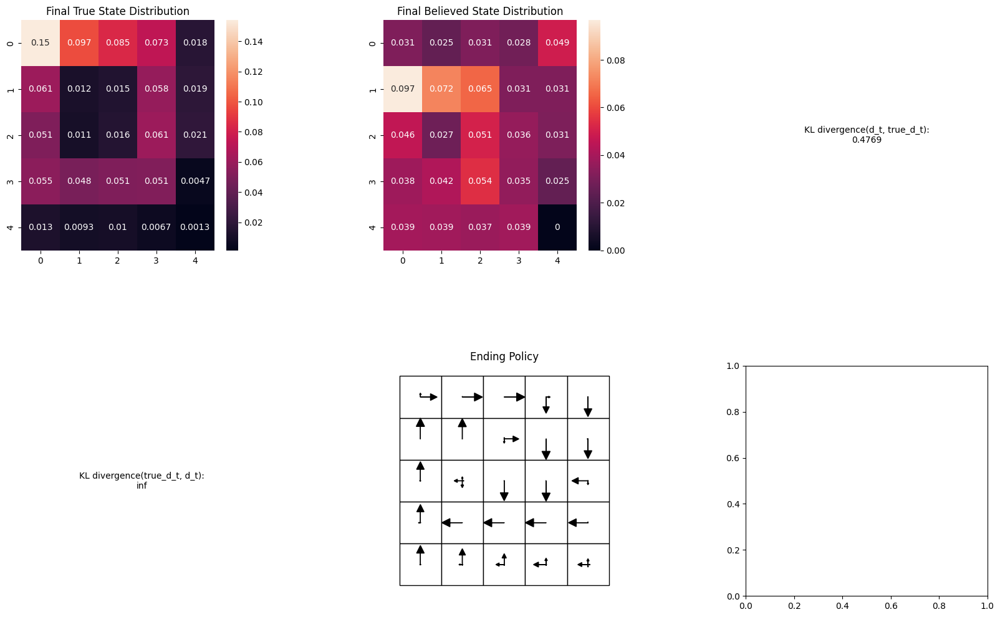

Run 0:  98%|███████████████████████████████▍| 5905/6000 [42:46<00:37,  2.54it/s]

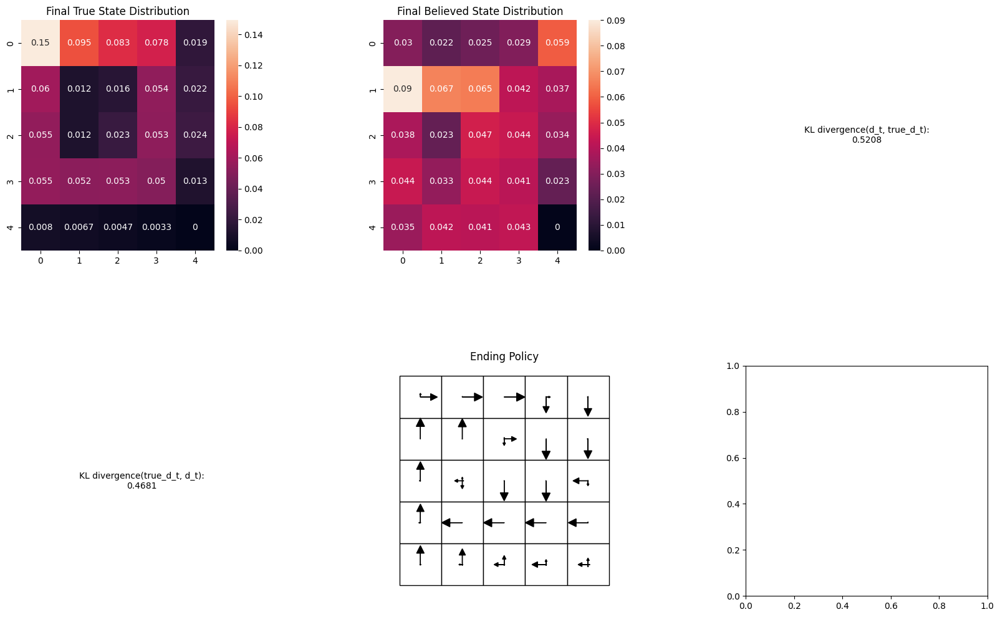

Run 0:  99%|███████████████████████████████▋| 5944/6000 [43:04<00:26,  2.12it/s]

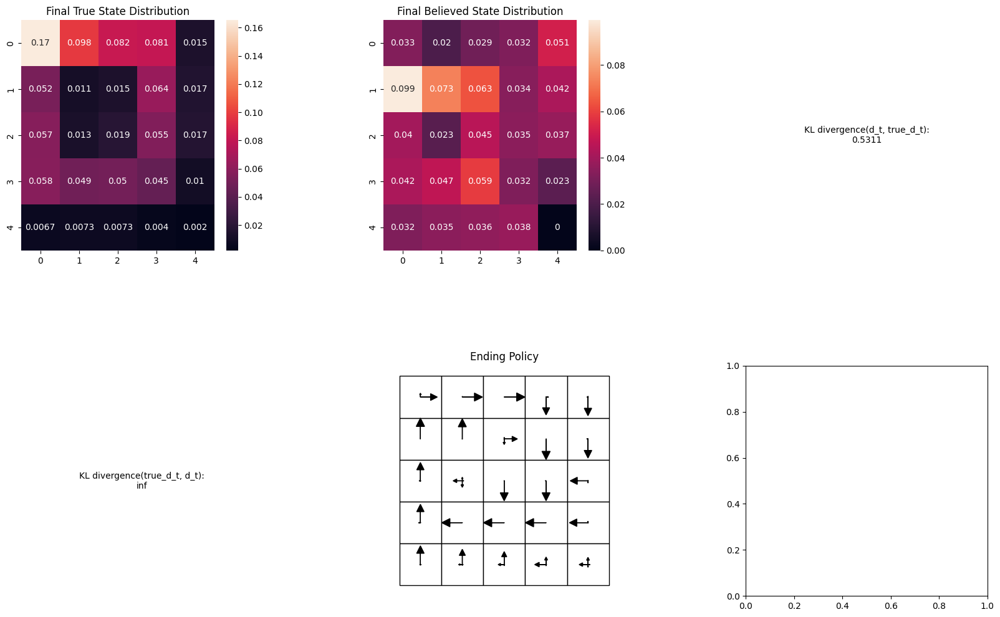

Run 0:  99%|███████████████████████████████▊| 5961/6000 [43:12<00:17,  2.25it/s]

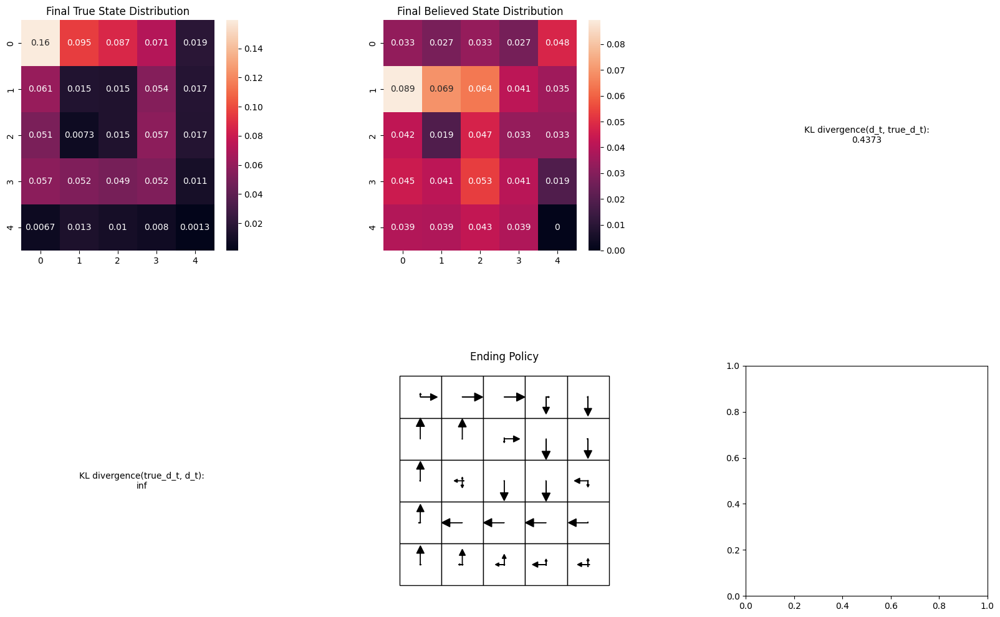

Run 0:  99%|███████████████████████████████▊| 5968/6000 [43:15<00:13,  2.34it/s]

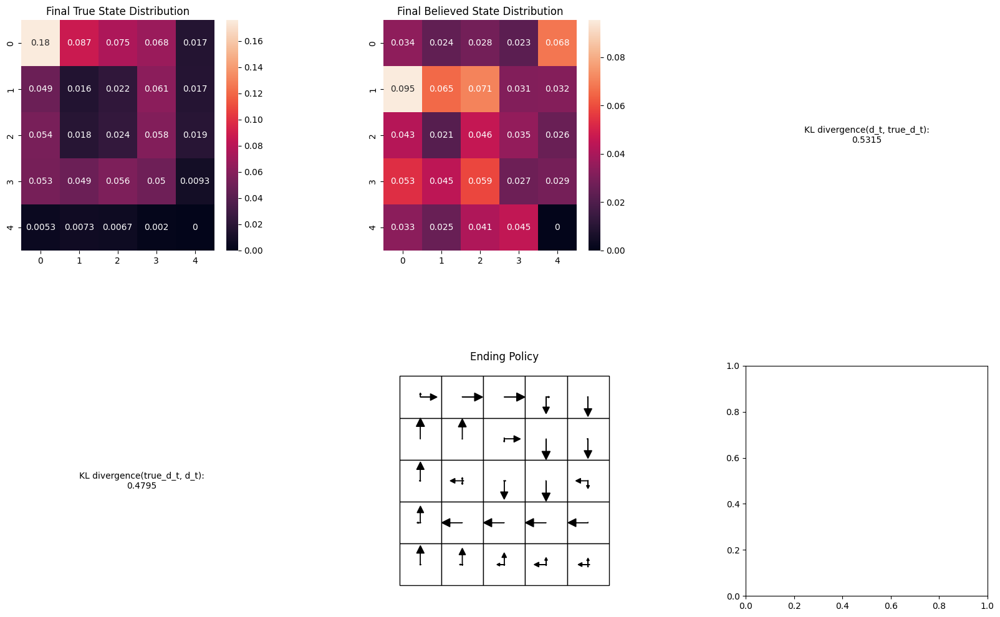

Run 0:  99%|███████████████████████████████▊| 5969/6000 [43:15<00:13,  2.34it/s]

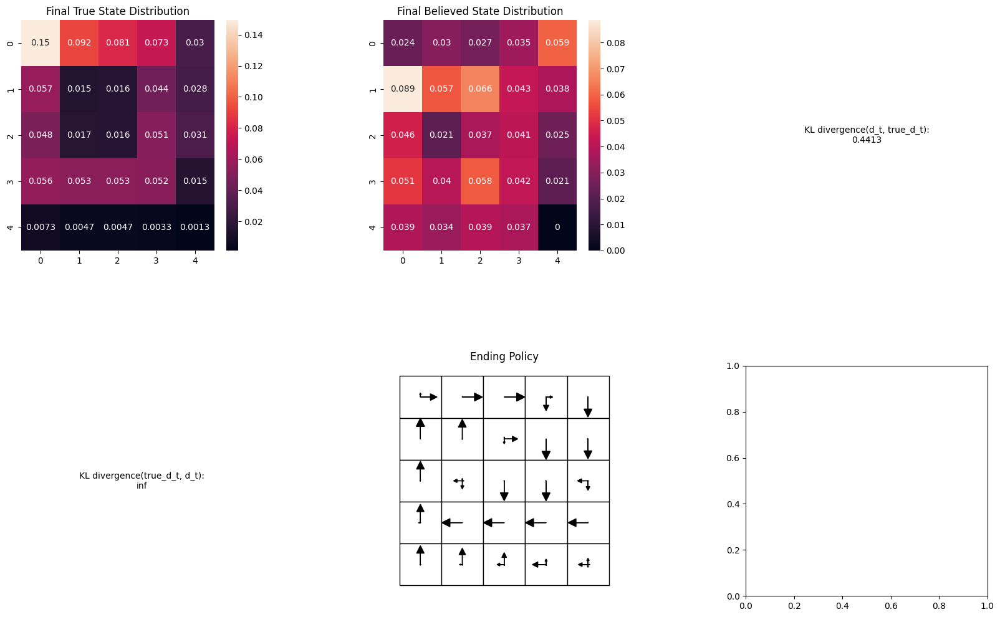

Run 0: 100%|████████████████████████████████| 6000/6000 [43:28<00:00,  2.30it/s]


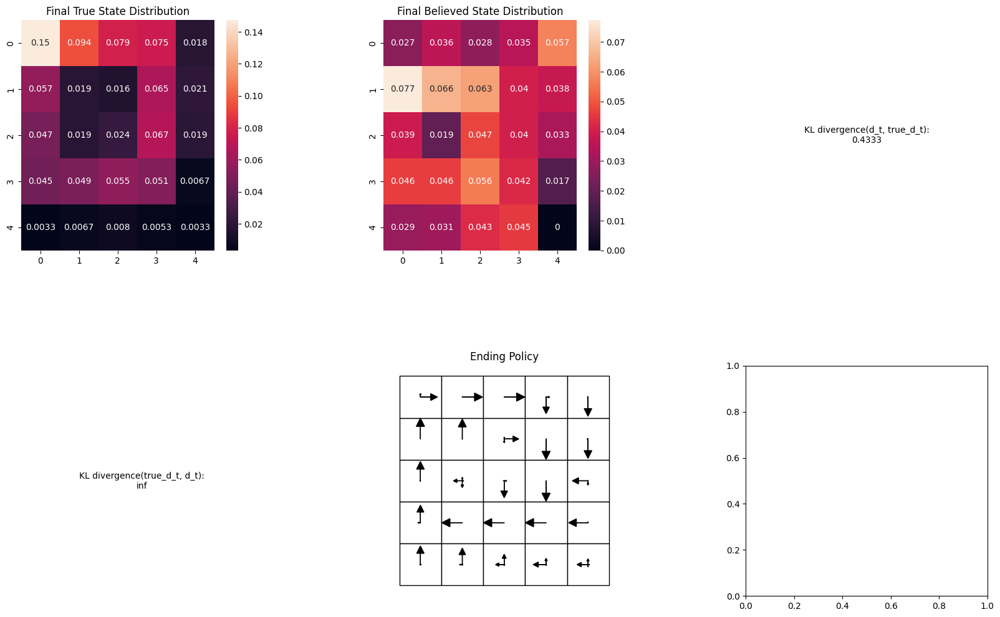

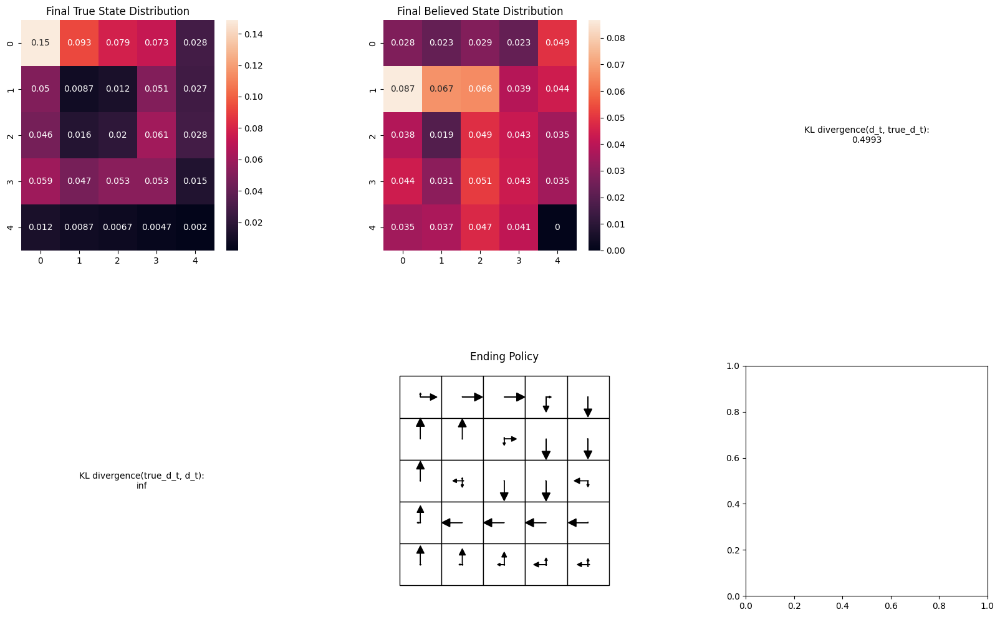

Believed Entropy mean: 2.6347282489078845
True Entropy mean: 2.5471900935474


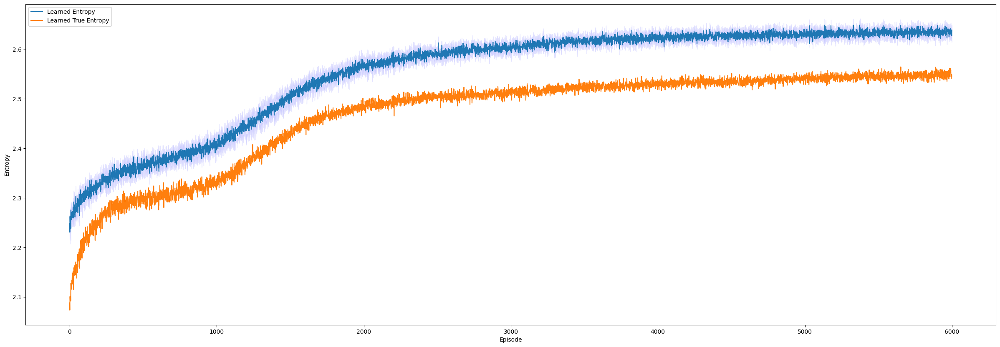

In [60]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0.1
randomize=0
shift_amount=0.5
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP Asymm")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Stochastic Asymmetric with Random Initial Position**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

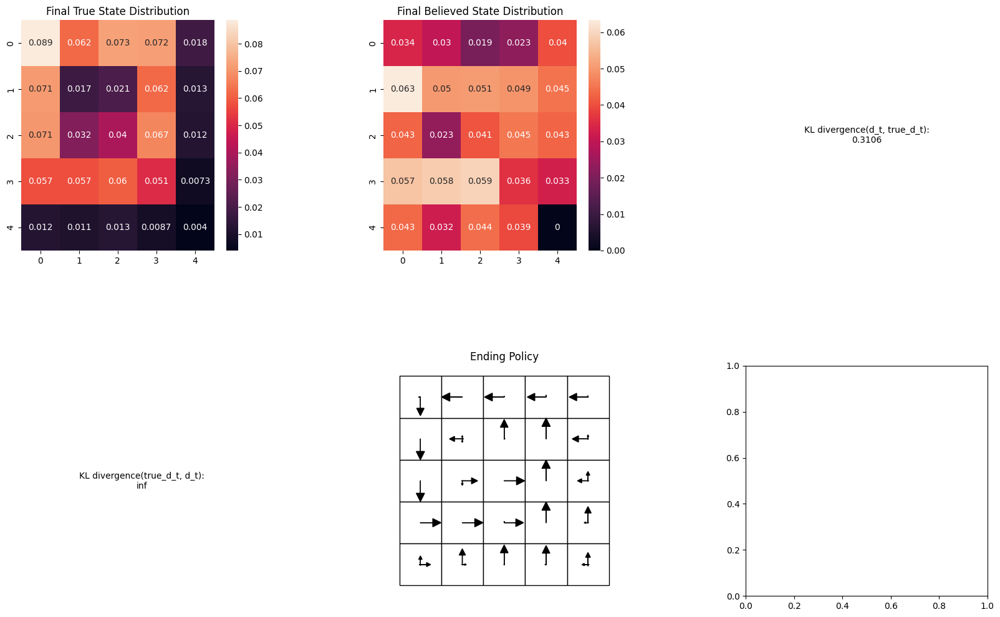

Run 0:  98%|███████████████████████████████▍| 5893/6000 [42:50<00:45,  2.36it/s]

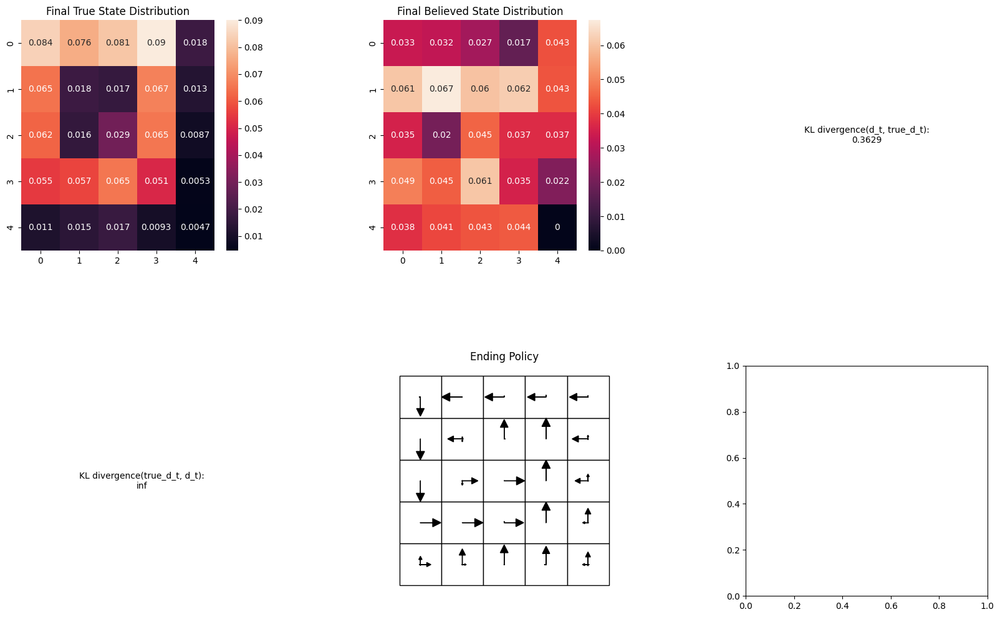

Run 0:  99%|███████████████████████████████▌| 5927/6000 [43:04<00:30,  2.37it/s]

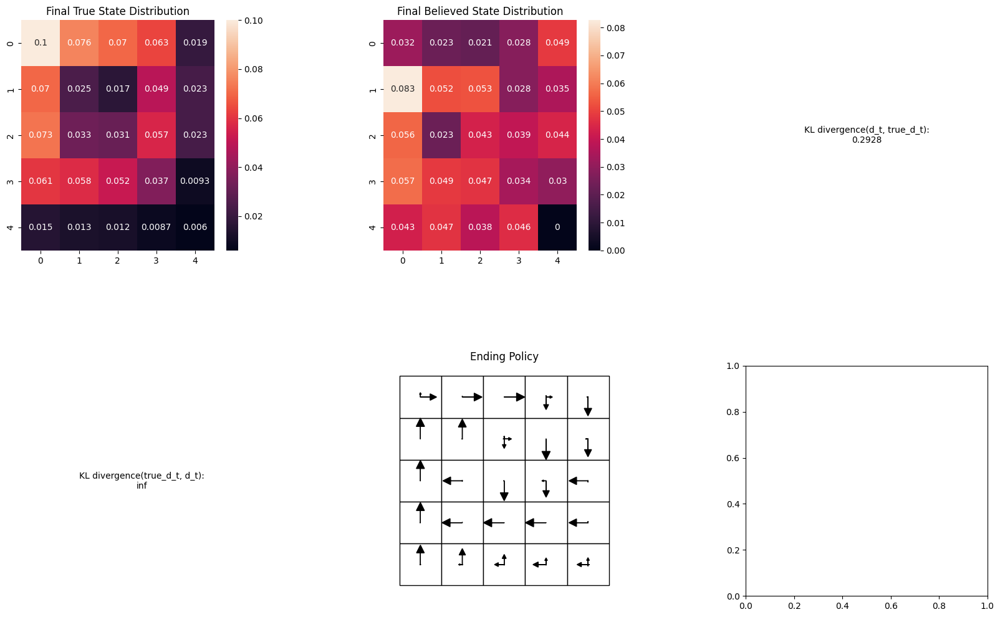

Run 0:  99%|███████████████████████████████▋| 5930/6000 [43:06<00:28,  2.48it/s]

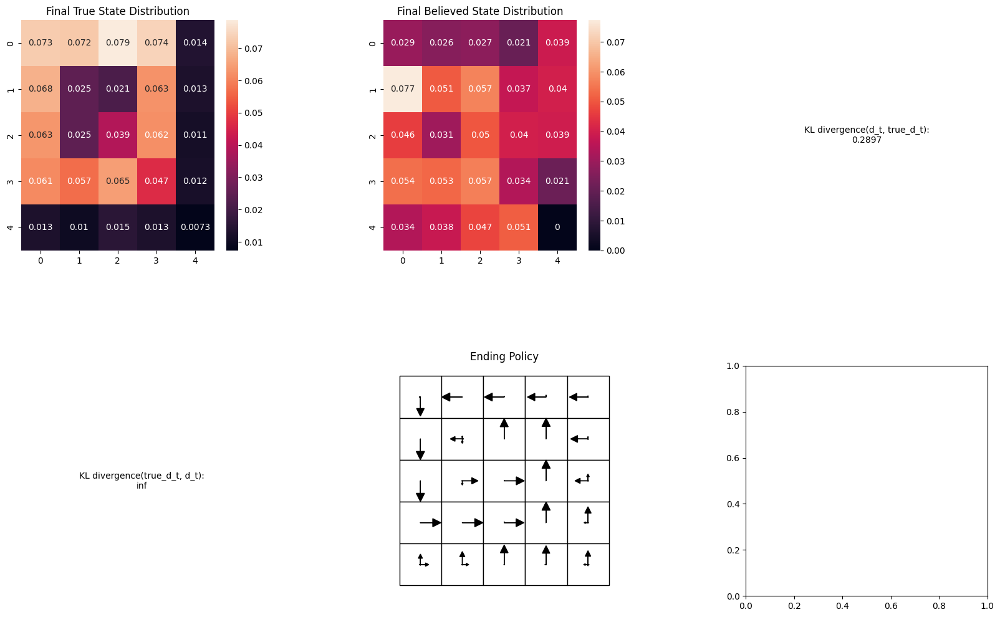

Run 0:  99%|███████████████████████████████▊| 5961/6000 [43:20<00:18,  2.14it/s]

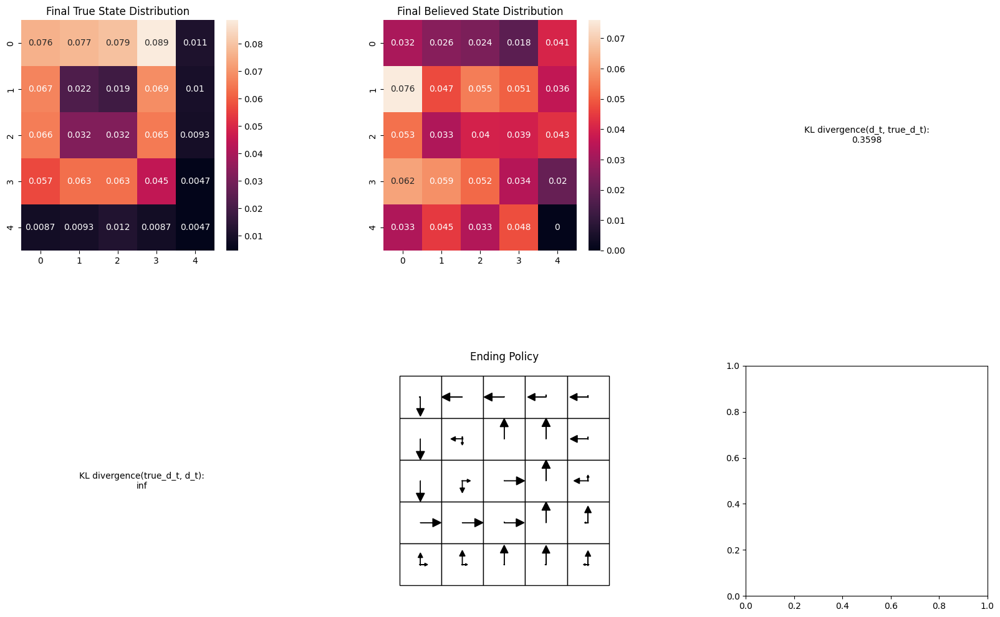

Run 0: 100%|███████████████████████████████▉| 5982/6000 [43:30<00:08,  2.17it/s]

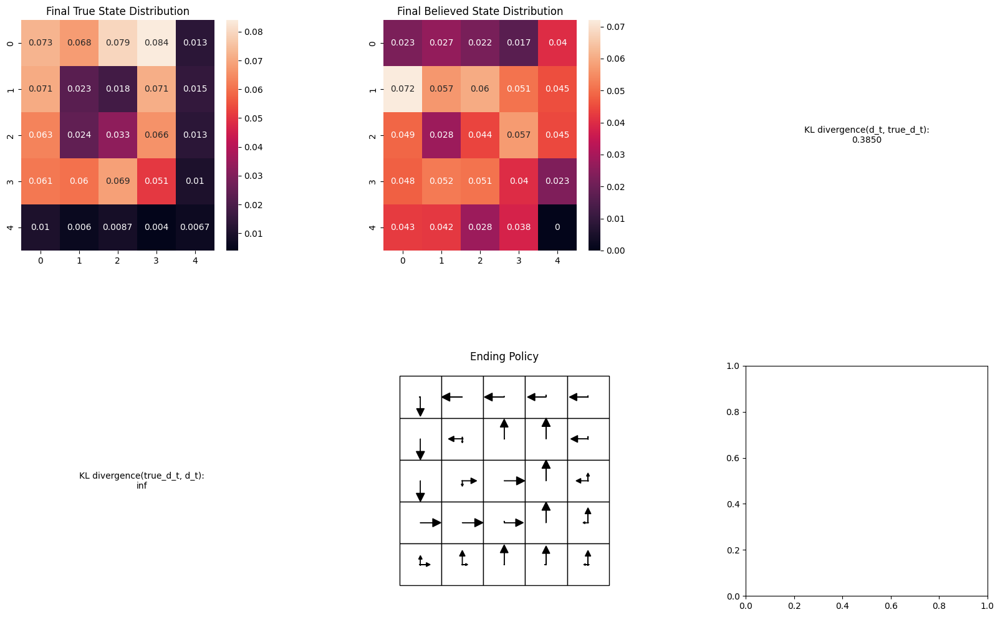

Run 0: 100%|███████████████████████████████▉| 5984/6000 [43:30<00:07,  2.22it/s]

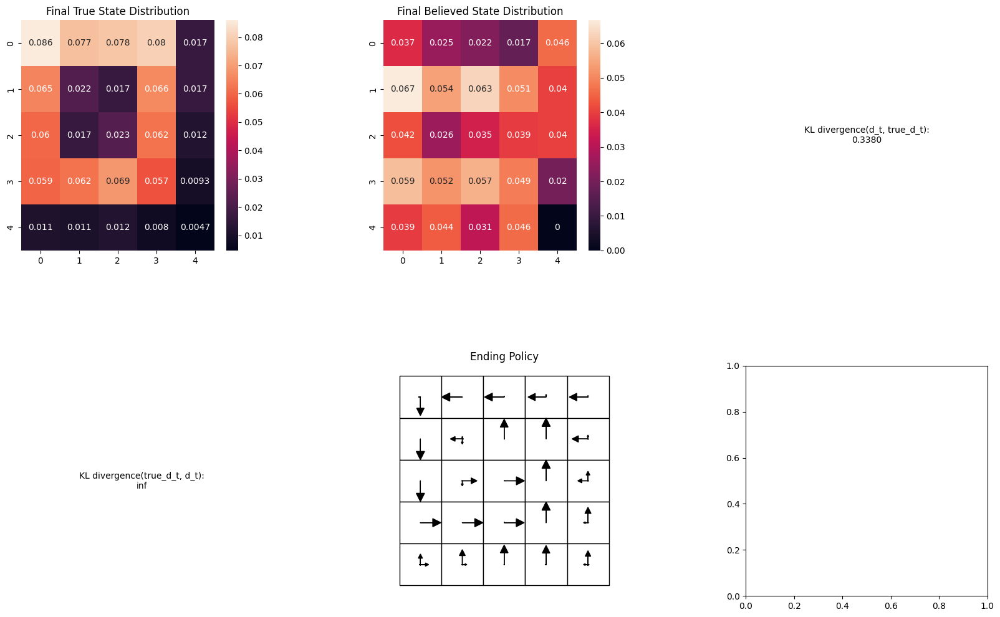

Run 0: 100%|████████████████████████████████| 6000/6000 [43:37<00:00,  2.29it/s]


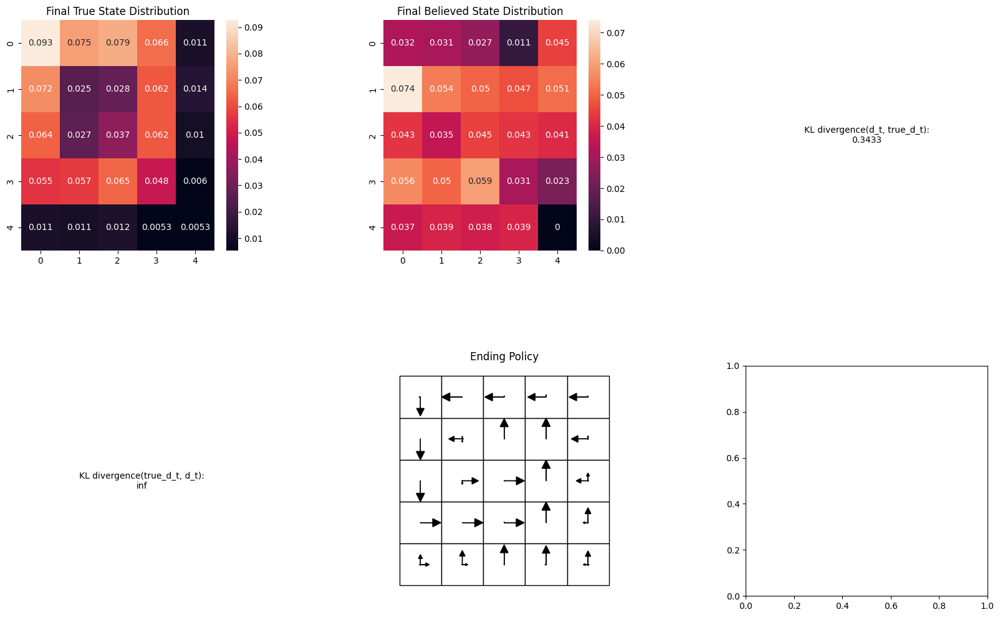

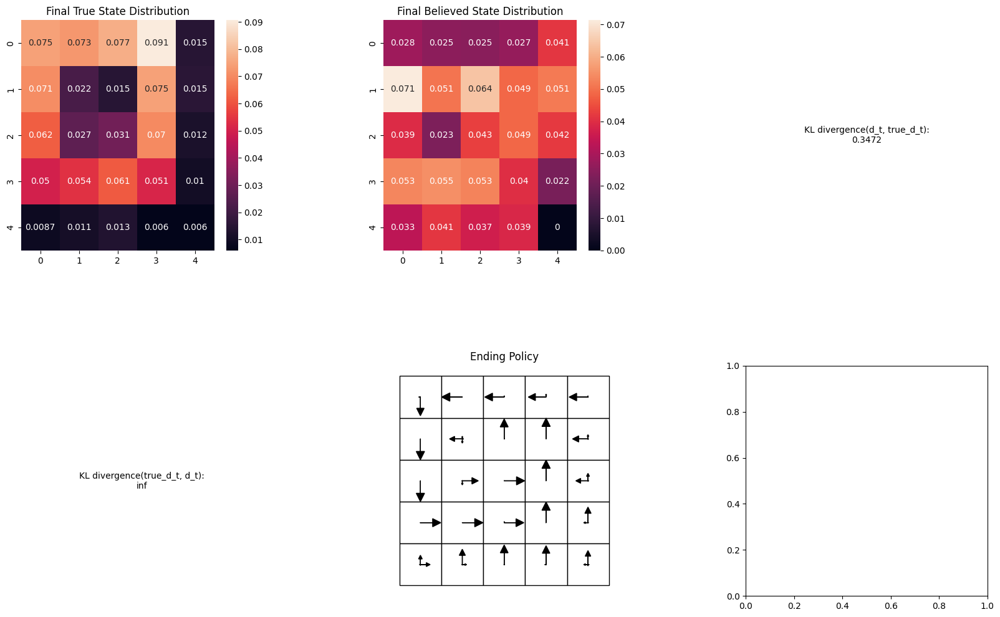

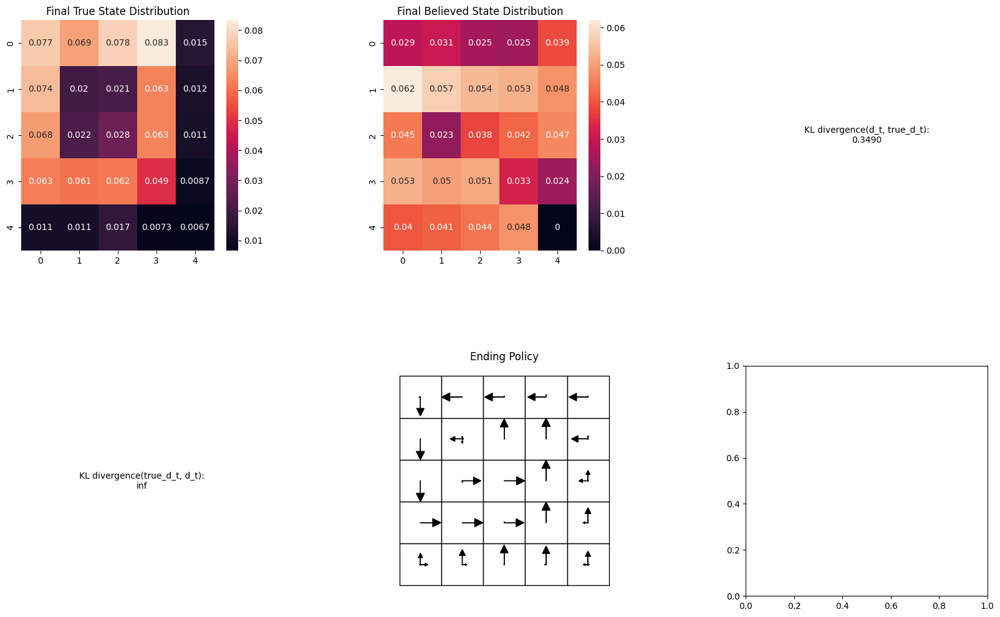

Believed Entropy mean: 2.6513338096762946
True Entropy mean: 2.6023797878535966


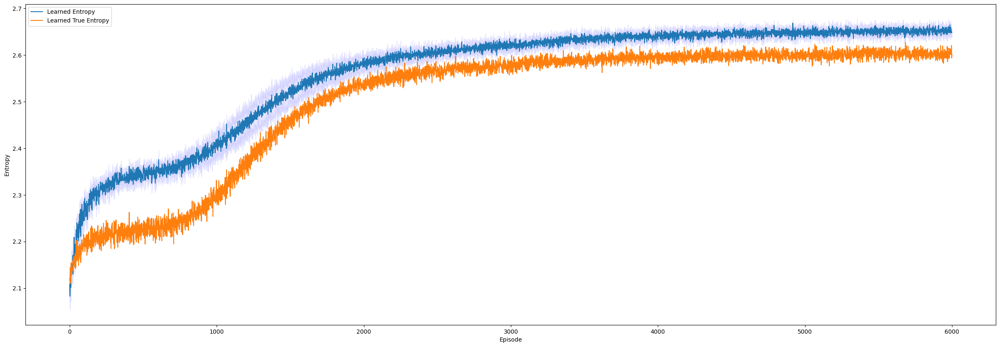

In [61]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=20
uniform=0
prob=0.1
randomize=1
shift_amount=0.5
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP Asymm Random Initial Position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Hard Initializations**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

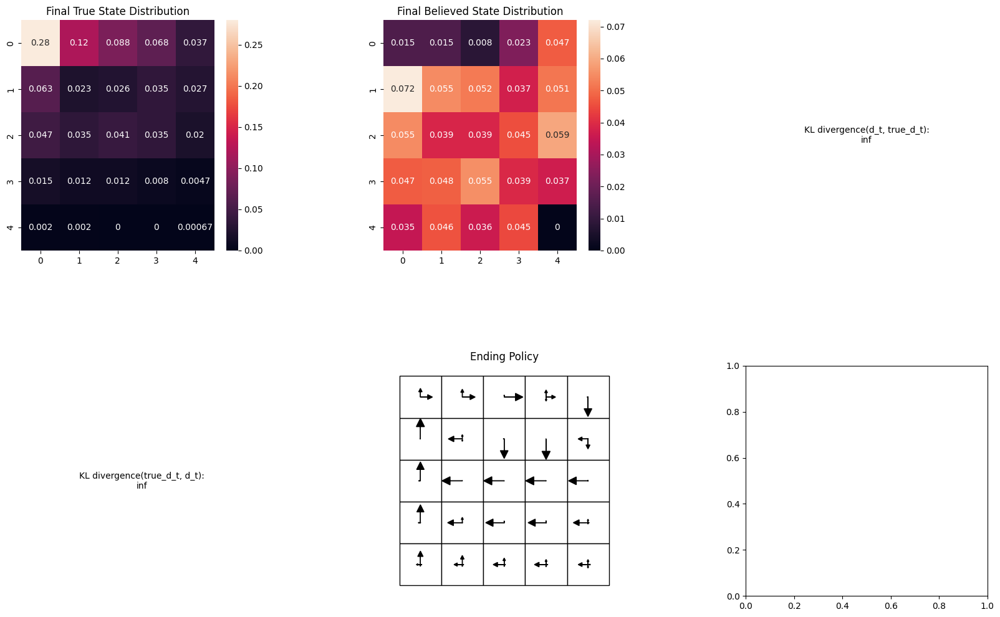

Run 0:  98%|███████████████████████████████▏| 5856/6000 [43:02<01:11,  2.01it/s]

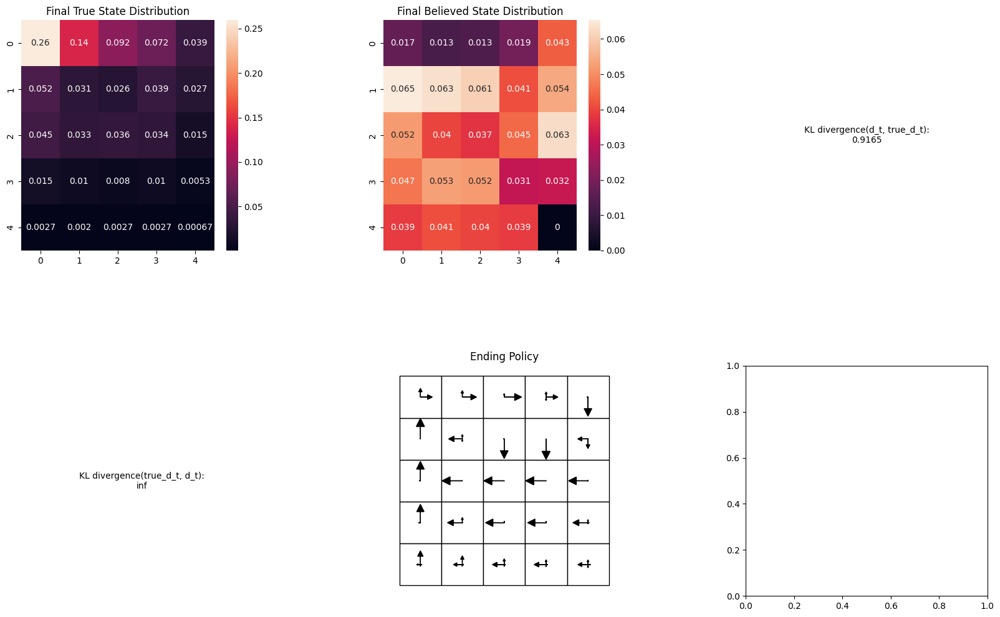

Run 0:  98%|███████████████████████████████▏| 5858/6000 [43:03<01:09,  2.04it/s]

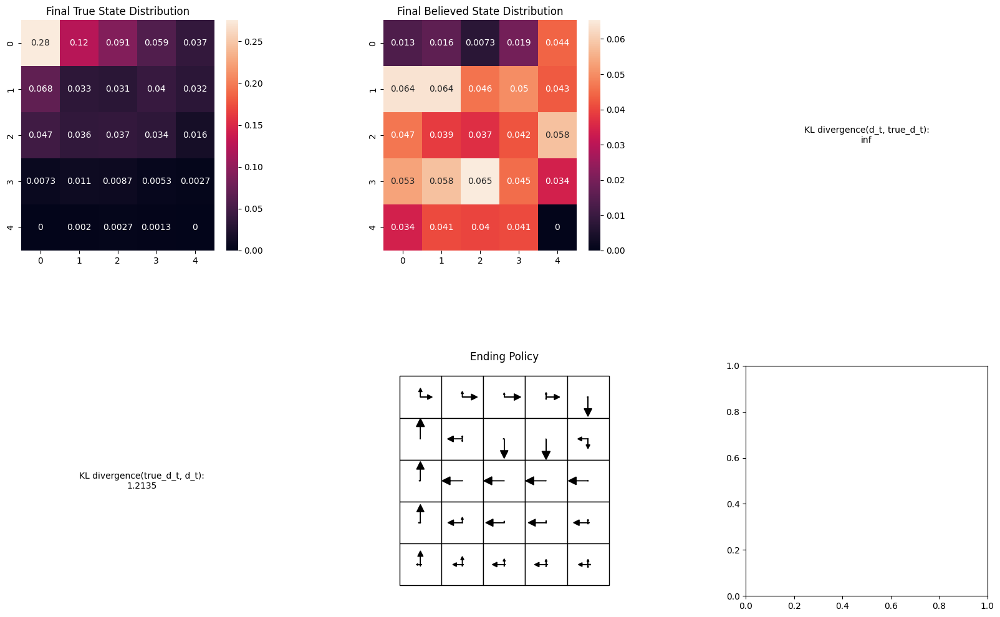

Run 0:  98%|███████████████████████████████▍| 5885/6000 [43:14<00:53,  2.14it/s]

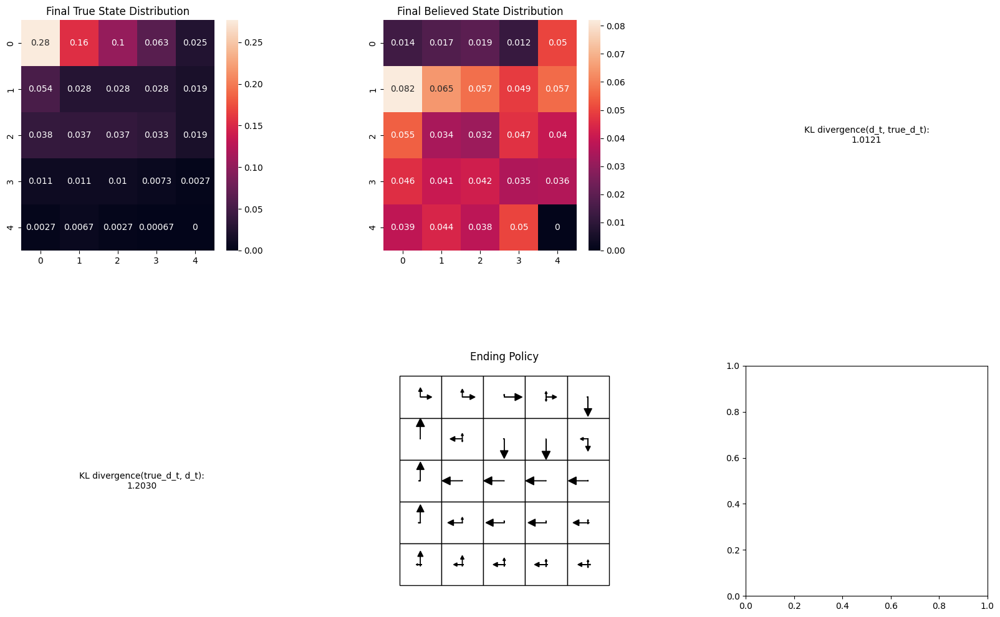

Run 0:  98%|███████████████████████████████▍| 5894/6000 [43:19<00:49,  2.13it/s]

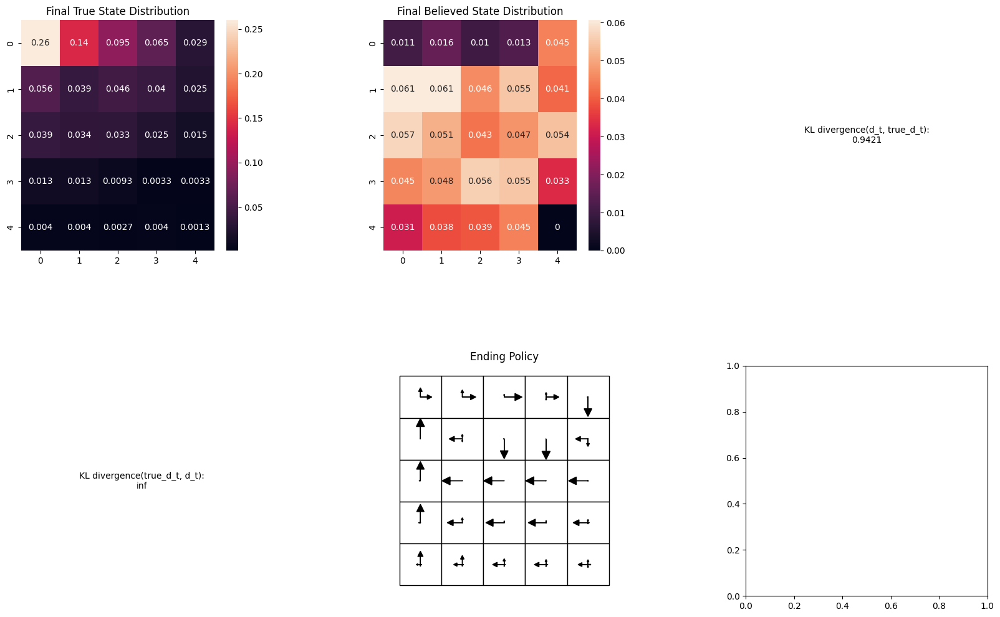

Run 0:  98%|███████████████████████████████▍| 5898/6000 [43:21<00:48,  2.12it/s]

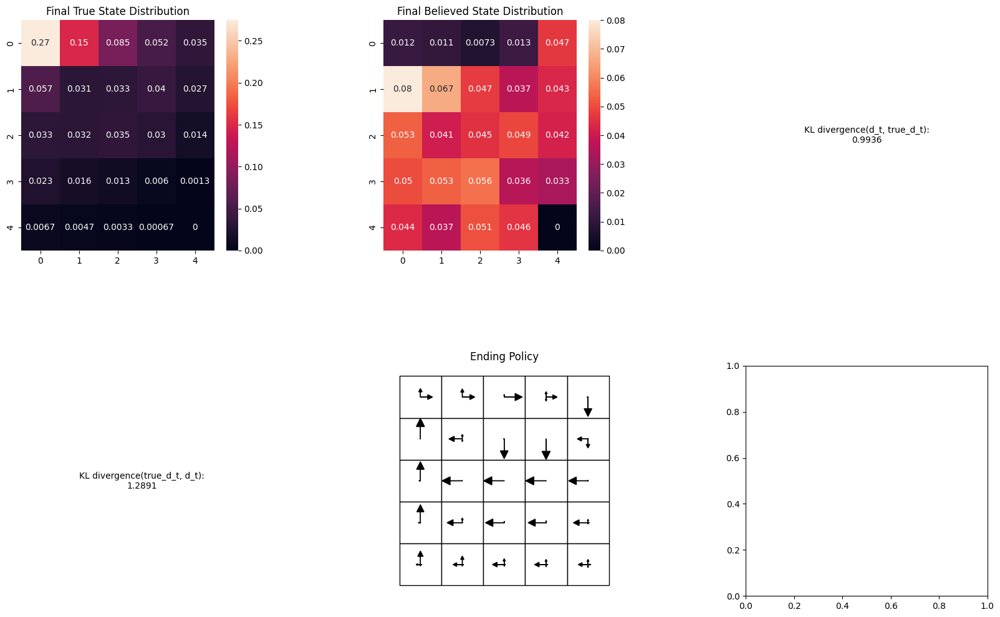

Run 0:  98%|███████████████████████████████▍| 5904/6000 [43:23<00:40,  2.35it/s]

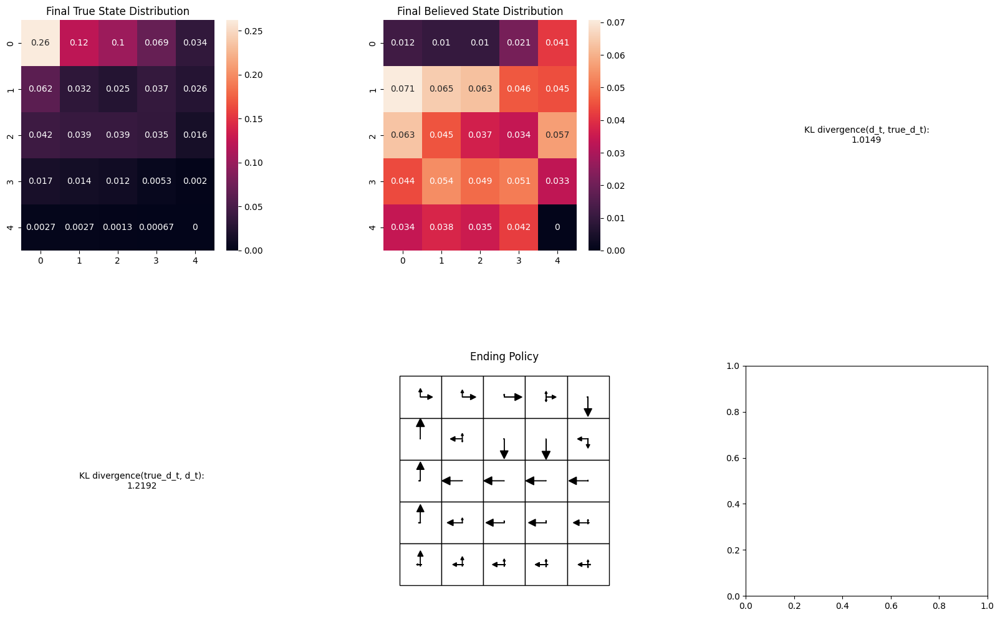

Run 0:  99%|███████████████████████████████▋| 5935/6000 [43:36<00:26,  2.45it/s]

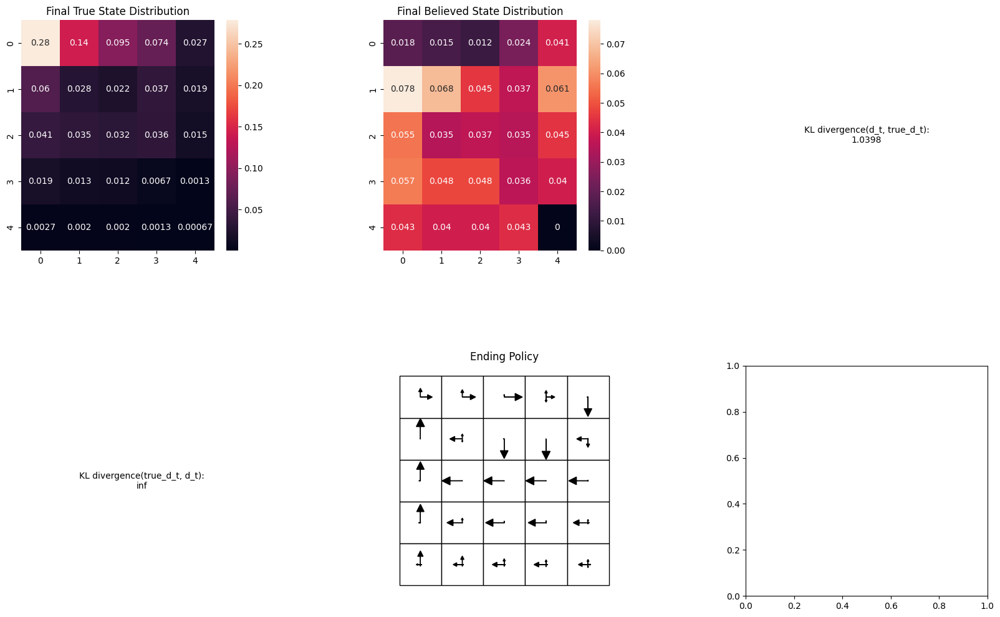

Run 0:  99%|███████████████████████████████▊| 5961/6000 [43:46<00:16,  2.42it/s]

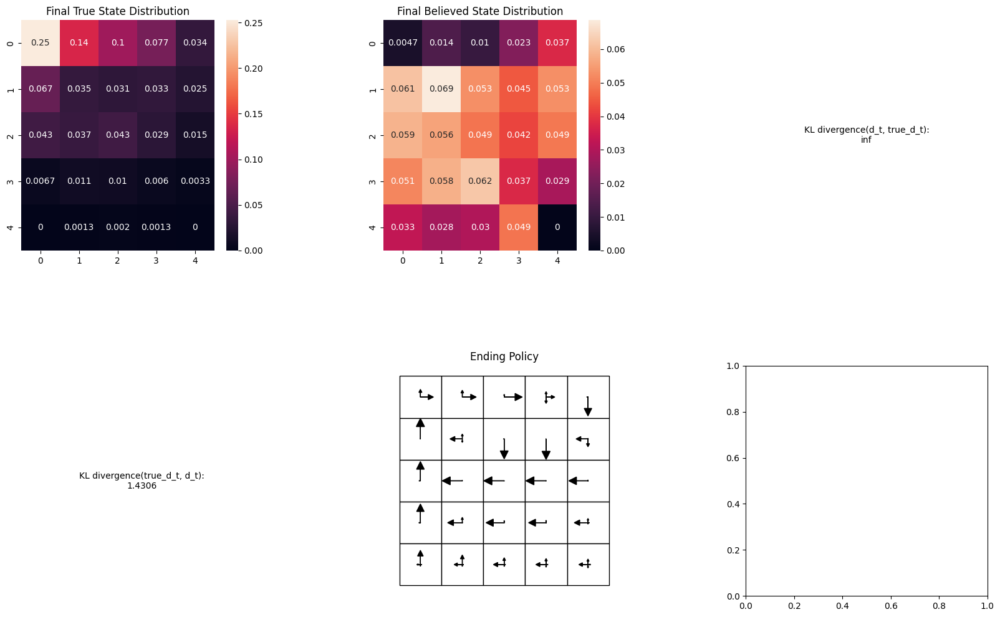

Run 0: 100%|████████████████████████████████| 6000/6000 [44:02<00:00,  2.27it/s]


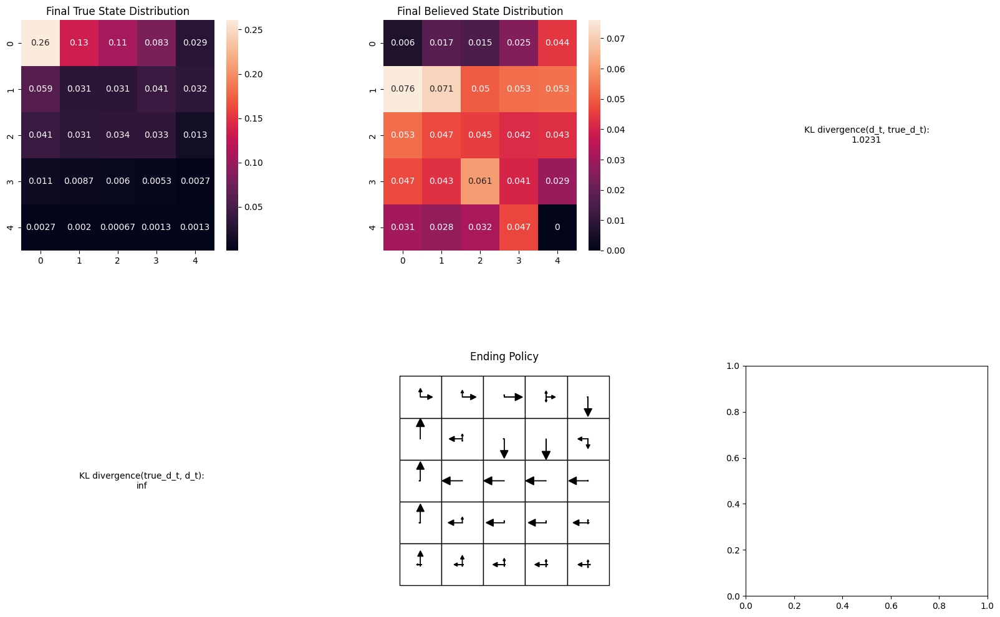

Believed Entropy mean: 2.5686506172021484
True Entropy mean: 2.1459378053690608


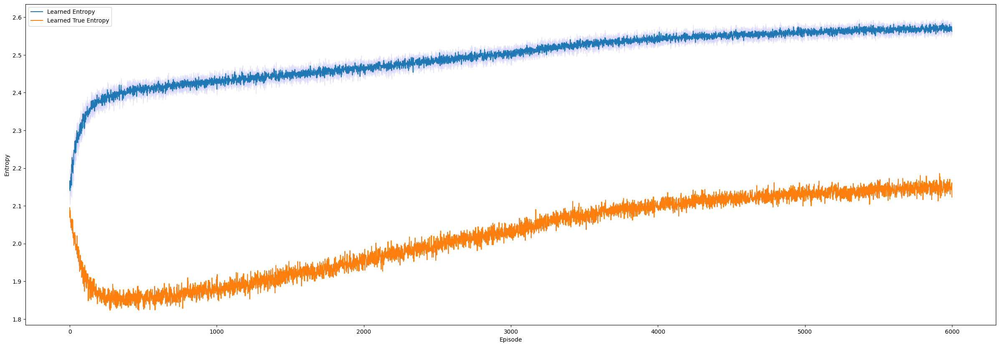

In [63]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=2
uniform=0
prob=0.1
randomize=0
shift_amount=0.9
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP Asymm Random Initial Position")
print("Believed Entropy mean: " + str(np.mean(entropies_means[5500:])))
print("True Entropy mean: " + str(np.mean(true_entropies_means[5500:])))

**Longer time horizon**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

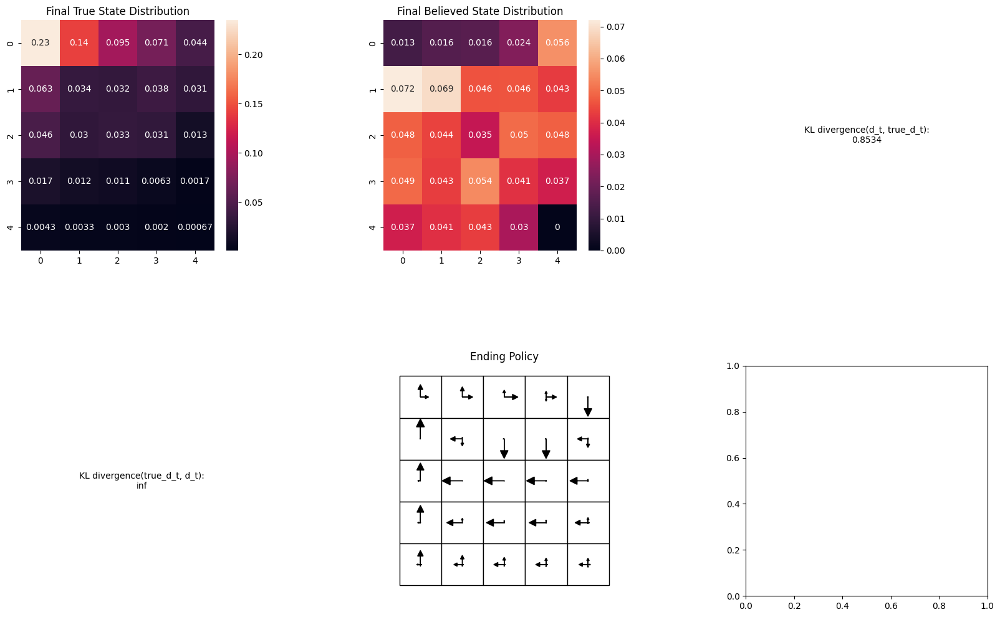

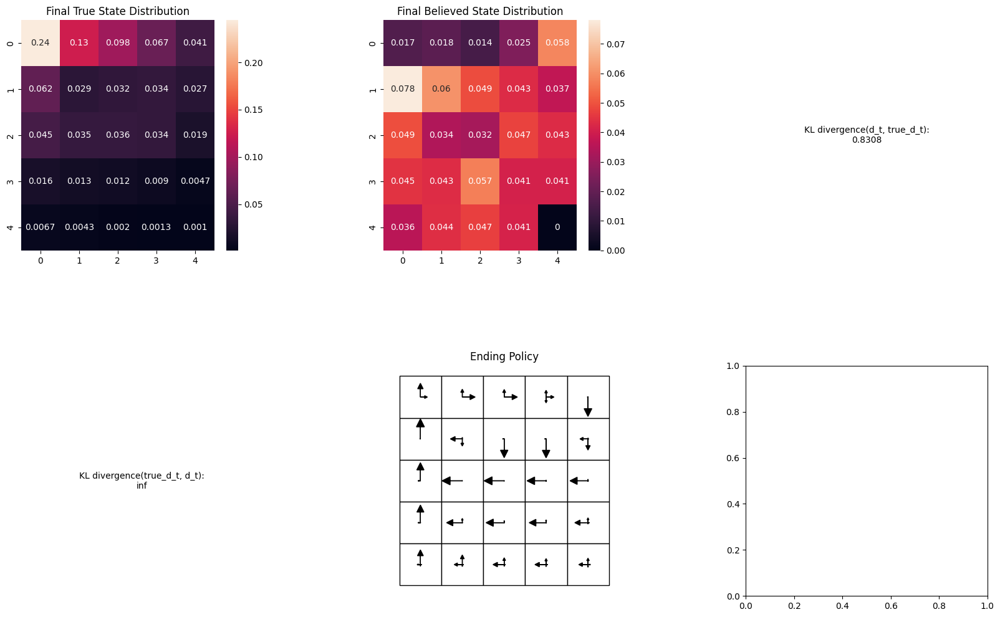

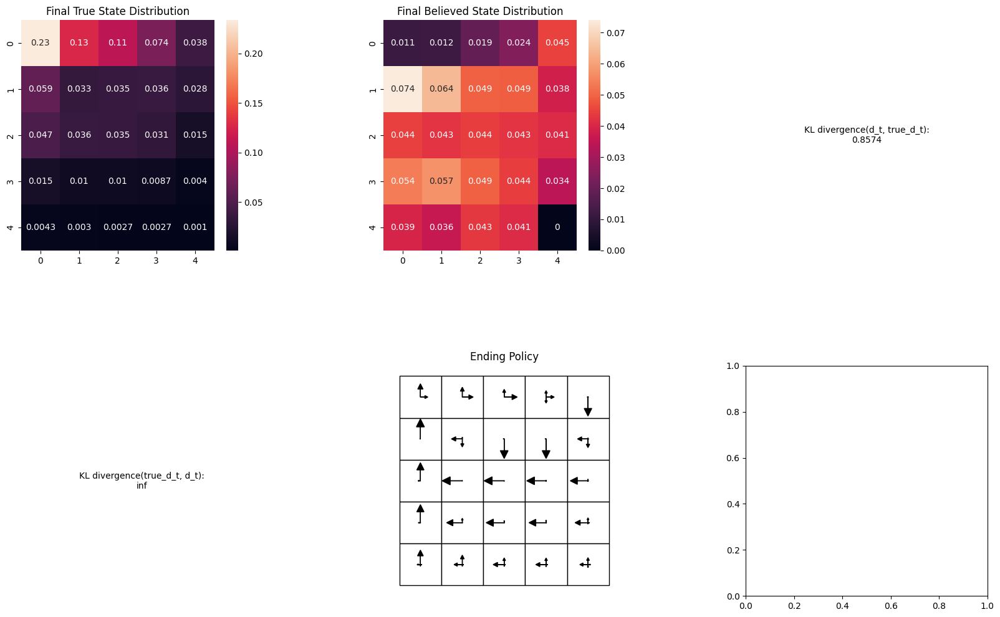

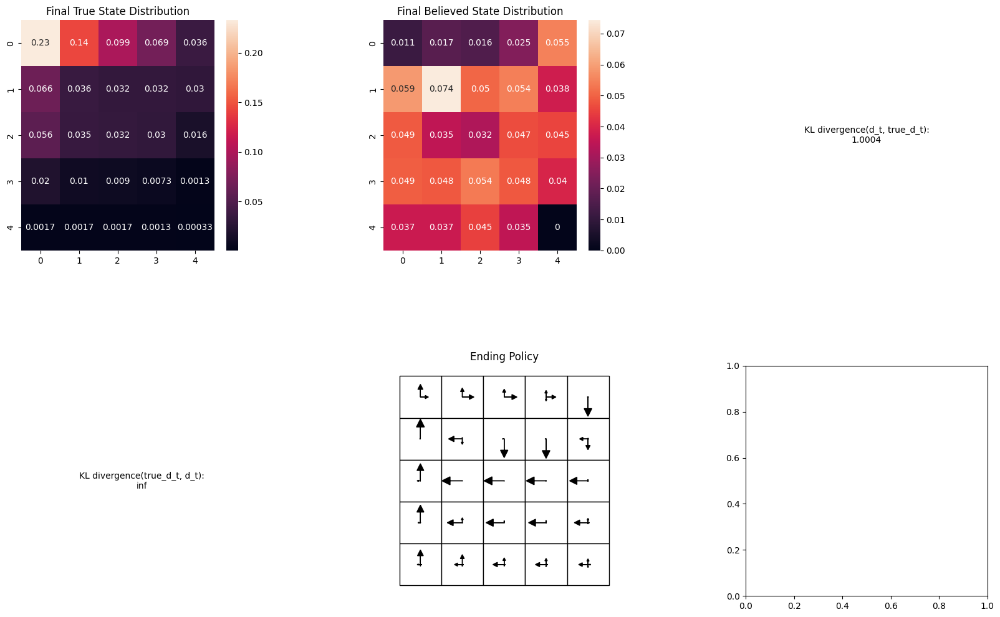

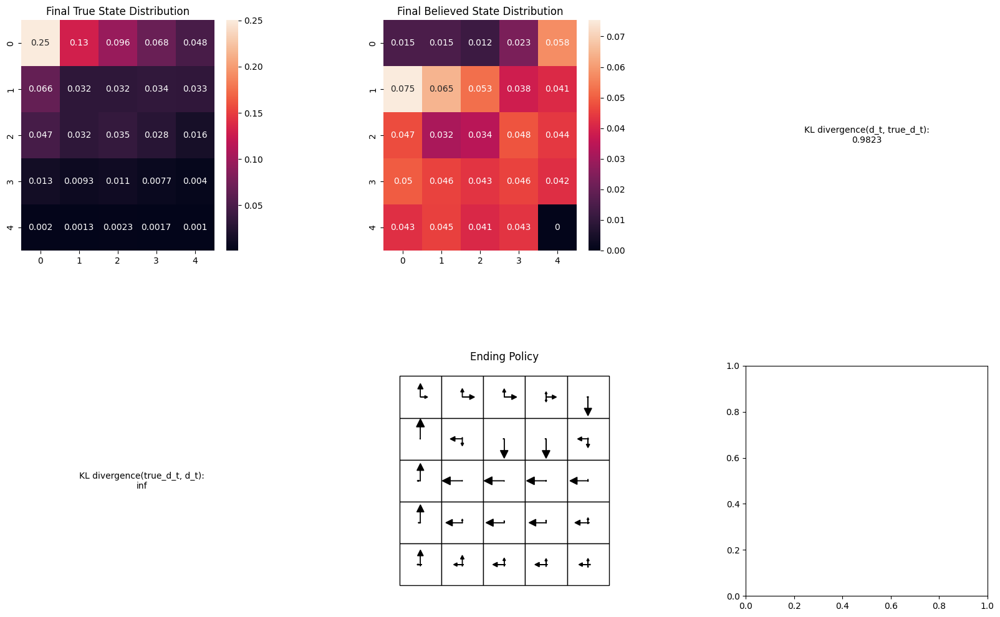

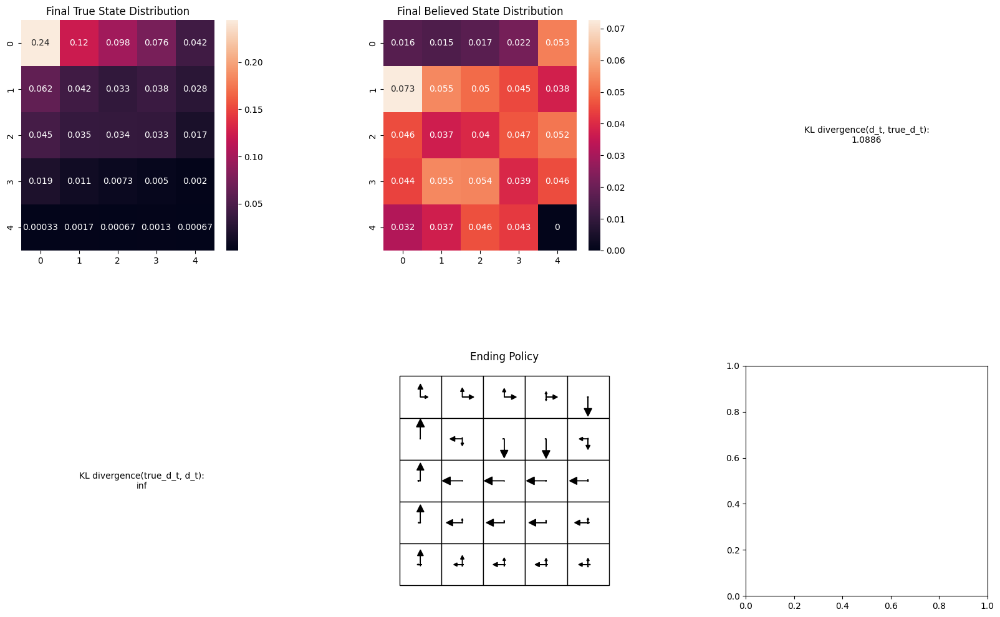

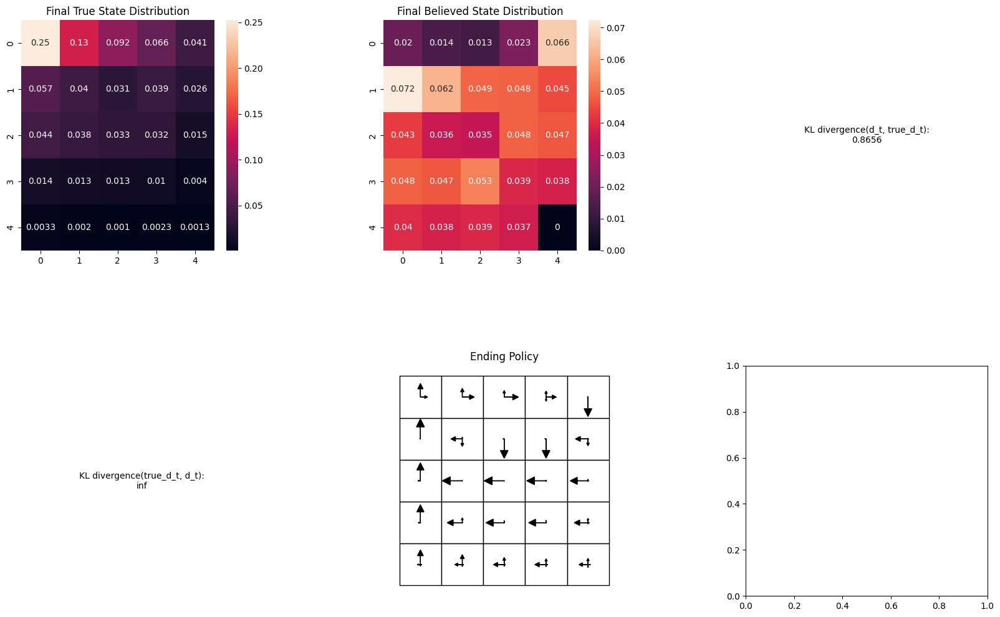

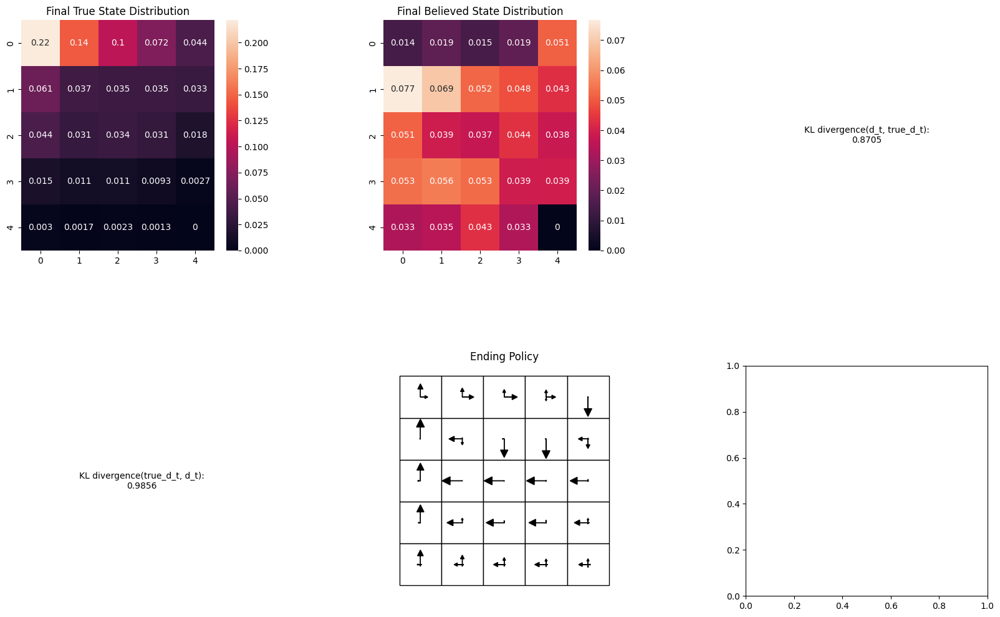

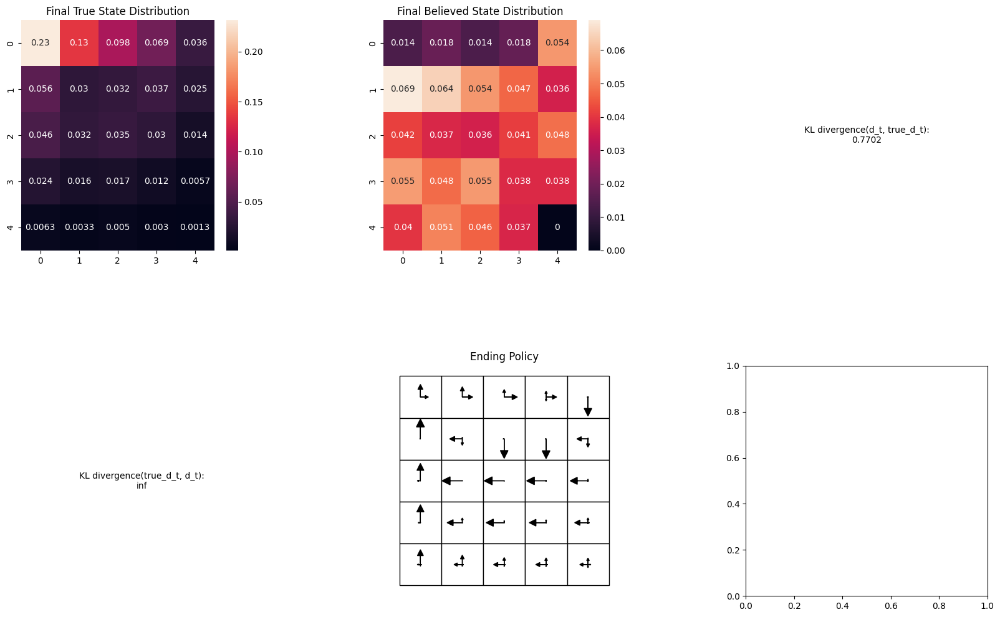

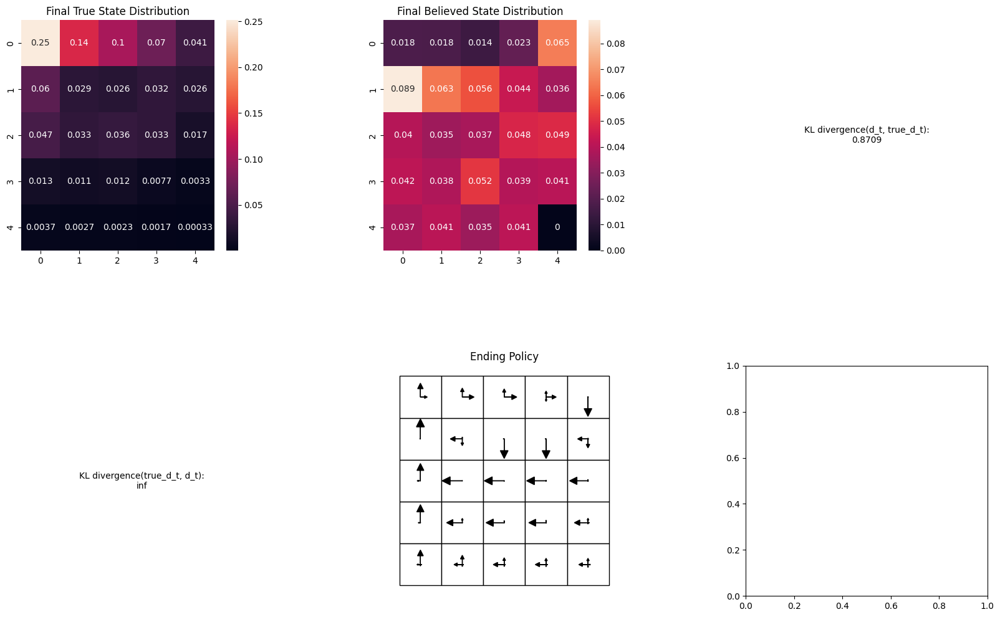

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Stochastic Learned mean: nan


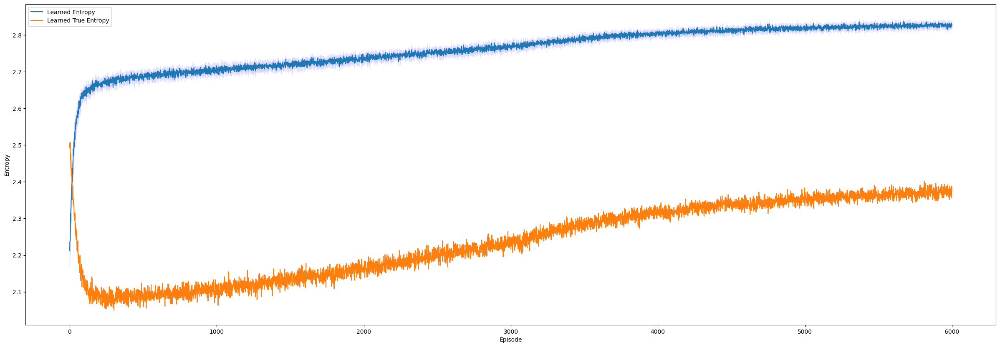

In [65]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=1
uniform=0
prob=0.1
randomize=0
shift_amount=0.9
# Agent variables
alpha = 0.3
baseline_coeff=1

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, baseline_coeff, n_traj, n_episodes, time_horizon, steepness, uniform, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP Asymm Random Initial Position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[7500:])))